# Load Data and Libraries

In [1]:
import networkx as nx
import numpy as np
import collections
import matplotlib.pyplot as plt
import csv

In [3]:
data = nx.read_weighted_edgelist('data/traced-connections-nohead.csv', delimiter=',', nodetype=int, create_using=nx.DiGraph)

In [2]:
roi_data = nx.read_edgelist('data/traced-roi-nohead.csv', delimiter=',', create_using=nx.DiGraph, nodetype=int, data=(('roi',str),('weight',int)))

In [3]:
# Load instance and type foreach neuron
itotal = 0
ttotal = 0
collisions = 0
test = set()
types = set()
combos = set()
with open('data/traced-neurons.csv') as nfile:
    reader = csv.reader(nfile)
    instance = {}
    neuron_type = {}
    head = None
    for rows in reader:
        if not head:
            head = rows
            continue
        
        instance[int(rows[0])] = rows[1]
        neuron_type[int(rows[0])] = rows[2]
        if rows[1]:
            itotal += 1
            if rows[1] in test:
                collisions += 1
            else:
                test.add(rows[1])
        if rows[2]:
            ttotal += 1
            types.add(rows[2])
        combos.add(rows[1]+rows[2])
            

        
# Set as attributes in the network
nx.set_node_attributes(roi_data, instance, name="instance")
nx.set_node_attributes(roi_data, neuron_type, name="type")


print("Len types: {}".format(len(types)))
print("Len instances: {}".format(len(test)))
print("Len combos: {}".format(len(combos)))
# Check population count
print(f"Instance population: {itotal}. Type population: {ttotal}. Collisions: {collisions}")

Len types: 4741
Len instances: 6223
Len combos: 6315
Instance population: 21031. Type population: 18837. Collisions: 14808


In [58]:
out_rois = collections.defaultdict(dict)
for node in roi_data:
    
    outs = roi_data.out_edges(node)
    for out in outs:
        roi = roi_data.get_edge_data(out[0], out[1])['roi']
        weight = roi_data.get_edge_data(out[0], out[1])['weight']
        out_rois[node][roi] = out_rois[node].get(roi, 0) + weight


In [ ]:
triadic_census = nx.triadic_census(roi_data)

In [ ]:
roi_reversed = nx.line_graph(roi_data)

Examine files to ensure properly loaded. Check attributes and plot sample graphs.

In [16]:
def plotGraphWeights(G):
    edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]

    # layout
    pos = nx.spring_layout(G)

    # rendering
    nx.draw_networkx_nodes(G, pos)
    nx.draw_networkx_edges(G, pos, width=edgewidth)

    plt.show()

In [12]:
roi_data.get_edge_data(5813039880, 295474250)

{'roi': 'SLP(R)', 'weight': 1}

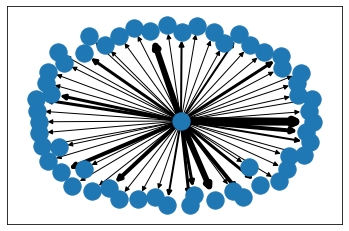

In [17]:
H = roi_data.edge_subgraph(roi_data.edges([5813039880]))
plotGraphWeights(H)

# Initial Analysis

First we examine degree distribution.

In [ ]:
def plotDegDist(G):
    degSec = sorted([d for n,d in G.degree()], reverse=True)
    plt.plot(degSec)

In [41]:
def plotDegDist_degs(degs):
    degSec = sorted(degs, reverse=True)
    plt.plot(degSec)

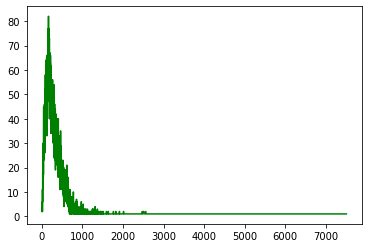

In [85]:
degree_sequence = sorted([d for n, d in roi_data.degree()], reverse=True)
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())
plt.plot(deg, cnt, color='g')

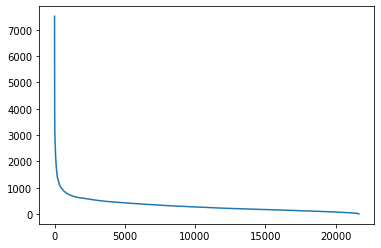

In [11]:
plotDegDist(data)

This looks power law distribution (from our study of human minds), but let's check.

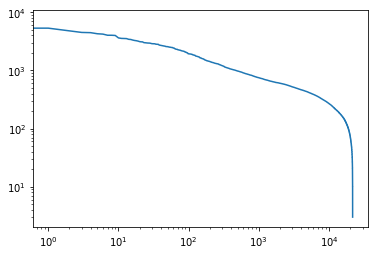

In [58]:
degSec = sorted([d for n,d in data.degree()], reverse=True)
plt.loglog(degSec)

We now examine the precipitious drop-off

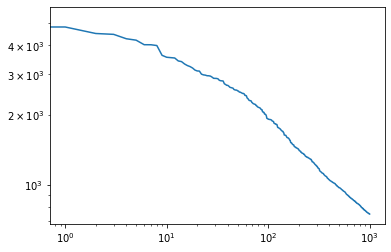

In [81]:
plt.loglog(degSec[1:1000])

Still power-law, but with different factor.

In [90]:
import powerlaw

fit=powerlaw.Fit(degSec)
print(fit.power_law.alpha)

Calculating best minimal value for power law fit
/Users/jtbonham/opt/anaconda3/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


3.5742882960959608


In [97]:
def checkPowerLaw(G):
    degSec = sorted([d for n,d in G.degree()], reverse=True)
    fit=powerlaw.Fit(degSec)
    R, p = fit.distribution_compare('power_law', 'lognormal')
    print(R,p)

In [98]:
checkPowerLaw(data)

Calculating best minimal value for power law fit


-0.10603756538389053 0.7528953961477626


In [100]:
max(nx.eccentricity(data))

KeyboardInterrupt: 

# Community Detection

In [49]:
from networkx.algorithms import community

First, methods for subsetting based on ROI, since computationally expensive operation to run on full graph. We subset with pandas and then load.

In [7]:
import pandas as pd

dta = pd.read_csv('data/traced-roi-nohead.csv', header=None )  
dta = dta.rename(columns={0: "source", 1: "target", 2:'roi', 3:'weight'})

And then we check to ensure column labels match up.

In [33]:
dta

,from,to,roi,weight
0,5813039880,295474250,SLP(R),1
1,5813039880,1036550962,SLP(R),1
2,5813039880,5813069636,SLP(R),1
3,5813039880,295470816,SLP(R),1
4,5813039880,294792184,SLP(R),1
...,...,...,...,...
4095987,2437892875,2438924230,None,1
4095988,2437892875,5813057404,SAD,1
4095989,2437892875,1752089996,SAD,1
4095990,2437892875,1752089996,WED(R),1


In [9]:
dta.roi.unique()

array(['SLP(R)', 'SMP(R)', 'SMP(L)', 'SIP(R)', 'FB', 'SCL(R)', 'AB(R)',
       'None', 'LH(R)', 'ICL(R)', 'AVLP(R)', 'SCL(L)', 'ICL(L)', 'GOR(L)',
       'PLP(R)', 'GOR(R)', 'SPS(R)', 'AOTU(R)', 'PVLP(R)', 'SIP(L)',
       'bL(R)', 'bL(L)', "b'L(R)", "b'L(L)", 'CRE(L)', 'LAL(R)', 'EPA(R)',
       'CRE(R)', 'SPS(L)', 'AB(L)', 'BU(L)', 'ATL(R)', 'FLA(R)', 'ATL(L)',
       'CA(R)', 'gL(R)', 'WED(R)', 'IB', 'gL(L)', 'AL(R)', 'GNG',
       'IPS(R)', 'CAN(R)', 'aL(R)', "a'L(R)", 'aL(L)', "a'L(L)", 'VES(R)',
       'EB', 'LAL(L)', 'VES(L)', 'NO', 'EPA(L)', 'PED(R)', 'AME(R)',
       'BU(R)', 'PB', 'SAD', 'LO(R)', 'ME(R)', 'AL(L)', 'LOP(R)'],
      dtype=object)

In [91]:
slp = nx.from_pandas_edgelist(dta[dta.roi == 'SLP(R)'], edge_attr=True)
len(slp) # number of nodes in our subset

14009

In [106]:
s = {k: v for k, v in sorted(nx.eigenvector_centrality(data).items(), key=lambda item: item[1], reverse=True)}
s

{425790257: 0.11189149015799336,
 5813105172: 0.10298551298722836,
 393766777: 0.09660708977145734,
 424767514: 0.08378805373017265,
 1196854070: 0.08270529549899296,
 5813022424: 0.08014645610351026,
 5813042659: 0.07803921759501037,
 518930199: 0.07574643406263687,
 612371421: 0.07324218099620693,
 5813022896: 0.07259671354894885,
 613079053: 0.07252077001760457,
 642732835: 0.07129549671476647,
 5812981381: 0.07125063451560308,
 329566174: 0.07062688750932714,
 1048172314: 0.069417726417506,
 5813022234: 0.06837956391970308,
 5813058048: 0.06700009629669103,
 799586652: 0.06555323765354024,
 704466265: 0.0650276810141681,
 5813020988: 0.06459597107481543,
 861665641: 0.06305013316453868,
 792368888: 0.06293085843321851,
 487143497: 0.05929981066251903,
 1078693835: 0.057959439854992884,
 5813021291: 0.05723402335235192,
 5813075020: 0.05656207721667457,
 425276848: 0.05508052699037238,
 5813117385: 0.054819212333672235,
 547552266: 0.05142096036338028,
 5813052909: 0.051012056335094

In [111]:

for edge in roi_data.edge_subgraph(roi_data.edges([425790257])).edges():
    print(edge)
    #print(roi_data.get_edge_data(edge[0], edge[1]))

# for n in 

# 

(425790257, 518899665)
(425790257, 5813022404)
(425790257, 798693540)
(425790257, 1170757913)
(425790257, 673776769)
(425790257, 5901213440)
(425790257, 387568523)
(425790257, 730562988)
(425790257, 581336531)
(425790257, 1019024473)
(425790257, 5813019850)
(425790257, 581634271)
(425790257, 644118254)
(425790257, 644148647)
(425790257, 1796817841)
(425790257, 574377845)
(425790257, 1019347828)
(425790257, 447599745)
(425790257, 1141009503)
(425790257, 5813016743)
(425790257, 5813067728)
(425790257, 551790504)
(425790257, 849992080)
(425790257, 798356481)
(425790257, 1112125413)
(425790257, 5813032997)
(425790257, 573402255)
(425790257, 1702306047)
(425790257, 666135689)
(425790257, 924429714)
(425790257, 5813022076)
(425790257, 1078007730)
(425790257, 5813040941)
(425790257, 5812979558)
(425790257, 1072063538)
(425790257, 548878145)
(425790257, 673702721)
(425790257, 1141329227)
(425790257, 612440702)
(425790257, 1202125326)
(425790257, 602476655)
(425790257, 676616719)
(425790257, 63

(425790257, 5812981270)
(425790257, 5812981669)
(425790257, 5812981978)
(425790257, 5813011555)
(425790257, 5812981924)
(425790257, 331662717)
(425790257, 5813056183)
(425790257, 5813057956)
(425790257, 632082635)
(425790257, 846611908)
(425790257, 1141342299)
(425790257, 5813033208)
(425790257, 663493162)
(425790257, 632069851)
(425790257, 5813020132)
(425790257, 797855394)
(425790257, 5812981333)
(425790257, 5813032541)
(425790257, 5812979371)
(425790257, 784541854)
(425790257, 636789080)
(425790257, 5812980220)
(425790257, 735785639)
(425790257, 456808311)
(425790257, 829572252)
(425790257, 736126668)
(425790257, 673366263)
(425790257, 5813019982)
(425790257, 5812980222)
(425790257, 580598373)
(425790257, 1200700424)
(425790257, 878670047)
(425790257, 519223428)
(425790257, 332008063)
(425790257, 754202022)
(425790257, 909026561)
(425790257, 5813020274)
(425790257, 5813081174)
(425790257, 1173745220)
(425790257, 1165465632)
(425790257, 5813047221)
(425790257, 1142658717)
(425790257,

Now run the greedy_modularity_communities on our subset.

In [46]:
com = list(community.greedy_modularity_communities(slp))
com

[frozenset({797442049,
            5901221890,
            5813010435,
            693927941,
            424443911,
            640221192,
            611352588,
            734724111,
            482050067,
            330989587,
            603095061,
            1732313117,
            5813010471,
            298254380,
            298254384,
            796393522,
            766410805,
            5813010488,
            667189309,
            5813010494,
            5813010495,
            267223104,
            5813010510,
            5813010511,
            1723990099,
            701923413,
            510623836,
            5813010525,
            5813010541,
            358285424,
            5813010546,
            698646654,
            5813010560,
            360284300,
            390594712,
            757530777,
            478937243,
            391643292,
            5813010591,
            542376096,
            983007405,
            5813010617,
            360349

And check the number of communities

In [51]:
len(com)

14

# Motif Detection

Motif detection code from https://gist.github.com/tpoisot/8582648

In [6]:
import itertools

## We define each S* motif as a directed graph in networkx
motifs = {
    'S1': nx.DiGraph([(1,2),(2,3)]),
    'S2': nx.DiGraph([(1,2),(1,3),(2,3)]),
    'S3': nx.DiGraph([(1,2),(2,3),(3,1)]),
    'S4': nx.DiGraph([(1,2),(3,2)]),
    'S5': nx.DiGraph([(1,2),(1,3)])
    }

def mcounter(gr, mo):
    """Counts motifs in a directed graph
    :param gr: A ``DiGraph`` object
    :param mo: A ``dict`` of motifs to count
    :returns: A ``dict`` with the number of each motifs, with the same keys as ``mo``
    This function is actually rather simple. It will extract all 3-grams from
    the original graph, and look for isomorphisms in the motifs contained
    in a dictionary. The returned object is a ``dict`` with the number of
    times each motif was found.::
        >>> print mcounter(gr, mo)
        {'S1': 4, 'S3': 0, 'S2': 1, 'S5': 0, 'S4': 3}
    """
    #This function will take each possible subgraphs of gr of size 3, then
    #compare them to the mo dict using .subgraph() and is_isomorphic
    
    #This line simply creates a dictionary with 0 for all values, and the
    #motif names as keys

    mcount = dict(zip(mo.keys(), list(map(int, np.zeros(len(mo))))))
    nodes = gr.nodes()

    #We use iterools.product to have all combinations of three nodes in the
    #original graph. Then we filter combinations with non-unique nodes, because
    #the motifs do not account for self-consumption.

    triplets = list(itertools.product(*[nodes, nodes, nodes]))
    triplets = [trip for trip in triplets if len(list(set(trip))) == 3]
    triplets = map(list, map(np.sort, triplets))
    u_triplets = []
    [u_triplets.append(trip) for trip in triplets if not u_triplets.count(trip)]

    #The for each each of the triplets, we (i) take its subgraph, and compare
    #it to all fo the possible motifs

    for trip in u_triplets:
        sub_gr = gr.subgraph(trip)
        mot_match = map(lambda mot_id: nx.is_isomorphic(sub_gr, mo[mot_id]), motifs.keys())
        match_keys = [mo.keys()[i] for i in xrange(len(mo)) if mot_match[i]]
        if len(match_keys) == 1:
            mcount[match_keys[0]] += 1

    return mcount

In [ ]:
motif_counts = mcounter(roi_data,motifs)

In [10]:
for item in dta.roi.unique():
    print(f"ROI: {item}. Size: {len(dta[dta.roi==item])}")

ROI: SLP(R). Size: 322409
ROI: SMP(R). Size: 367312
ROI: SMP(L). Size: 96751
ROI: SIP(R). Size: 145322
ROI: FB. Size: 332652
ROI: SCL(R). Size: 132554
ROI: AB(R). Size: 4042
ROI: None. Size: 49516
ROI: LH(R). Size: 142467
ROI: ICL(R). Size: 109994
ROI: AVLP(R). Size: 247567
ROI: SCL(L). Size: 1883
ROI: ICL(L). Size: 5271
ROI: GOR(L). Size: 2480
ROI: PLP(R). Size: 233452
ROI: GOR(R). Size: 14618
ROI: SPS(R). Size: 88425
ROI: AOTU(R). Size: 63214
ROI: PVLP(R). Size: 244294
ROI: SIP(L). Size: 4382
ROI: bL(R). Size: 108431
ROI: bL(L). Size: 1631
ROI: b'L(R). Size: 70589
ROI: b'L(L). Size: 4379
ROI: CRE(L). Size: 41548
ROI: LAL(R). Size: 101848
ROI: EPA(R). Size: 18376
ROI: CRE(R). Size: 118190
ROI: SPS(L). Size: 12876
ROI: AB(L). Size: 1234
ROI: BU(L). Size: 1146
ROI: ATL(R). Size: 13776
ROI: FLA(R). Size: 243
ROI: ATL(L). Size: 8563
ROI: CA(R). Size: 67327
ROI: gL(R). Size: 222821
ROI: WED(R). Size: 60684
ROI: IB. Size: 66515
ROI: gL(L). Size: 4157
ROI: AL(R). Size: 59335
ROI: GNG. Size: 

In [40]:
type_dist = collections.defaultdict(list)
for node in roi_data.nodes(data=True):
    type_dist[node[1]['type']].append(roi_data.degree(node[0]))

In [ ]:
for key in type_dist.keys():
    print(key)
    print(len(type_dist[key]))
    plotDegDist_degs(type_dist[key])
    plt.show()

In [49]:
type_degs = []
for key in type_dist.keys():
    type_degs.append((key, type_dist[key], len(type_dist[key])))
type_degs = sorted(type_degs, key=lambda x: x[2], reverse=True)

 2825


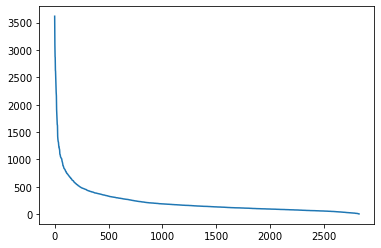

KCab-sc 828


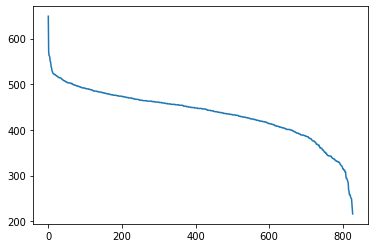

KCg 701


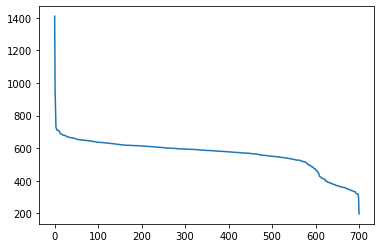

LC10 448


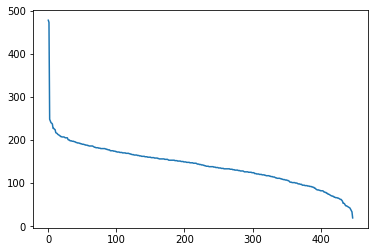

MC61 346


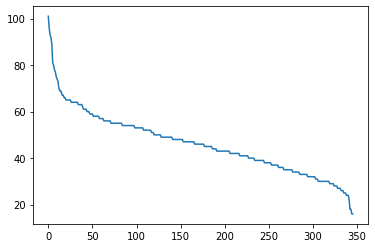

KCa'b' 336


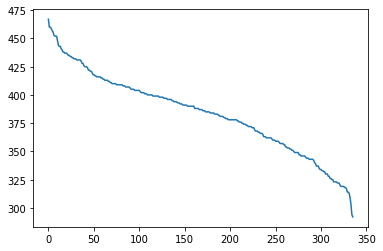

LC12 226


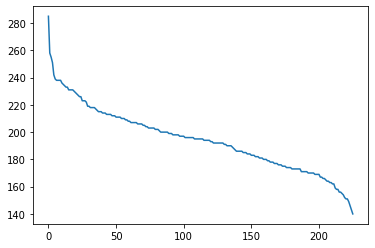

LC17 186


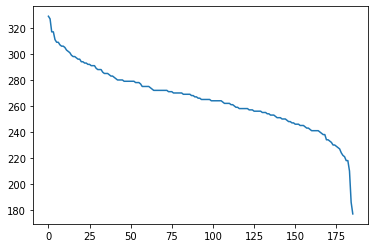

olfactory LN 175


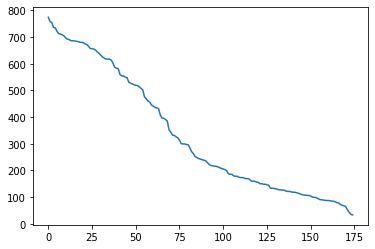

LC9 135


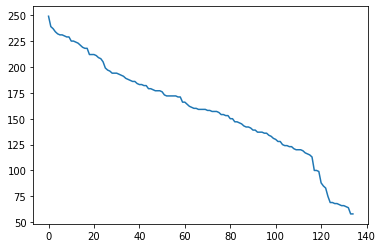

MC64 121


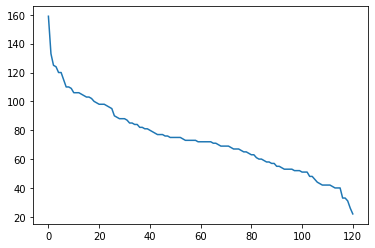

PFNp_a 115


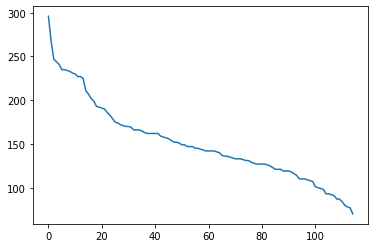

PFNp_b 114


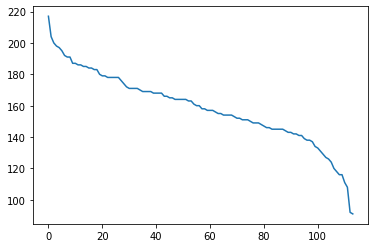

LPC1 113


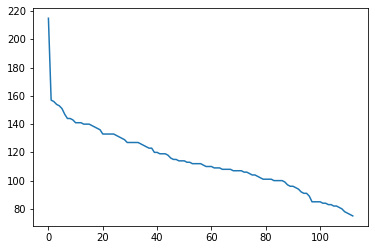

LLPC3 110


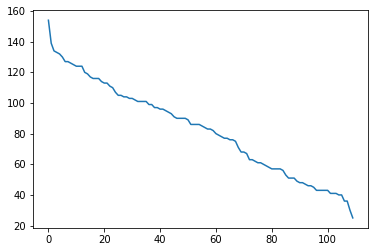

LC18 103


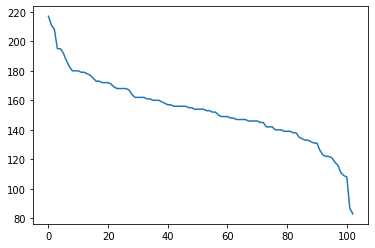

LLPC2c 92


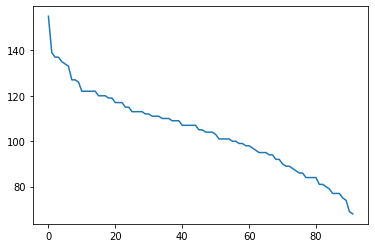

LPLC2 85


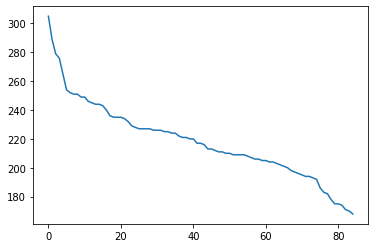

LC16 83


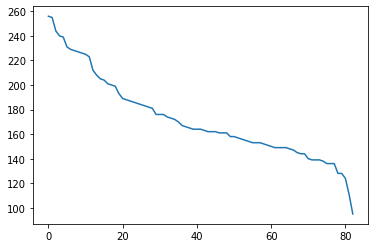

LC13 81


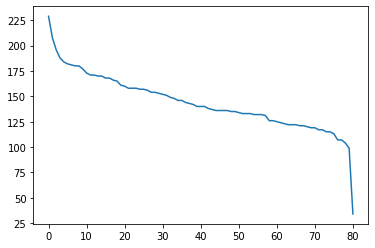

LC21 75


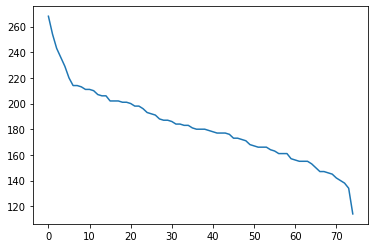

LC4 71


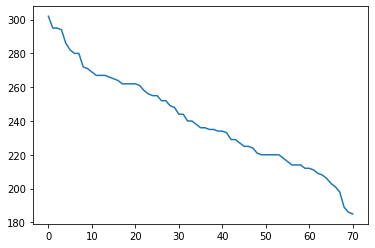

LC24 70


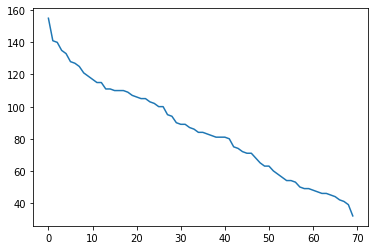

LC11 70


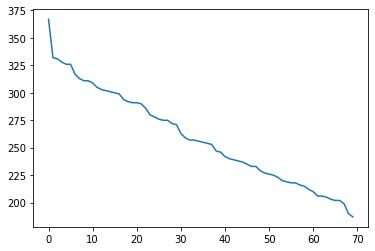

olfactory multi vPN mlALT 69


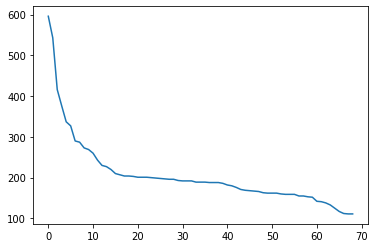

LC20 69


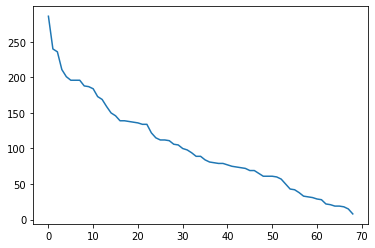

KCab-p 62


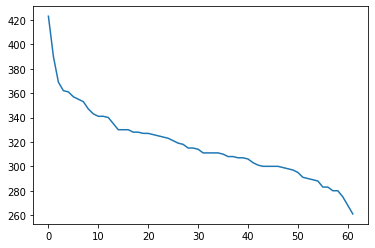

LC15 62


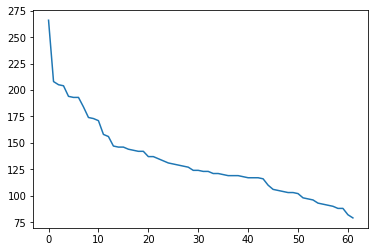

LPC2 62


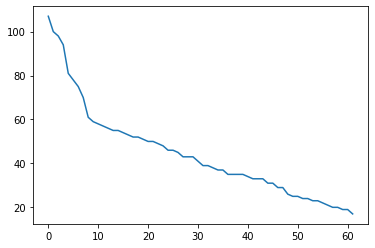

LC6 61


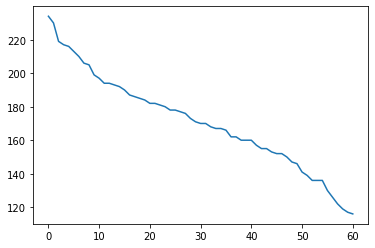

FQ12_a 60


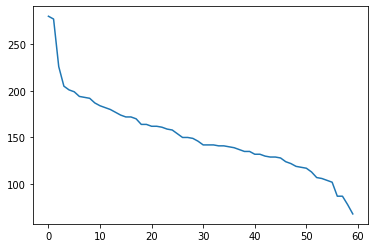

LPLC1 60


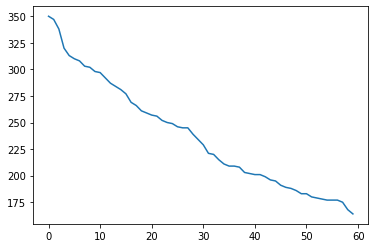

LLPC2b 60


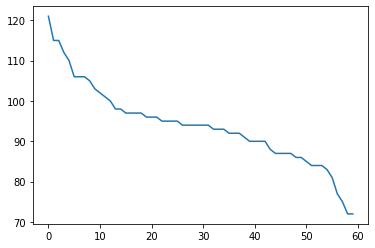

LLPC2a 59


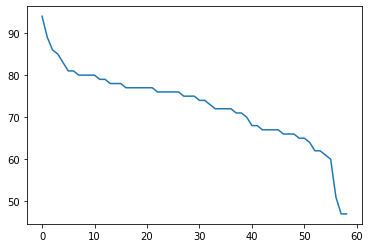

Delta0N 58


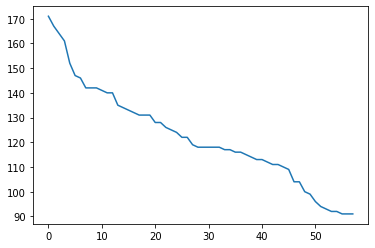

PFNa 58


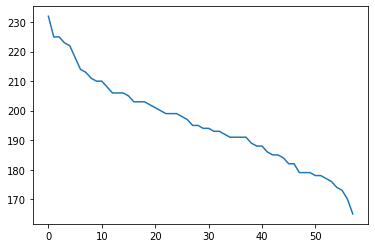

Delta0A_a 56


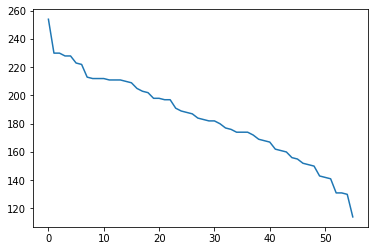

FQ12_b 51


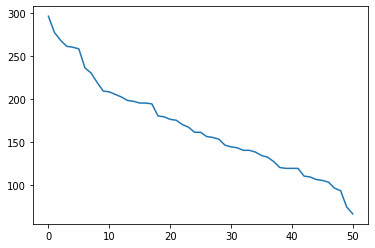

Delta0L 47


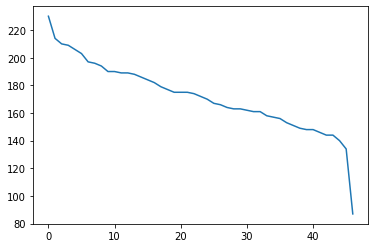

PFNp_c 46


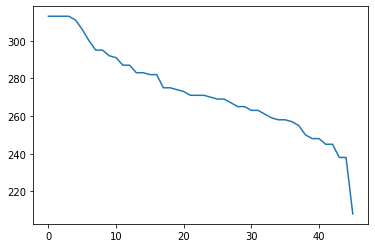

EPG 46


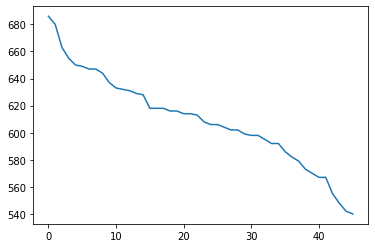

LPLC4 46


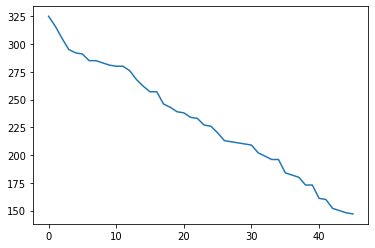

LLPC1 44


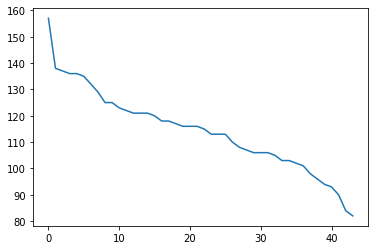

MC62 43


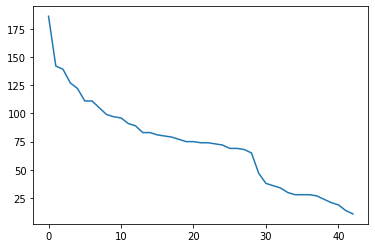

PAM01 42


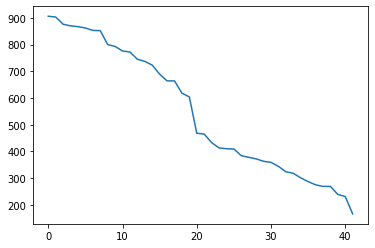

FQ8 42


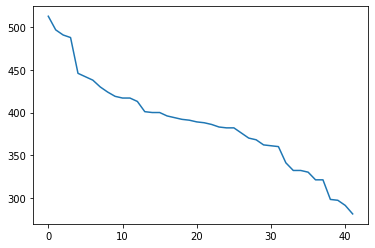

ON 41


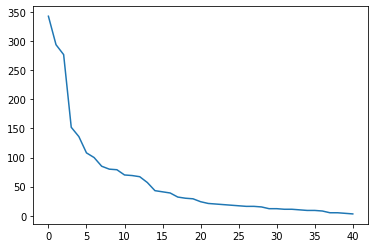

LC26 41


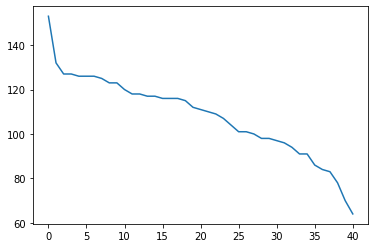

olfactory multi lvPN mALT 40


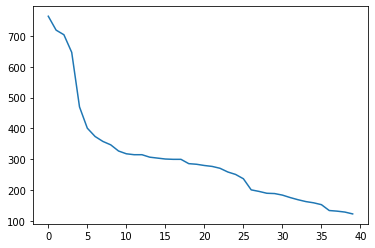

PFNd 40


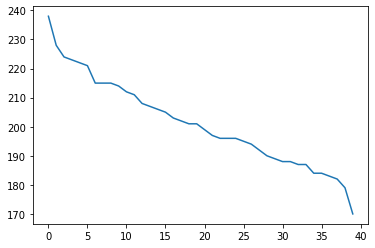

FQ6_b 38


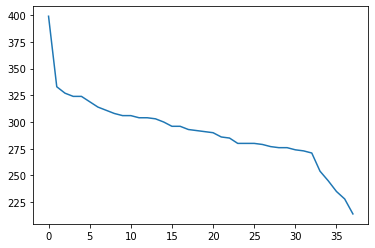

FQ7_d 37


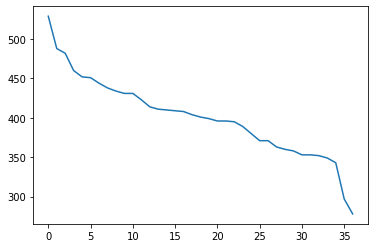

Delta0M 37


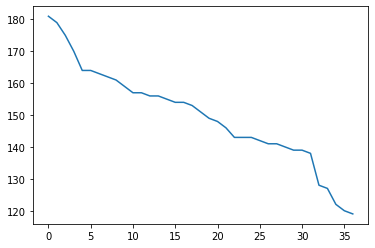

FQ6_a 37


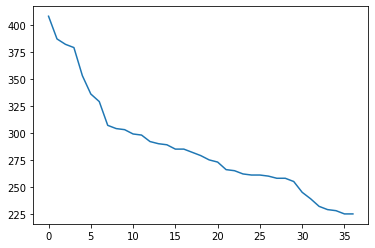

LC22 36


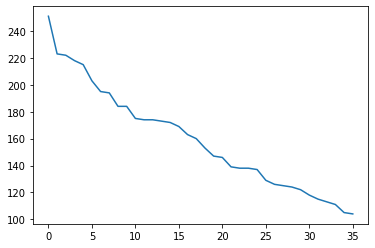

FQ9_a 35


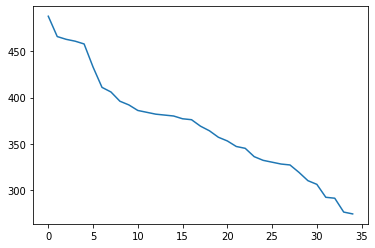

Delta0C 33


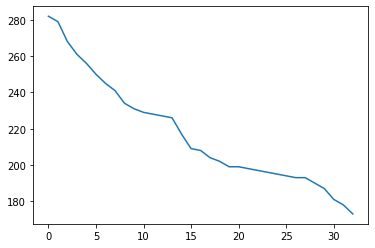

FQ6_d 32


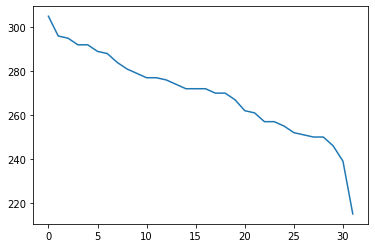

Delta7_a 32


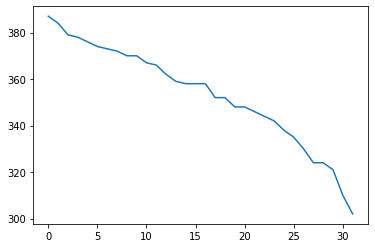

FQ10_b 31


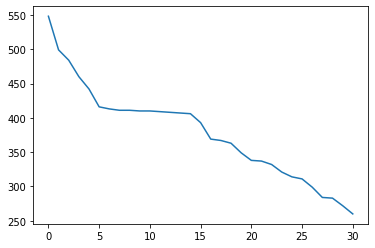

Delta6K 31


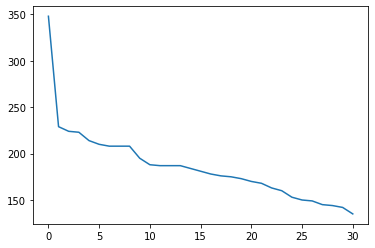

LC25 30


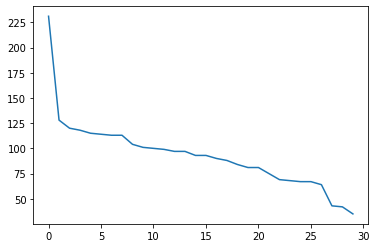

FQ10_a 29


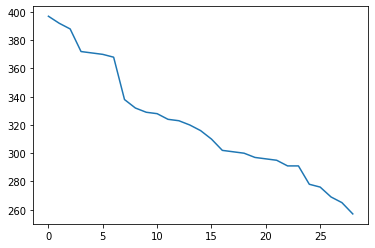

PAM08_a 29


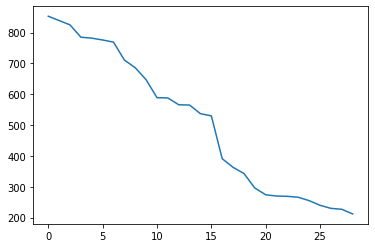

Delta6J 29


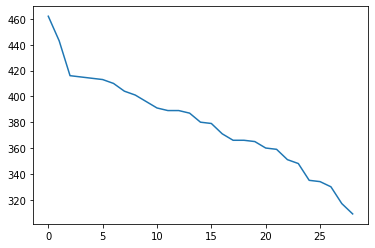

PFR_a 29


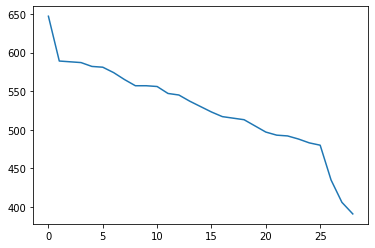

Delta0D 28


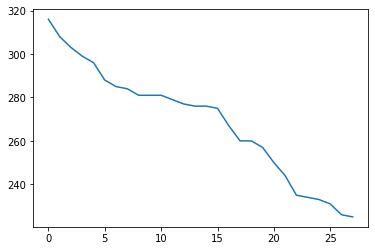

PAM04 28


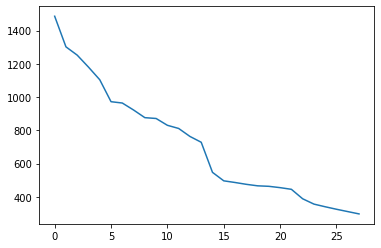

TuBu5 28


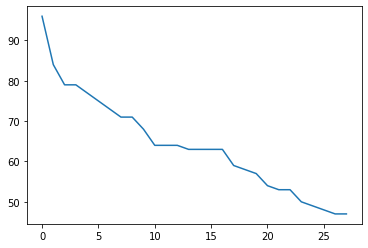

PFNm_a 27


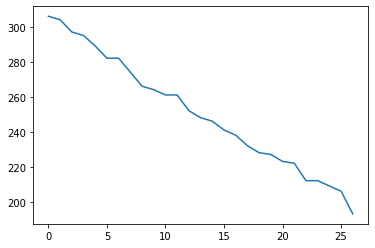

Delta0J 26


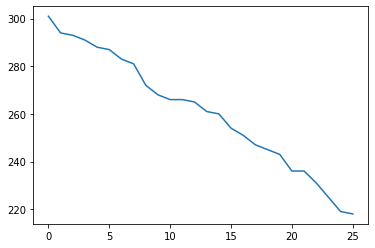

FQ9_b 25


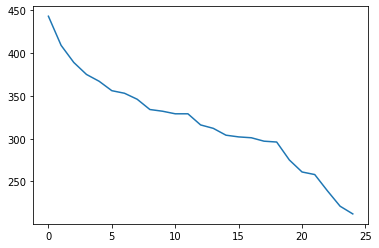

R4d_b 25


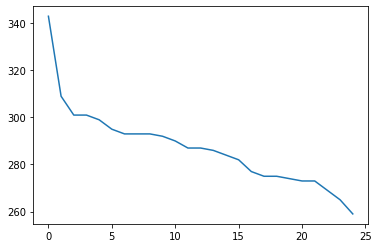

PFL3 24


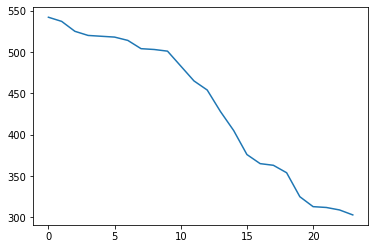

PAM05_a 24


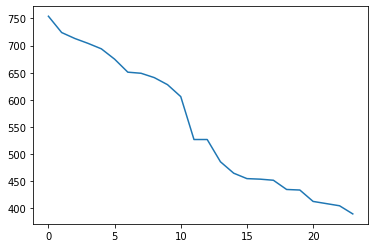

IbSpsP 24


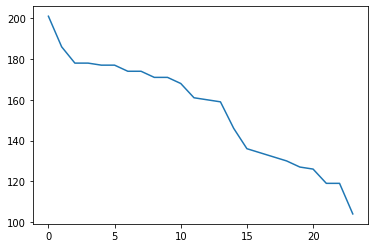

PVL02x_pct 24


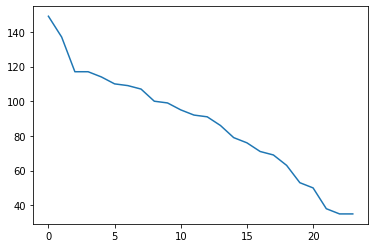

PAM12 23


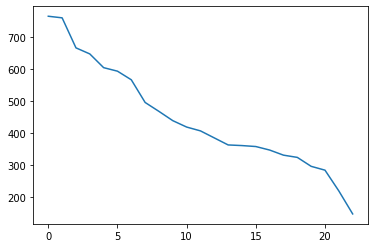

TuBu2 23


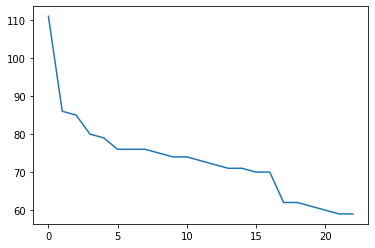

FQ11_b 22


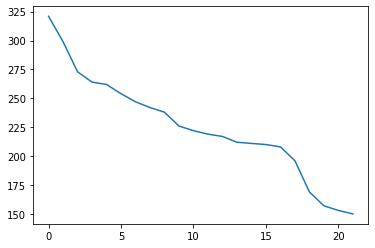

PEN_b(PEN2) 22


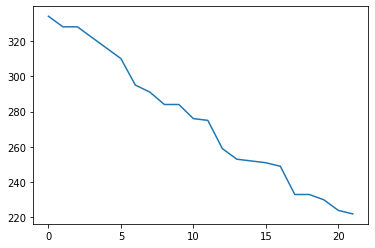

R3m 22


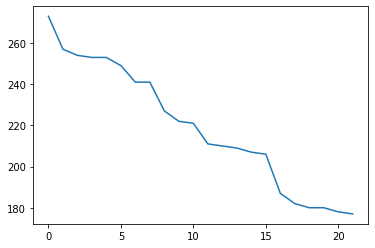

LC31 21


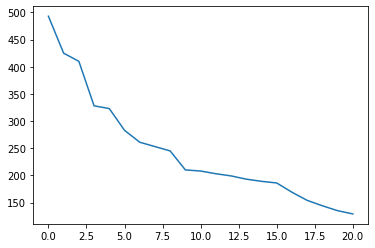

ADM01e_pct 20


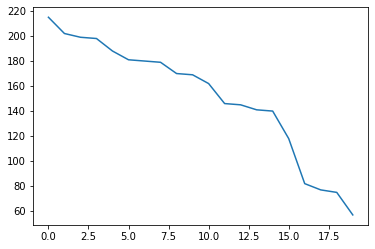

Delta6C 20


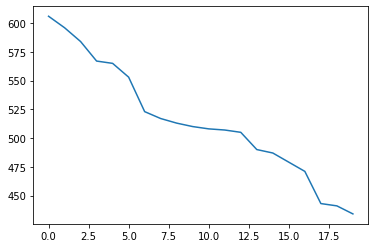

PFNv 20


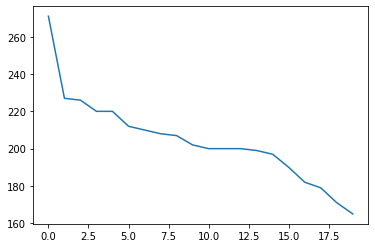

PEN_a(PEN1) 20


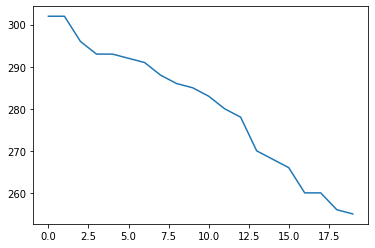

R5 20


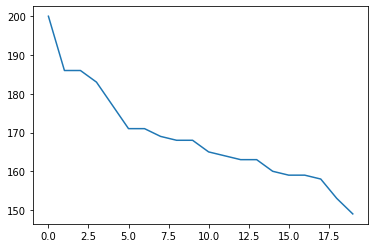

R3d_a 20


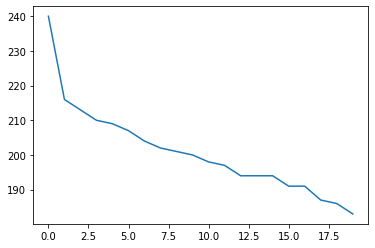

PVL02v_pct 20


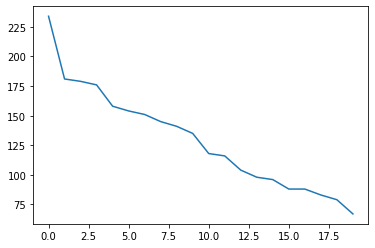

LC14 20


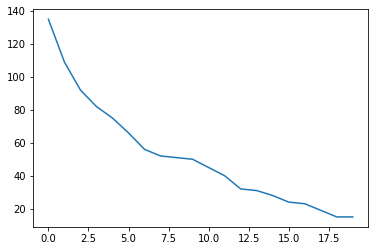

Delta0B 19


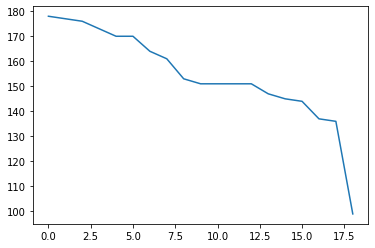

PAM02 19


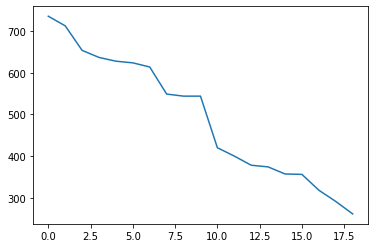

PAM06 19


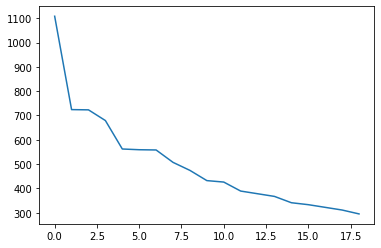

Delta0E 19


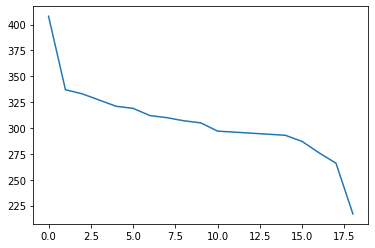

Delta6B 19


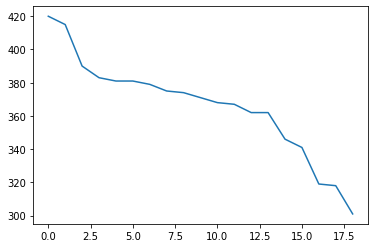

R4d_a 19


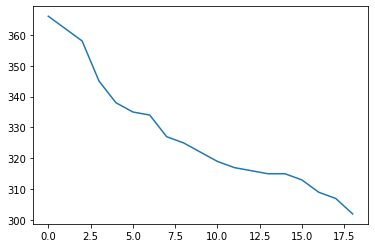

aMe5 19


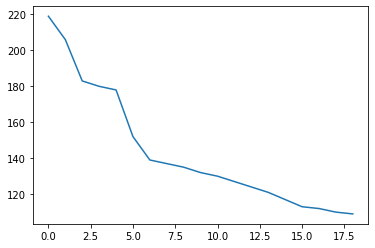

PVL02i_pct 19


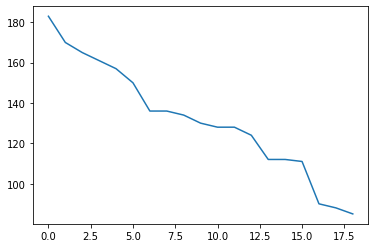

ADL16j_pct 18


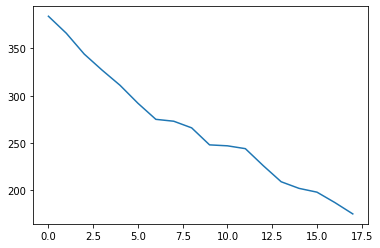

FQ4_a 18


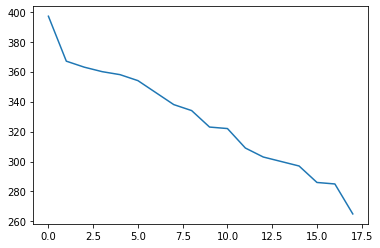

FQ4_b 18


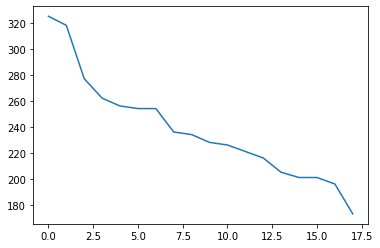

FQ7_b 18


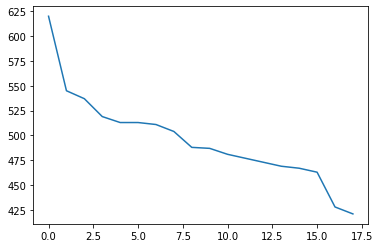

PFGs 18


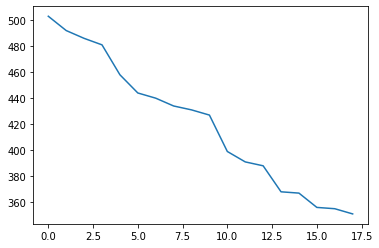

Delta6I 18


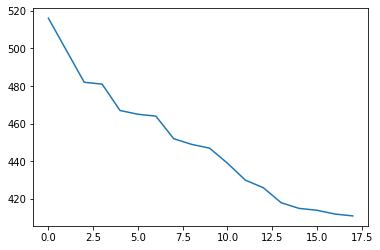

EQ5 18


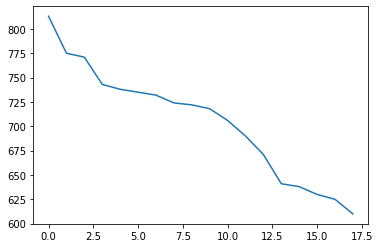

FB5V 18


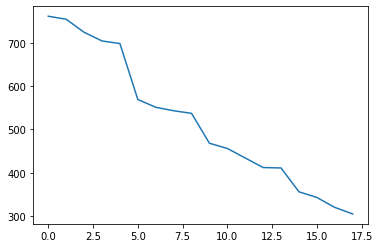

FQ7_a 18


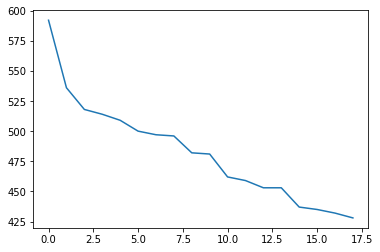

PEG 18


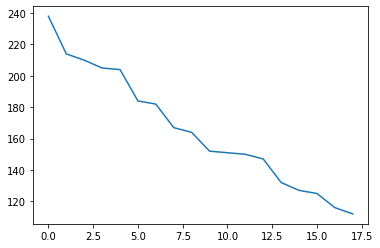

PFNm_b 17


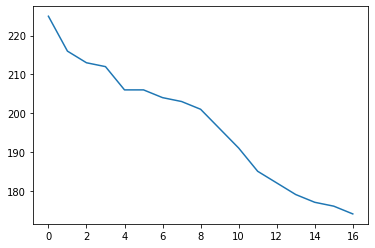

FQ6_c 17


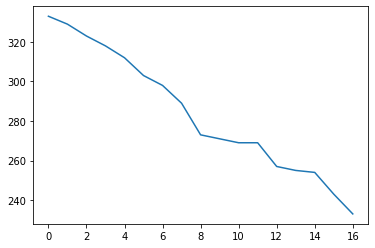

LC27 17


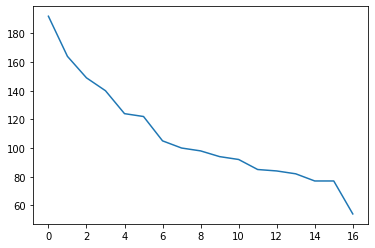

PAM08_b 16


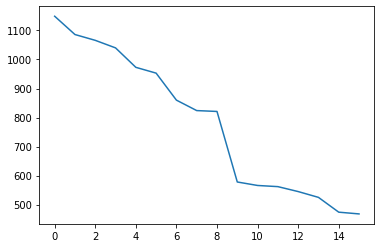

PFR_b 16


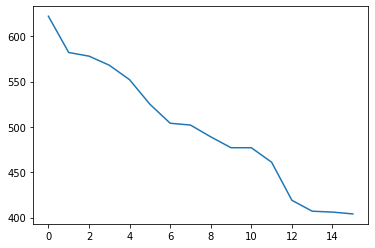

FB4Z 16


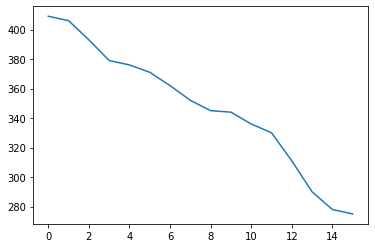

Delta0I 16


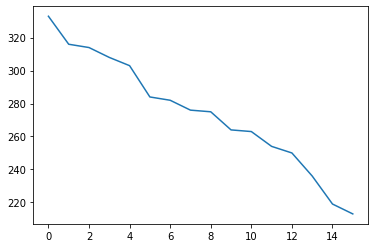

PAM14 16


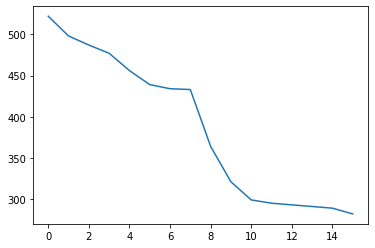

LC28a 16


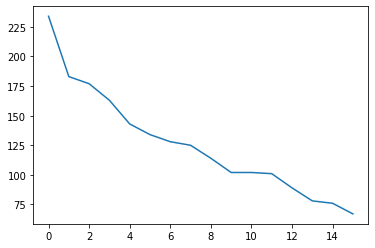

LC28b 16


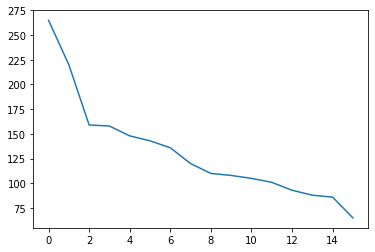

R1_a 16


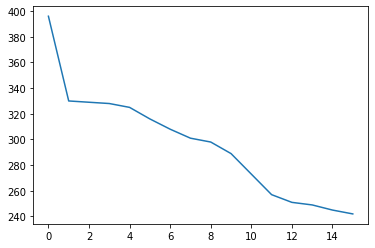

ADL13q_pct 15


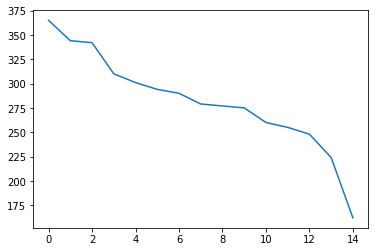

FQ11_a 15


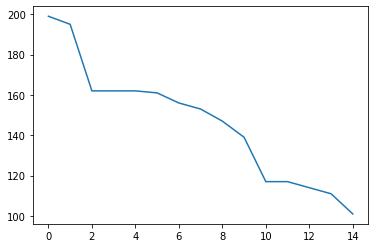

FQ7_c 15


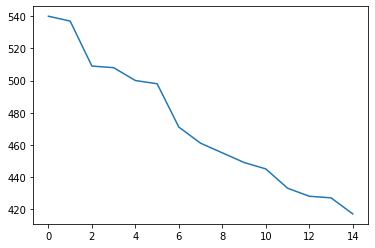

ADL11t_pct 15


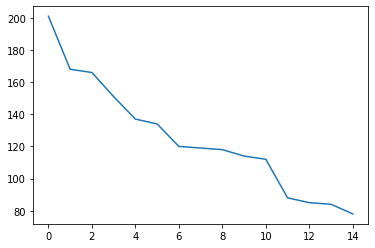

Delta0H 15


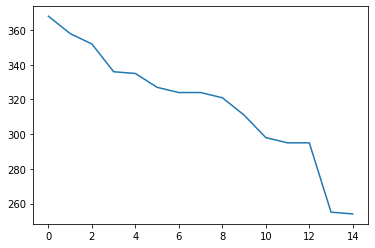

VS 15


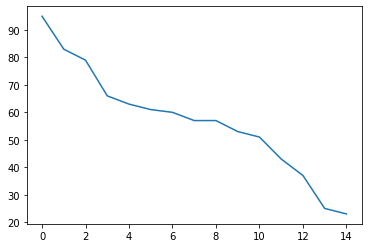

LT52 15


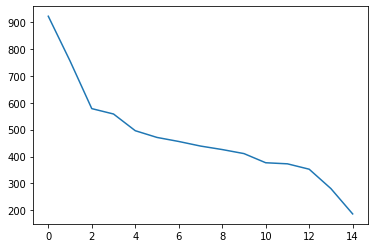

LC29 15


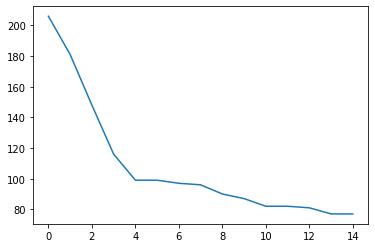

SA3 14


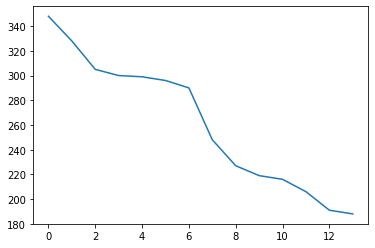

PAM10 14


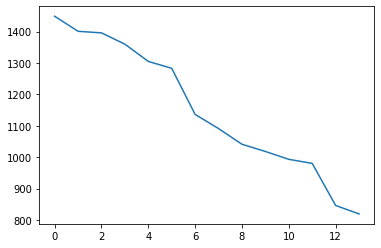

PFL1 14


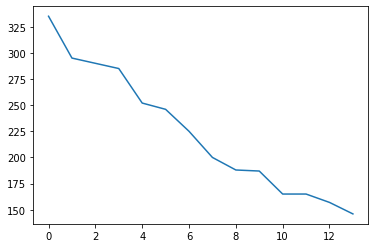

PAM11 14


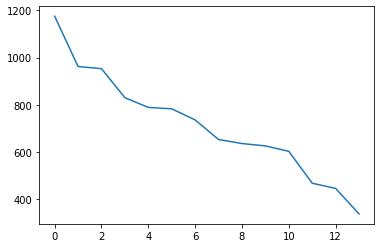

PAM13 14


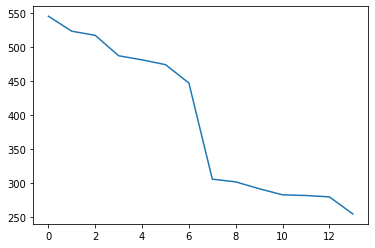

R1_b 14


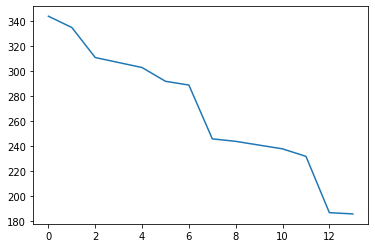

AVL04f_pct 14


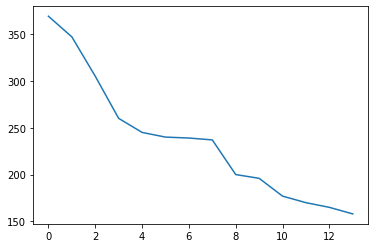

R3d_c 14


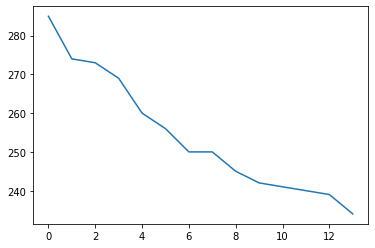

PDM07f_a_pct 13


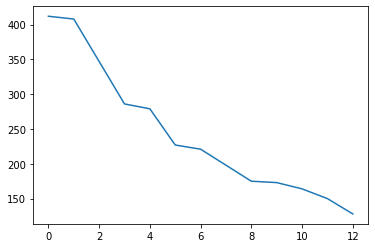

AVL07h_pct 13


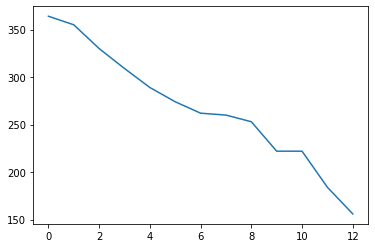

PDL10m_pct 13


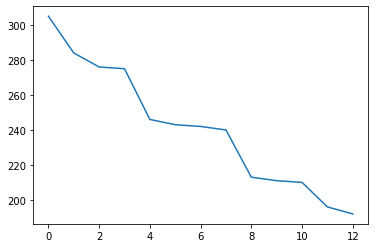

olfactory multi lPN mALT 13


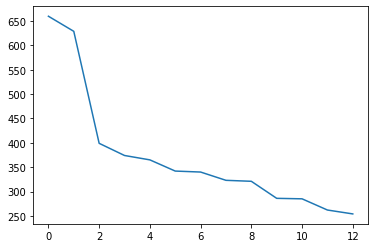

PAM05_b 13


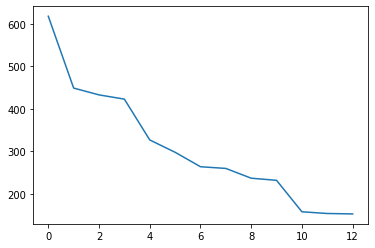

PAM07 13


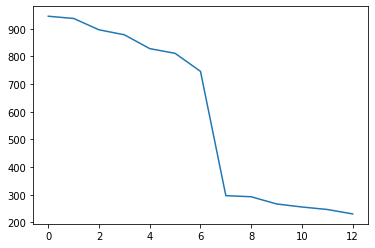

PVL03k_pct 13


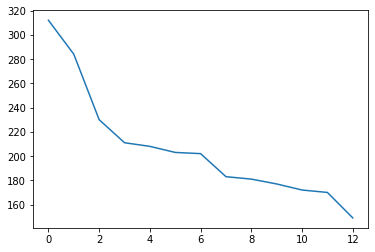

PDM18g_pct 12


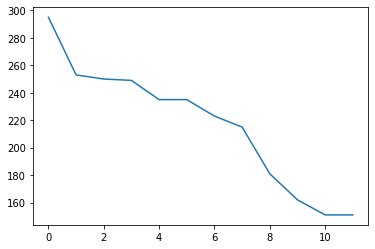

FB7I 12


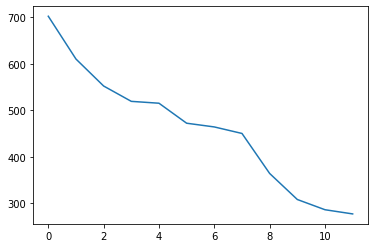

PDM05j_c_pct 12


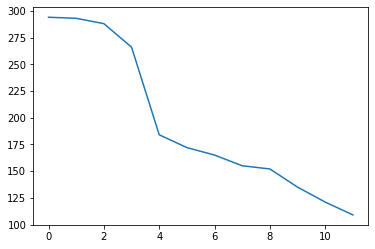

Delta6F_b 12


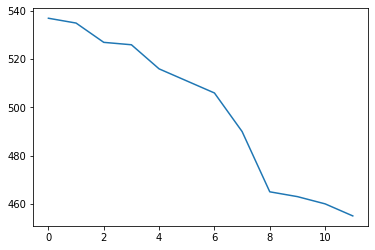

PFL2 12


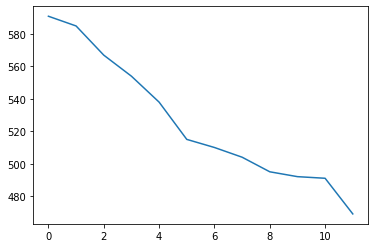

Delta0G_b 12


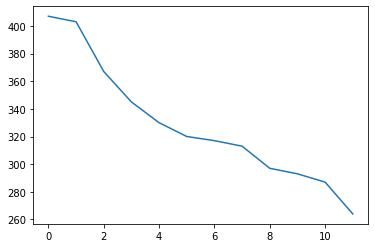

Delta6A 12


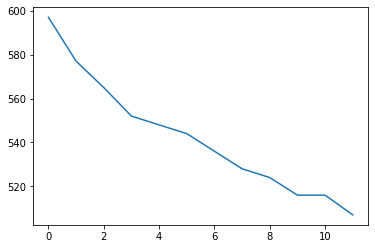

R2_a 12


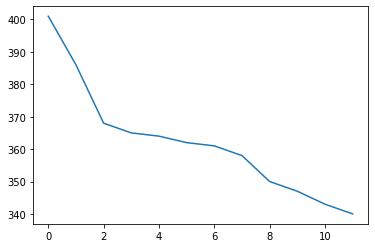

R3p_b 12


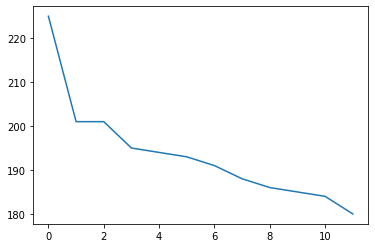

PAM09 11


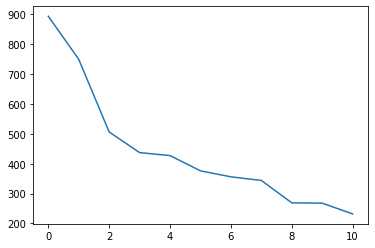

Delta0K 11


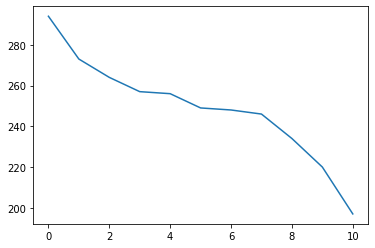

PDL05c_pct 11


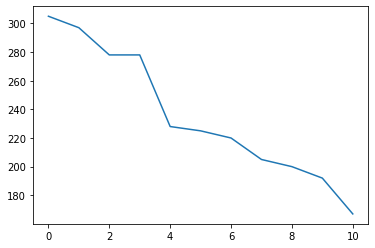

PAM03 11


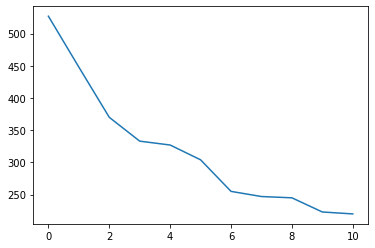

Delta0F 11


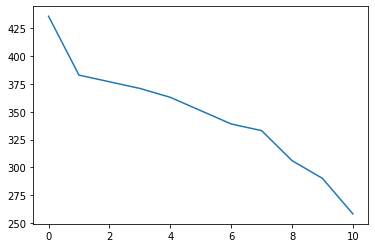

Delta0G_a 11


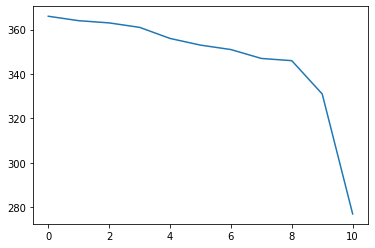

ADL06a_pct 11


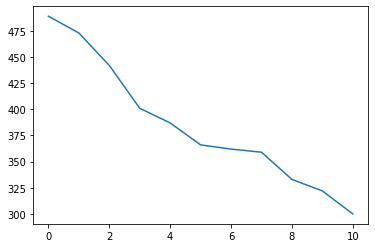

ADL08i_pct 11


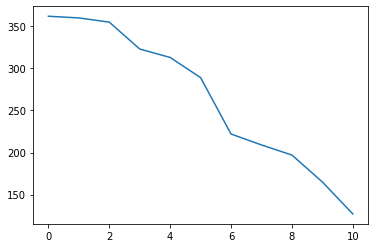

R3w_b 11


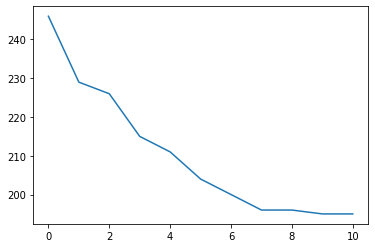

PVM05p_pct 11


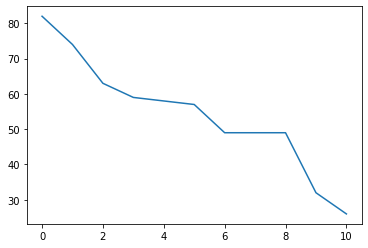

PDM18a_b_pct 10


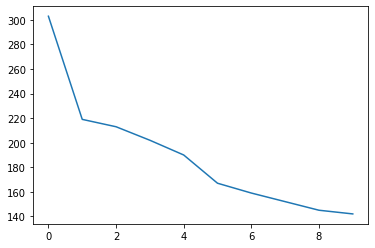

PDM12a_pct 10


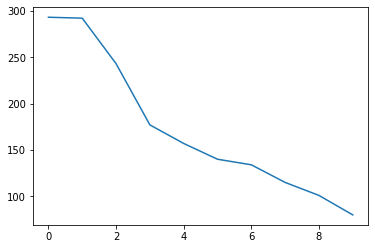

PDL07ob_pct 10


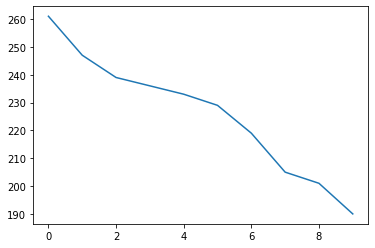

PDL22f_pct 10


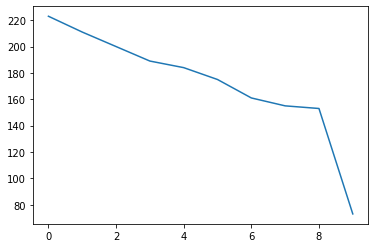

ADL04n_pct 10


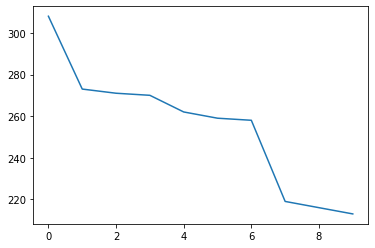

FB4F_a 10


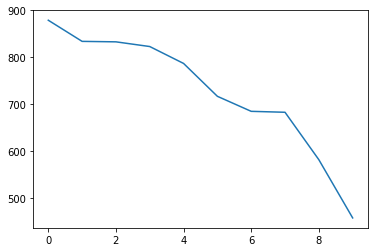

FB4E 10


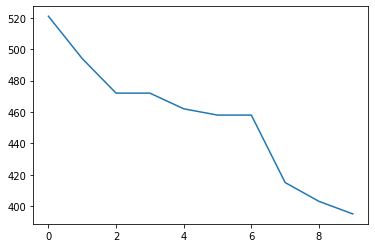

TuBu6 10


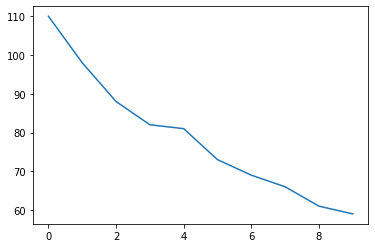

R4m 10


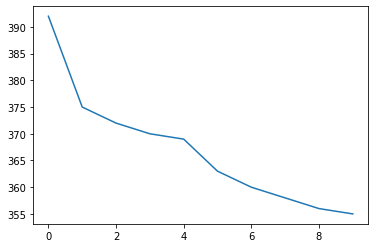

Delta7_b 10


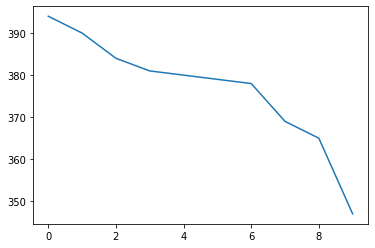

R3d_b 10


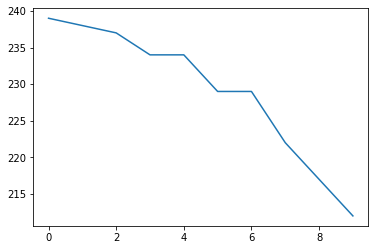

R3a_a 10


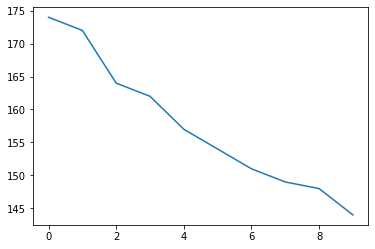

PVM04n_pct 10


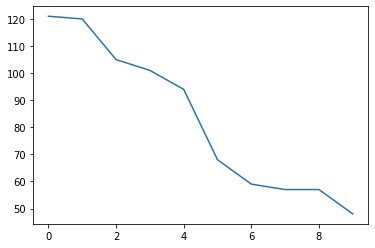

FB3C 9


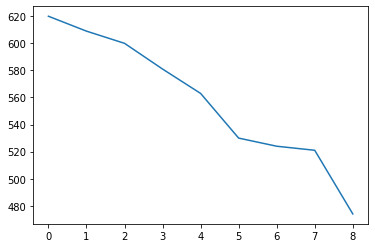

PDM12c_pct 9


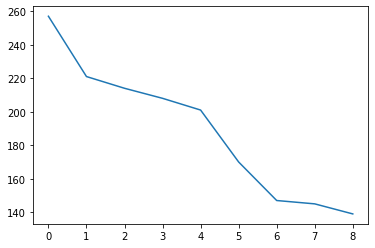

Delta0A_b 9


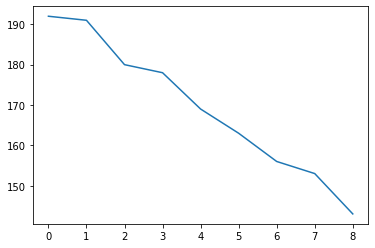

_PDM08r_pct 9


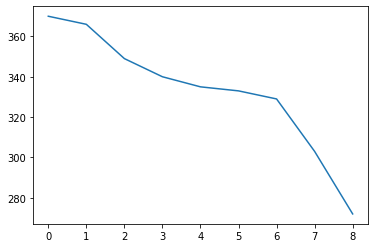

PDM07f_b_pct 9


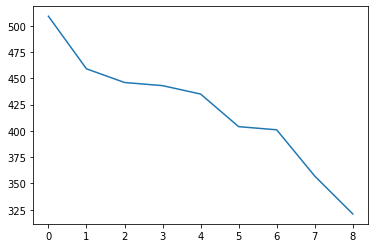

FB7G 9


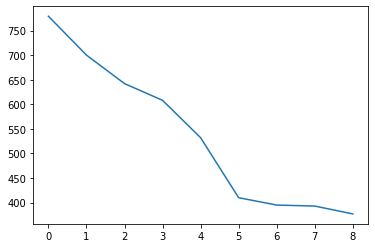

ADM04u_pct 9


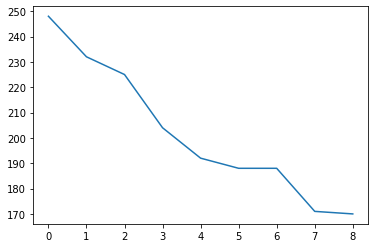

AVL07g_pct 9


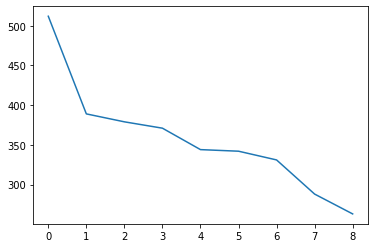

AVL03a_pct 9


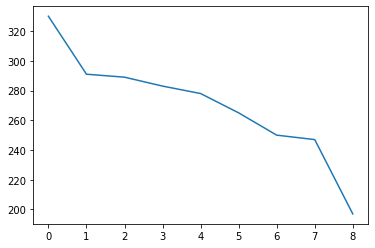

ADL16a_pct 9


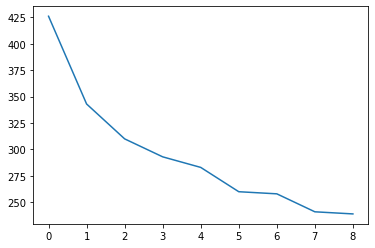

PDM16h_pct 9


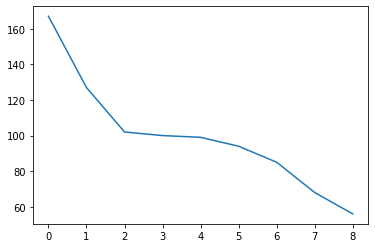

ADL01x_pct 9


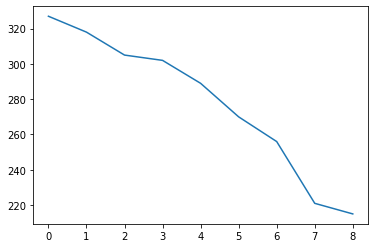

PDL07oa_pct 9


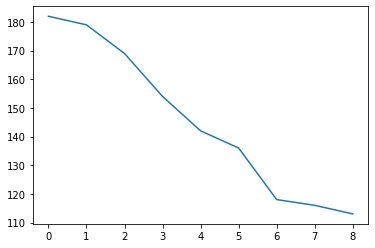

ADM01g_a_pct 9


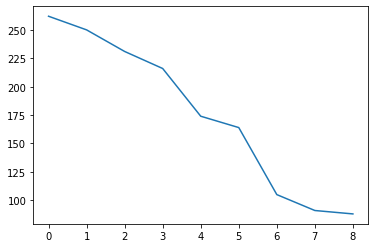

Delta6H_b 9


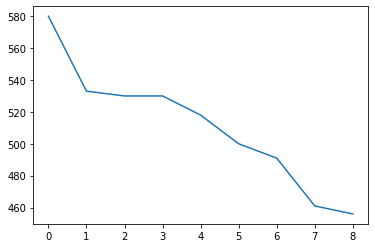

FQ9_c 9


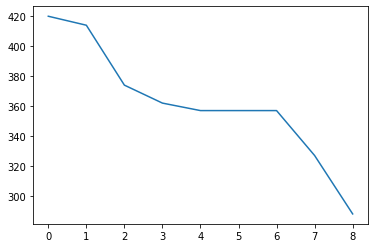

PDM13r_pct 9


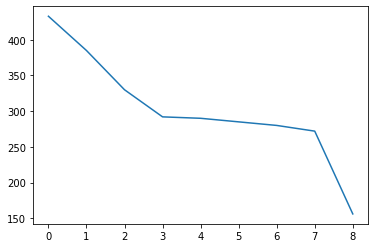

PDL14d_pct 9


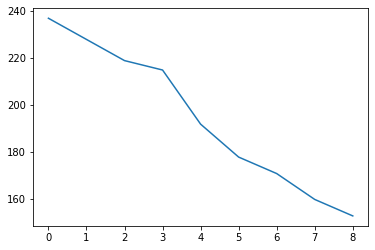

AVL08k_pct 9


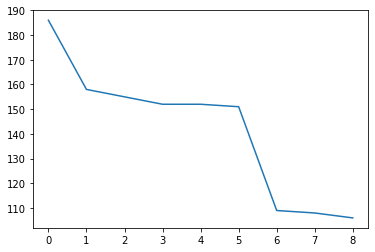

LC28d 9


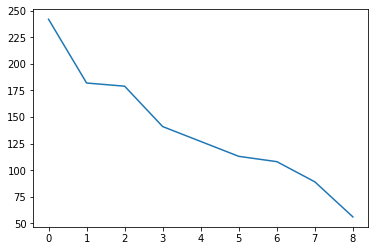

olfactory multi adPN mALT 9


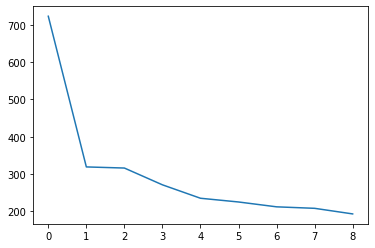

R3w_a 9


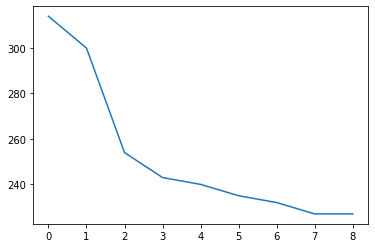

PVM01z_pct 9


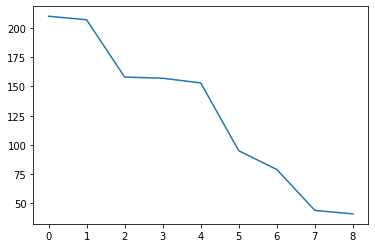

AVL01lh_pct 9


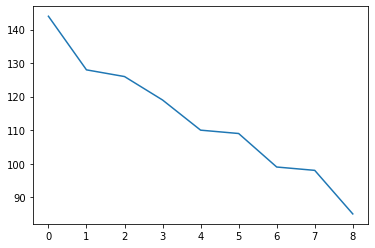

FB7F_b 8


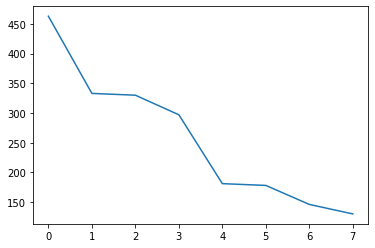

Delta6E 8


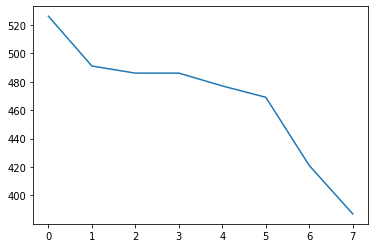

FB7F_a 8


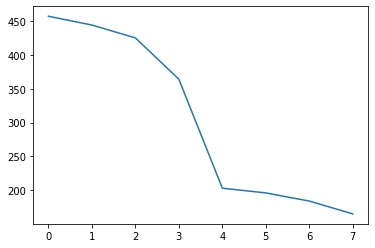

Delta6F_a 8


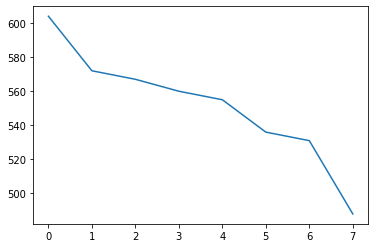

Delta6D 8


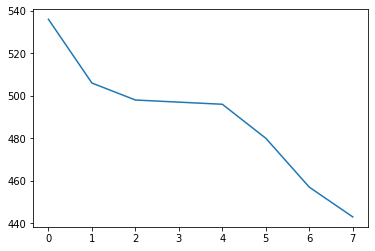

PDL19e_pct 8


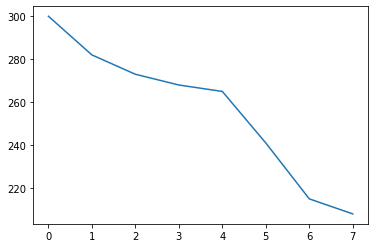

PDM06k_pct 8


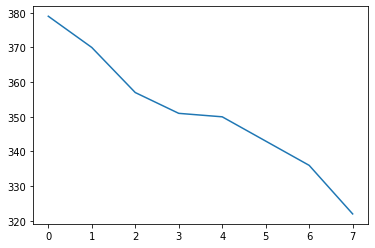

ADL16h_pct 8


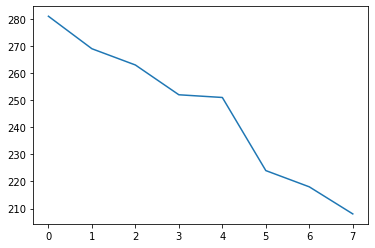

PDM08e_pct 8


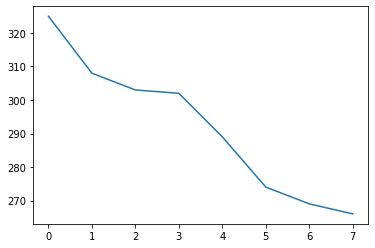

ADM04m_pct 8


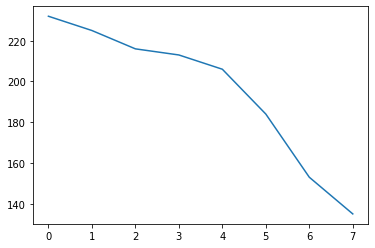

IPC_a 8


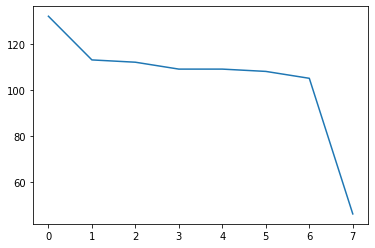

PDM11i_pct 8


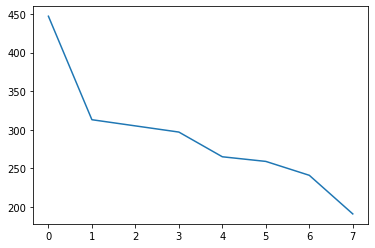

AVL12p_pct 8


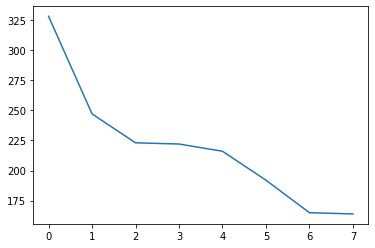

AVL03v_pct 8


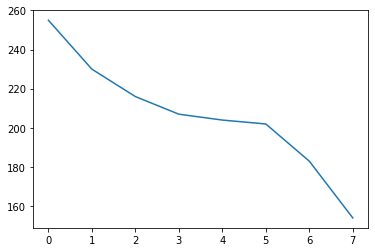

AVL07j_pct 8


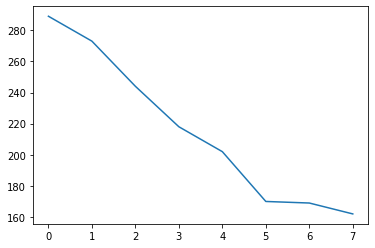

IPC_b 8


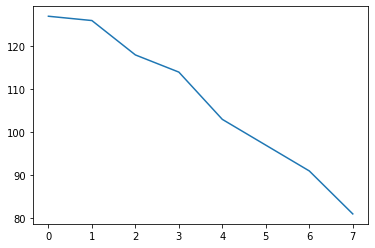

FB5G 8


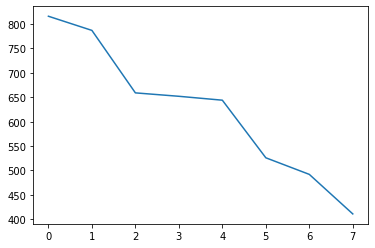

ADL07oh_pct 8


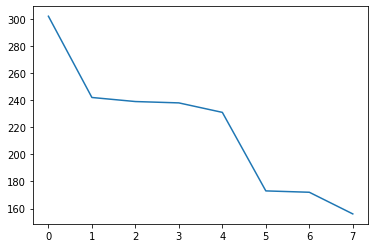

FB6J 8


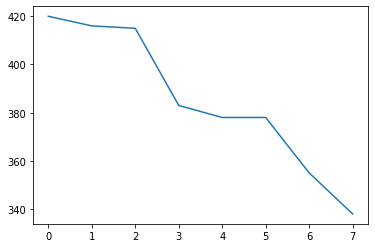

ADM07b_pct 8


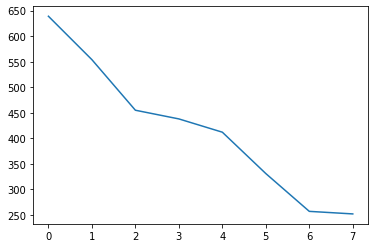

FB5W 8


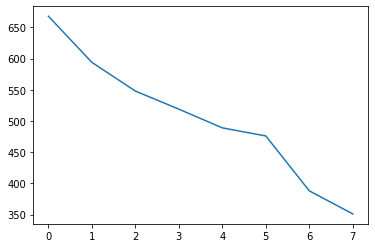

aSP10A 8


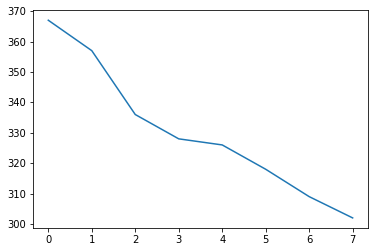

Delta6H_a 8


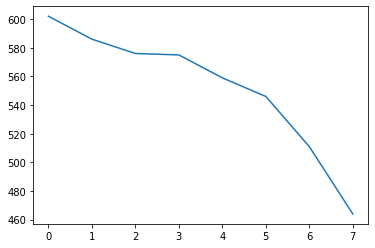

Delta6G 8


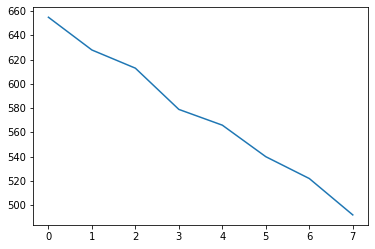

ADM07h_pct 8


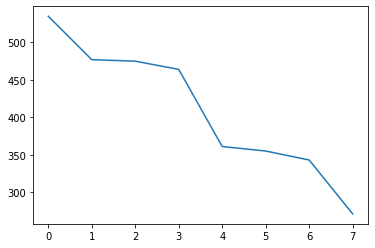

ADL05q_c_pct 8


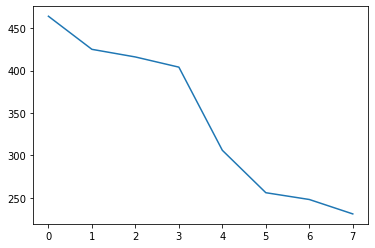

PDM08f_pct 8


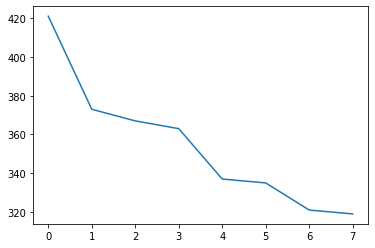

FB4A 8


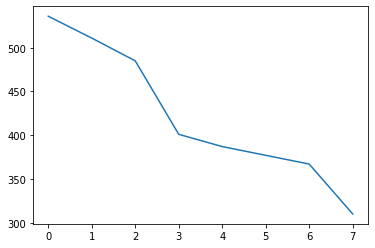

AVL01q_pct 8


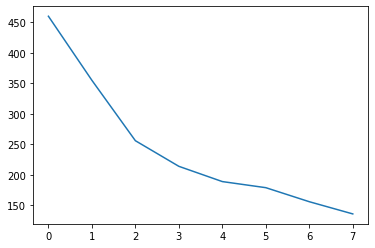

R3a_b 8


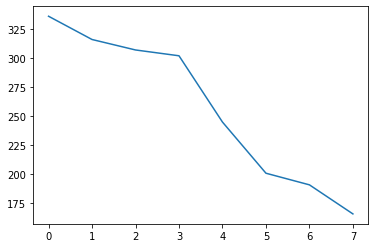

ADL06h_pct 8


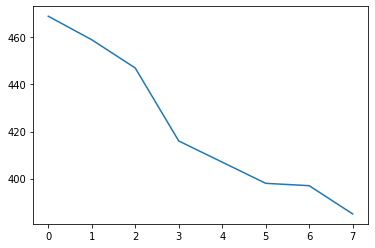

PDL12v_b_pct 8


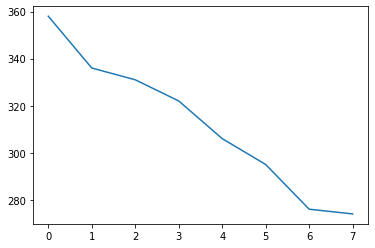

LT51 8


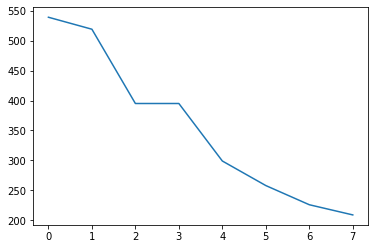

ADM06b_a_pct 8


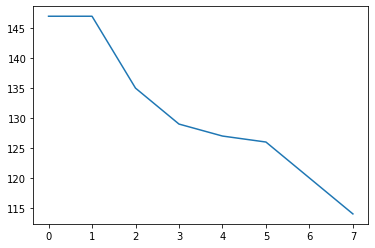

PDM14p_pct 8


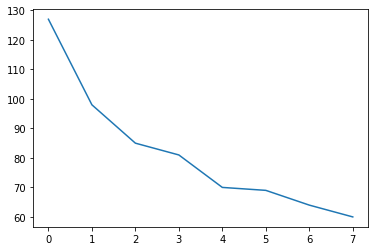

PVM07d_pct 8


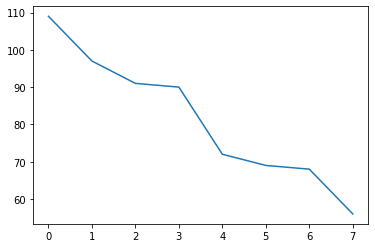

ADM03i_pct 8


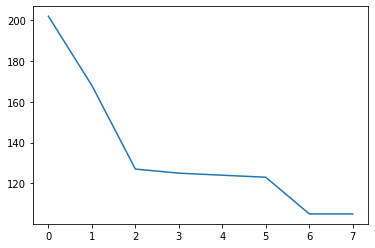

PDL09k_pct 8


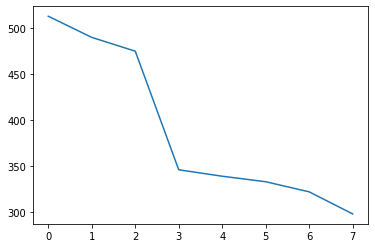

PDL11v_pct 7


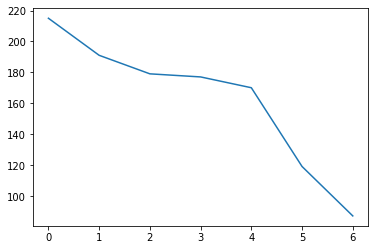

AVM07t_pct 7


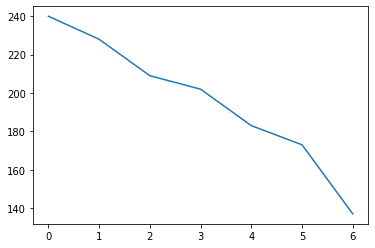

PDL14k_pct 7


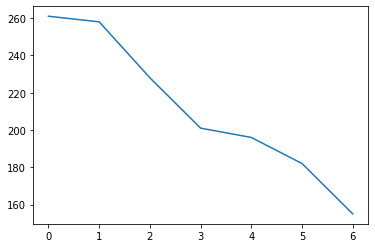

PDM10v_a_pct 7


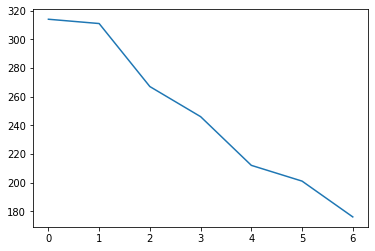

ADL17b_pct 7


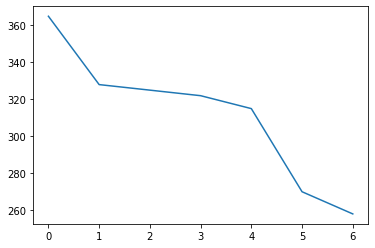

ADL03g_pct 7


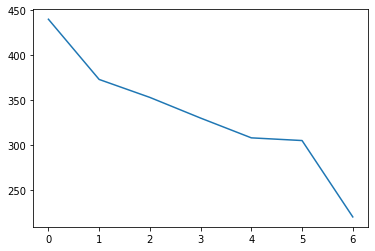

PDL09b_pct 7


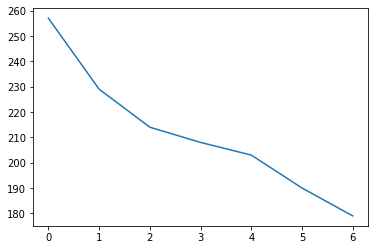

ADM05v_pct 7


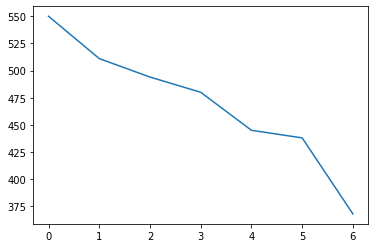

ADL03t_pct 7


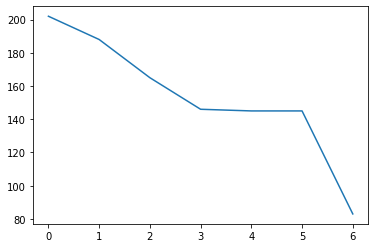

ADL11c_a_pct 7


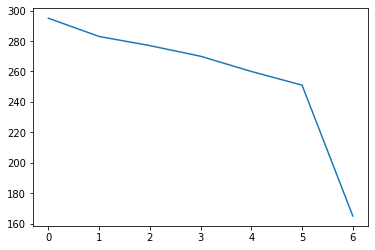

PDM16i_pct 7


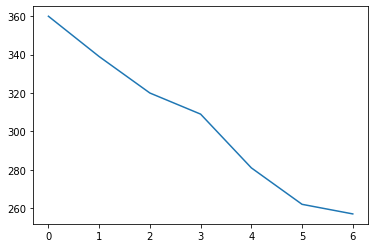

PDM13z_pct 7


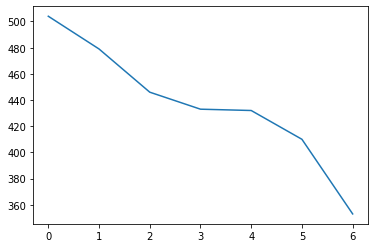

PDM24_pct 7


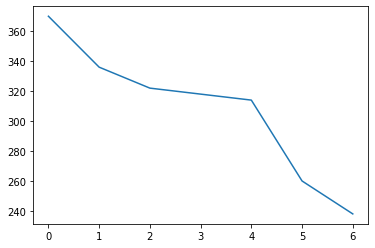

PDL07v_pct 7


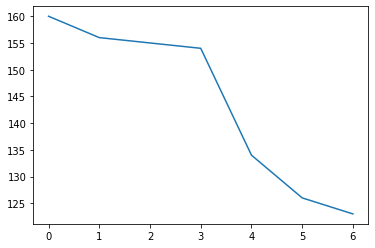

ADL15h_pct 7


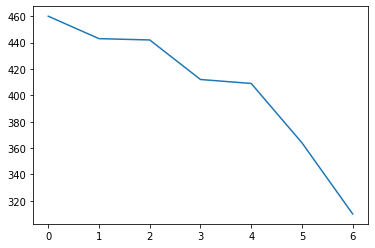

ADM07t_pct 7


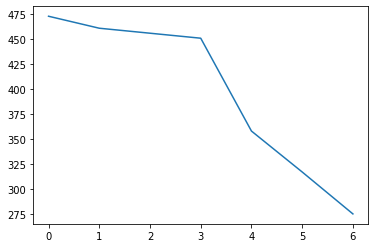

PDL07p_pct 7


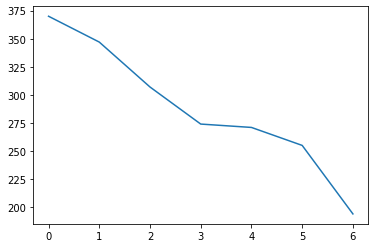

FB5S 7


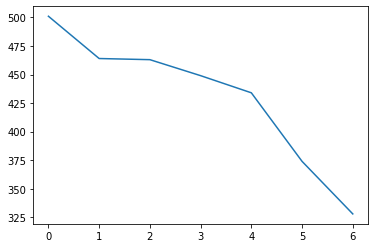

PDL11oi_pct 7


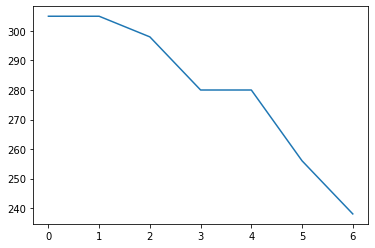

PVL03u_pct 7


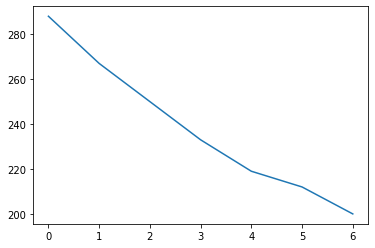

FB4P_b 7


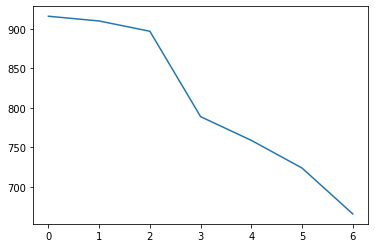

MBON10 7


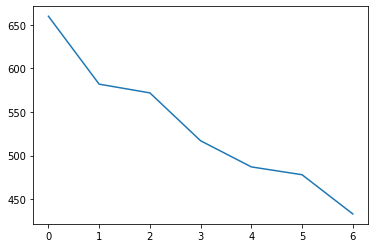

AVM07h_pct 7


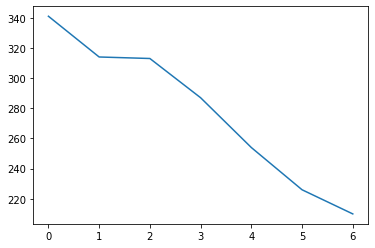

ADL17d_a_pct 7


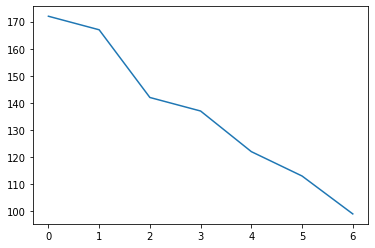

DA1 lPN 7


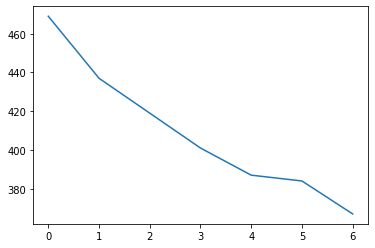

AVL04g_pct 7


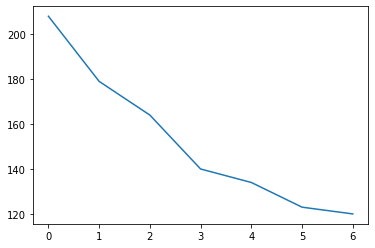

PDL16k_pct 7


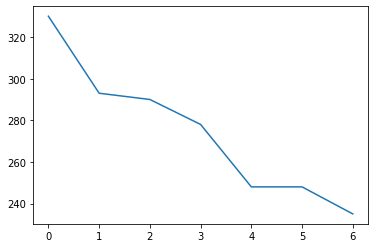

PDM13b_pct 7


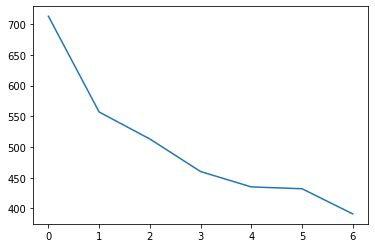

ADL14i_b_pct 7


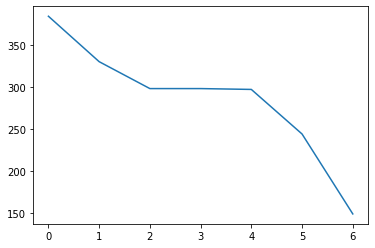

ADL01n_d_pct 7


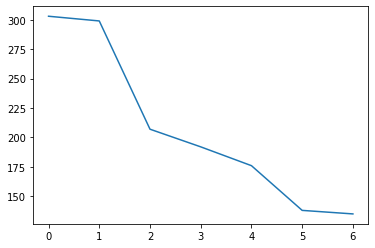

ADL01g_pct 7


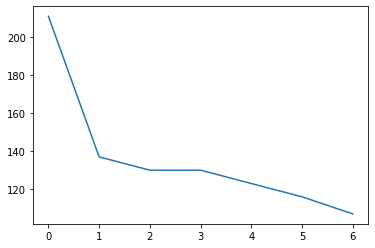

ADL14s_pct 7


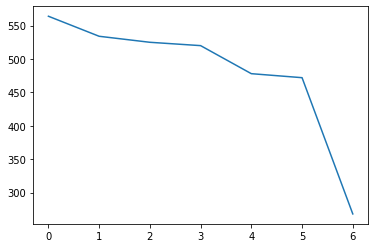

AVL02r_pct 7


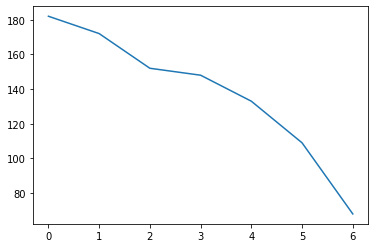

PVM02p_pct 7


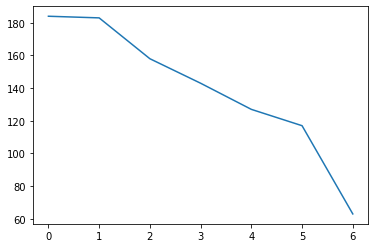

PVM01oh_pct 7


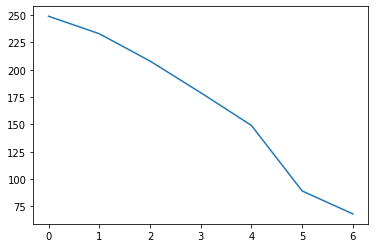

ADM01f_pct 7


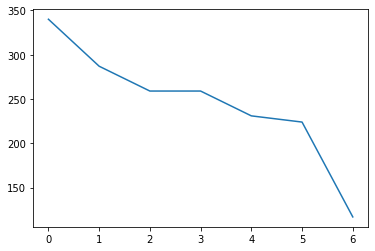

AVL16t_pct 7


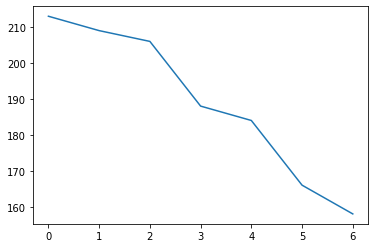

AVL02t_pct 7


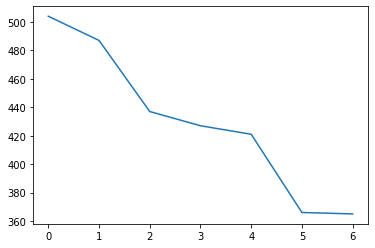

PVM05n_pct 7


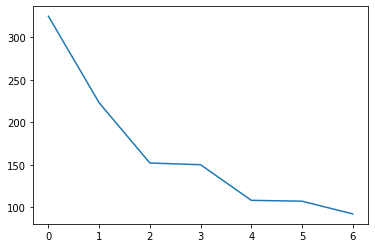

PVM06f_pct 7


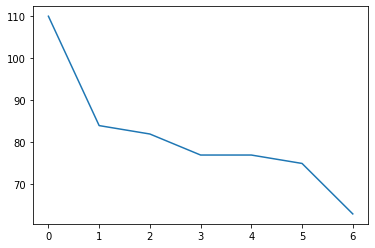

AVL02d_pct 7


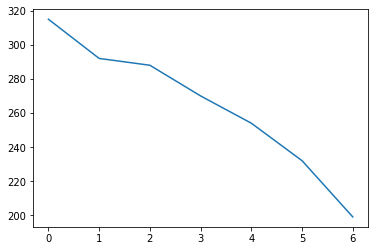

PVL14f_pct 7


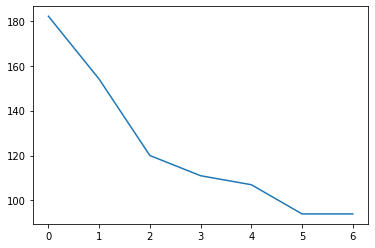

PVL03of_pct 7


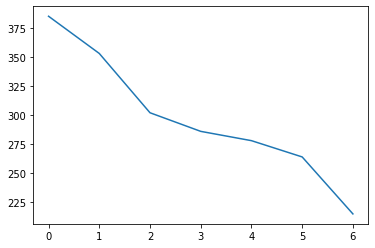

AVM11e_pct 7


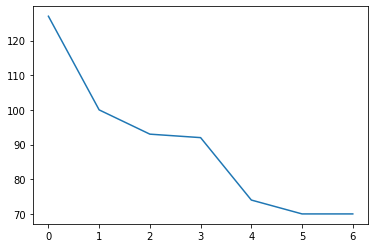

AVL19g_pct 7


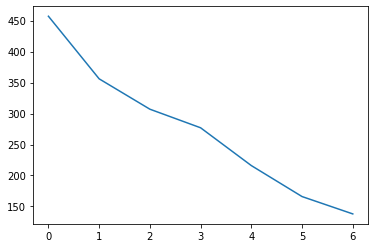

AVL05f_pct 7


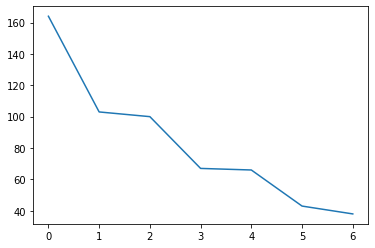

AVM12k_pct 7


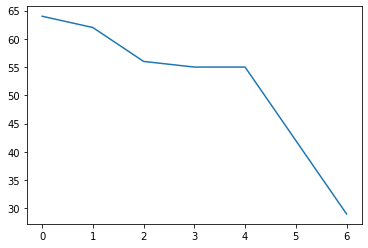

FB9A 6


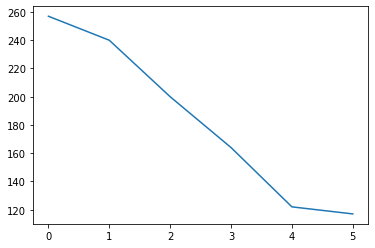

PDL19h_pct 6


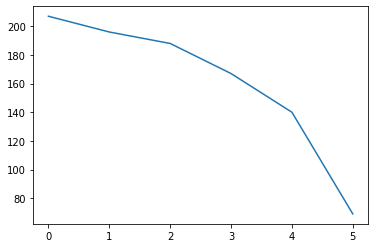

FB9B_d 6


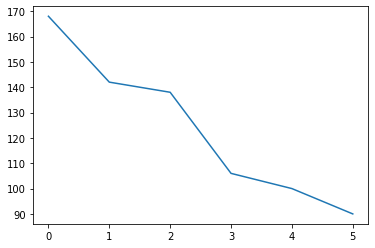

PDM15r_pct 6


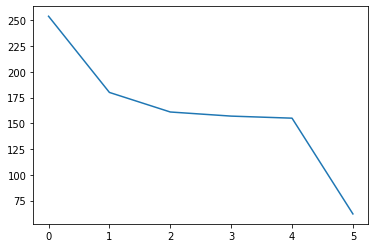

FB7H 6


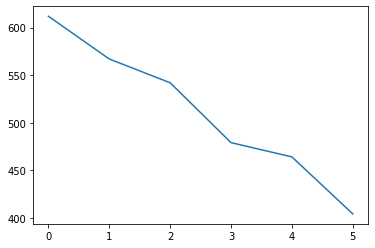

PDM08q_c_pct 6


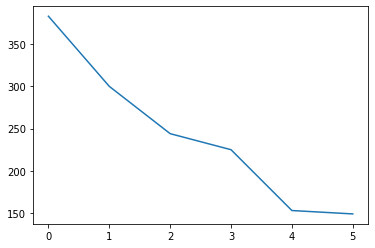

FB7L 6


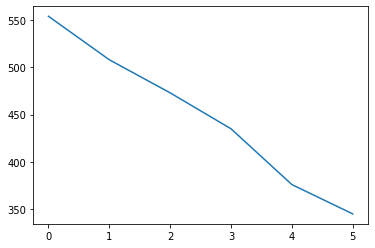

PDL07h_a_pct 6


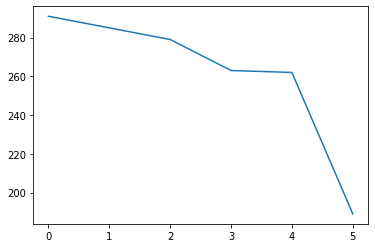

ADL10k_pct 6


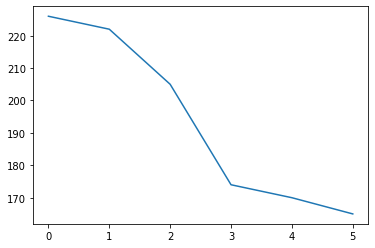

ADL07x_b_pct 6


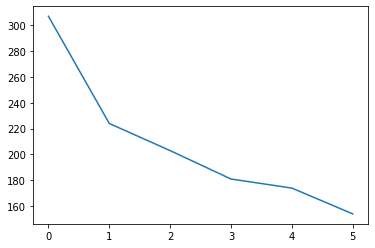

LNd 6


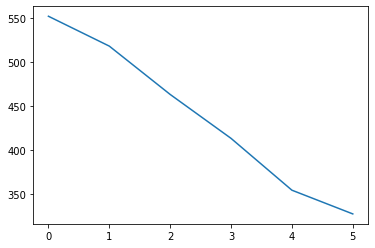

ADL10c_b_pct 6


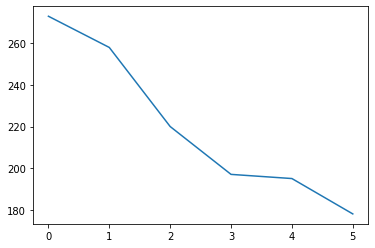

PDL11y_pct 6


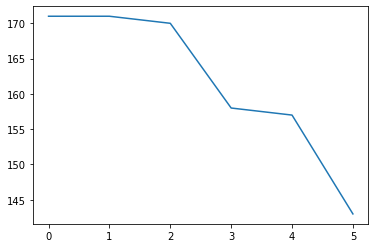

ADL23n_pct 6


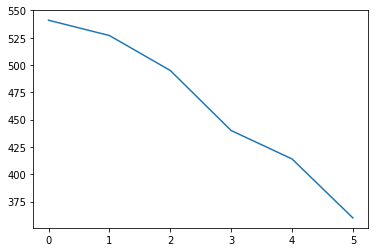

ADL18p_pct 6


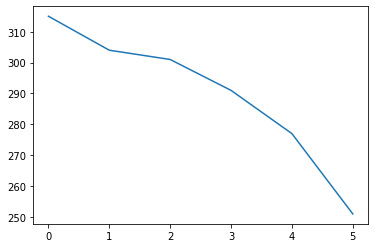

FB6A 6


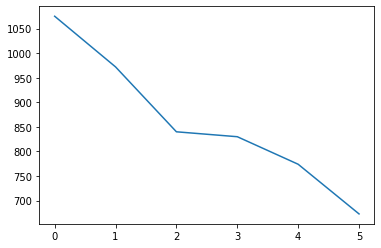

FB2D 6


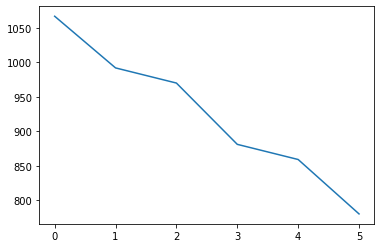

FB2I_b 6


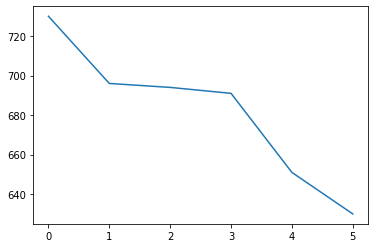

PDL13u_pct 6


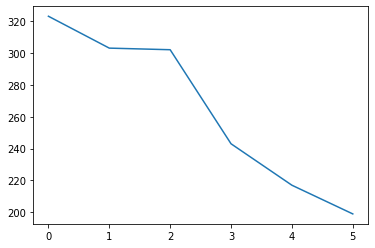

FB9B_e 6


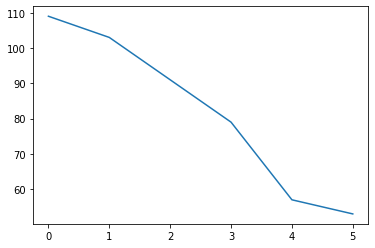

PDL08h_pct 6


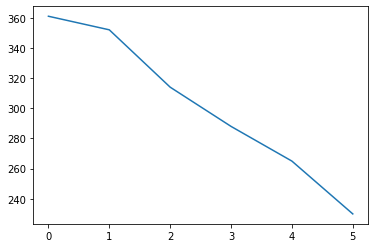

PDL10h_pct 6


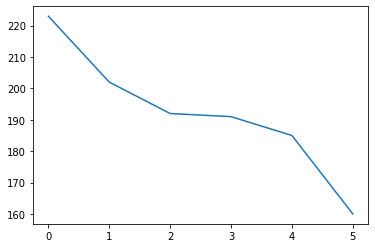

PDM09oe_pct 6


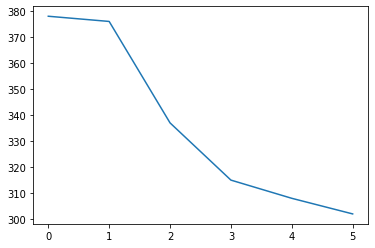

PDL07g_pct 6


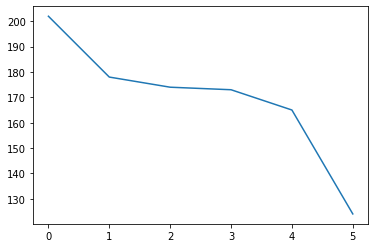

AVL08j_pct 6


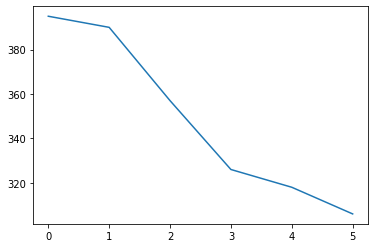

ADL21d_d_pct 6


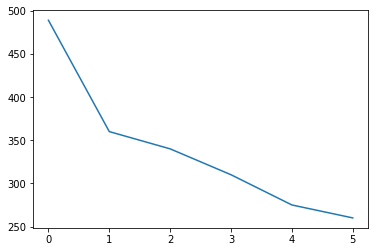

PDM07w_a_pct 6


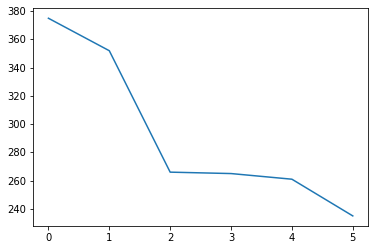

ADM01j_d_pct 6


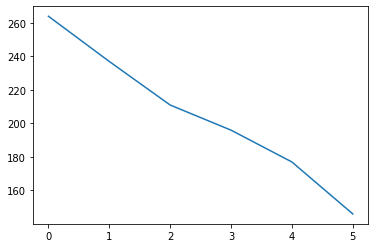

VP1m + VP2 lvPN 6


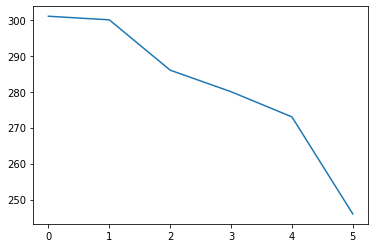

PVL09g_pct 6


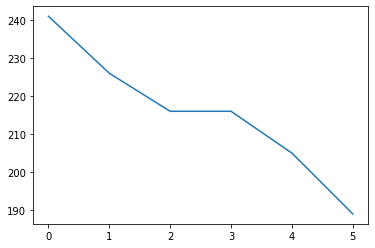

PDL15d_pct 6


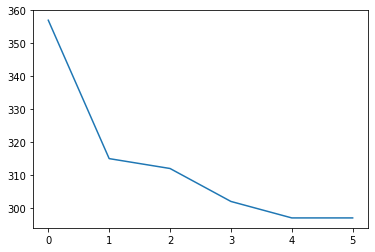

PDM15f_pct 6


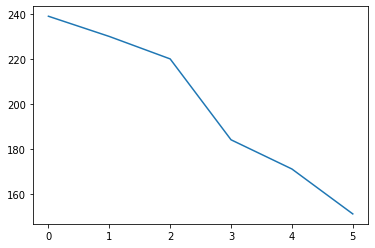

AVM08m_pct 6


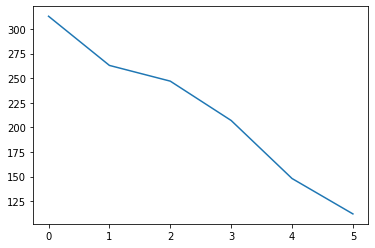

PDL14e_pct 6


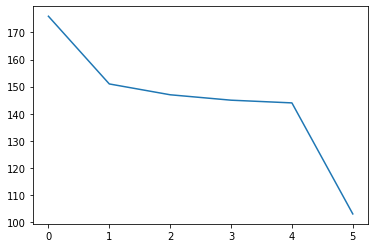

VP multi lvPN mALT 6


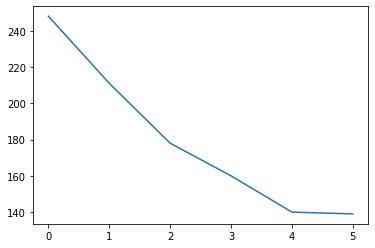

ADL05m_pct 6


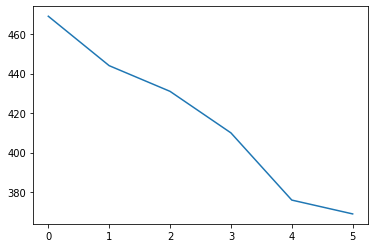

PDL06m_pct 6


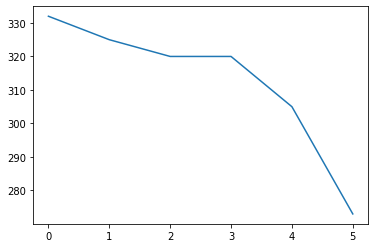

LC32 6


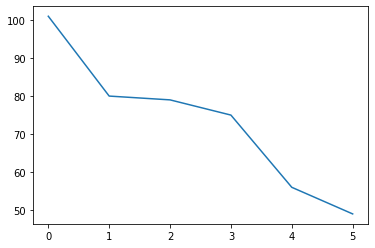

AVL06w_a_pct 6


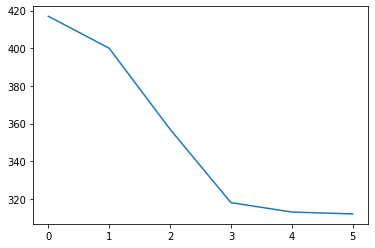

PDL07u_pct 6


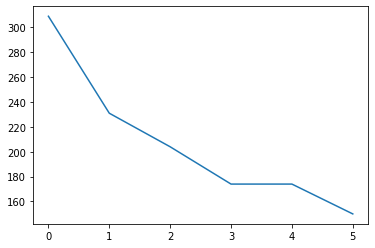

PDL21r_pct 6


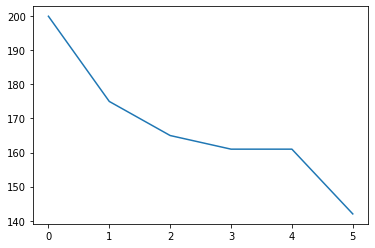

FB6L 6


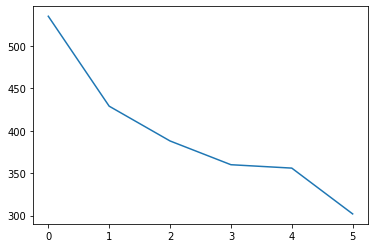

AVM11n_pct 6


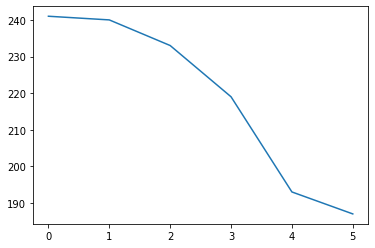

FB6S 6


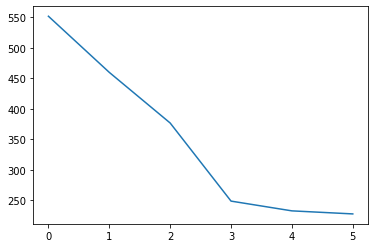

PDL08f_pct 6


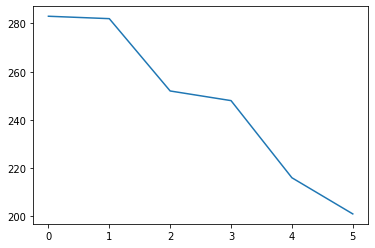

ExR1 6


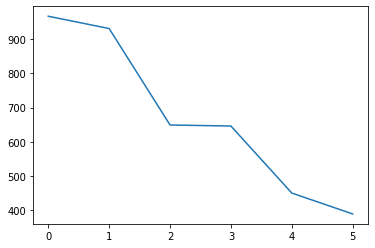

FB5B 6


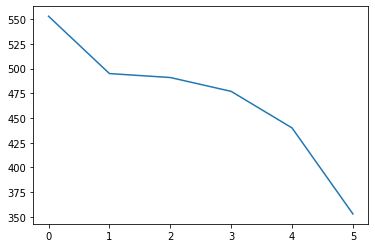

ADM07om_pct 6


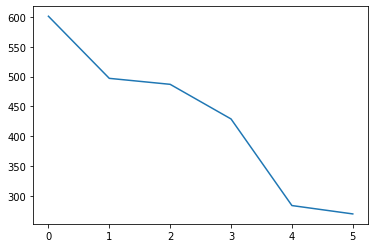

FB5X 6


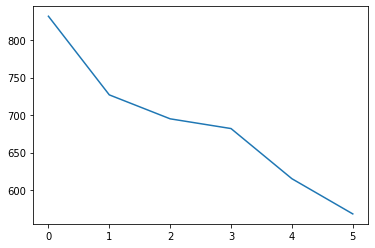

ADL08b_pct 6


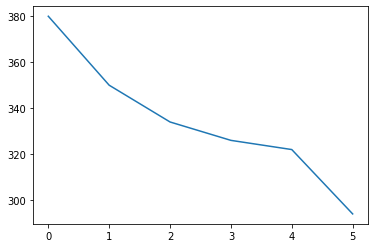

ADL09h_pct 6


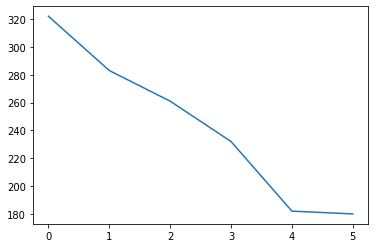

FB2K 6


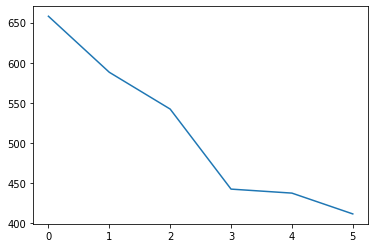

PDM17_pct 6


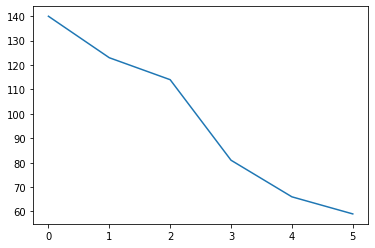

FB2F_b 6


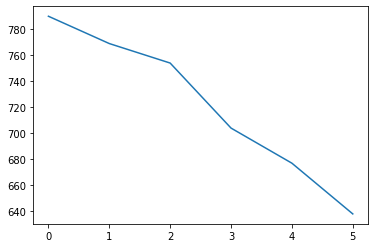

FB2F_a 6


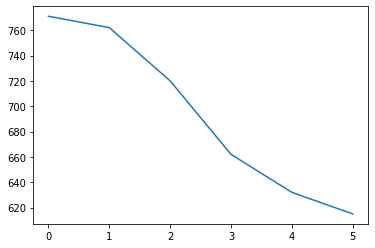

ADL10i_pct 6


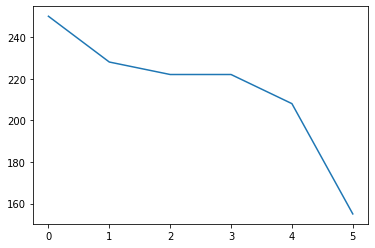

PDL06e_pct 6


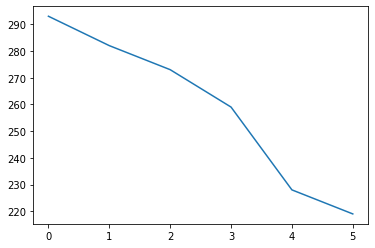

PDM07ob_pct 6


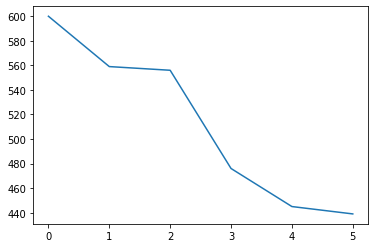

ADM07v_a_pct 6


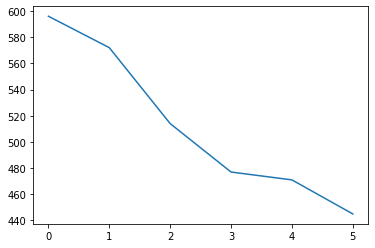

ADL11c_b_pct 6


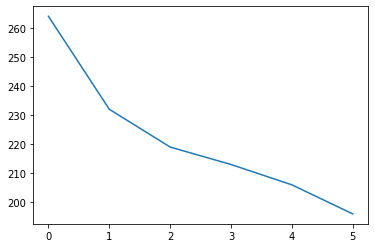

FB2C 6


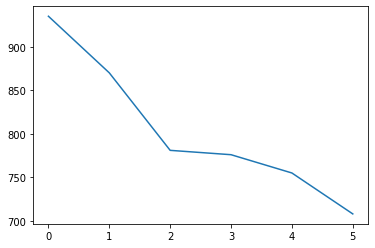

PDM13r_h_pct 6


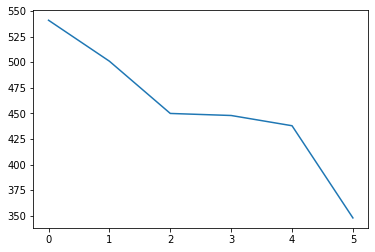

FB4D 6


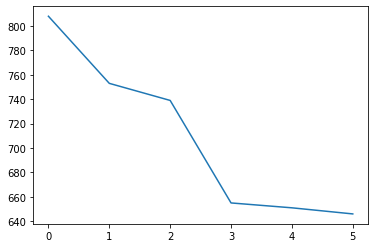

ADM05s_pct 6


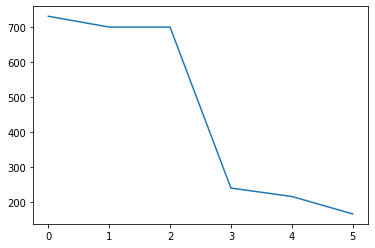

ADL07x_a_pct 6


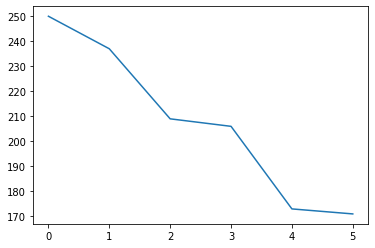

PDL19k_pct 6


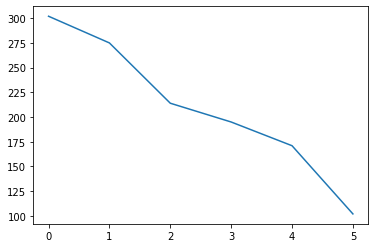

ADL22e_pct 6


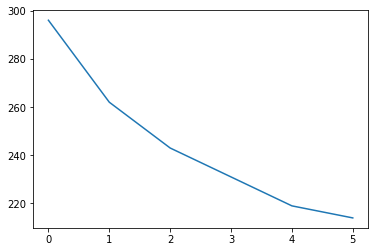

PVL08h_pct 6


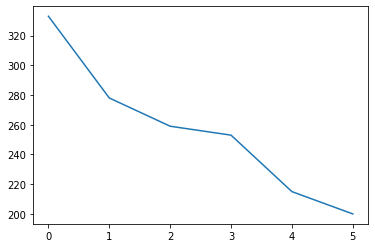

FB2M 6


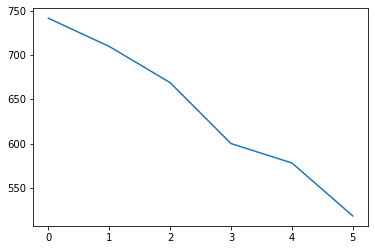

PVL03x_pct 6


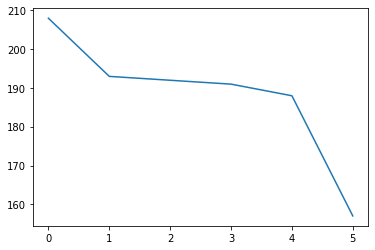

ADL01n_c_pct 6


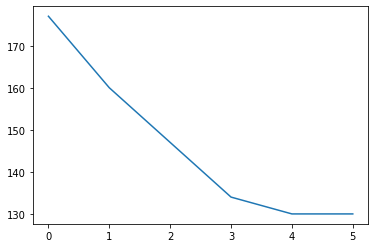

PDL08q_pct 6


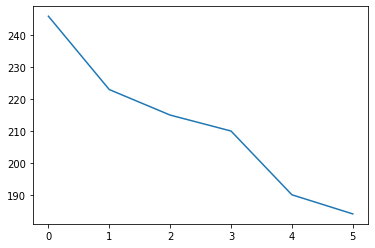

PDL27b_pct 6


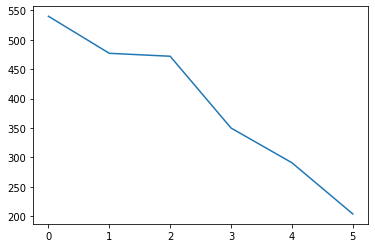

AVM15j_pct 6


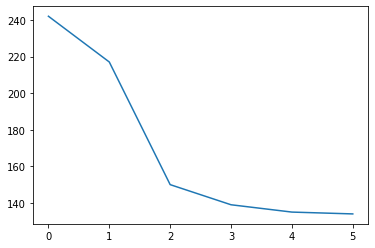

PVL14c_pct 6


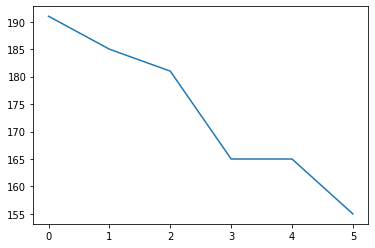

PDL09e_pct 6


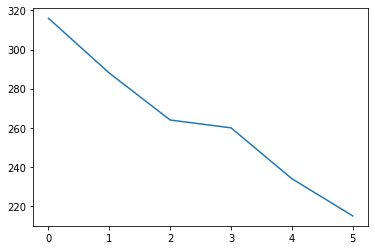

PDL06k_pct 6


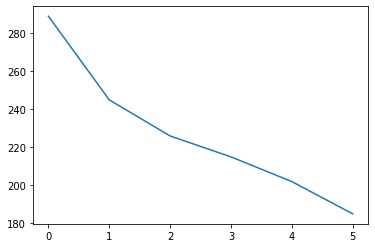

FB5R 6


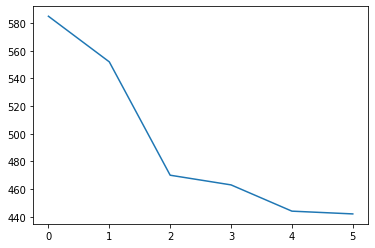

AVL02or_pct 6


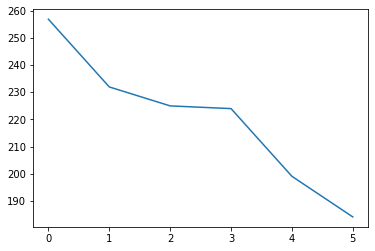

PVL03s_pct 6


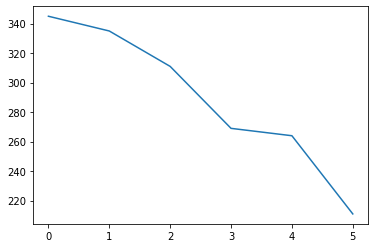

IPC_c 6


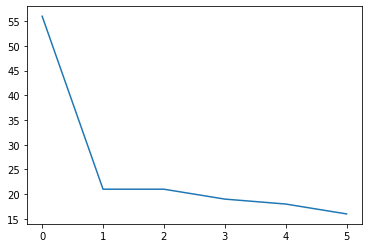

AVM08oh_pct 6


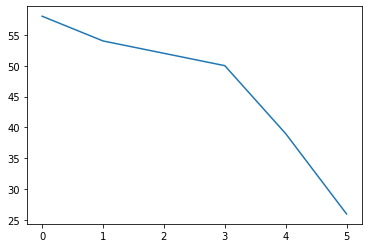

PVL09h_pct 6


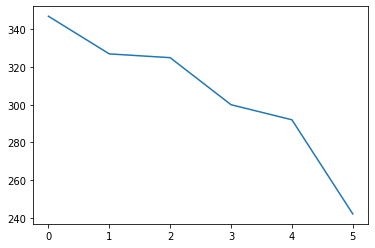

PVL03i_pct 6


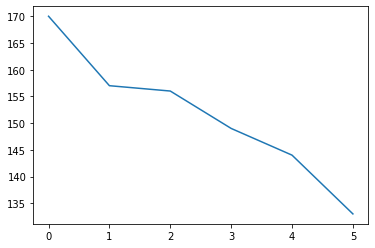

aMe4 6


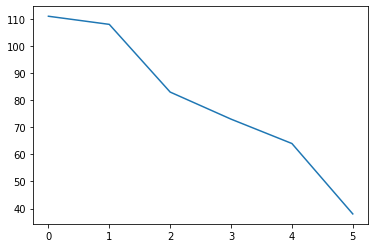

TuBu4 6


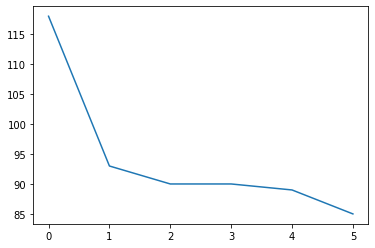

ADL08h_pct 6


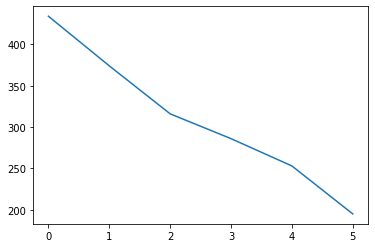

ADM01b_a_pct 6


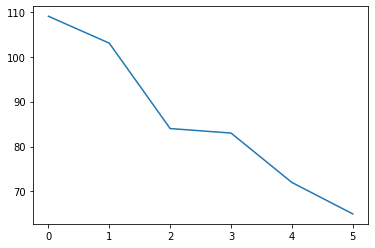

PVM01ot_pct 6


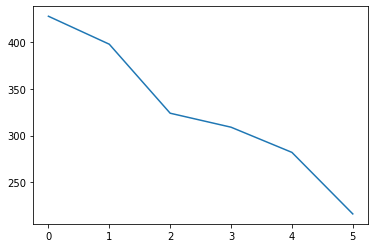

AVM11t_pct 6


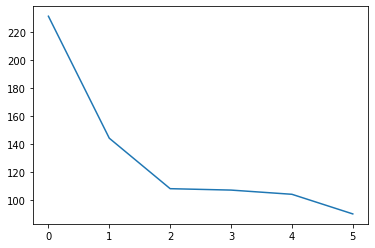

aMe10 6


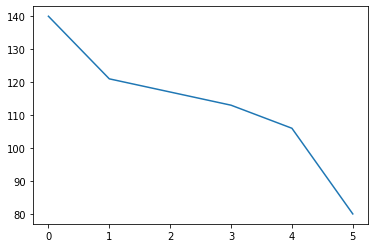

R2_b 6


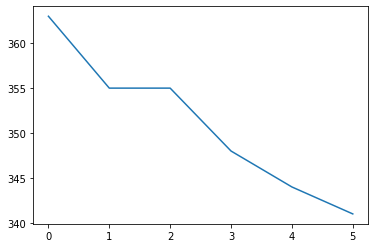

R3p_a 6


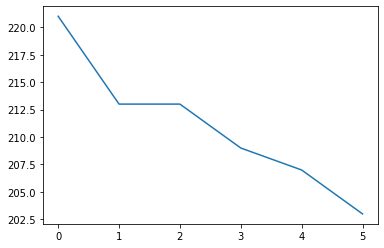

PVL03f_pct 6


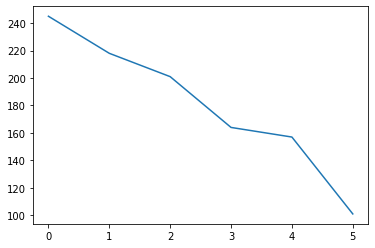

AVL04s_a_pct 6


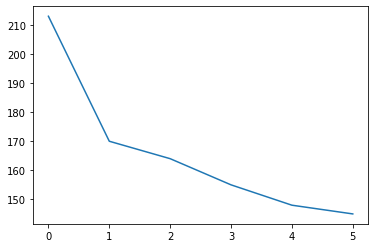

PVL03z_pct 6


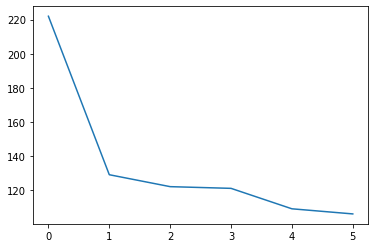

PVL03oh_pct 6


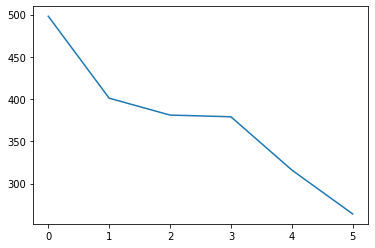

AVL19e_pct 6


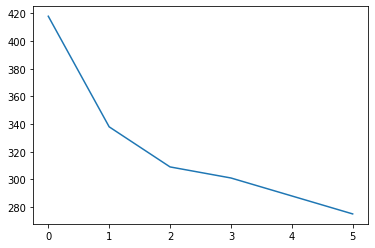

AVM12i_pct 6


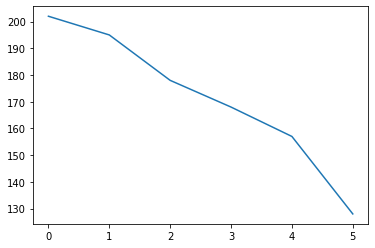

PDM14k_pct 6


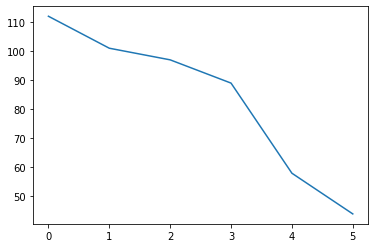

ADL14m_a_pct 6


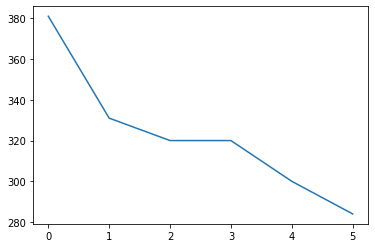

AVL08g_pct 6


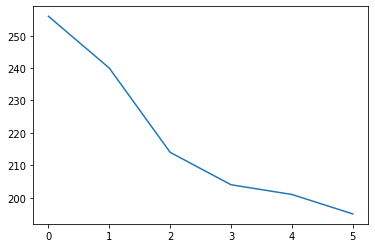

PDL09n_pct 6


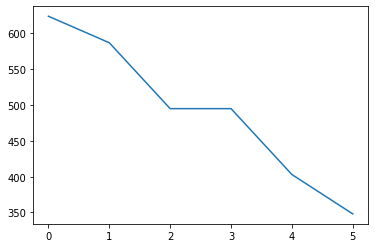

PVL12b_pct 6


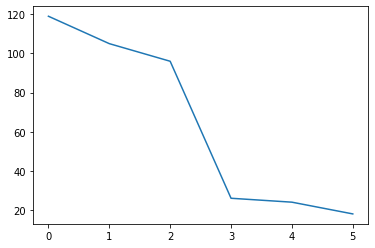

PVL12d_pct 6


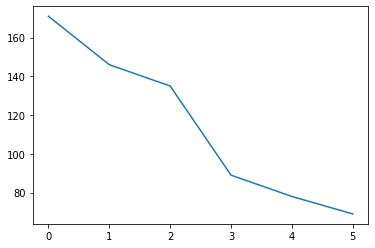

PVM02oe_pct 6


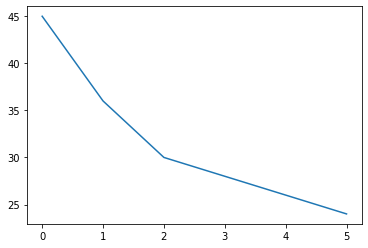

PVL02oc_pct 6


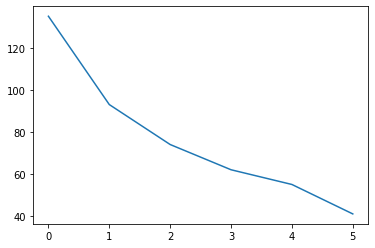

AVM08r_pct 6


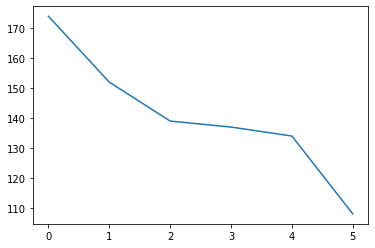

PDL14b_pct 5


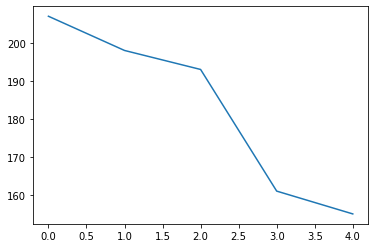

PDL07s_pct 5


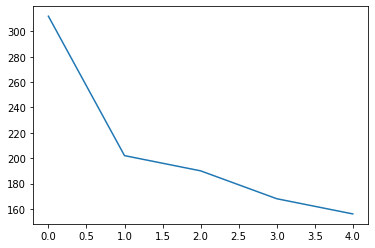

AVM07r_pct 5


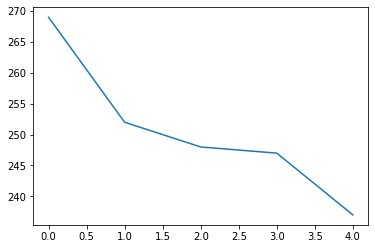

PDM08q_a_pct 5


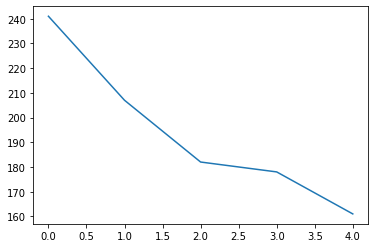

PDL23d_pct 5


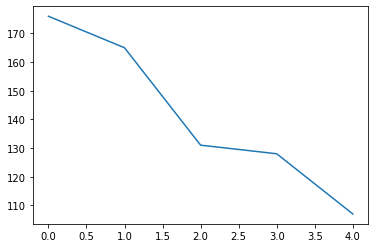

FB8F 5


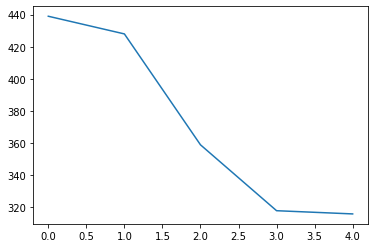

PDM20c_b_pct 5


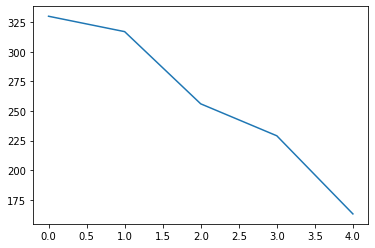

PDL17f_pct 5


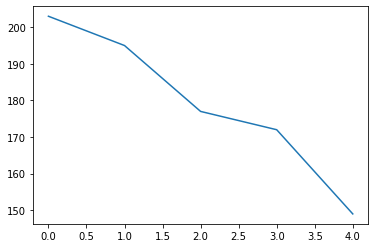

ADL03oa_pct 5


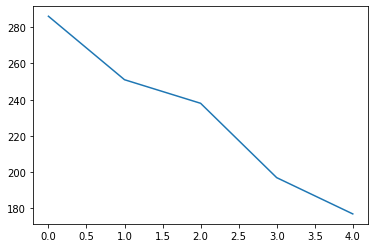

ADL18d_b_pct 5


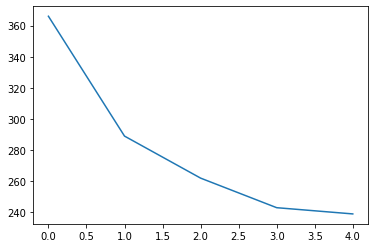

PDL13p_pct 5


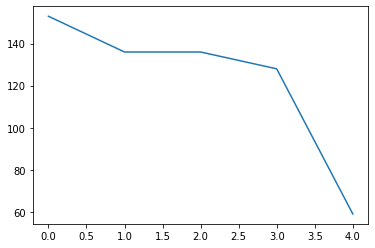

PDL07x_pct 5


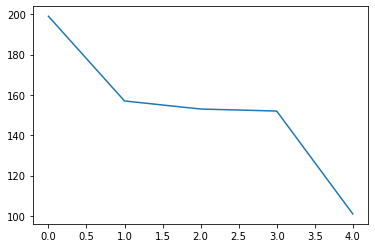

ADL13d_pct 5


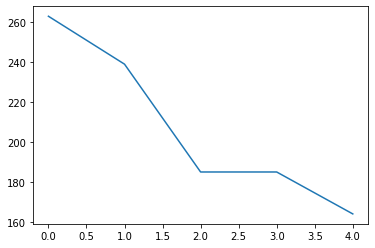

PDL17u_pct 5


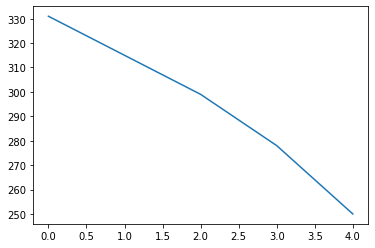

PDL07j_pct 5


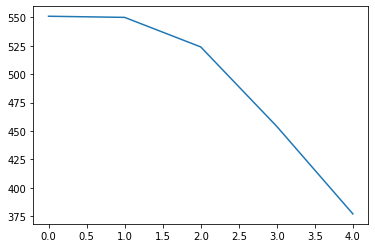

ADL09c_c_pct 5


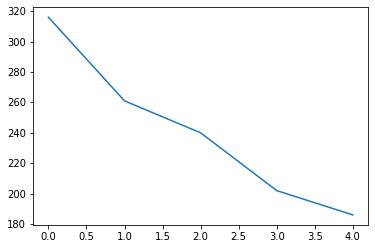

PDM09y_pct 5


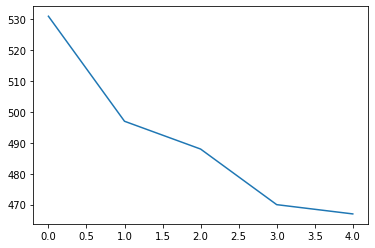

PDM09oa_pct 5


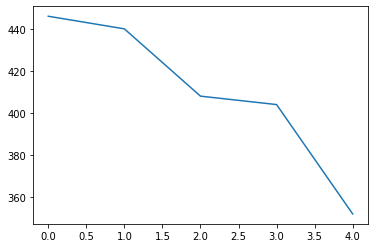

ADL09p_pct 5


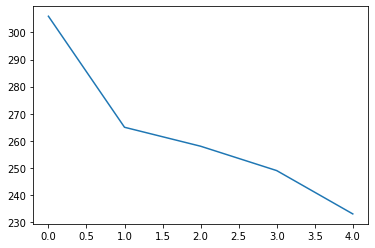

FB6C_b 5


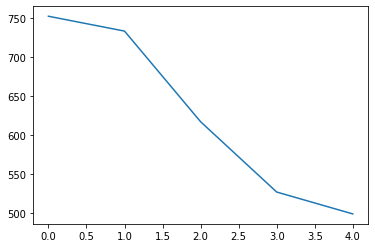

ADL09c_a_pct 5


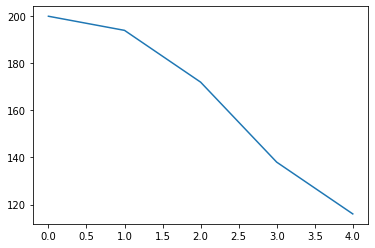

ADL12b_b_pct 5


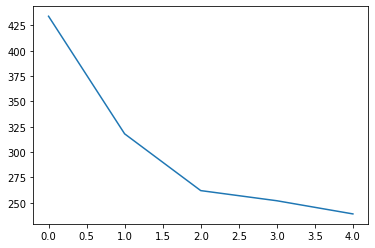

ADL13r_pct 5


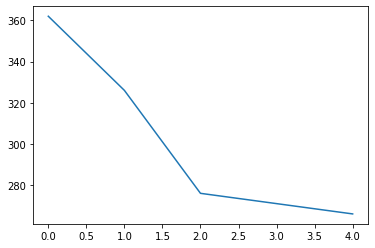

PDL23e_pct 5


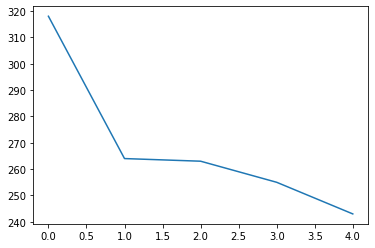

ADL20e_g_pct 5


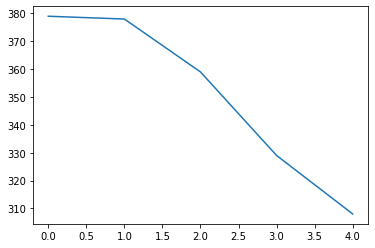

ADL02oh_pct 5


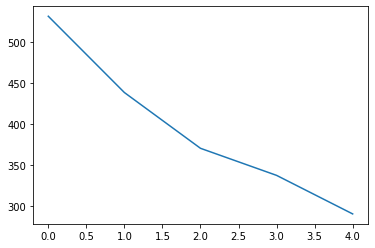

PDL11a_b_pct 5


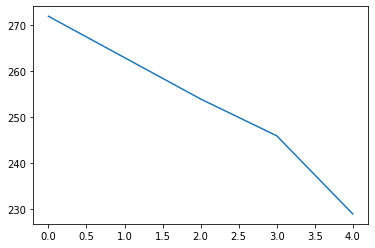

DA2 lPN 5


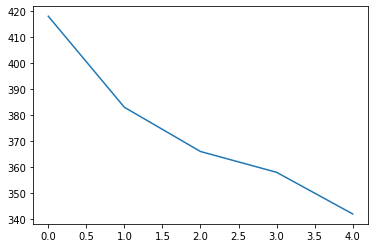

PDM09ok_pct 5


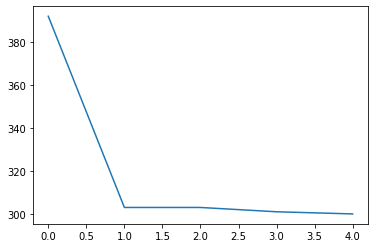

PDL16u_pct 5


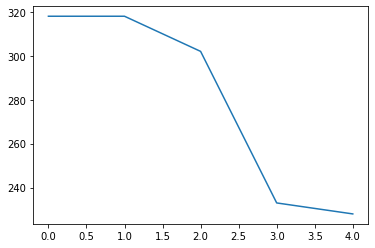

FB8A 5


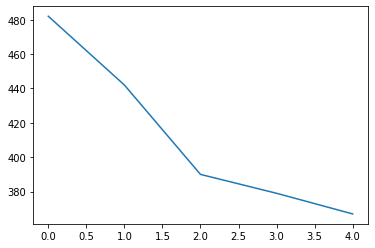

ADL07a_pct 5


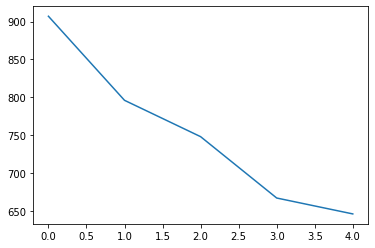

PDM12e_pct 5


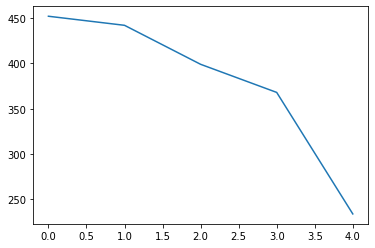

PDM11f_pct 5


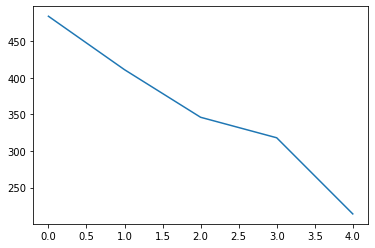

PDL18q_pct 5


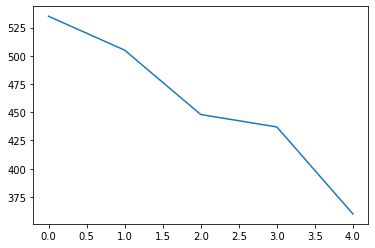

PDL08j_pct 5


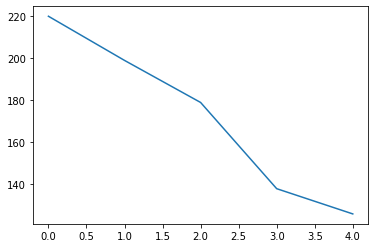

ADL07g_pct 5


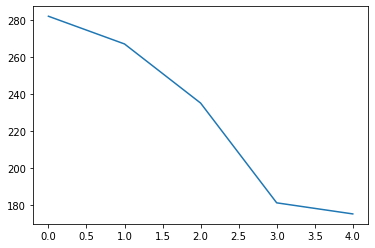

PDM08g_pct 5


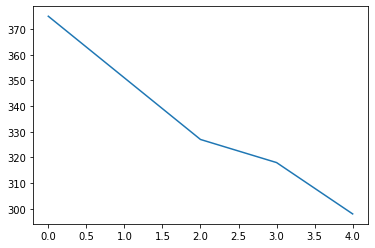

AVL10g_b_pct 5


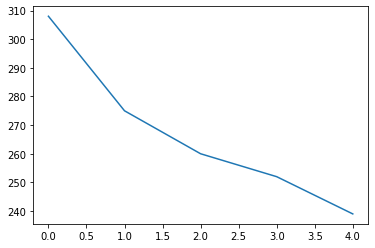

AVL02m_a_pct 5


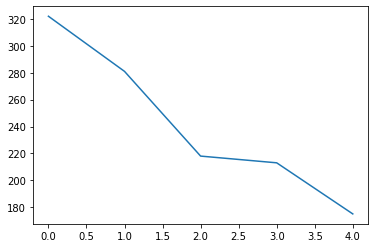

AVL06v_d_pct 5


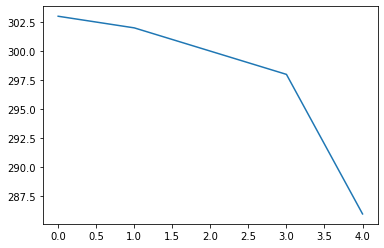

PDM09of_pct 5


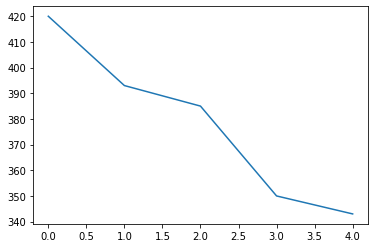

PDL15f_pct 5


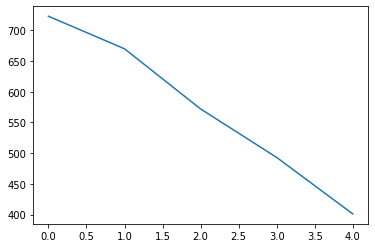

PVL04n_pct 5


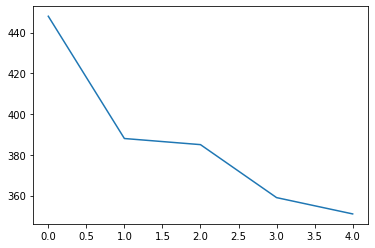

ADL07x_f_pct 5


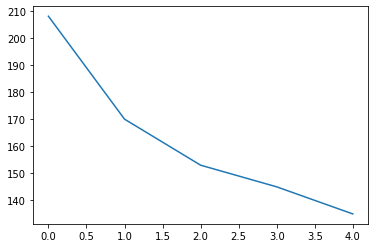

PDM09ol_pct 5


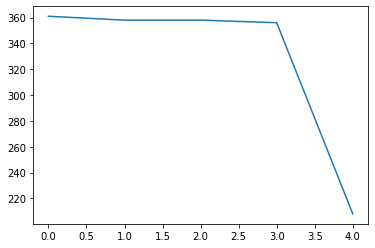

AVL08p_b_pct 5


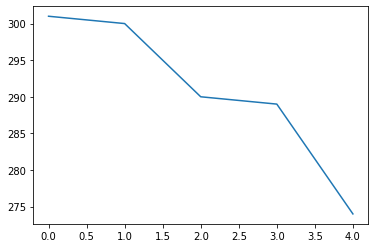

PDL20y_pct 5


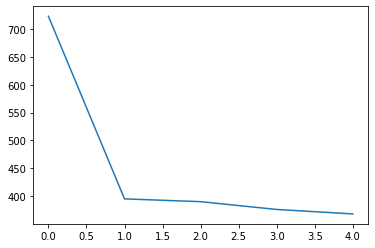

AVL23e_pct 5


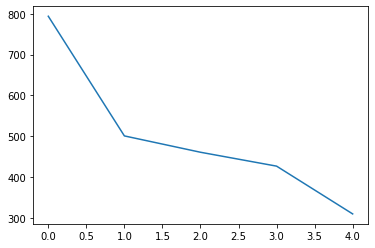

AVL12d_pct 5


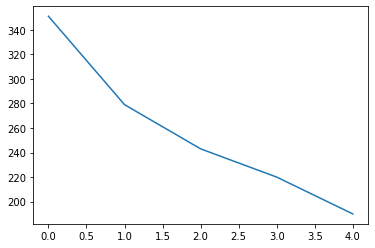

PDM19p_pct 5


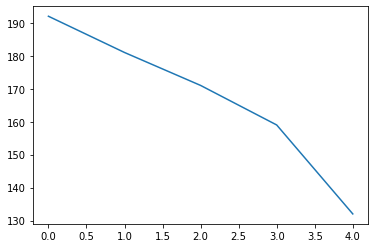

PDL15k_pct 5


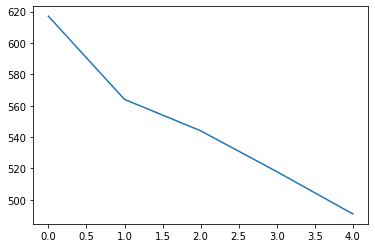

PDL14f_pct 5


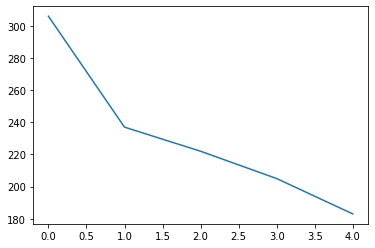

PDM05q_pct 5


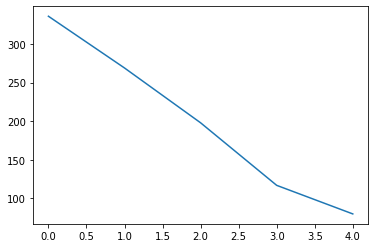

PDL21m_pct 5


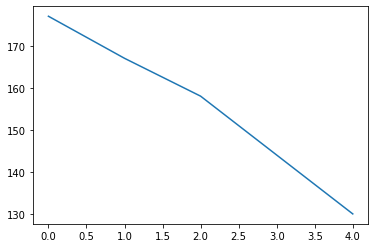

ADM01j_a_pct 5


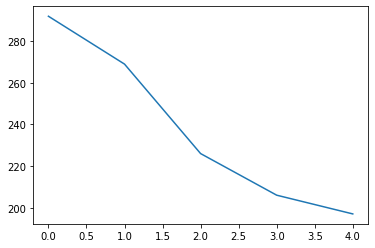

AVL06f_pct 5


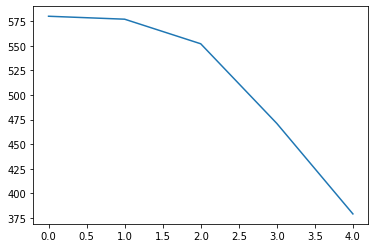

PDL07h_b_pct 5


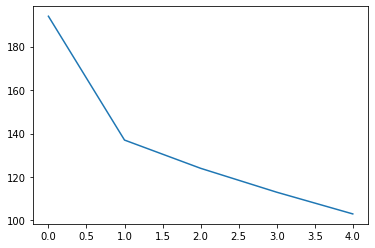

AVM09h_d_pct 5


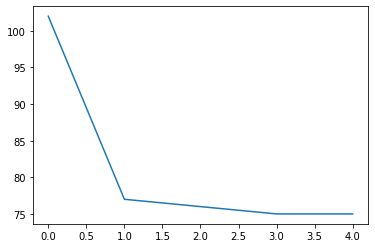

PDM07og_pct 5


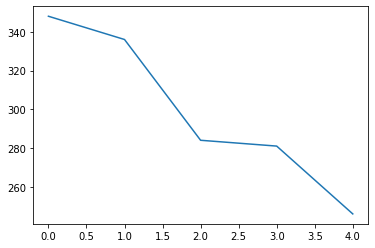

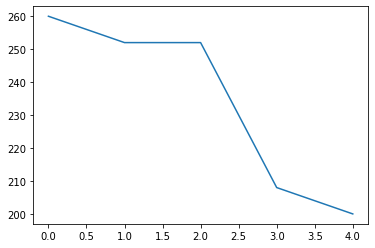

AVL06d_pct 5


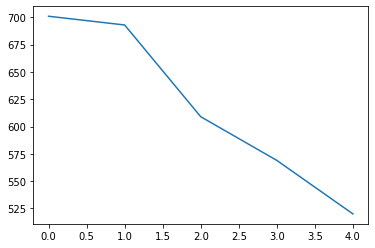

ADL06k_pct 5


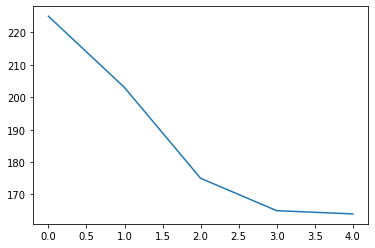

AVL02z_b_pct 5


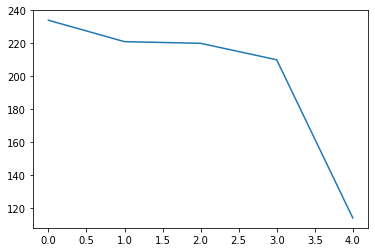

ADL16m_pct 5


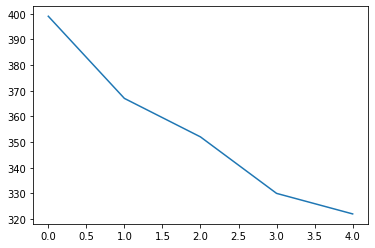

PDL11oc_pct 5


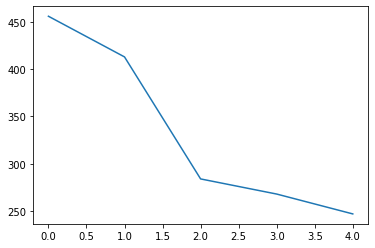

ADL02on_pct 5


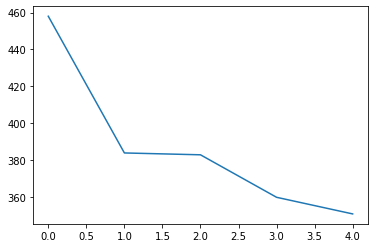

ADL15k_pct 5


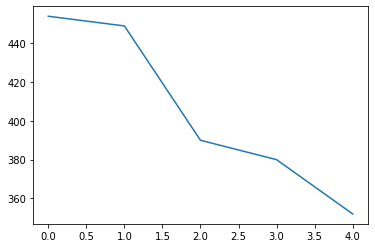

ADL02k_pct 5


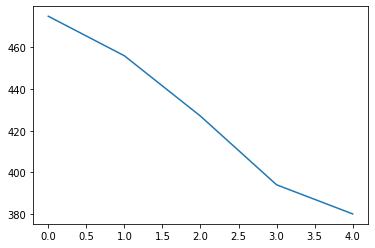

PDL13a_pct 5


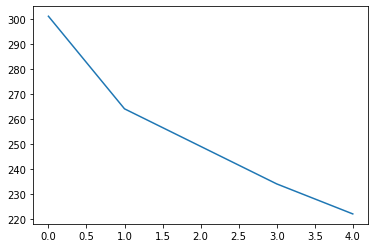

ADL04i_pct 5


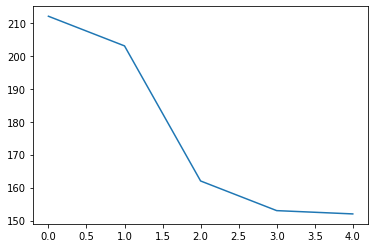

ADM04oc_pct 5


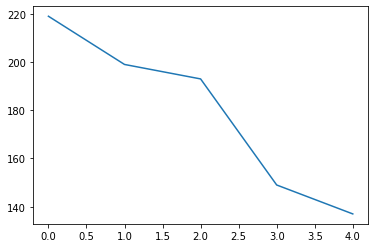

ADL01h_a_pct 5


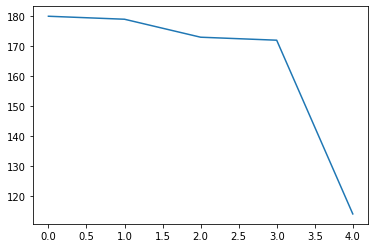

PVL04w_pct 5


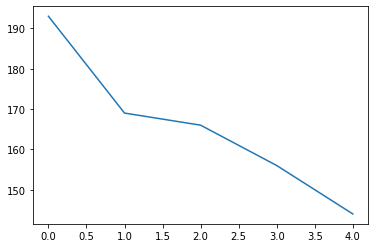

ADM07v_b_pct 5


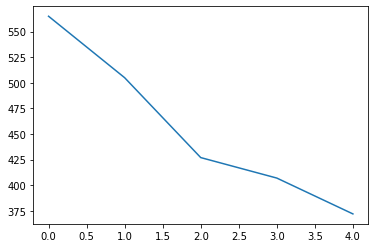

ADM07r_pct 5


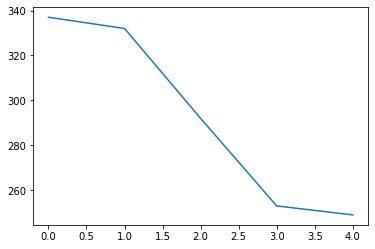

aIPg2 5


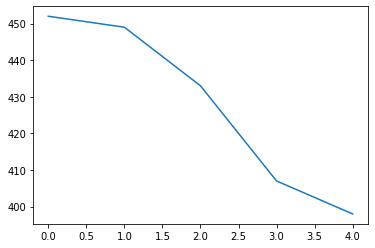

PVL18a_pct 5


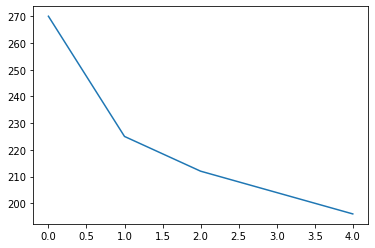

ADL09u_pct 5


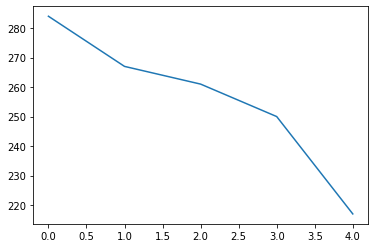

PDM09i_pct 5


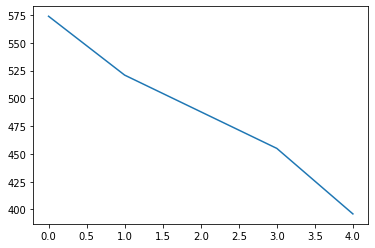

PDL22e_pct 5


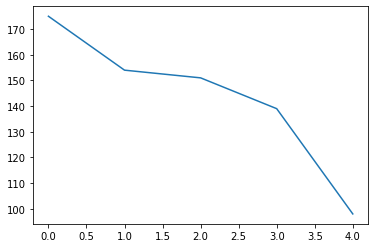

VM5d adPN 5


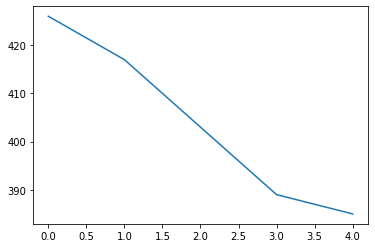

ADL18h_pct 5


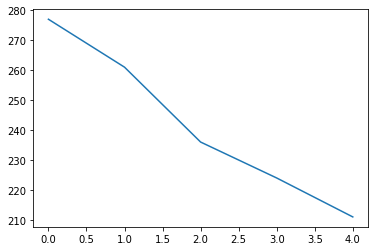

ADL17d_e_pct 5


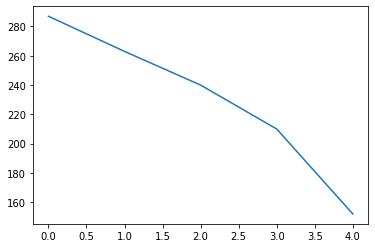

AVM16f_pct 5


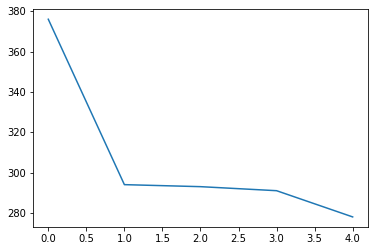

PDL19f_b_pct 5


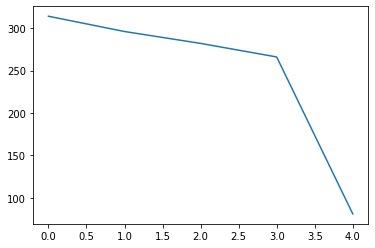

PDM10of_pct 5


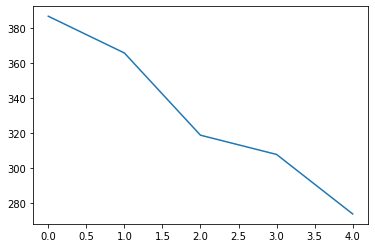

PVM12j_pct 5


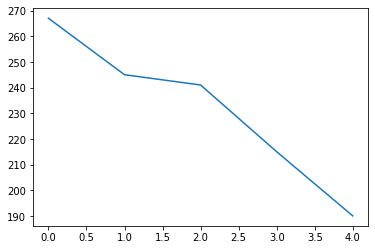

PDL14h_pct 5


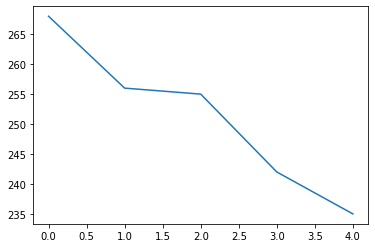

ADM10m_pct 5


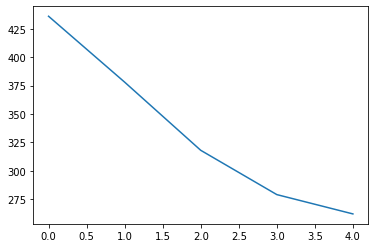

PDM06m_pct 5


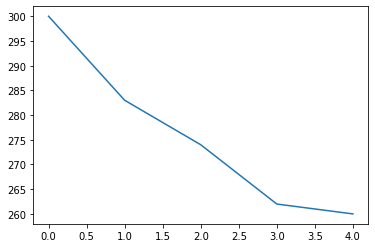

DN1pA 5


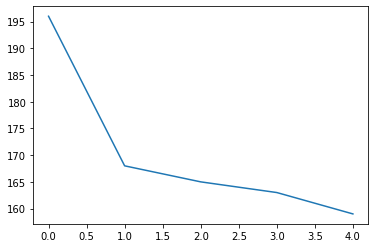

ADL17d_d_pct 5


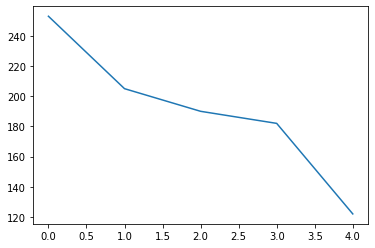

PDL06oi_pct 5


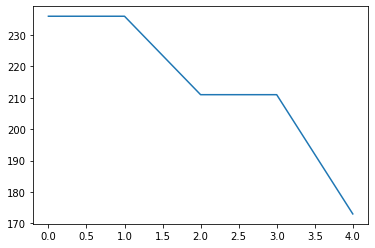

AVM07g_a_pct 5


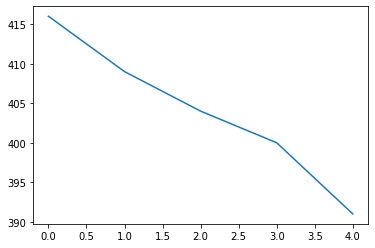

PDL15j_pct 5


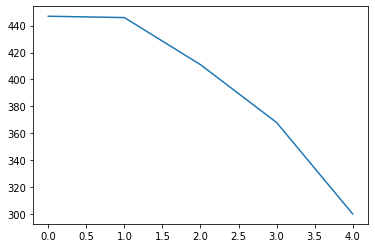

PVL04h_pct 5


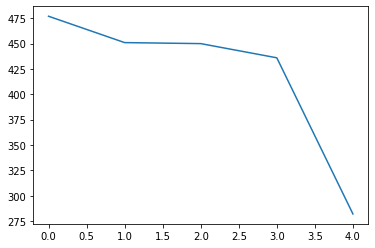

AVM07a_a_pct 5


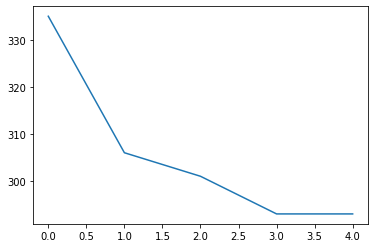

AVL12i_pct 5


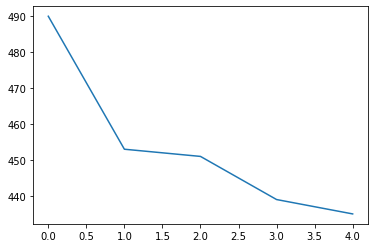

PDL09c_pct 5


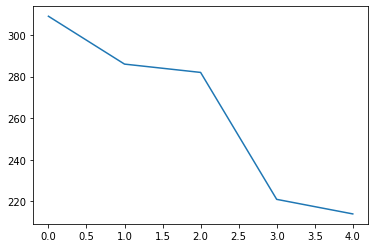

PDL09a_pct 5


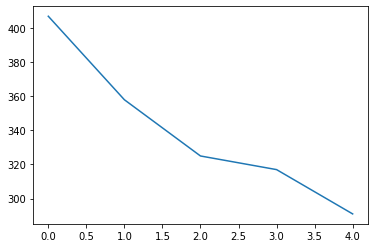

ADL15p_b_pct 5


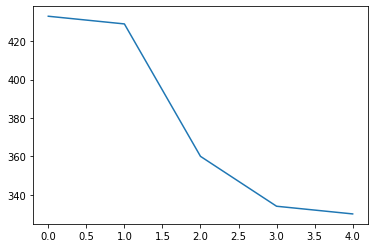

AVL09b_pct 5


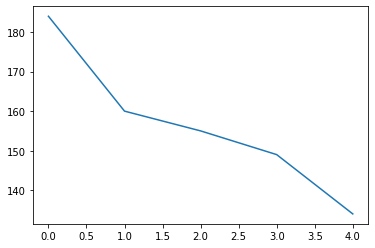

AVL04c_pct 5


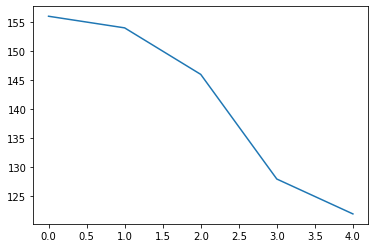

AVL09a_pct 5


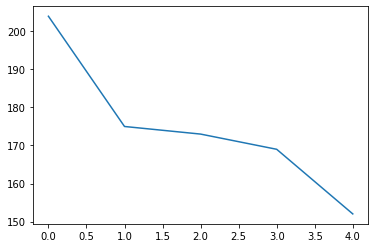

AVL09c_pct 5


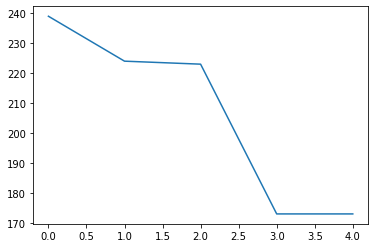

ADM06b_e_pct 5


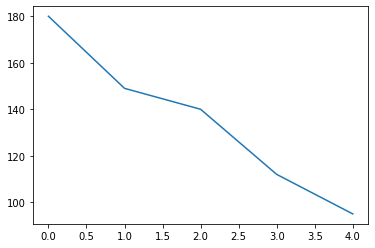

ADL04oc_pct 5


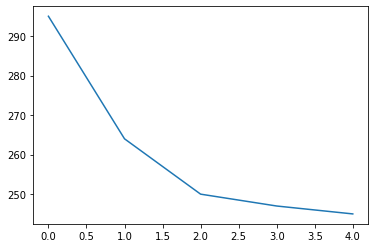

PVL14b_pct 5


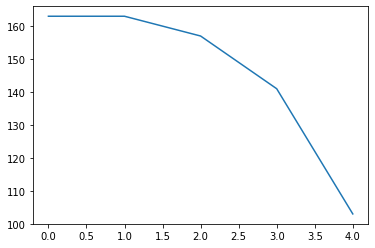

PVL03ou_pct 5


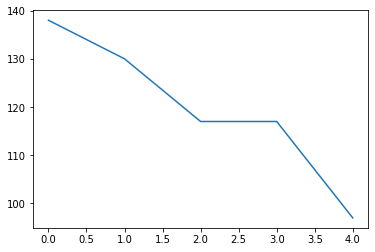

PDL22d_pct 5


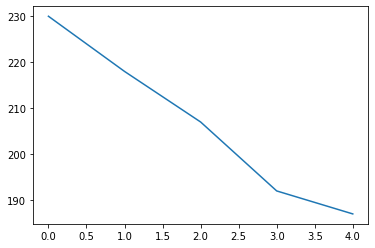

multi vPN mlALT 5


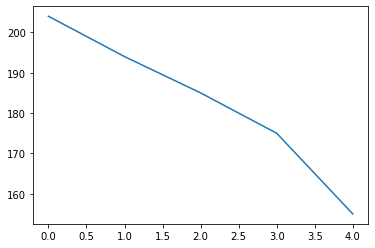

DL2d adPN 5


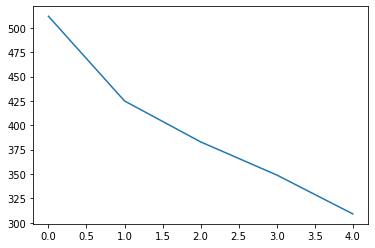

ADL21f_a_pct 5


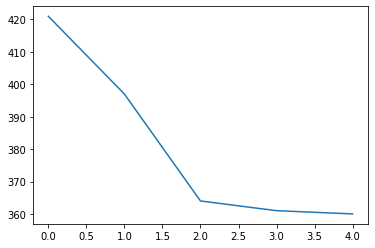

PVL03q_pct 5


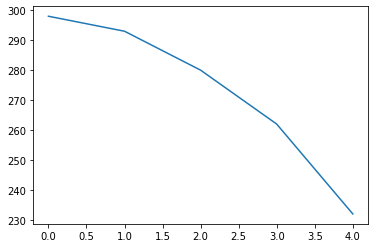

ADL14m_c_pct 5


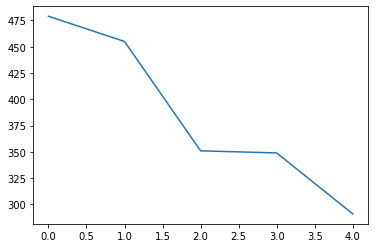

PVM01oq_pct 5


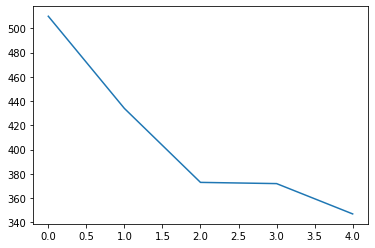

aSP10C_a 5


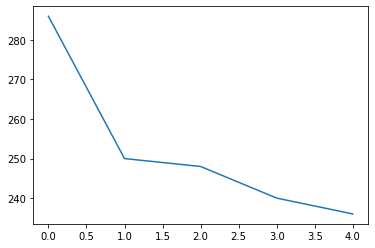

AVL08d_pct 5


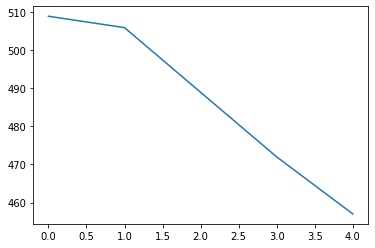

AVL02k_pct 5


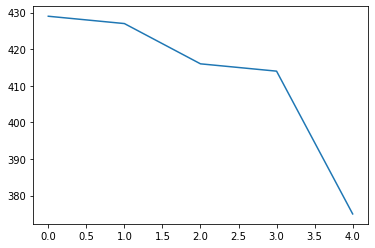

AVL11e_pct 5


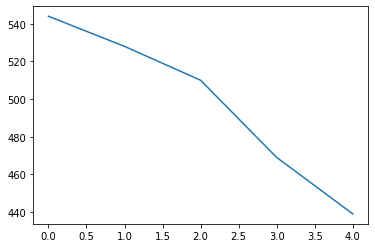

AVL02n_pct 5


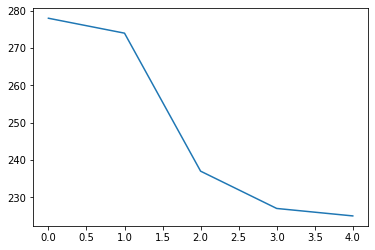

ADL06j_pct 5


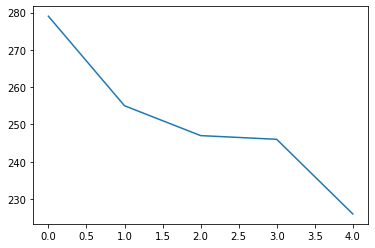

AVL07k_pct 5


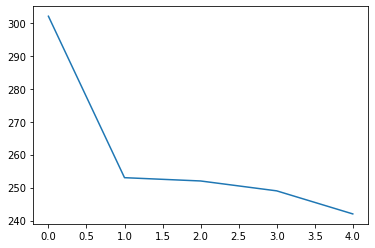

AVL11y_a_pct 5


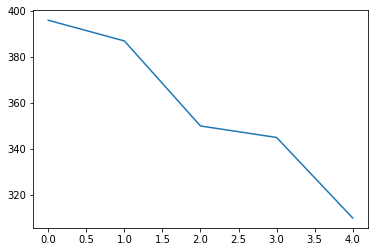

AVL01ln_pct 5


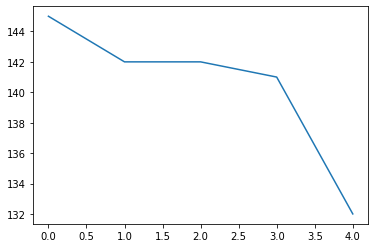

R3w_c 5


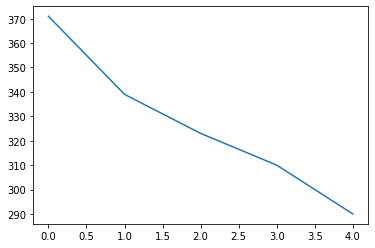

AVL09z_a_pct 5


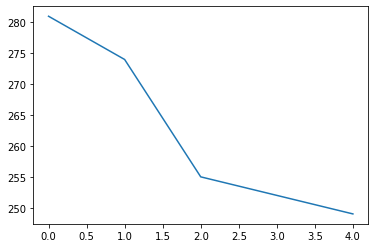

AVL04z_pct 5


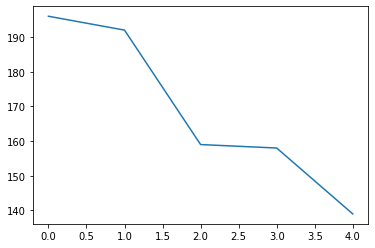

AVM09v_pct 5


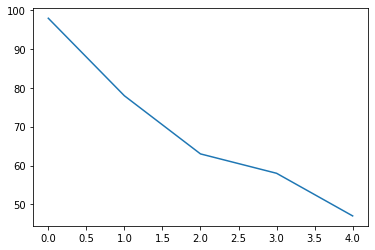

AVL10e_pct 5


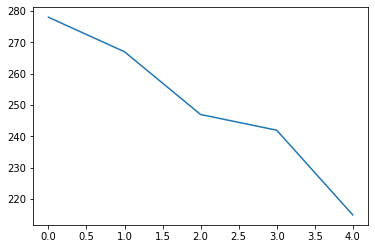

ADM01oq_pct 5


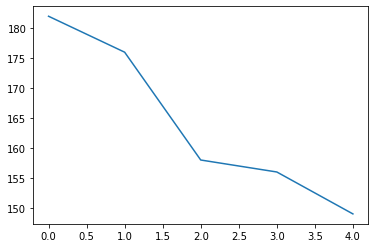

ADM05c_pct 5


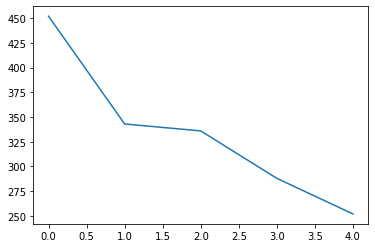

AVL01ll_pct 5


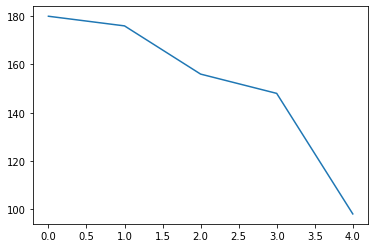

PVM08j_pct 5


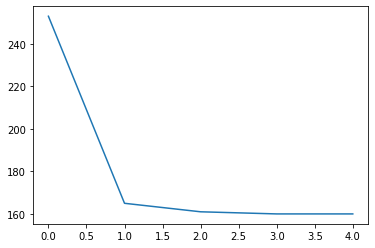

PDM23h_pct 5


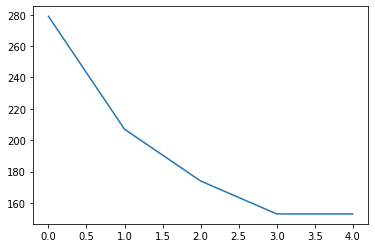

PVM02od_pct 5


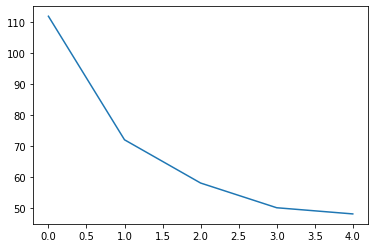

PVM01ou_pct 5


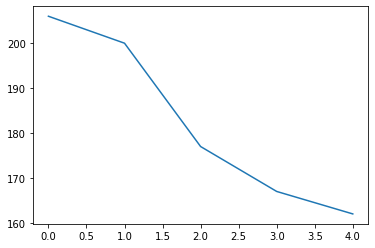

PVM08k_pct 5


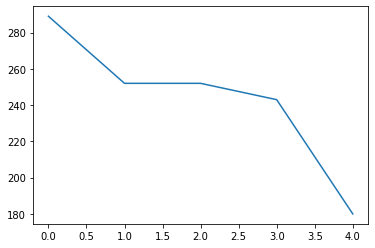

AVM08h_b_pct 5


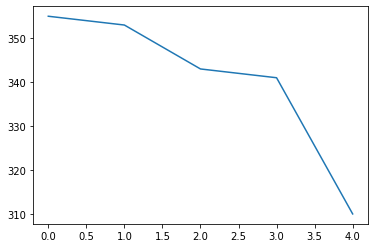

PVM05e_pct 5


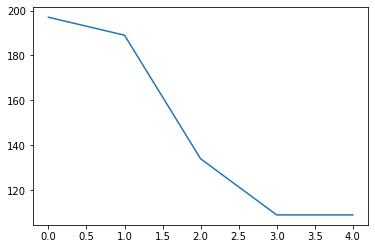

AVL10t_pct 5


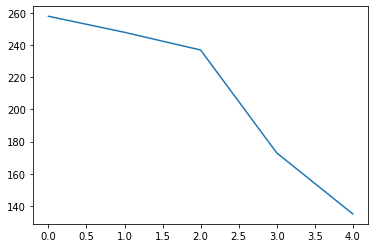

AVL09d_pct 5


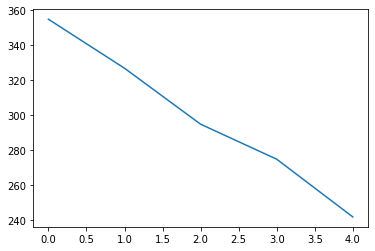

AVL17b_pct 5


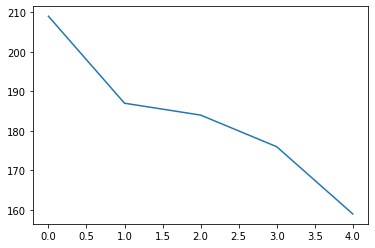

PVL03og_pct 5


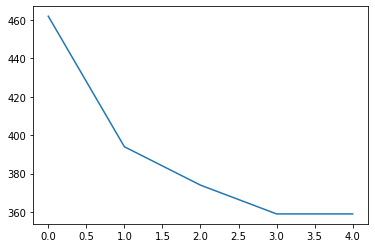

PVL05g_pct 5


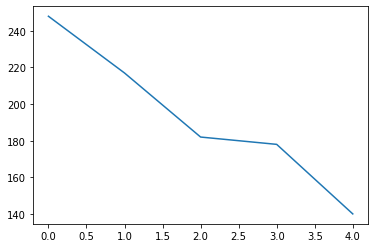

PDM23e_pct 5


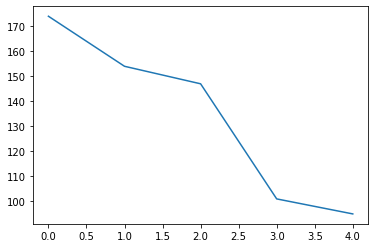

AVL09og_pct 5


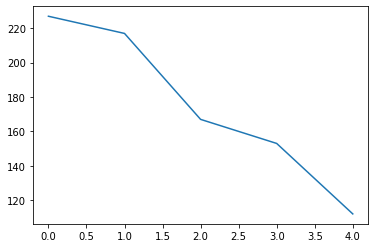

ADL01f_pct 5


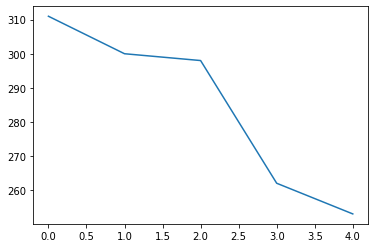

PDM19m_pct 5


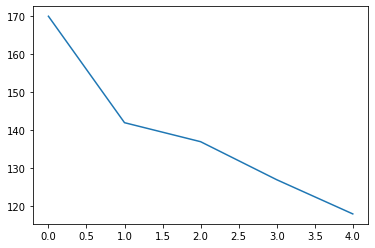

PDL12e_a_pct 5


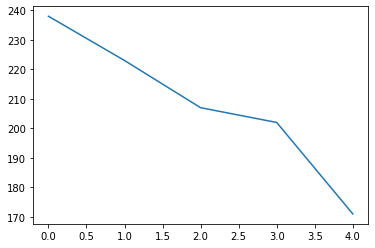

AVL07b_pct 5


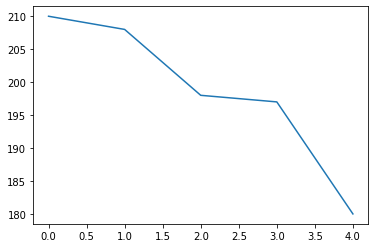

PDL12v_a_pct 5


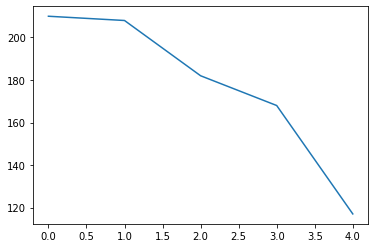

AVL15d_pct 5


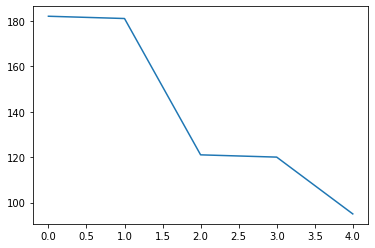

PVM04j_pct 5


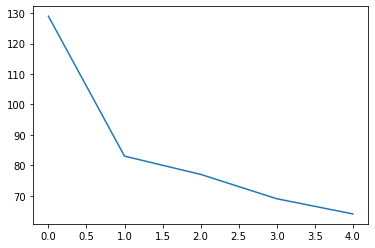

ADM06b_d_pct 5


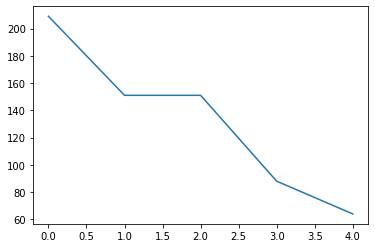

PDL12t_pct 5


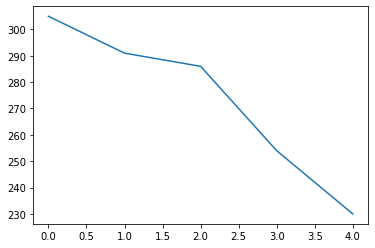

AVL01r_pct 5


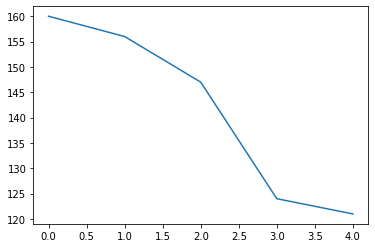

PVM06h_pct 5


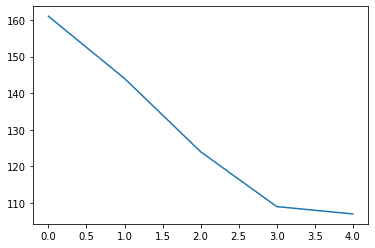

AVL05m_pct 5


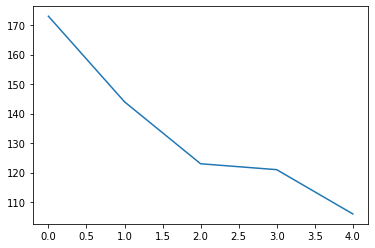

PVM05h_pct 5


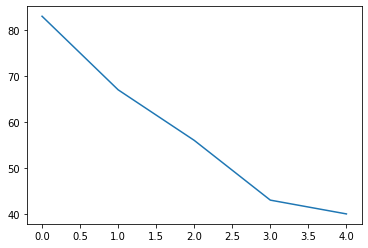

PDL09u_pct 5


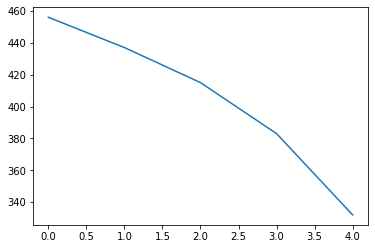

AVL02v_b_pct 5


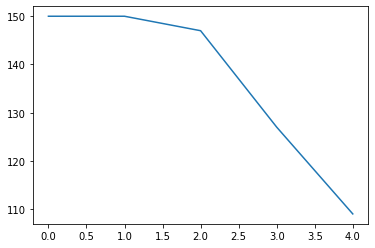

AVL15a_pct 5


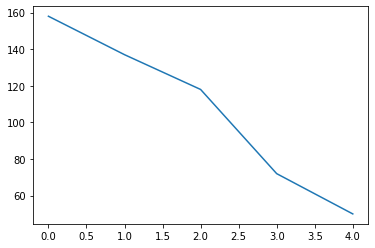

AVL21g_a_pct 5


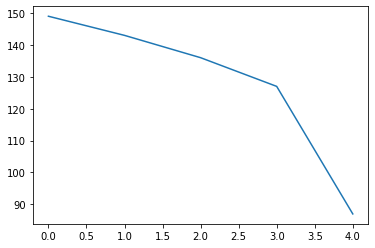

PVL08b_pct 5


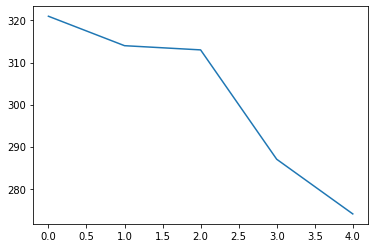

AVM09x_pct 5


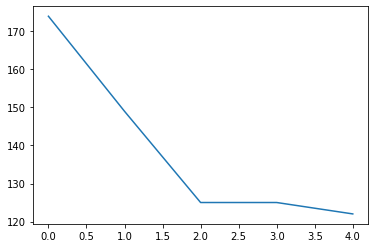

AVM09n_pct 5


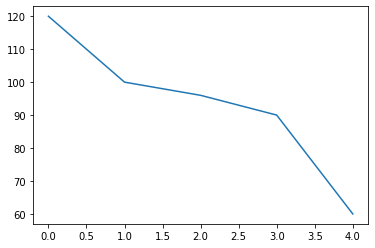

PDL12oc_pct 5


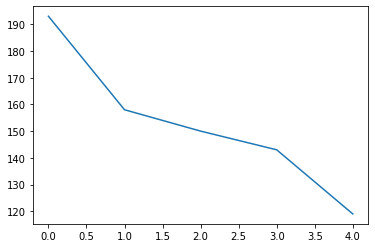

PVL11i_pct 5


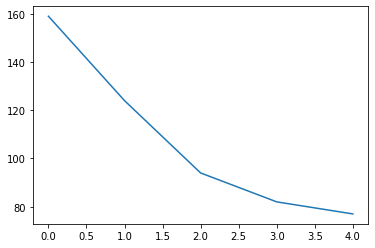

AVM09t_pct 5


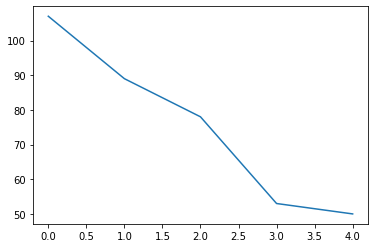

AVL17a_pct 5


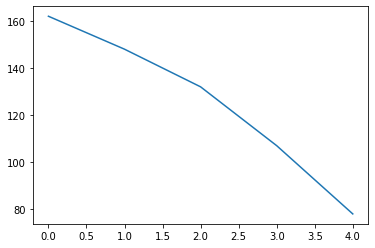

ADM06s_pct 5


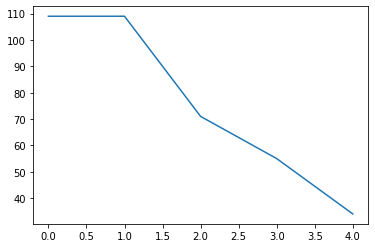

AVL01a_a_pct 5


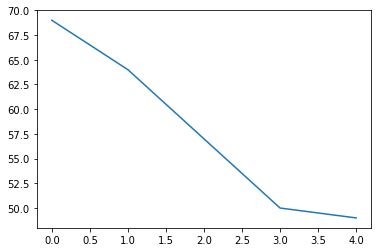

AVM09u_pct 5


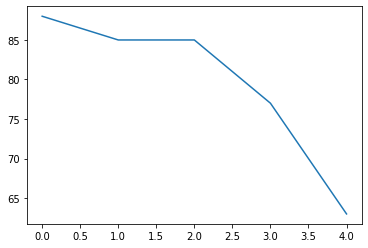

HBeyelet 5


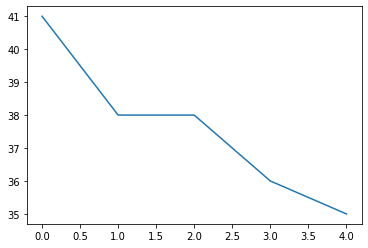

AVL09k_pct 5


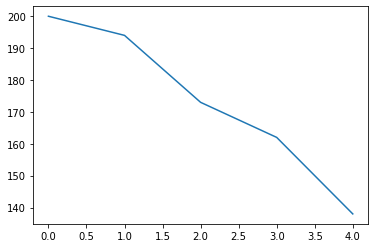

PVM04u_a_pct 5


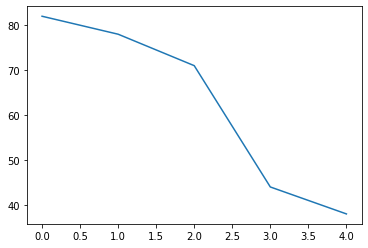

PVM06e_pct 5


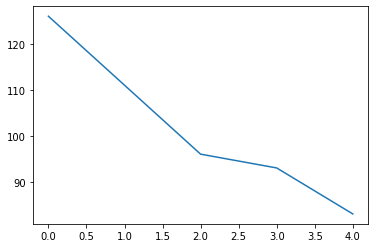

ADM06d_pct 5


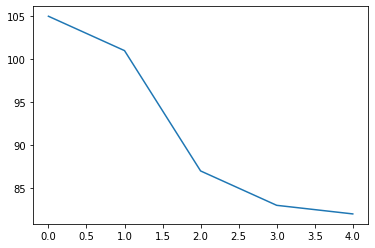

ADL07of_pct 4


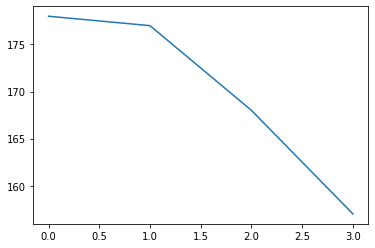

SA1_b 4


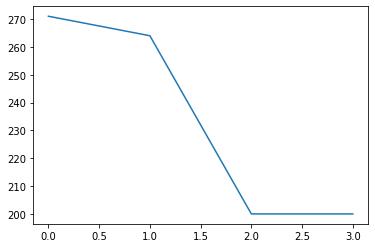

PDM18a_d_pct 4


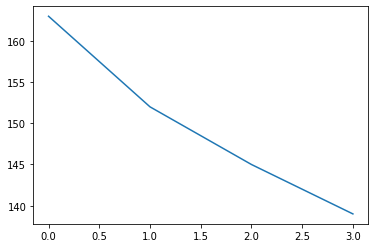

PDL17r_pct 4


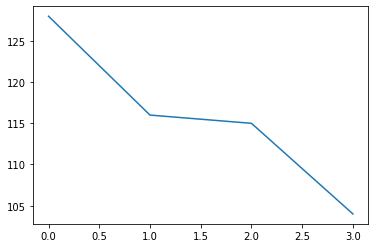

SA1_a 4


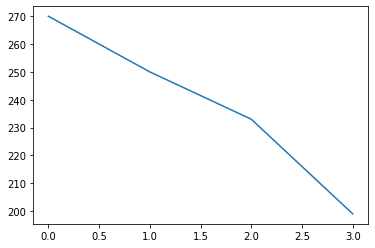

ADL07v_pct 4


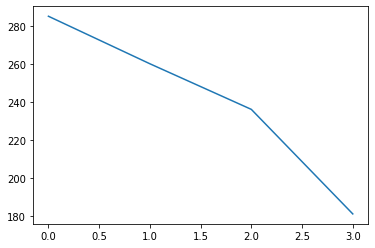

PDL13x_pct 4


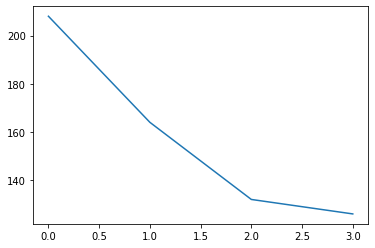

ADL10d_b_pct 4


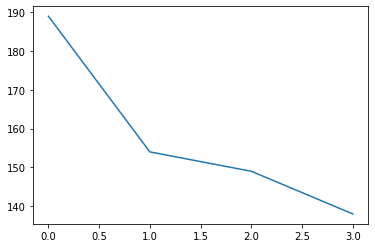

PDM12f_pct 4


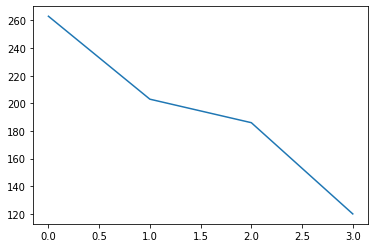

FB1A 4


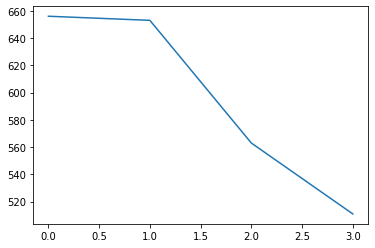

PDL14g_pct 4


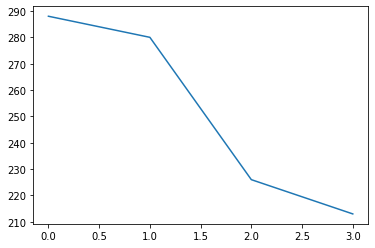

FB1B 4


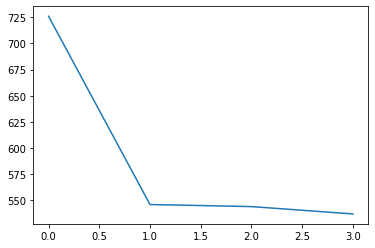

PDM18a_a_pct 4


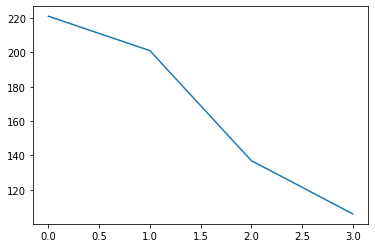

FB6M 4


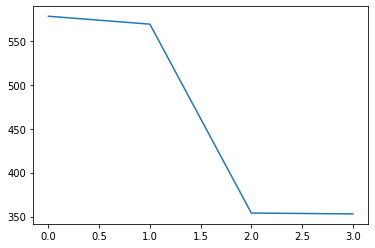

PDM05i_pct 4


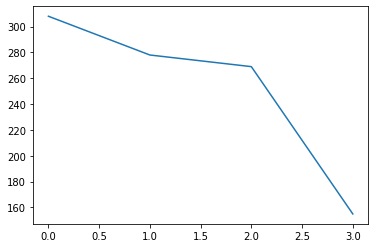

PDM18b_b_pct 4


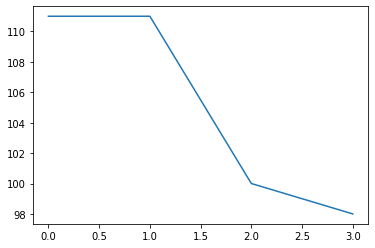

FB8C 4


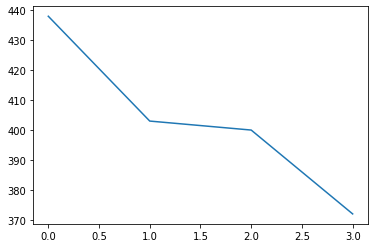

PDM05j_a_pct 4


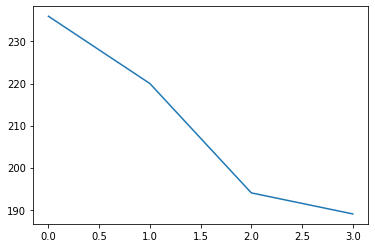

PVL04p_a_pct 4


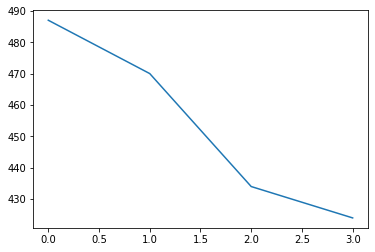

FB8G 4


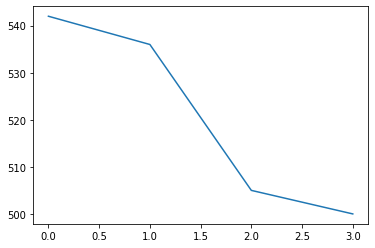

ADL10q_pct 4


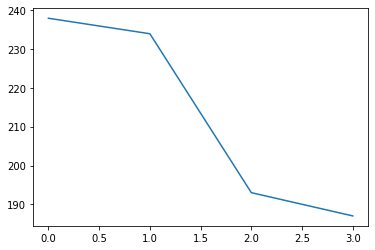

FB7C 4


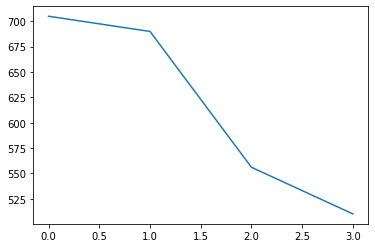

FB7A 4


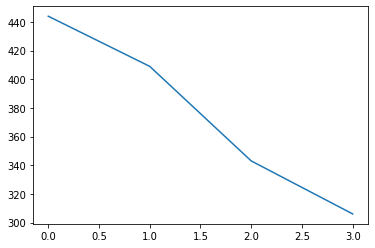

ADL20i_pct 4


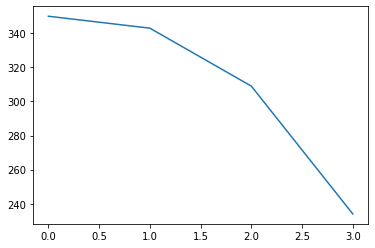

ADL02g_pct 4


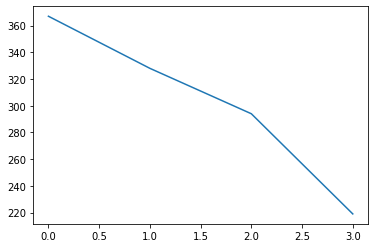

FB8B 4


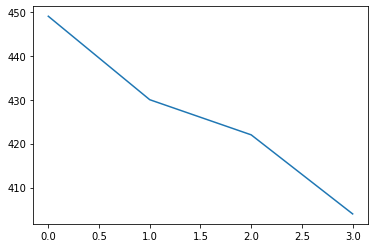

FB6T 4


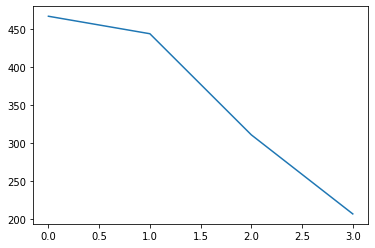

FB7B_a 4


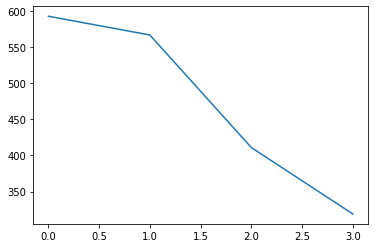

FB1D 4


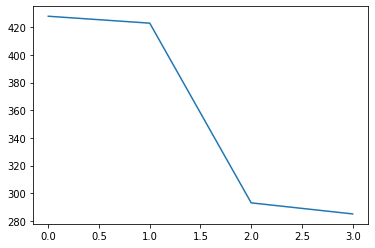

ADL23f_pct 4


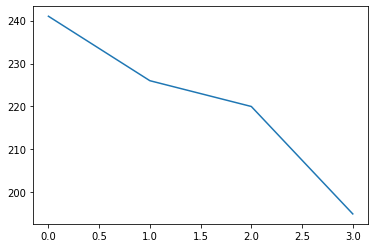

ADL13t_pct 4


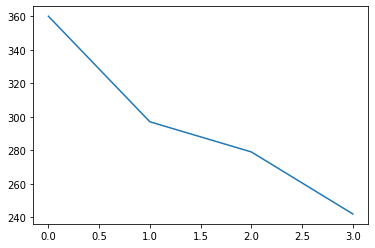

AVM13a_a_pct 4


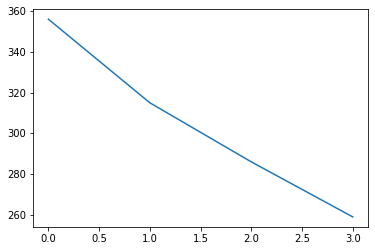

ADL18f_pct 4


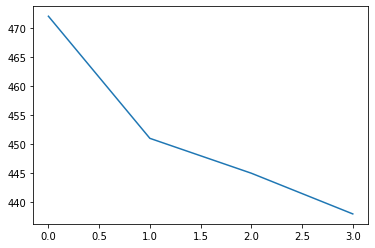

PDL14r_pct 4


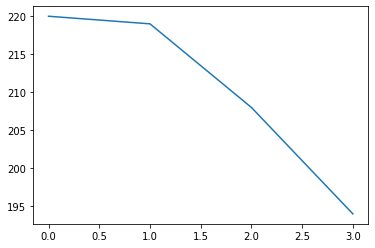

ADL20e_b_pct 4


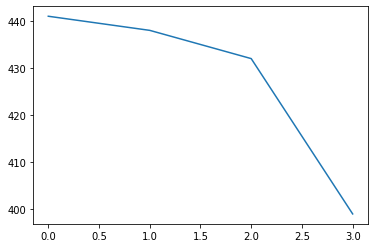

PDL14p_pct 4


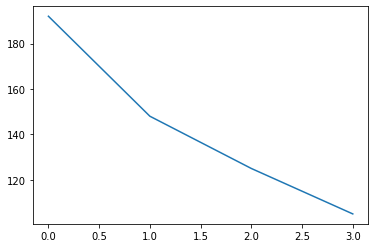

PDL16i_pct 4


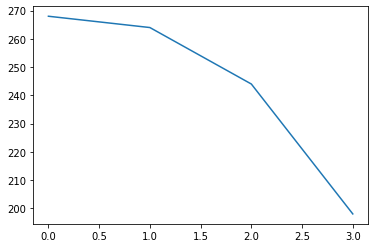

PDL11u_a_pct 4


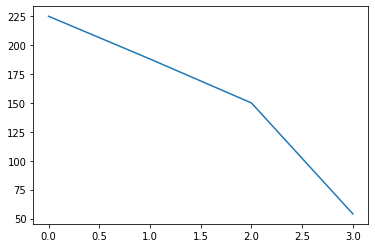

ADL07oc_pct 4


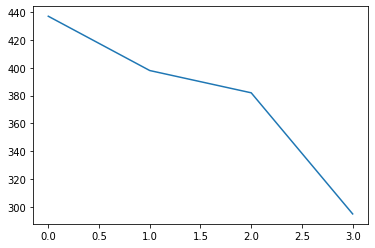

ADL15m_pct 4


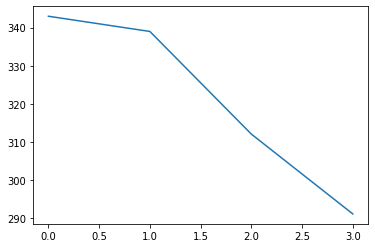

ADL10h_pct 4


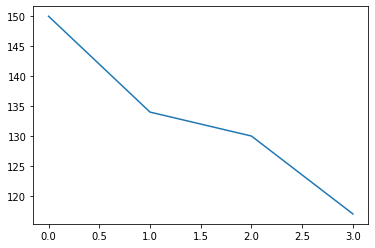

PDL10g_e_pct 4


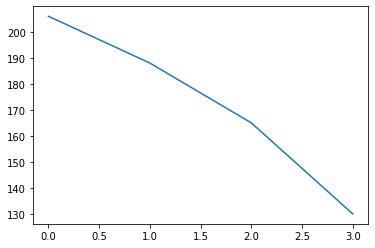

PDL15g_pct 4


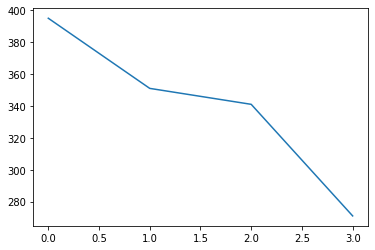

ADL14b_pct 4


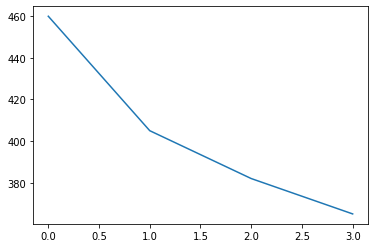

ADL02j_a_pct 4


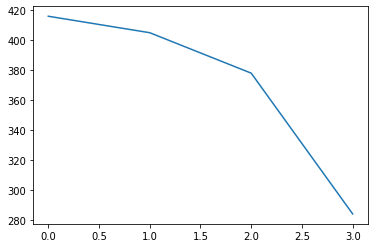

ADL02i_b_pct 4


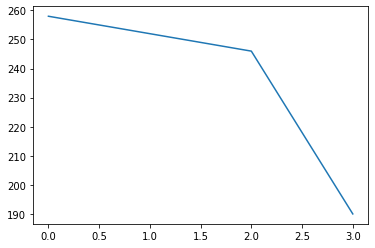

ADL03w_pct 4


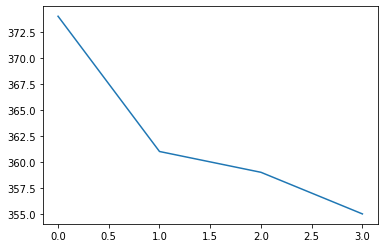

ADM04oa_pct 4


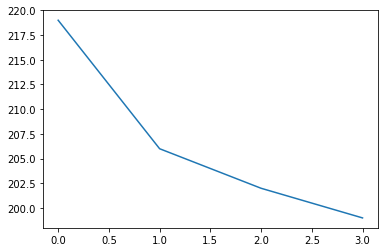

ADL18n_pct 4


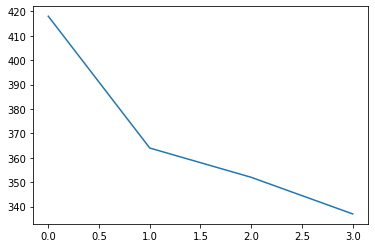

ADL27d_pct 4


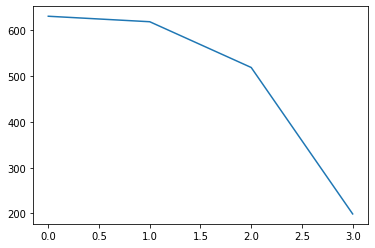

PDM20c_a_pct 4


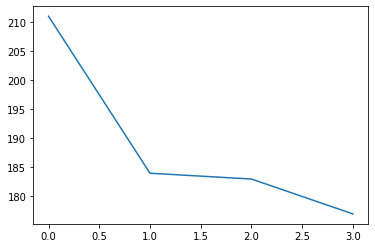

ADL09b_a_pct 4


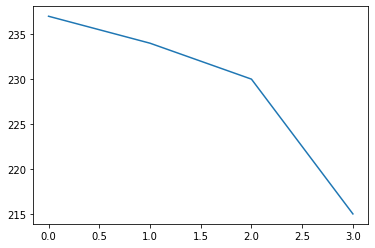

PDL10g_d_pct 4


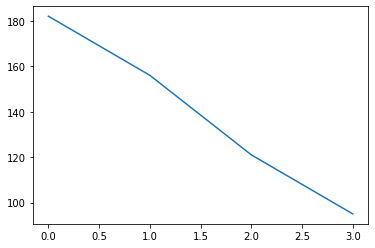

SA2_b 4


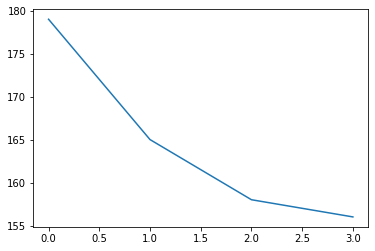

FB2B_b 4


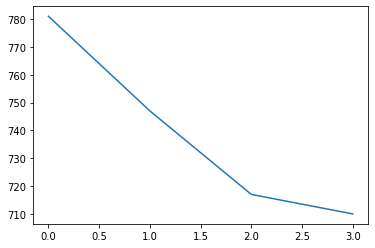

FB1C 4


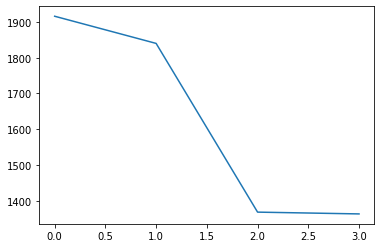

FB9C_b 4


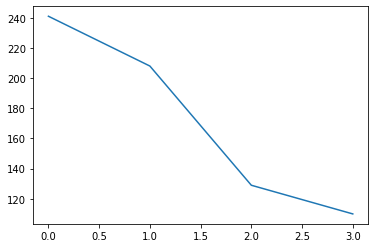

SA2_a 4


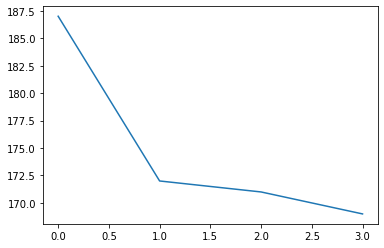

FB2F_c 4


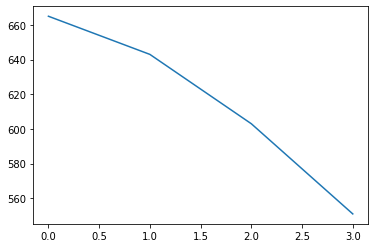

FB4Y 4


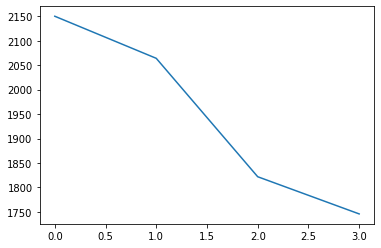

FB2I_a 4


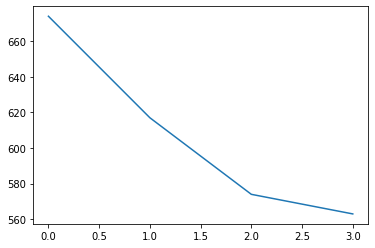

FB9C_a 4


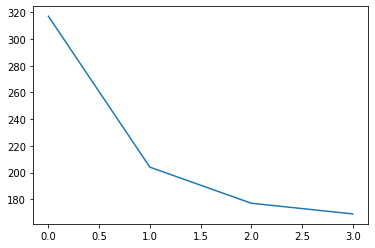

PDL16j_pct 4


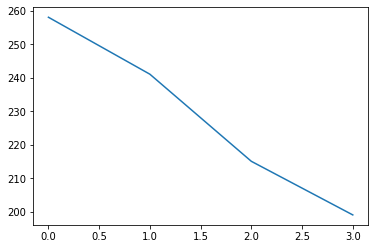

ADL13g_pct 4


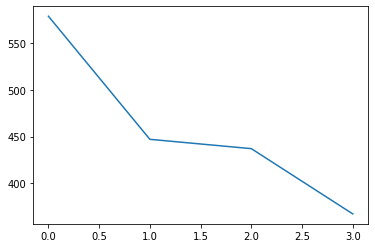

ADL05y_b_pct 4


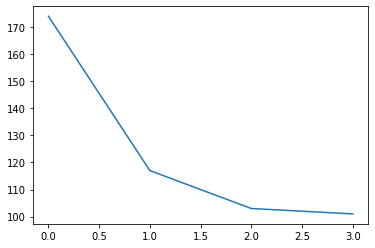

PDL11i_pct 4


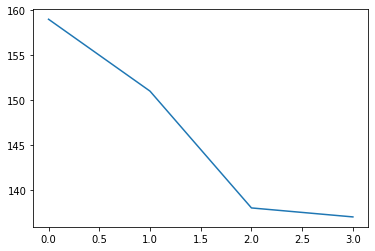

ADL11h_c_pct 4


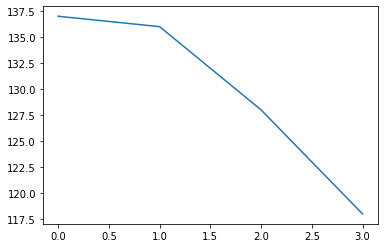

ADL10f_pct 4


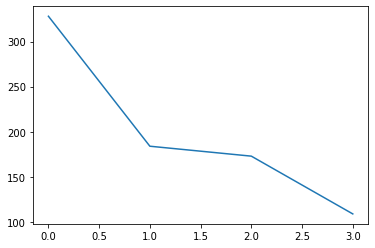

PDL23g_pct 4


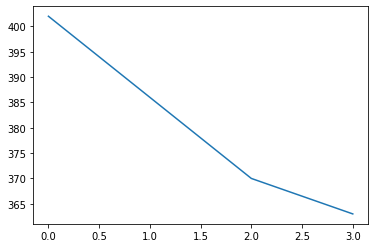

PDM07t_pct 4


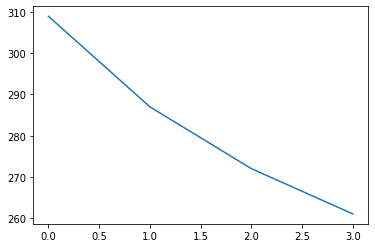

ADM04v_a_pct 4


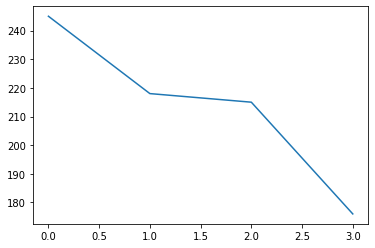

ADL01w_a_pct 4


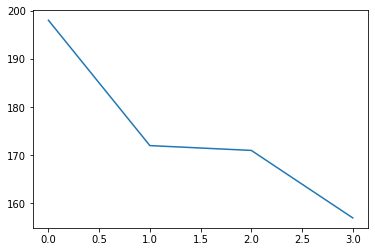

ADL04m_pct 4


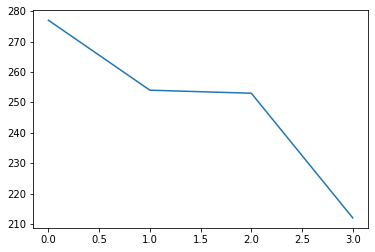

ADL05n_pct 4


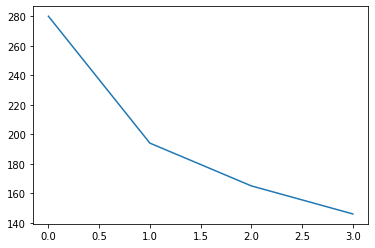

AVL02q_b_pct 4


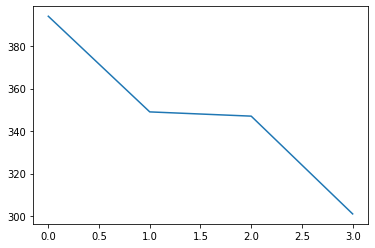

AVL07m_pct 4


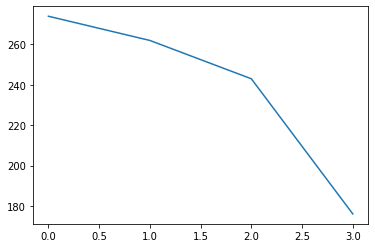

PDM12b_b_pct 4


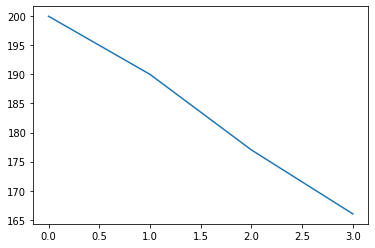

ExR4 4


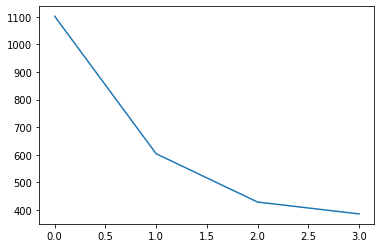

AVL02m_b_pct 4


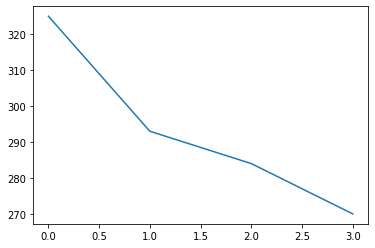

ADL21f_b_pct 4


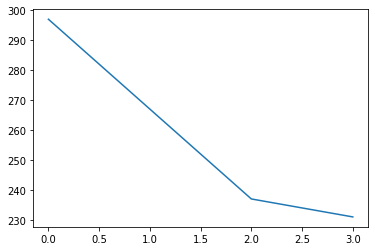

PDM11b_b_pct 4


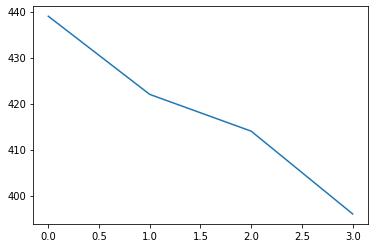

ADL21d_b_pct 4


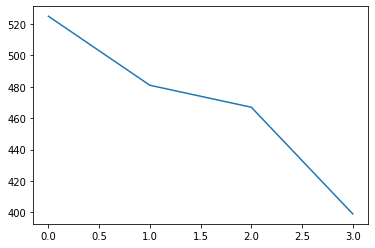

PVL07m_pct 4


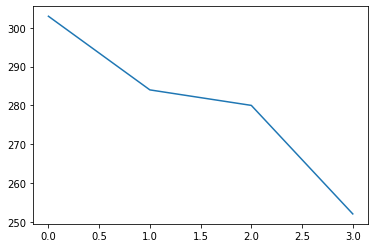

PDM09z_pct 4


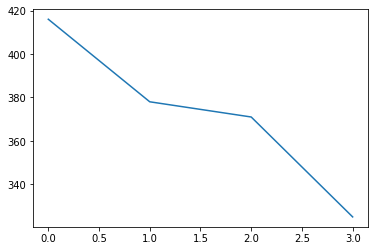

AVL02g_pct 4


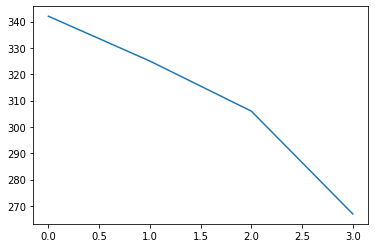

PDM11k_pct 4


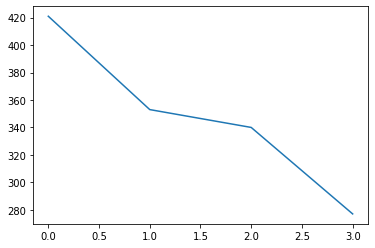

PDM11m_a_pct 4


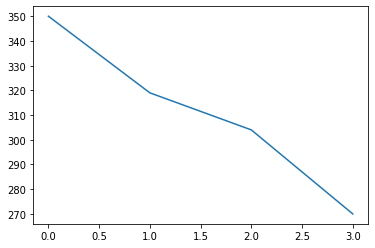

ADM04n_d_pct 4


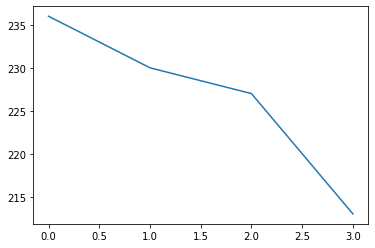

ADL18b_pct 4


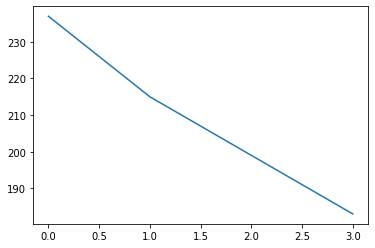

PDM15q_pct 4


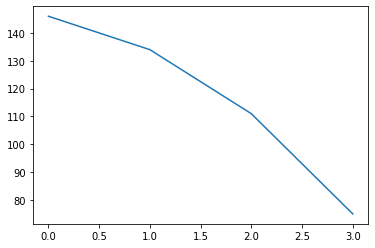

ADL08n_a_pct 4


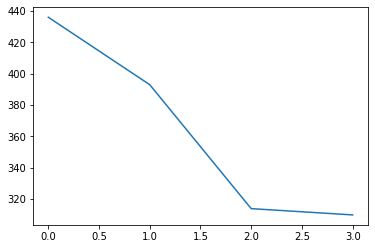

PDM22s_pct 4


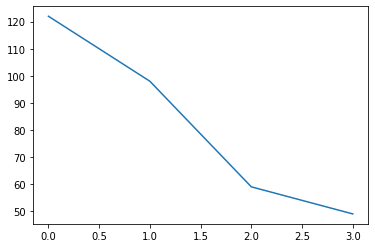

PDM12ok_pct 4


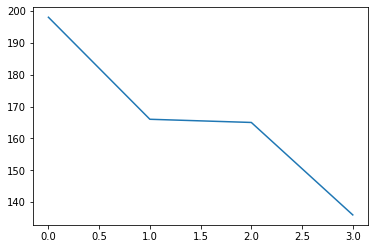

PDM06j_b_pct 4


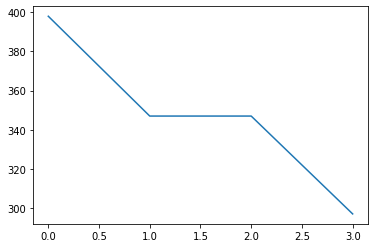

ADM01p_pct 4


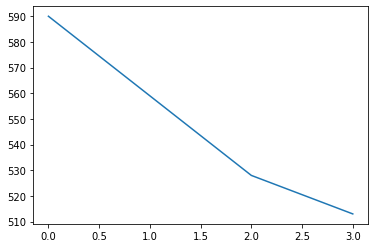

PDL11a_a_pct 4


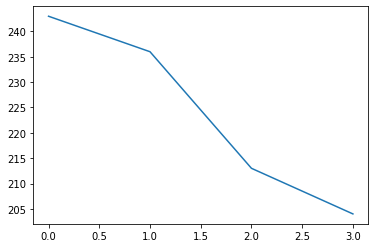

PDM06g_a_pct 4


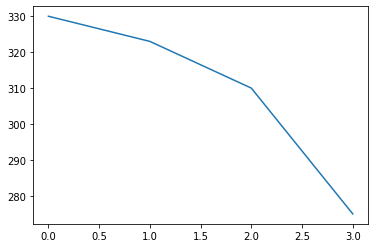

PDM11a_pct 4


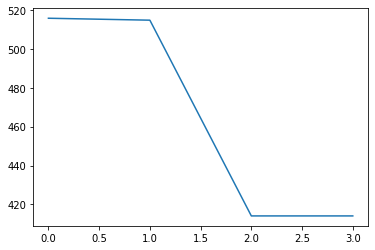

PDM07x_pct 4


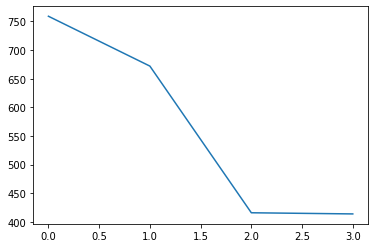

PDL21i_pct 4


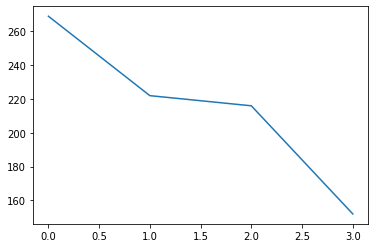

AVL03d_a_pct 4


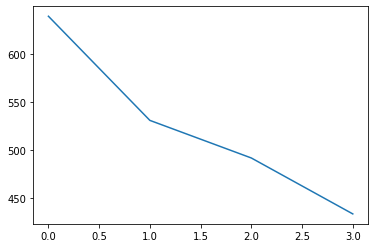

AVL03b_e_pct 4


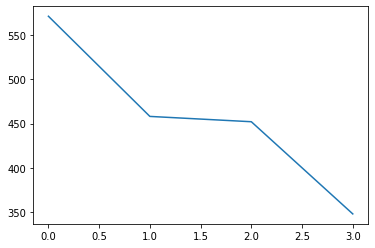

AVM13t_pct 4


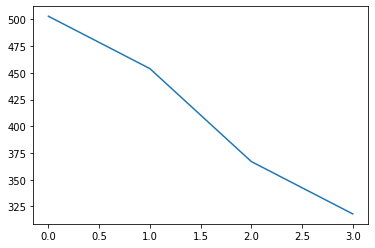

AVL06og_pct 4


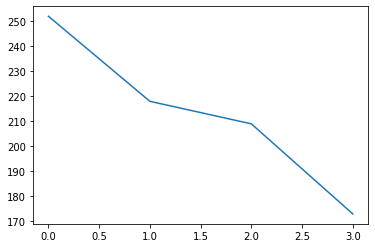

ADL14u_pct 4


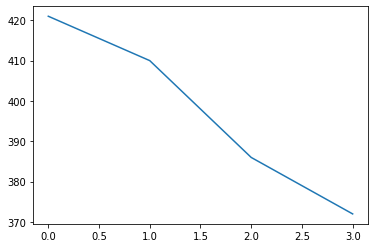

SIFamide 4


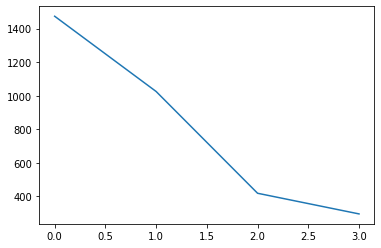

PDM11c_pct 4


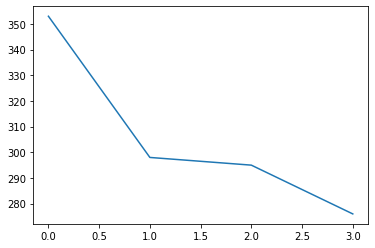

AVL06v_e_pct 4


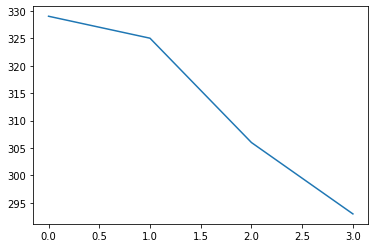

PDM18f_pct 4


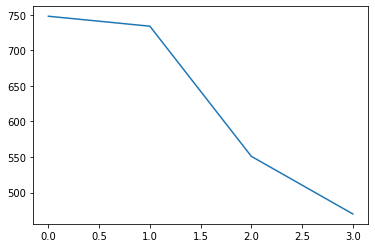

PDM16b_pct 4


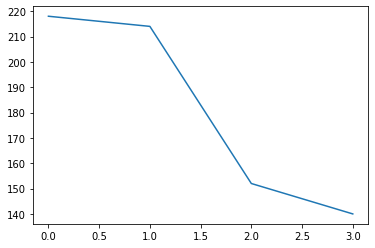

PDM10m_b_pct 4


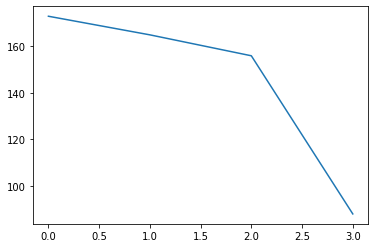

ADL06g_pct 4


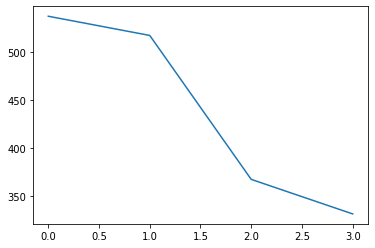

ADL18k_pct 4


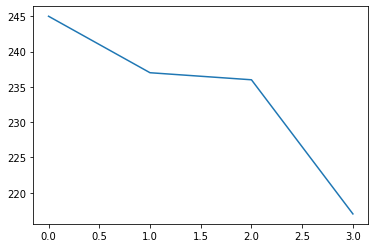

PDL24e_pct 4


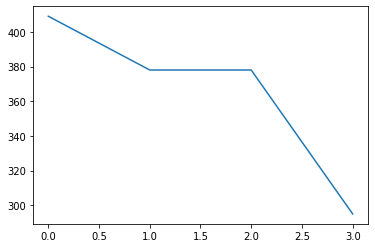

ADL22f_b_pct 4


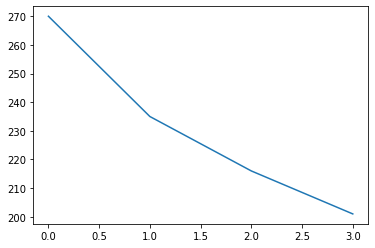

ADL12i_pct 4


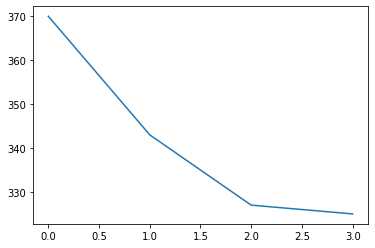

ADL16n_pct 4


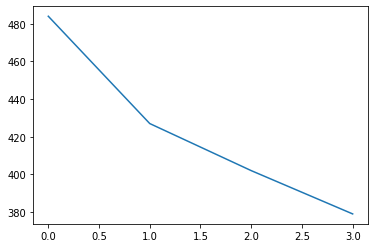

ADM04t_pct 4


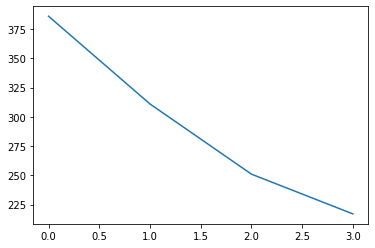

PDM15k_pct 4


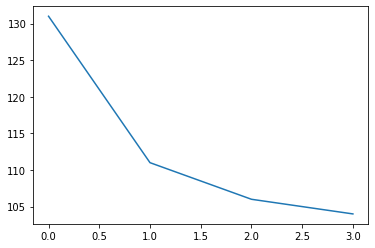

ADM01i_a_pct 4


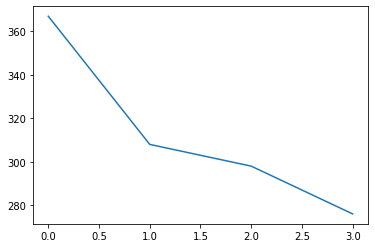

PDM05h_a_pct 4


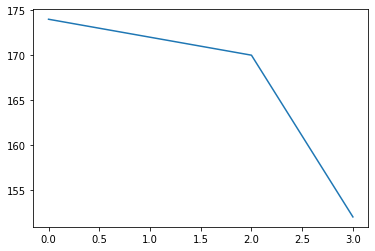

PDM08h_pct 4


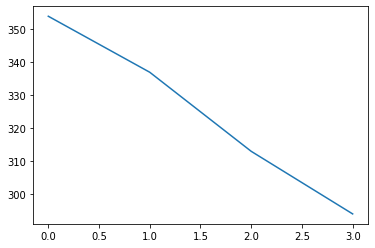

PDL06oe_pct 4


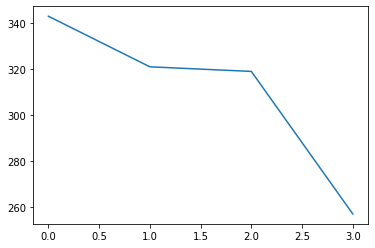

ADL02oq_pct 4


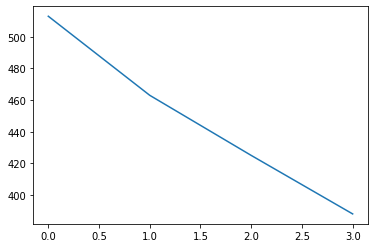

AVM13a_b_pct 4


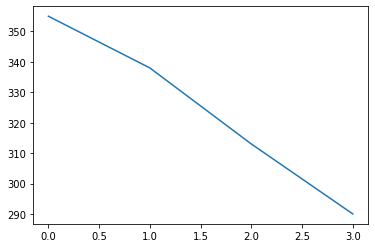

ADL18i_pct 4


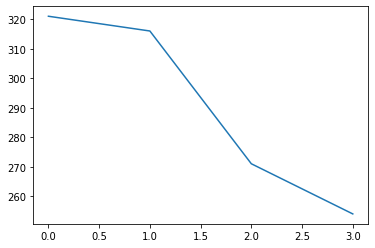

AVM13g_pct 4


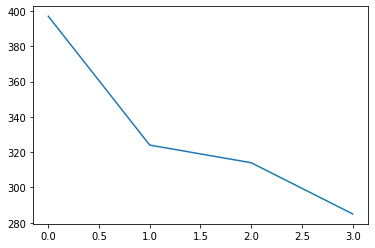

PVL13g_pct 4


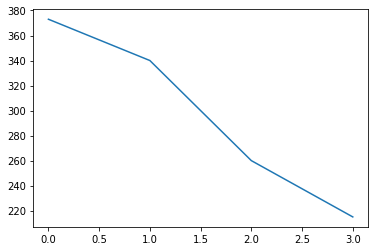

ADL12f_pct 4


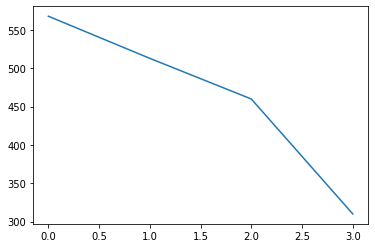

PDM05j_h_pct 4


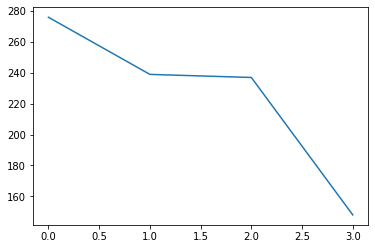

PDM15g_d_pct 4


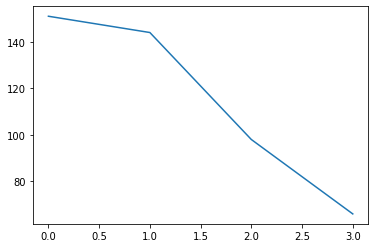

PDM11m_b_pct 4


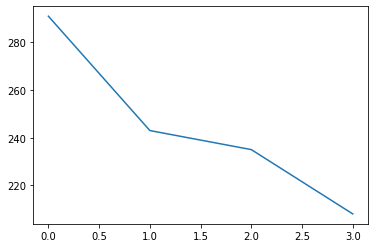

PVL06w_pct 4


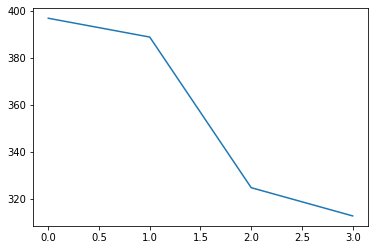

AVL06w_b_pct 4


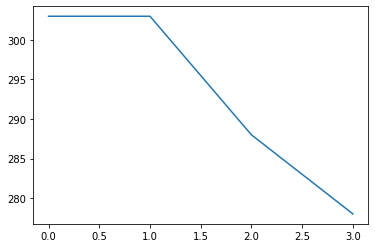

AVL03k_b_pct 4


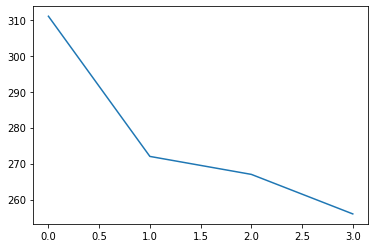

PVL05h_pct 4


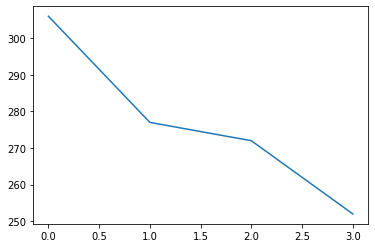

AVL12m_pct 4


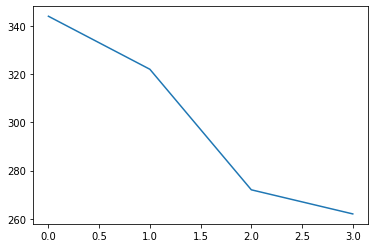

PDL22b_pct 4


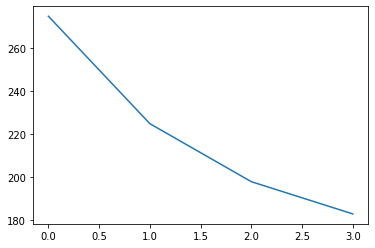

ADL19a_pct 4


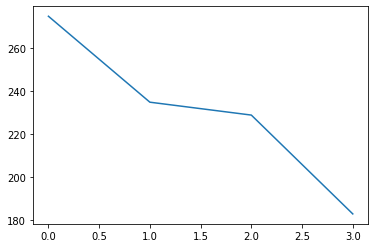

PDM20e_e_pct 4


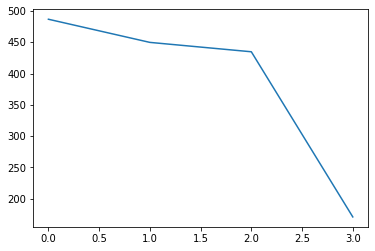

ADL04w_pct 4


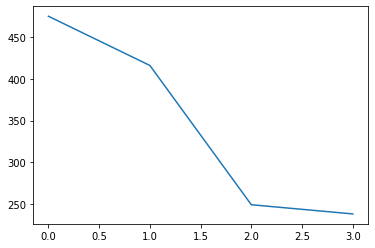

ADL02og_pct 4


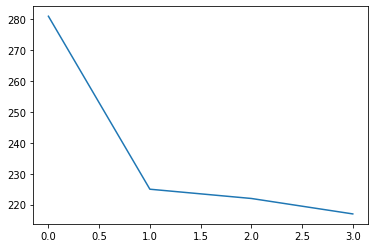

ADL03op_pct 4


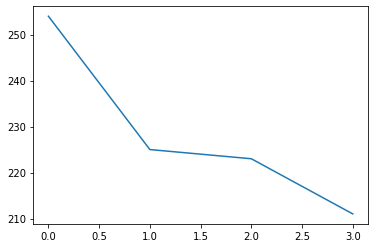

PDL15i_pct 4


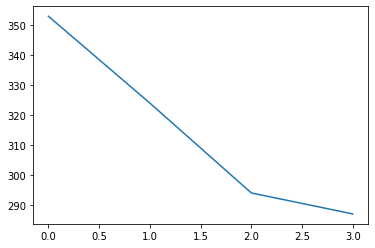

PDM08oj_pct 4


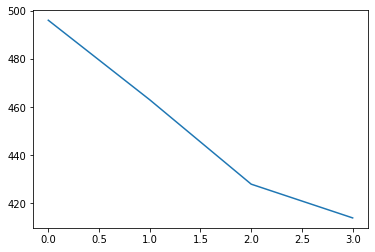

PDL15a_pct 4


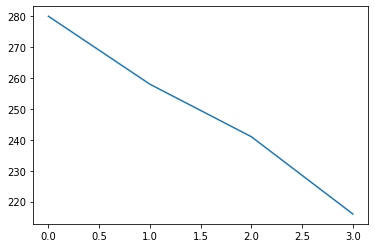

FB6U 4


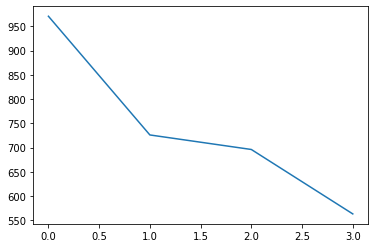

FB7J 4


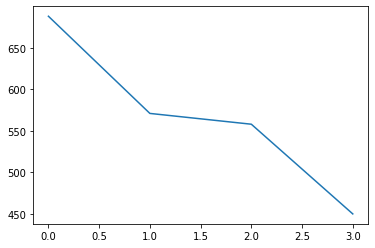

PDL10e_pct 4


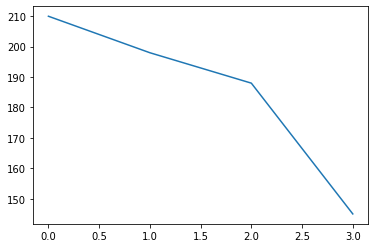

ADL05p_a_pct 4


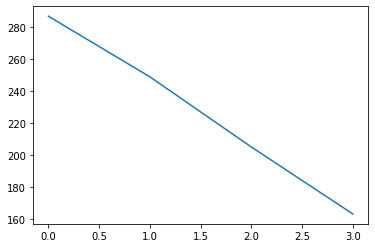

ADL05r_pct 4


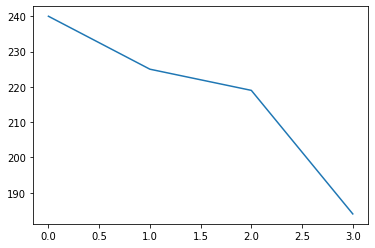

FB4K 4


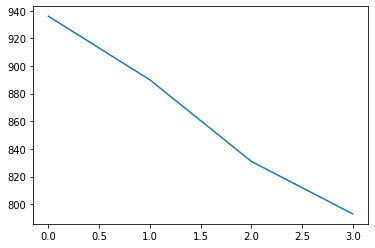

PDM15g_c_pct 4


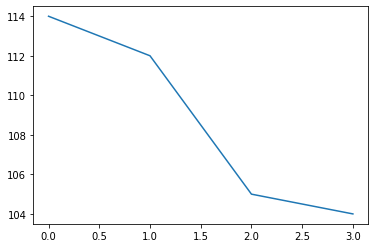

PDL07oc_pct 4


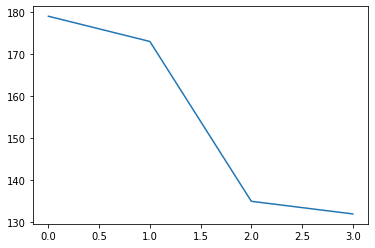

ADM07oa_pct 4


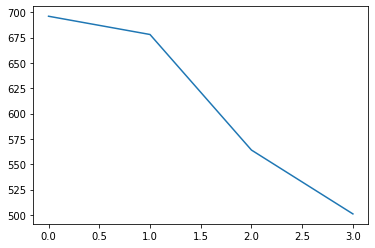

PDM31c_pct 4


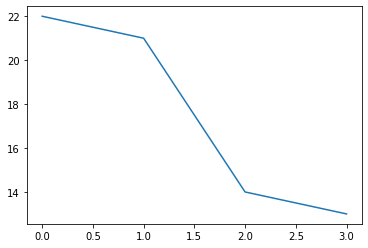

AVL04a_a_pct 4


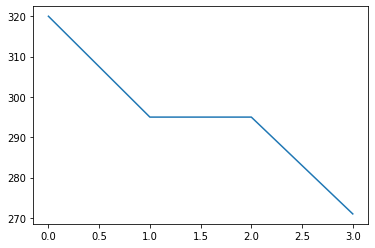

PDM21a_pct 4


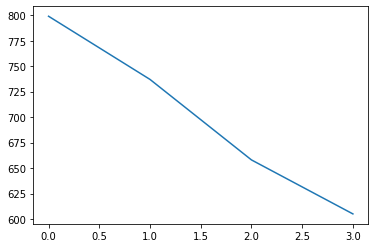

PVL08k_pct 4


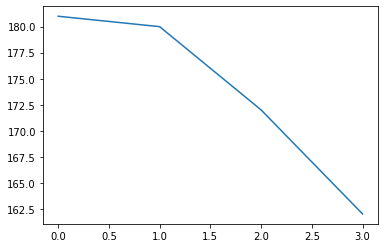

ADM10j_pct 4


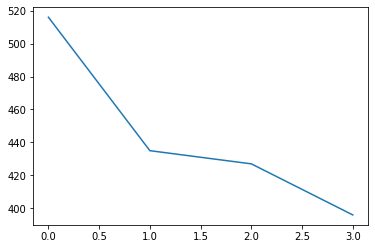

ADM07of_pct 4


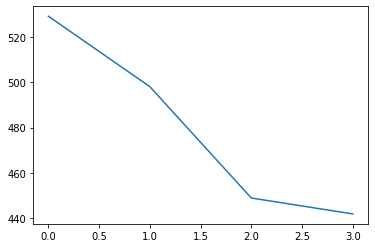

ADM10g_pct 4


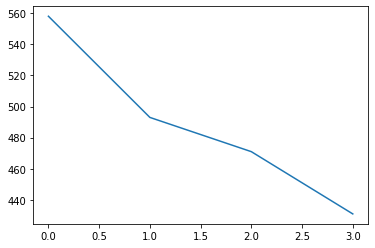

ADL04p_a_pct 4


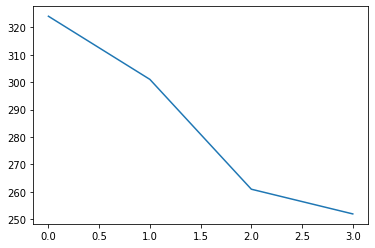

ADM07c_pct 4


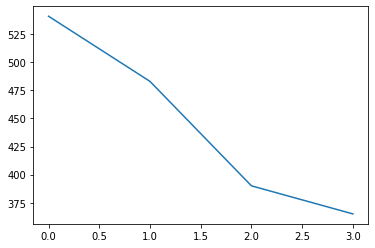

ADL18m_pct 4


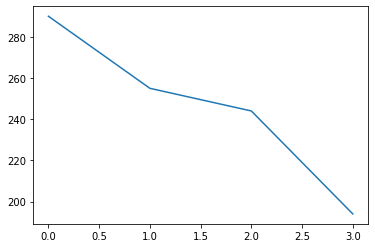

PDL11of_pct 4


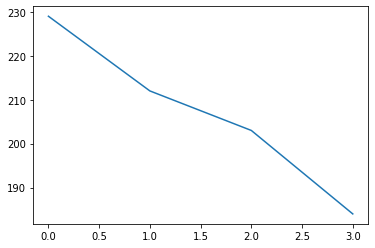

ExR8 4


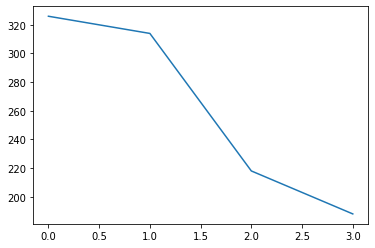

FB4L 4


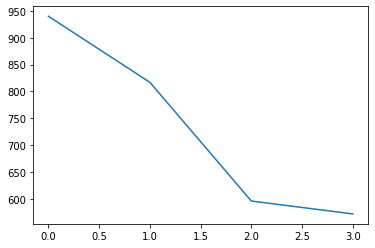

FB1E_a 4


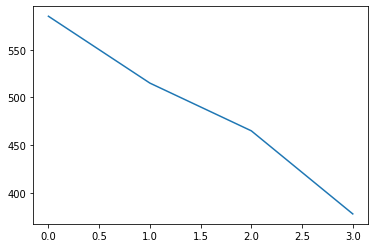

FB5Q 4


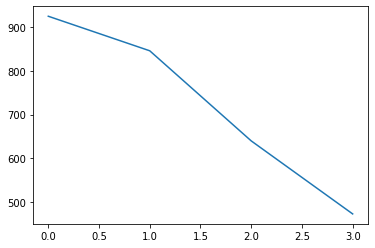

FB5A 4


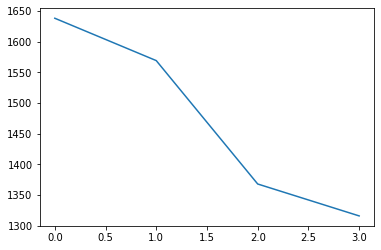

FB5Y 4


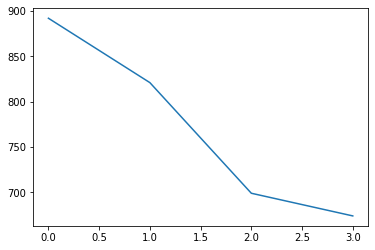

ADM07g_a_pct 4


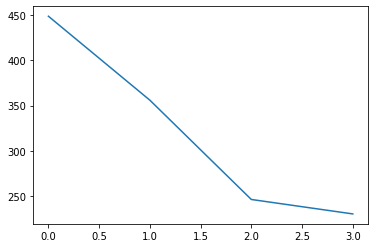

FB5Z 4


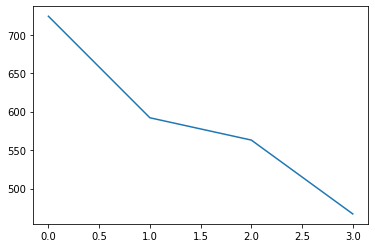

FB5P 4


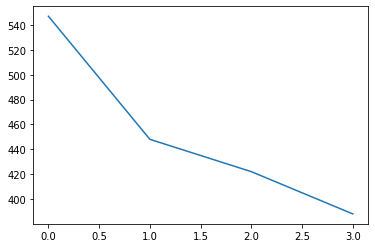

ExR7 4


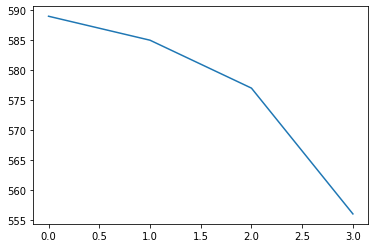

ExR5 4


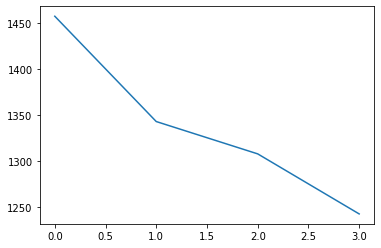

FB2J 4


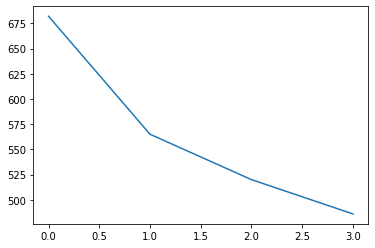

ADL04h_pct 4


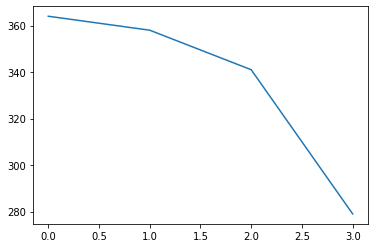

FB2G_b 4


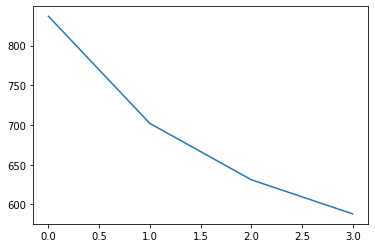

PVL03ov_pct 4


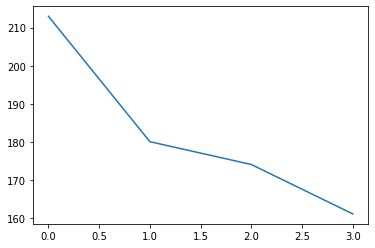

ADL04x_pct 4


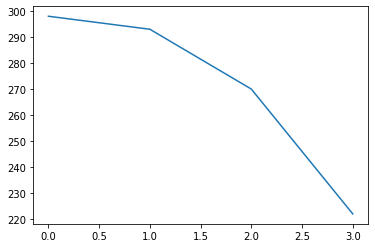

PDL23m_pct 4


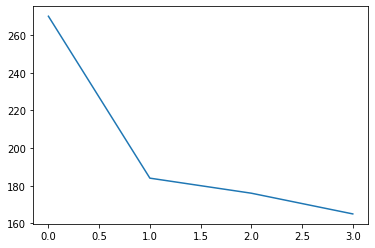

PVL03c_d_pct 4


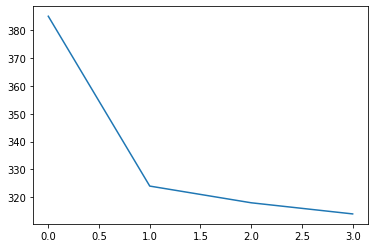

ADL13c_a_pct 4


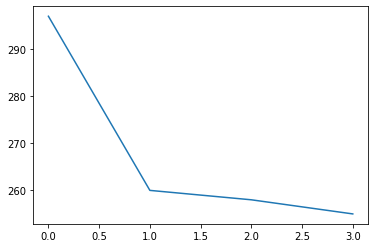

AVL12j_pct 4


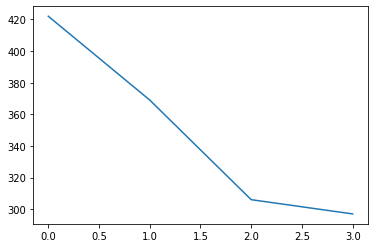

ADL01os_pct 4


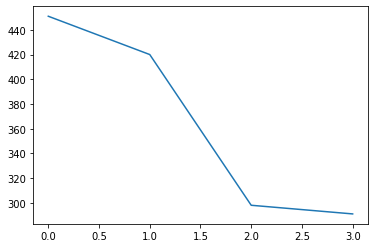

ADL11j_a_pct 4


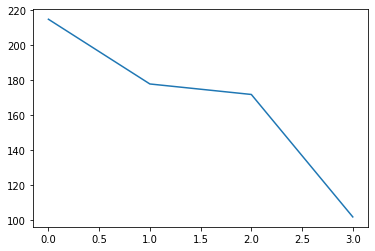

PDL13f_b_pct 4


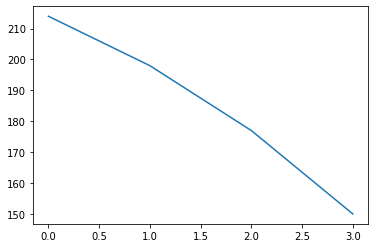

FB4R 4


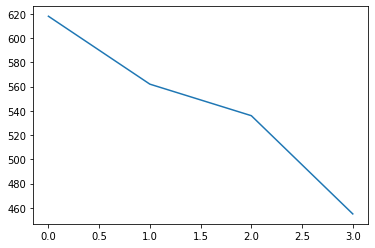

PDL06on_pct 4


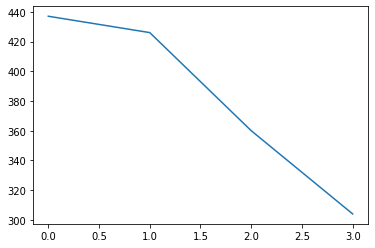

ADL10g_c_pct 4


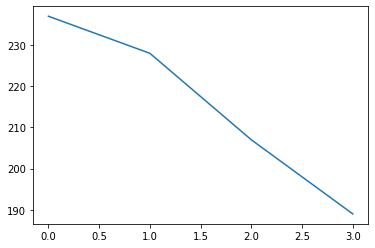

AVM07a_b_pct 4


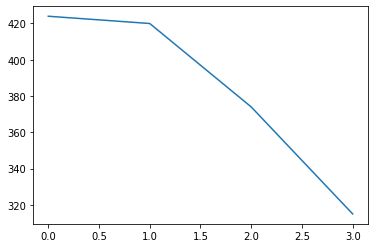

ADL10g_b_pct 4


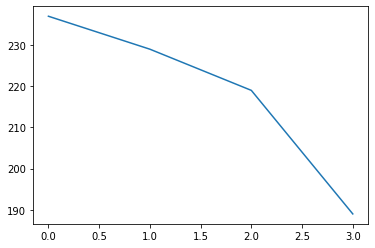

MBON14 4


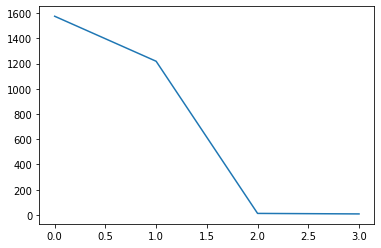

PDL10b_pct 4


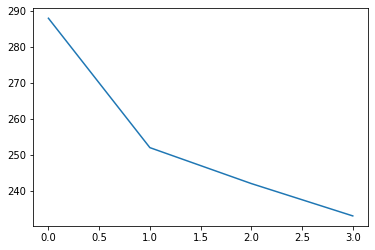

PDM13r_i_pct 4


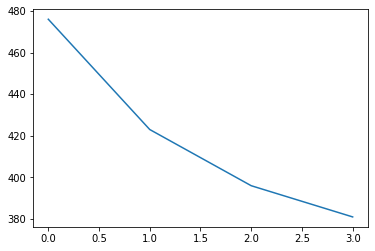

PDL07n_pct 4


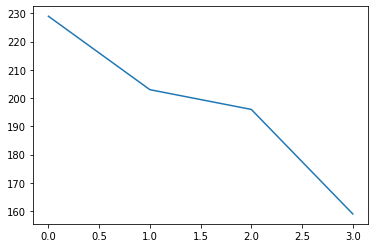

ADL09w_pct 4


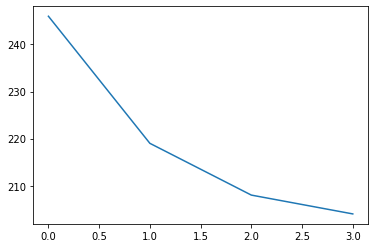

ADL15i_a_pct 4


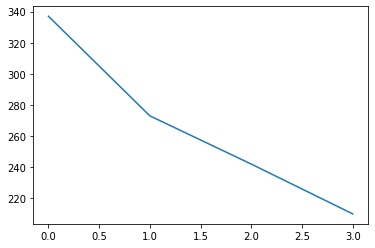

ADL11r_pct 4


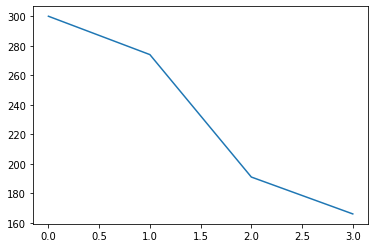

ADL04q_b_pct 4


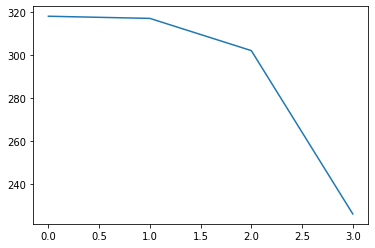

ADL19j_pct 4


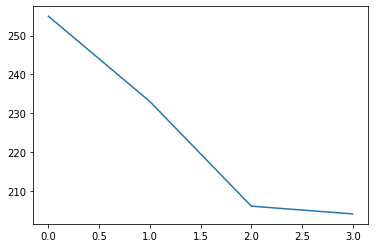

PDL19f_a_pct 4


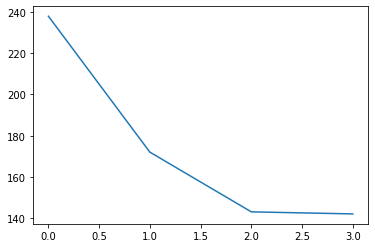

PDL22g_pct 4


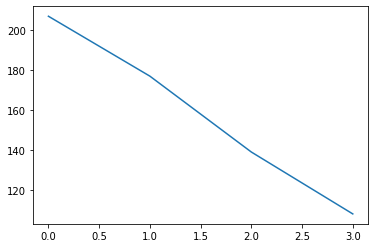

ADL15g_d_pct 4


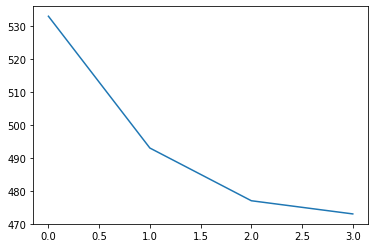

AVM13h_pct 4


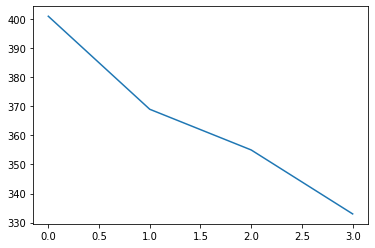

FB4S 4


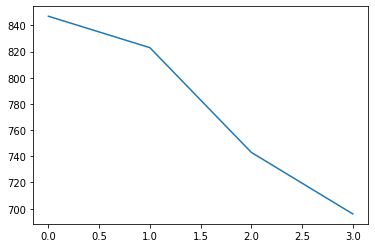

ADL05w_c_pct 4


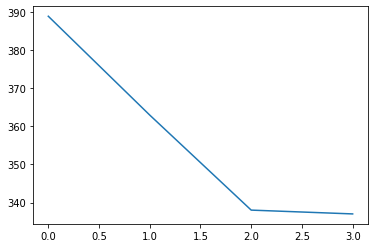

PDL13f_c_pct 4


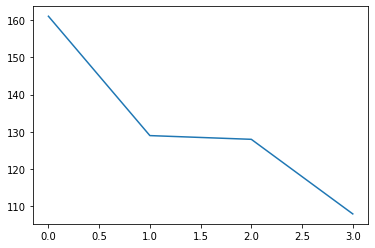

ADL06b_a_pct 4


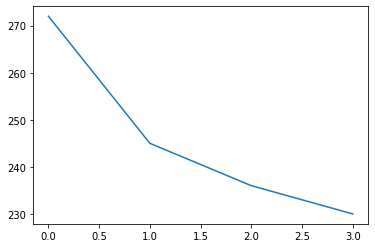

AVM15b_pct 4


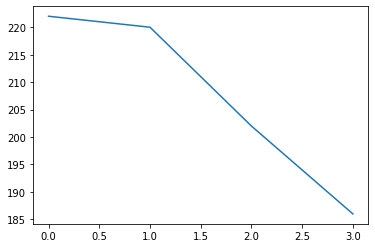

PDM05p_pct 4


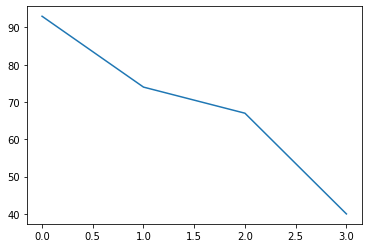

ADL06b_b_pct 4


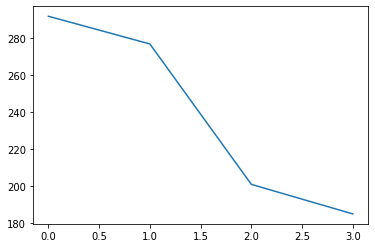

PDM08i_pct 4


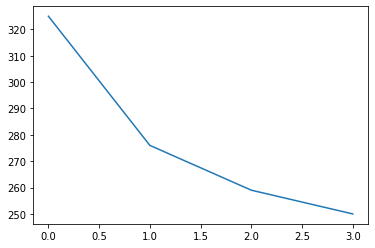

FB2A 4


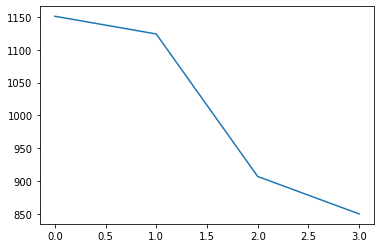

AVM07b_a_pct 4


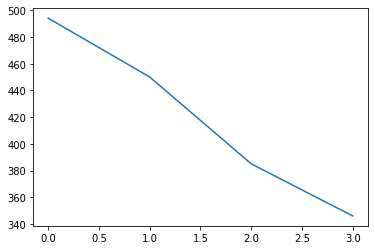

FB4Q_b 4


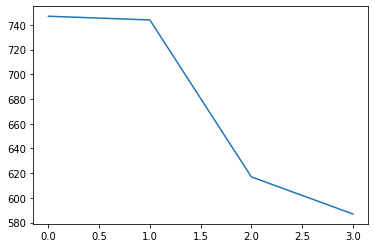

AVM07y_b_pct 4


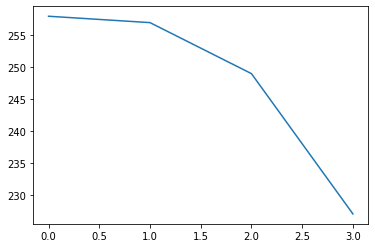

ADL09q_pct 4


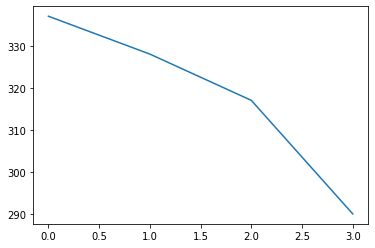

AVM13p_pct 4


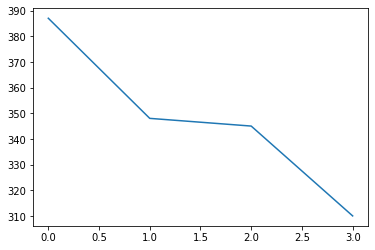

AVM07g_b_pct 4


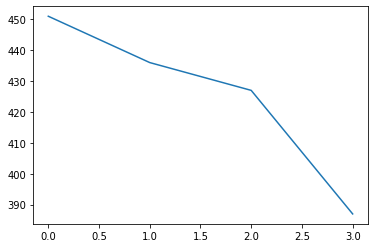

ADL09i_pct 4


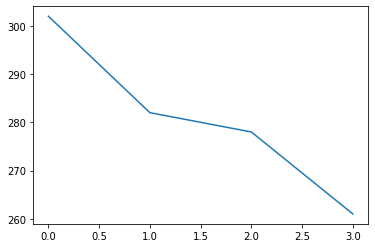

PDM13e_b_pct 4


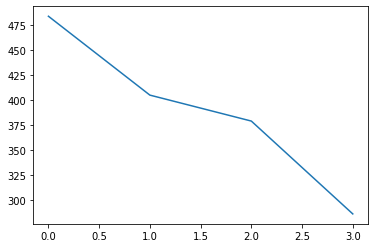

AVM07b_b_pct 4


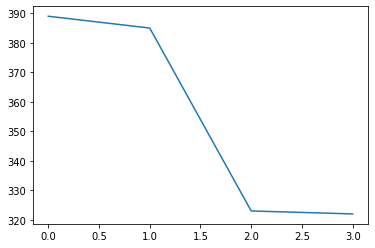

ADM05q_pct 4


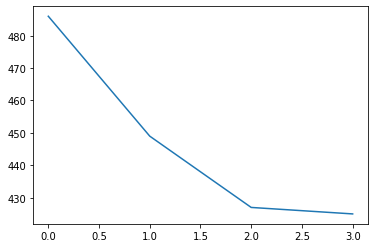

AVM07f_pct 4


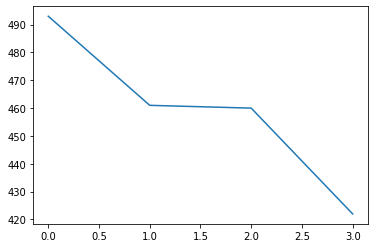

PDL06ox_pct 4


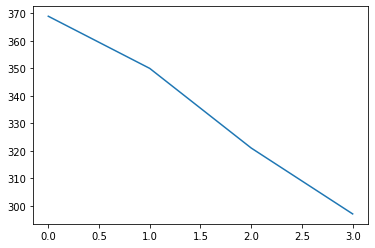

PVL04m_a_pct 4


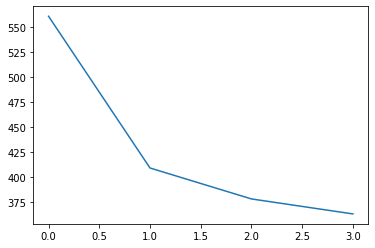

FB2B_a 4


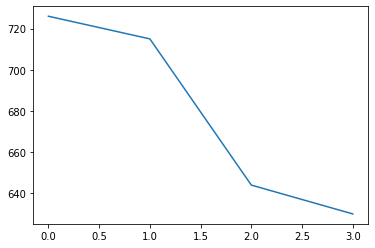

FB4M 4


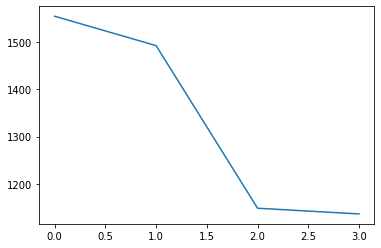

PDL05g_pct 4


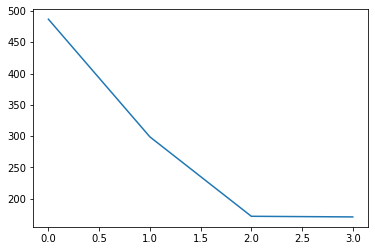

FB4P_a 4


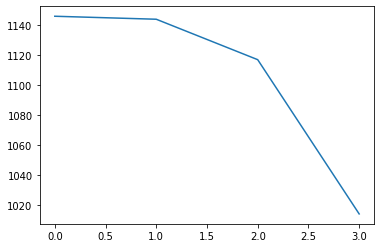

ADL09y_pct 4


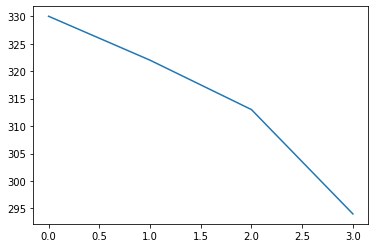

ADL02p_pct 4


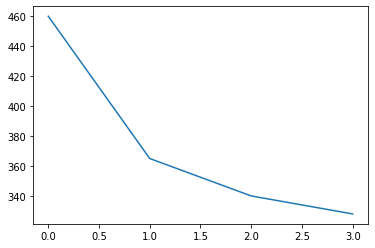

ADL04q_a_pct 4


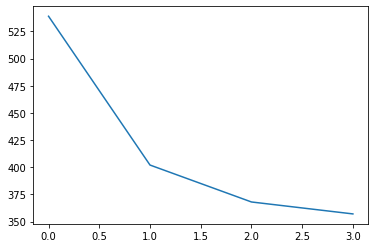

ADL08n_c_pct 4


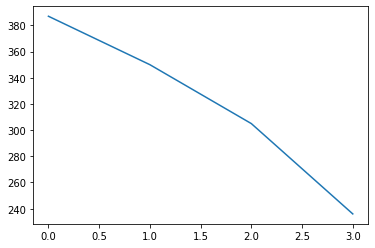

ADM07s_pct 4


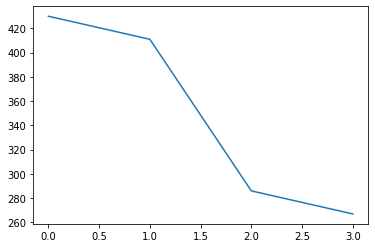

FB2E 4


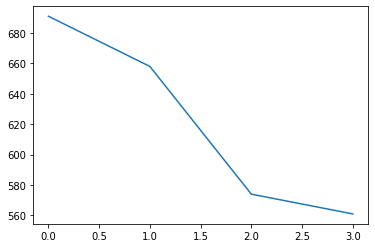

PDL11j_pct 4


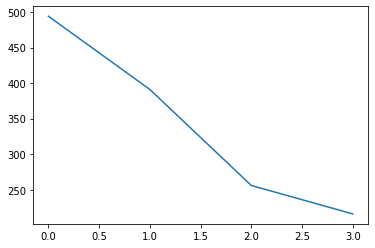

ADL14k_pct 4


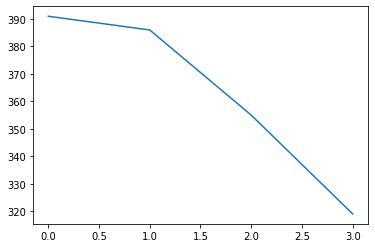

LC28c 4


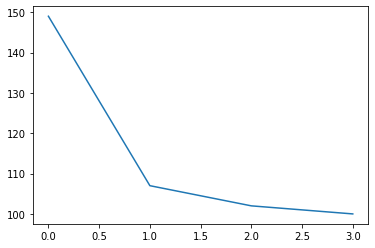

ADL01oj_pct 4


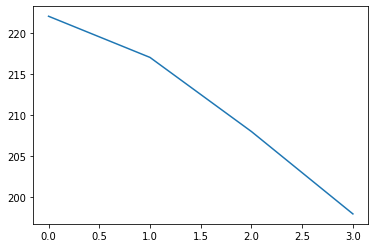

ADL05z_a_pct 4


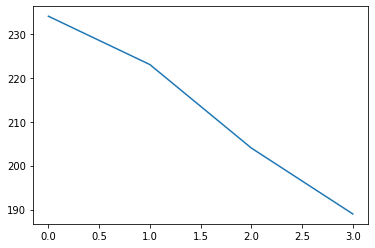

PVL03v_pct 4


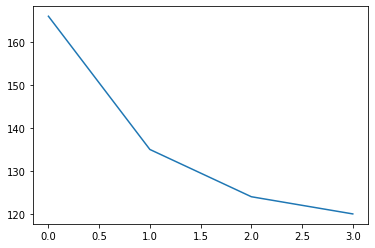

PVL14a_pct 4


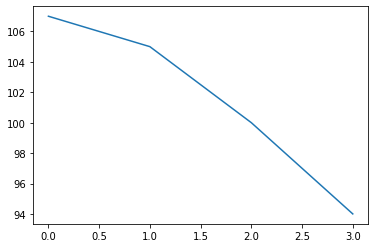

multi lPN mALT 4


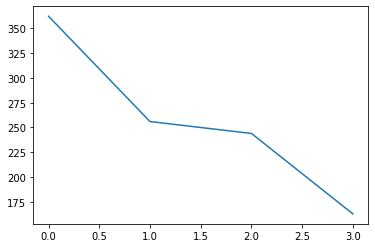

ADL01p_pct 4


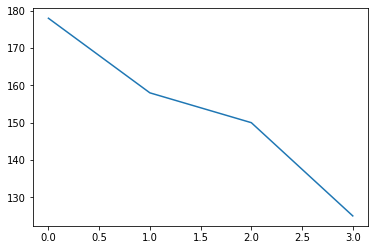

PDM10u_pct 4


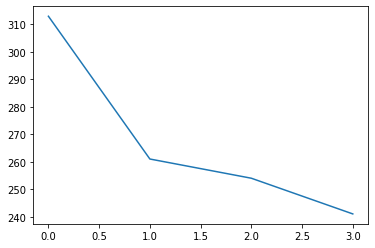

PDM13a_pct 4


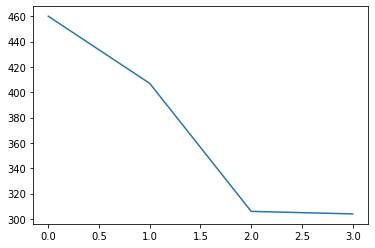

s-LNv 4


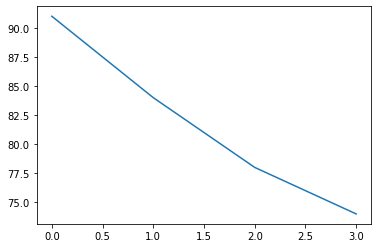

ADL08g_a_pct 4


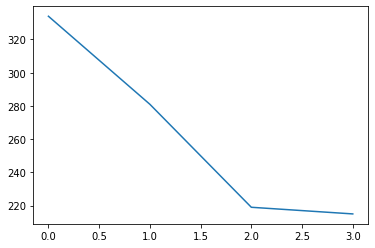

ExR6 4


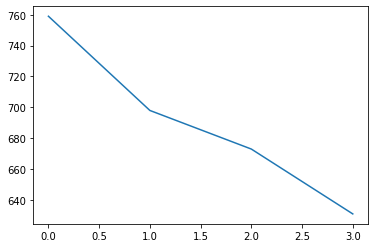

R3a_c 4


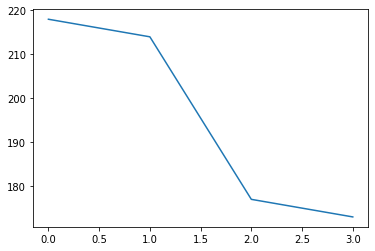

AVL04u_a_pct 4


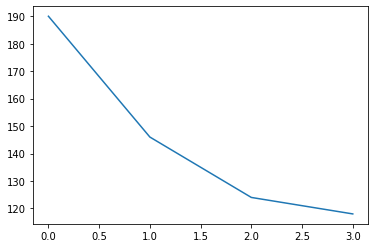

AVL04t_pct 4


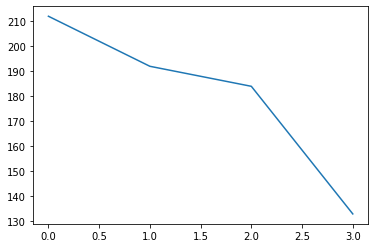

ADL08g_b_pct 4


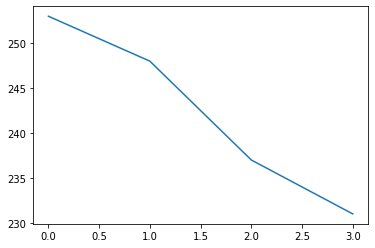

AVM14t_pct 4


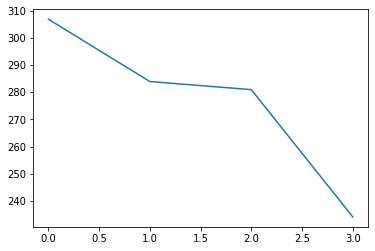

AVL05c_pct 4


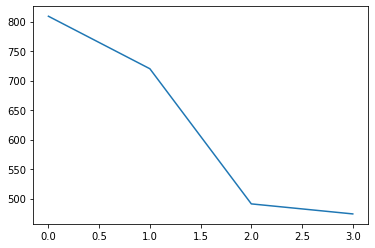

ADL01q_a_pct 4


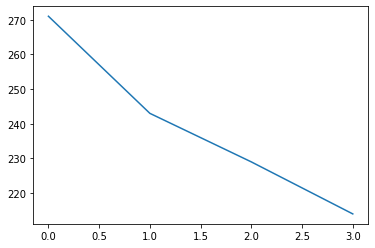

PVL16r_pct 4


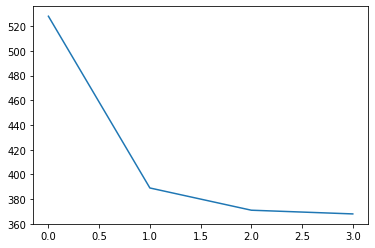

ADM03g_pct 4


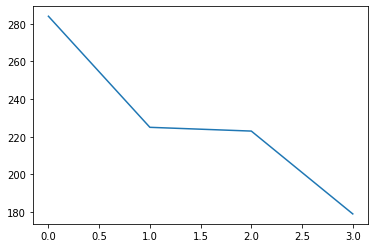

PDL08v_pct 4


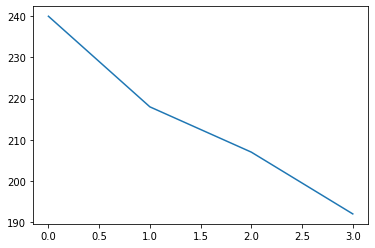

ADM05i_pct 4


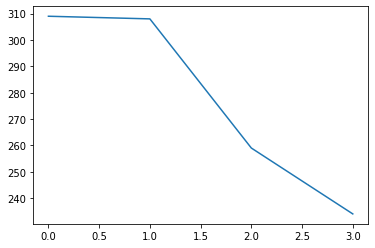

ADL01og_pct 4


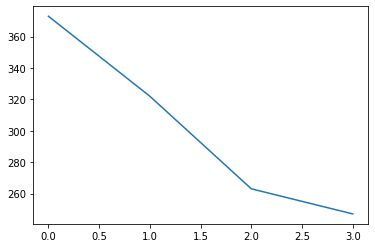

PDL08m_a_pct 4


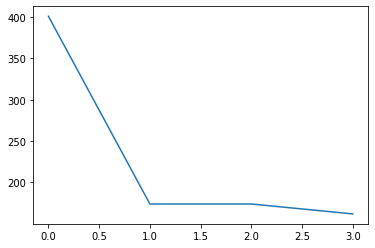

DM6 adPN 4


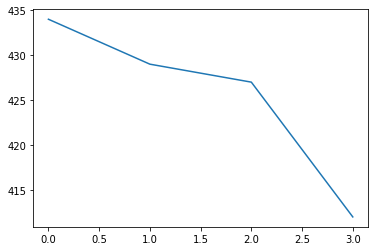

ADL05w_b_pct 4


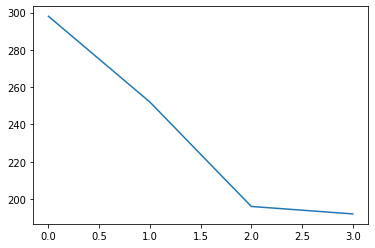

PDL08p_b_pct 4


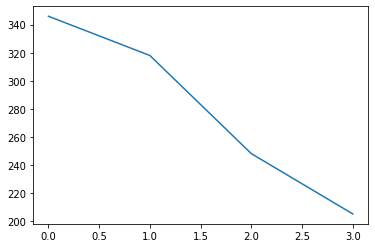

PDL12om_pct 4


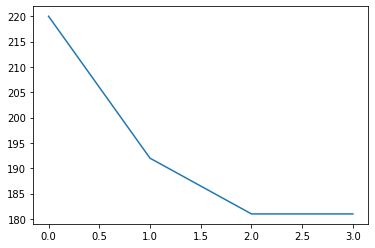

PDL12s_pct 4


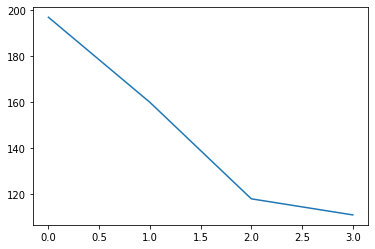

AVL01lg_pct 4


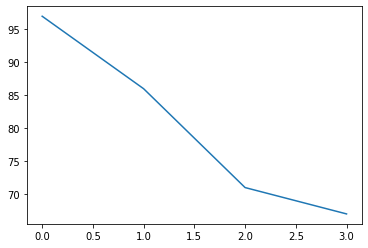

ADM07oq_pct 4


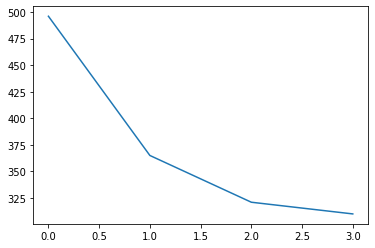

PVL03y_pct 4


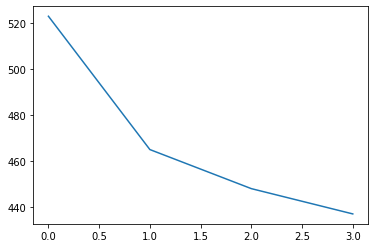

aIPg1 4


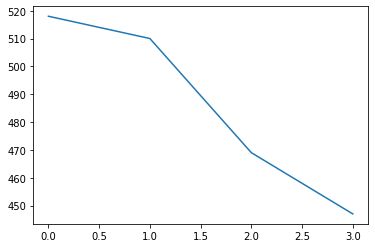

PVL08x_pct 4


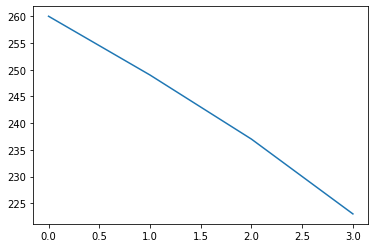

ADM01y_c_pct 4


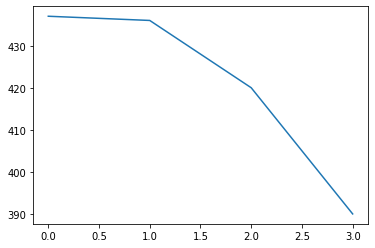

ADM05p_a_pct 4


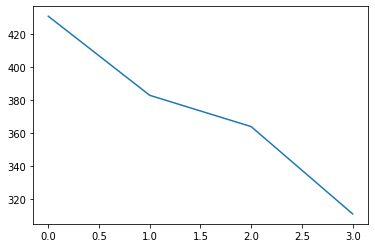

aSP10C_b 4


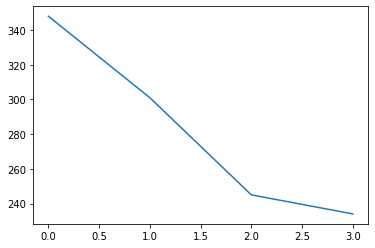

aSP10B 4


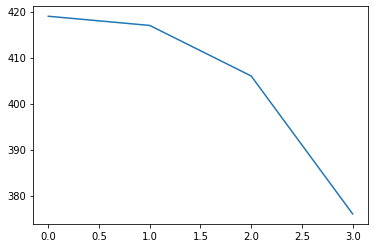

PVL08w_pct 4


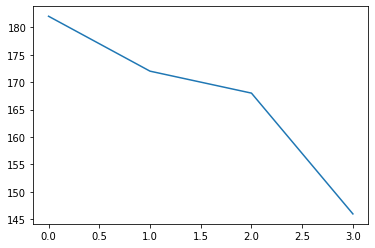

ADL22c_b_pct 4


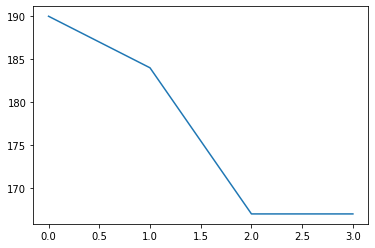

PVL03oa_pct 4


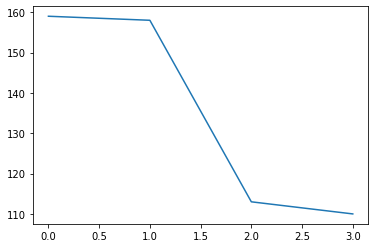

PDM16s_pct 4


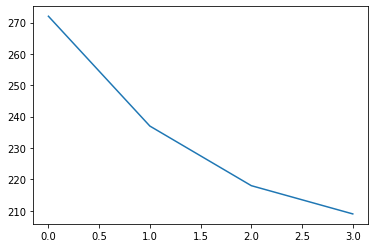

PDL24a_pct 4


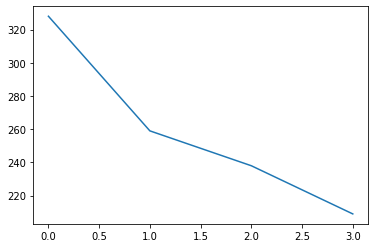

EPGt 4


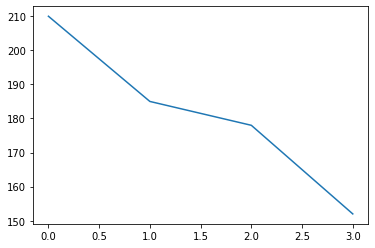

GLN 4


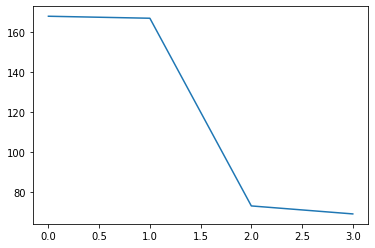

FB3A 4


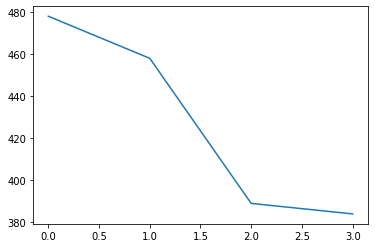

LN2 4


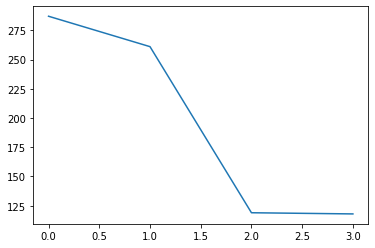

PVL16q_pct 4


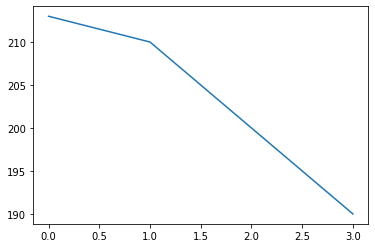

TuBu1 4


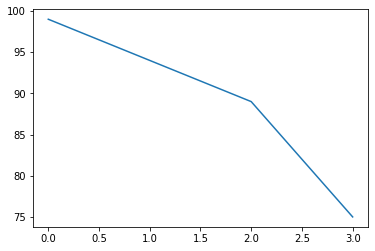

PVM08f_pct 4


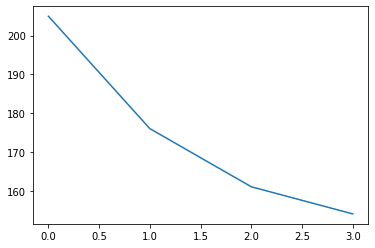

PDM11h_pct 4


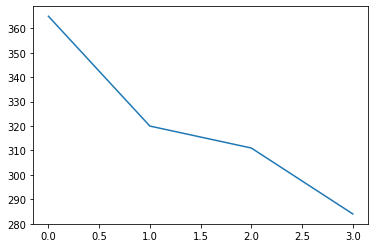

ADM01b_b_pct 4


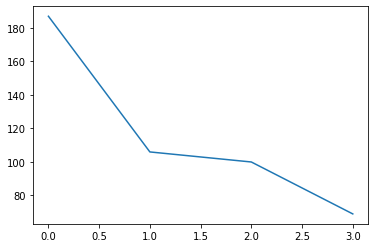

PDM16f_b_pct 4


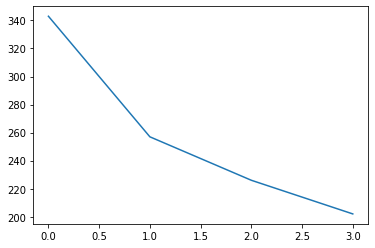

PVL13d_pct 4


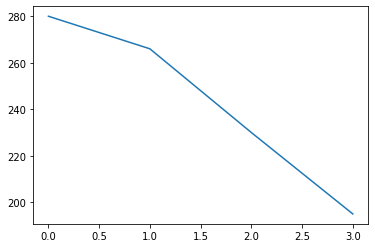

PDM16j_pct 4


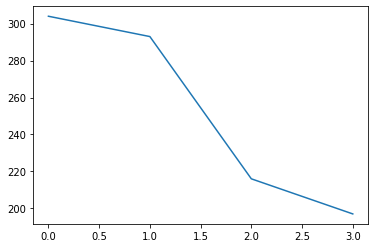

AVM11f_pct 4


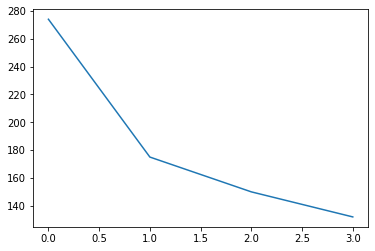

MDN 4


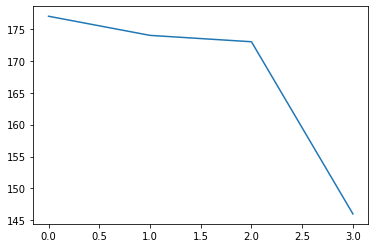

l-LNv 4


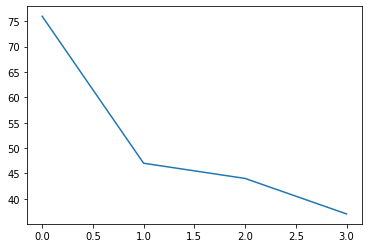

AVL02c_pct 4


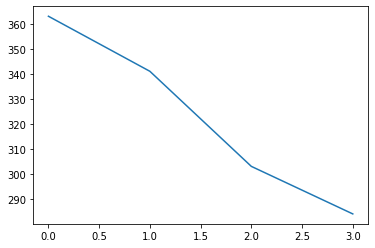

ADM01z_b_pct 4


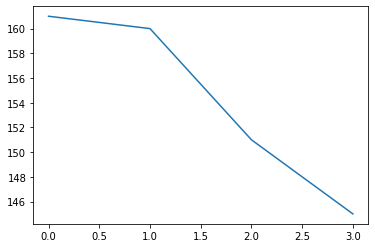

ADM06q_pct 4


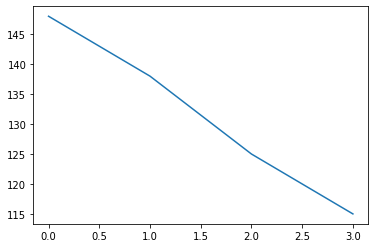

PDM19r_pct 4


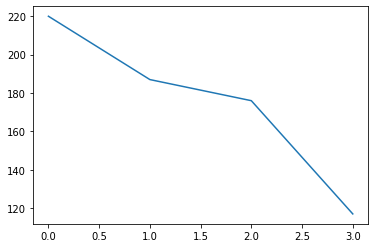

PDM26m_pct 4


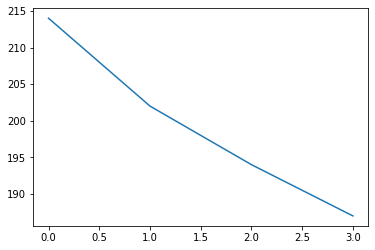

ADM01g_c_pct 4


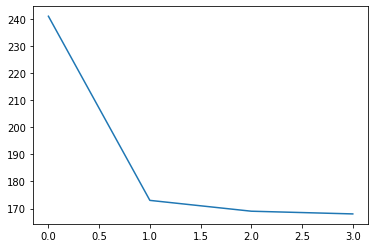

AVL01x_pct 4


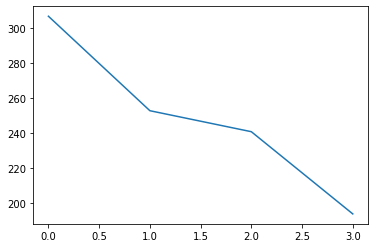

PVM02of_pct 4


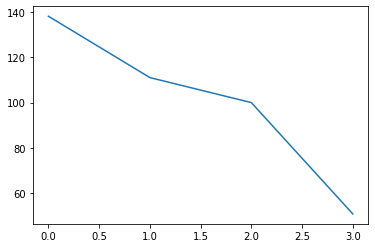

PVM01ov_pct 4


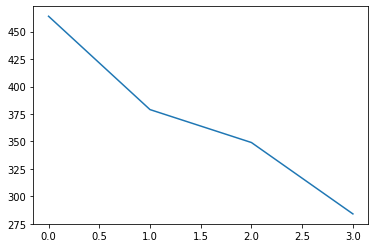

PVM03oe_pct 4


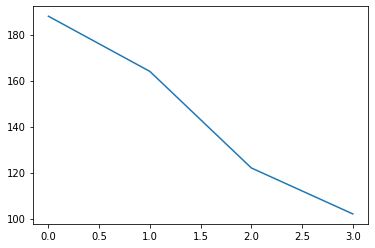

R6 4


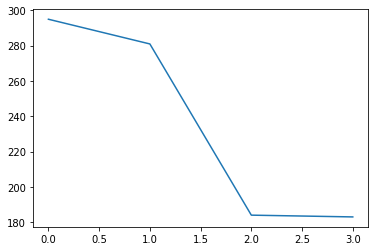

PDM14z_pct 4


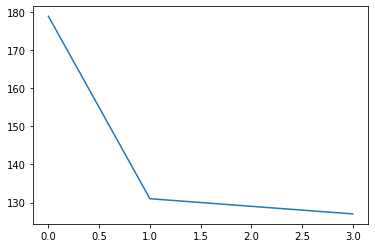

AVL09e_pct 4


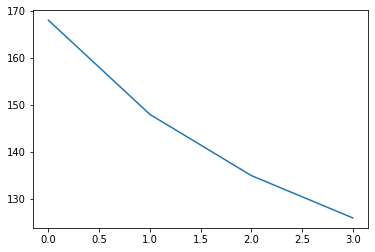

ADM06j_pct 4


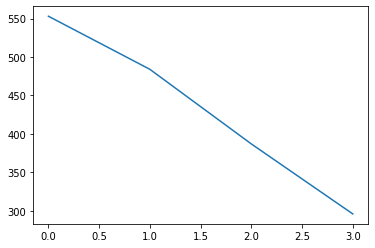

ADL12c_pct 4


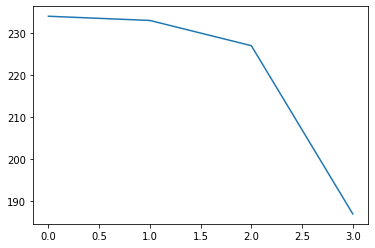

AVL14p_pct 4


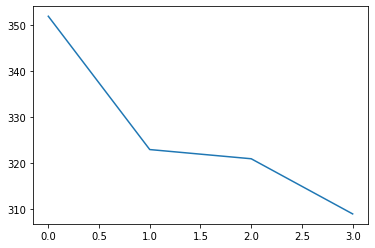

AVL04a_b_pct 4


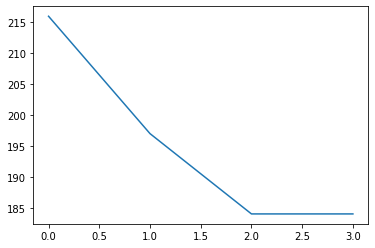

PDL09x_pct 4


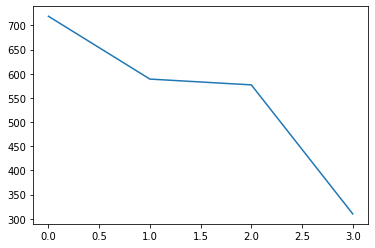

AVL14v_b_pct 4


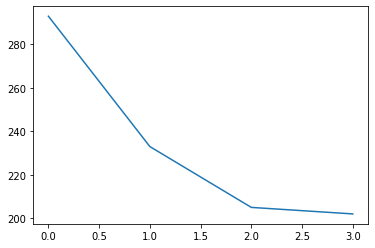

PDM14g_pct 4


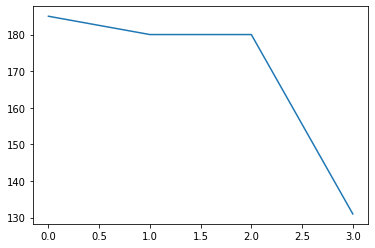

AVL04v_a_pct 4


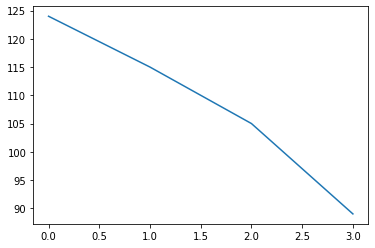

Li 4


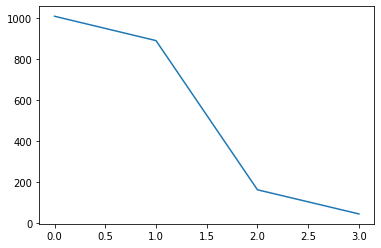

AVL04b_a_pct 4


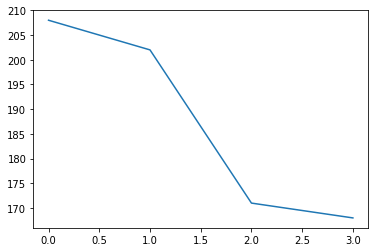

PDL09r_pct 4


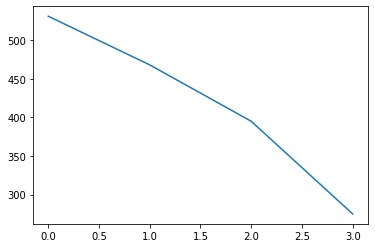

PVL07q_pct 4


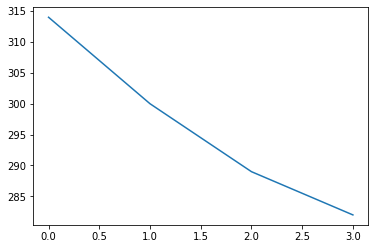

AVM14v_pct 4


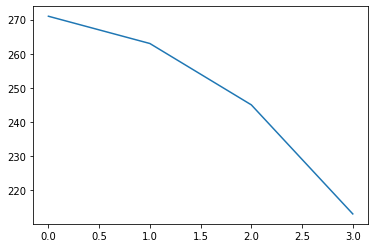

PVL09n_b_pct 4


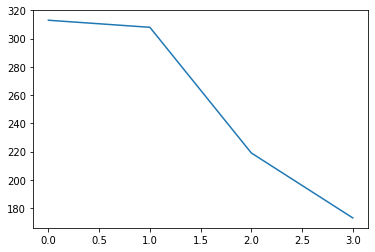

AVL02f_c_pct 4


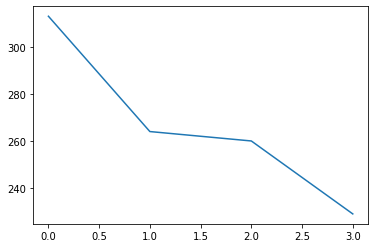

PVL03oe_pct 4


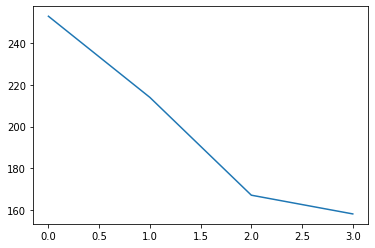

PDL09z_pct 4


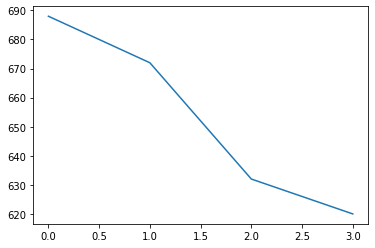

ADM03e_pct 4


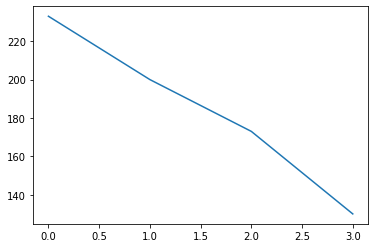

AVL04x_pct 4


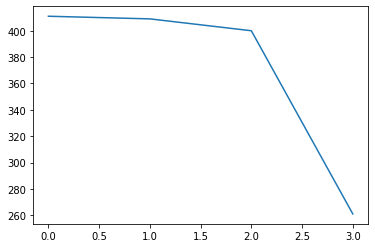

AVL07y_pct 4


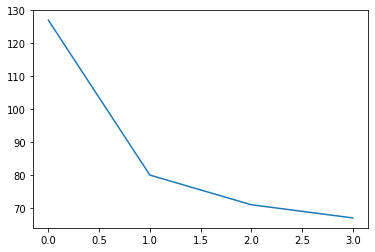

ADM06n_b_pct 4


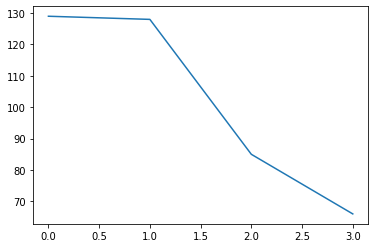

PVL14i_pct 4


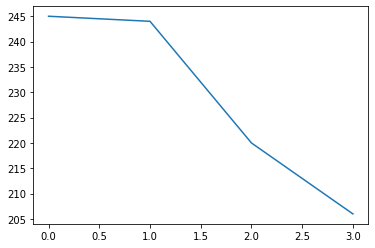

ADL14i_a_pct 4


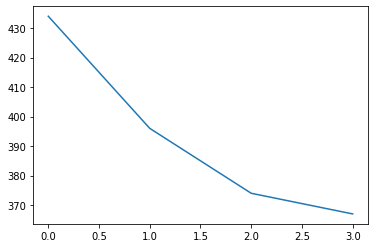

AVL18p_pct 4


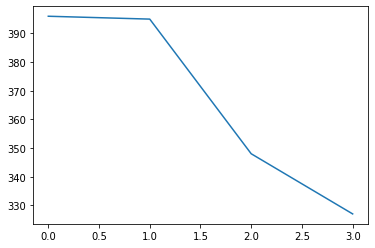

PVL03w_pct 4


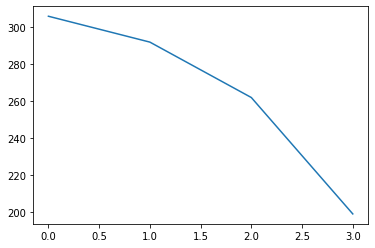

AVL01og_pct 4


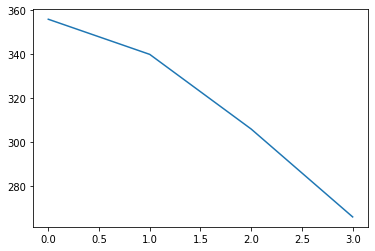

AVL01of_pct 4


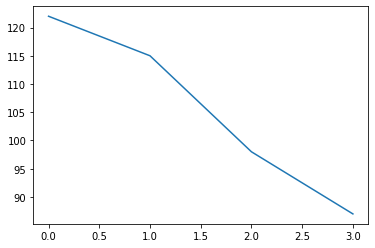

PVM07i_a_pct 4


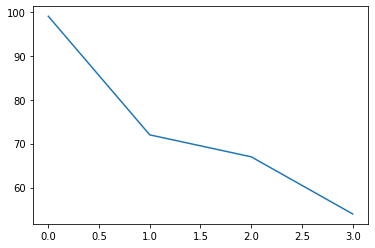

PVM04ob_pct 4


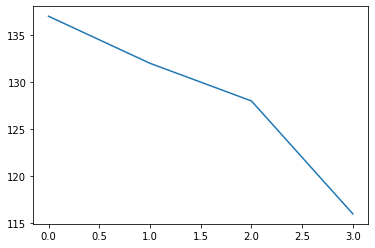

AVL15c_pct 4


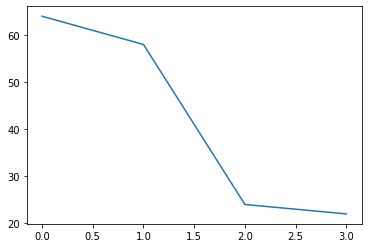

AVL05op_pct 4


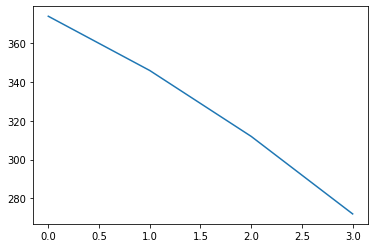

AVL09d_b_pct 4


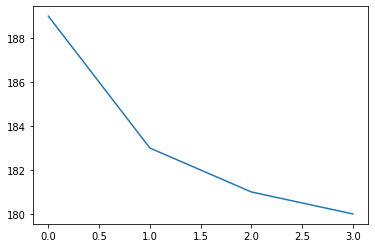

AVL09z_c_pct 4


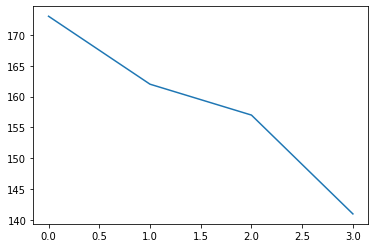

AVM12g_pct 4


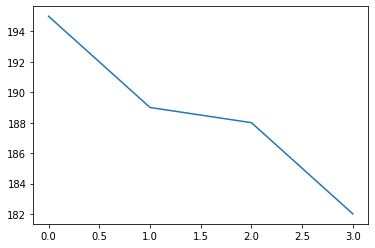

AVL15n_pct 4


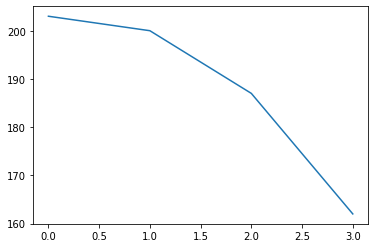

AVL05os_pct 4


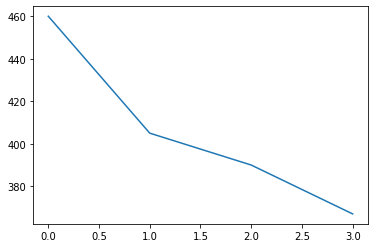

PDL12a_pct 4


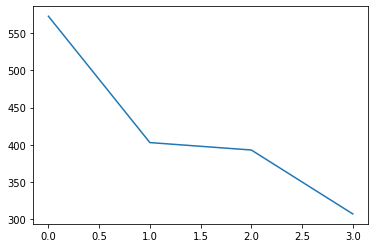

PVM04m_pct 4


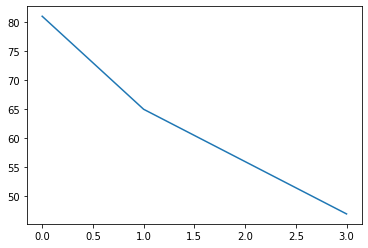

PVM04q_pct 4


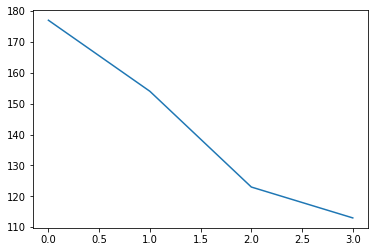

AVL22a_pct 4


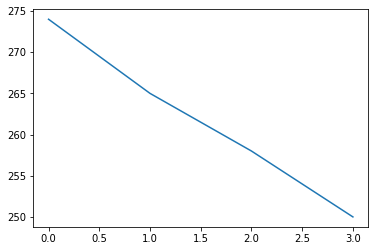

AVM09j_pct 4


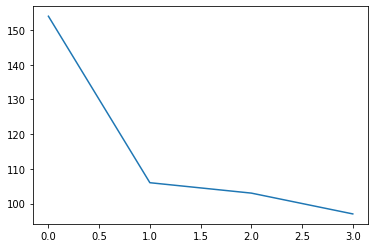

AVL17i_pct 4


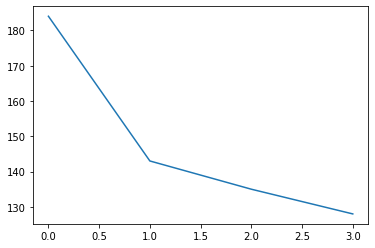

ADL01c_pct 4


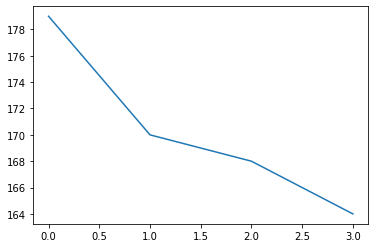

PVL07g_a_pct 4


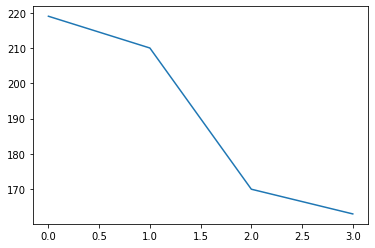

ADL01ou_pct 4


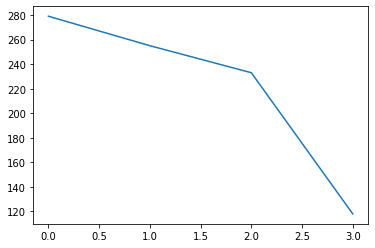

PVL05x_a_pct 4


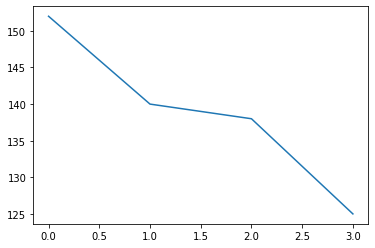

PVL03oc_pct 4


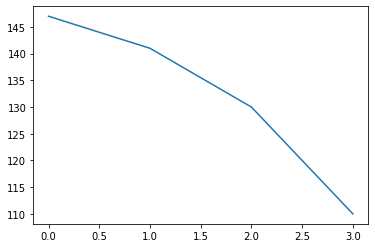

AVL17c_pct 4


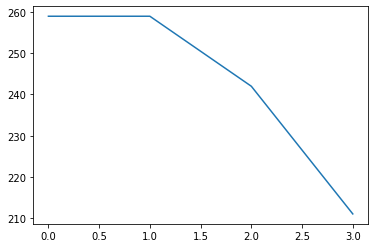

AVL02v_c_pct 4


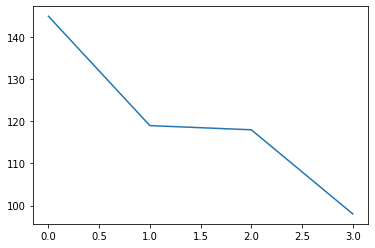

AVL16j_pct 4


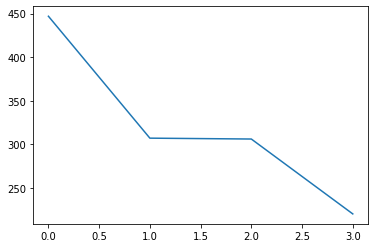

PVL07g_g_pct 4


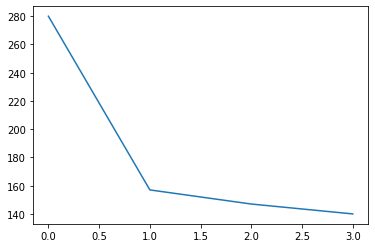

AVL17h_pct 4


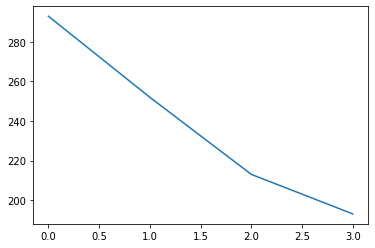

AVL14y_pct 4


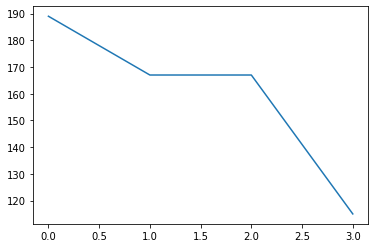

PVM07k_pct 4


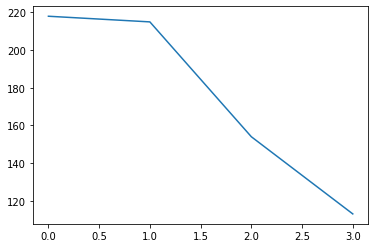

PVL02k_pct 4


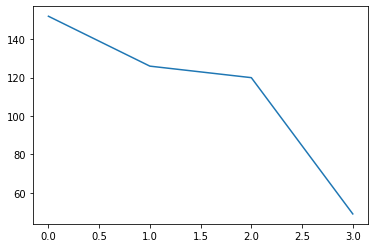

AVL11r_a_pct 4


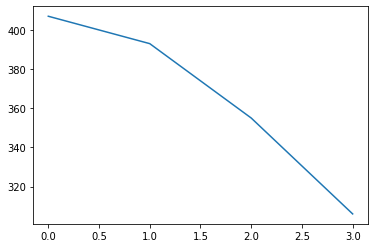

AVL09j_pct 4


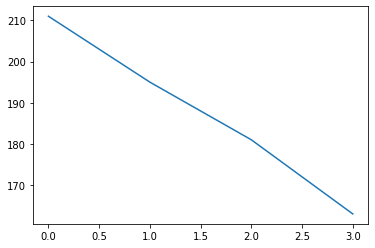

AVL19r_pct 4


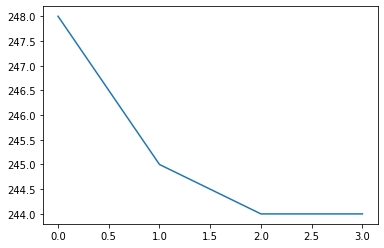

AVL07op_pct 4


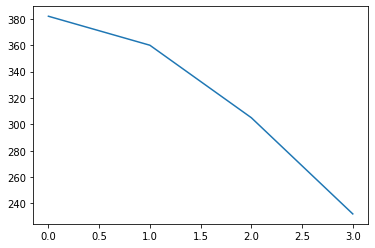

PDM19g_pct 4


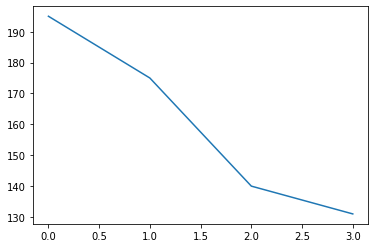

PVL05y_pct 4


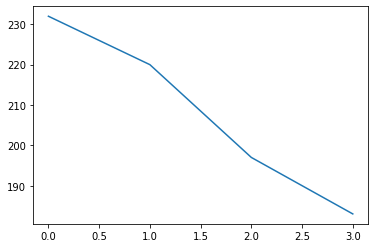

ADL06e_b_pct 4


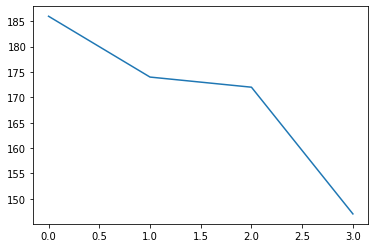

AVL13t_pct 4


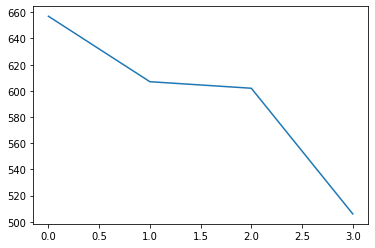

AVL05w_b_pct 4


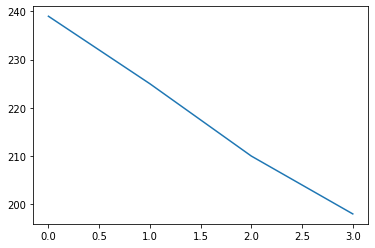

AVL07c_pct 4


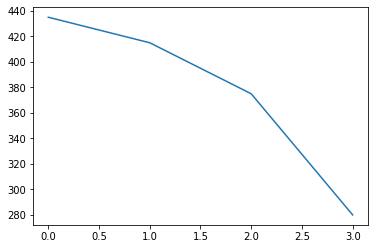

PVL03j_pct 4


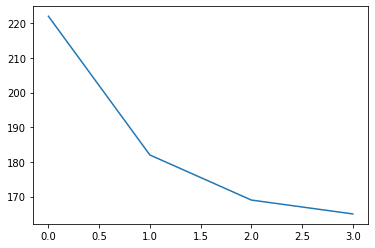

PVL08v_pct 4


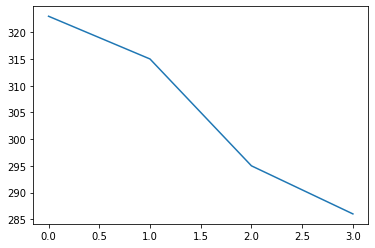

AVL11r_b_pct 4


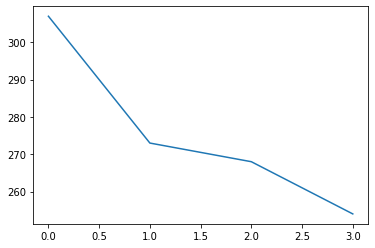

AVL18q_pct 4


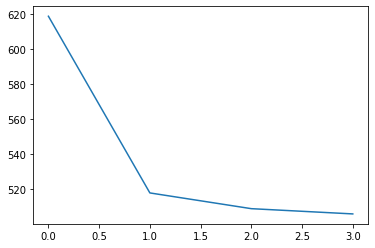

AVL05oz_pct 4


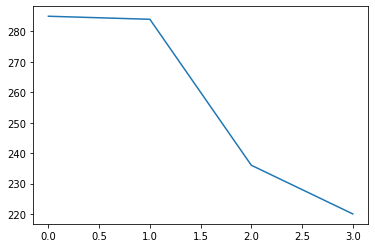

LT1 4


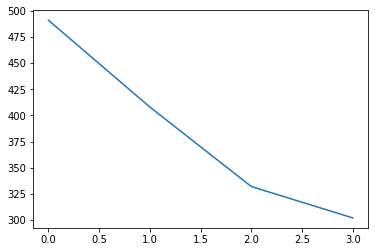

AVL07d_pct 4


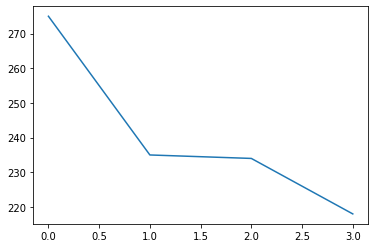

AVL05z_pct 4


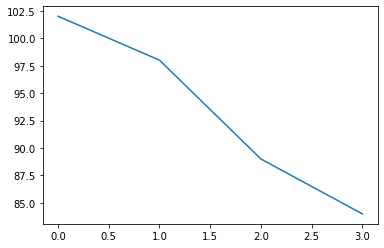

AVL13j_pct 4


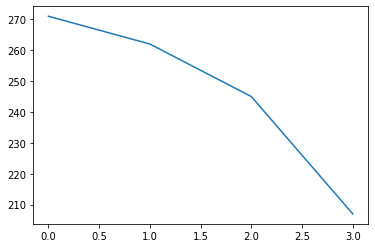

PVL09s_b_pct 4


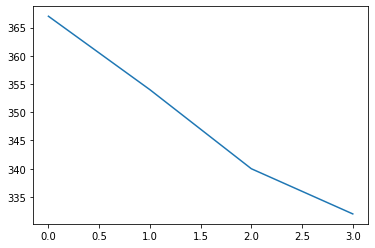

PDL09j_a_pct 4


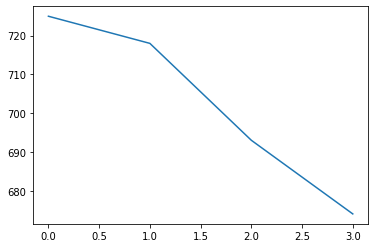

AVL05ox_pct 4


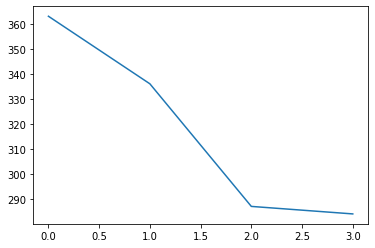

AVL05oo_pct 4


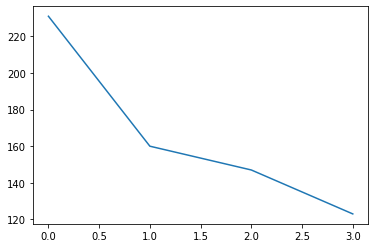

AVM11x_pct 4


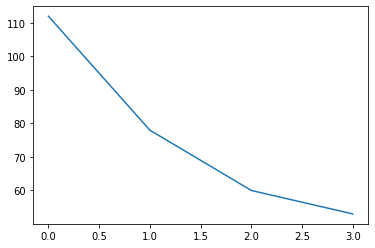

PVL02ob_pct 4


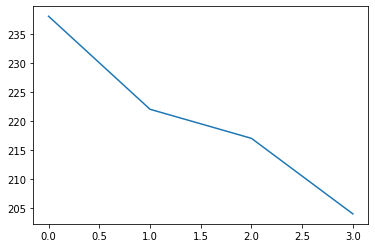

AVM09f_pct 4


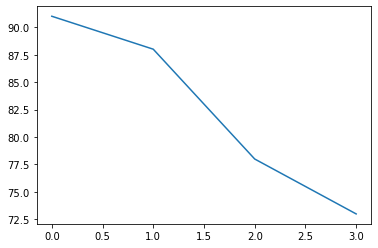

AVM12h_pct 4


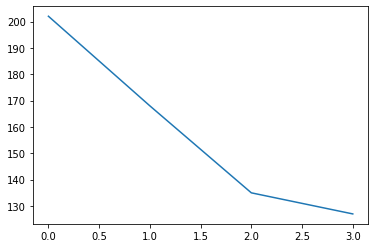

PVM04k_pct 4


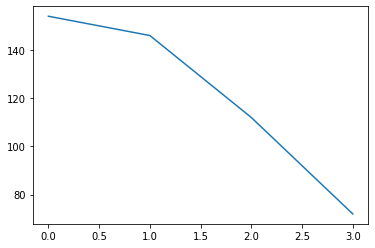

PVM02h_pct 4


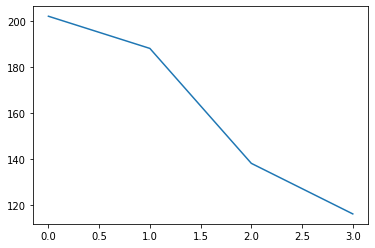

AVM12f_pct 4


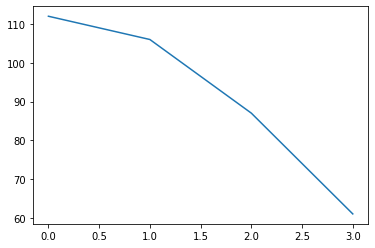

AVL16p_b_pct 4


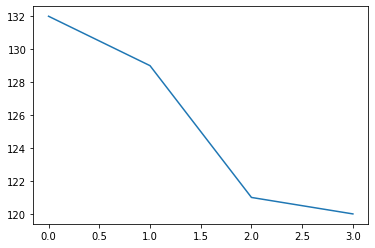

AVL17m_pct 4


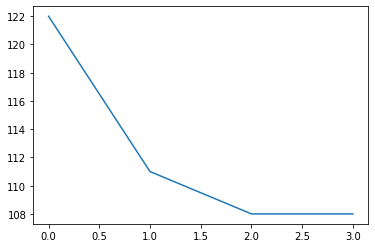

AVL01oa_pct 4


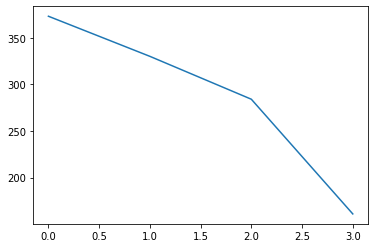

PVM02oa_pct 4


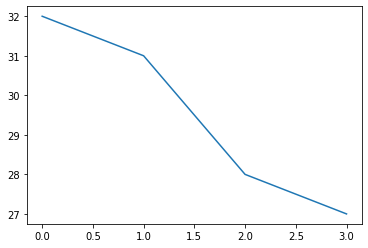

PVM02oi_pct 4


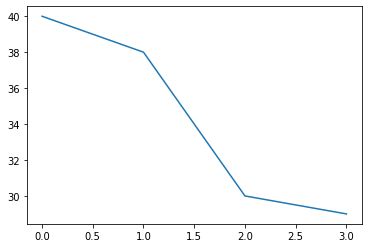

AVM12m_pct 4


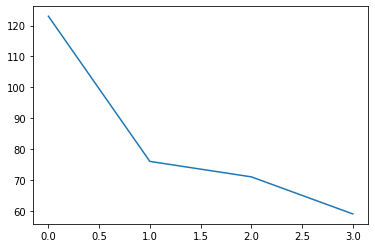

AVM09d_pct 4


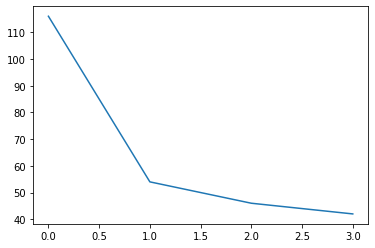

AVM09k_pct 4


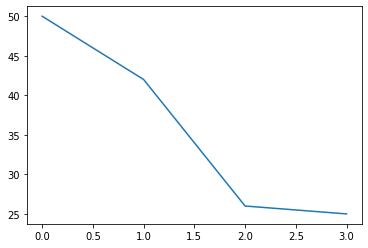

AVL16r_pct 4


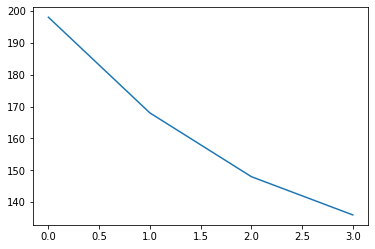

P6-8P9 4


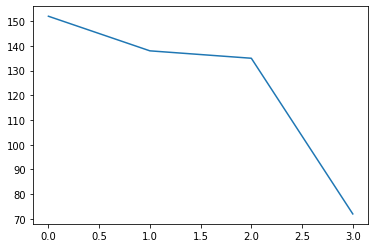

SpsP 4


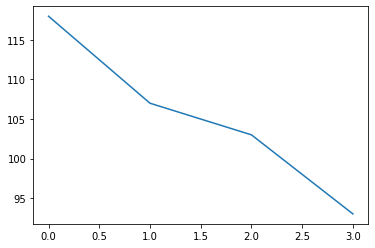

ADL10d_a_pct 3


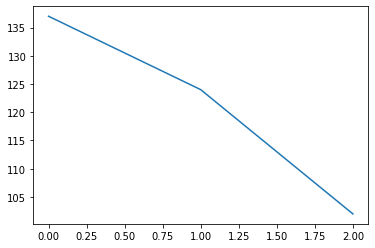

PDL17s_b_pct 3


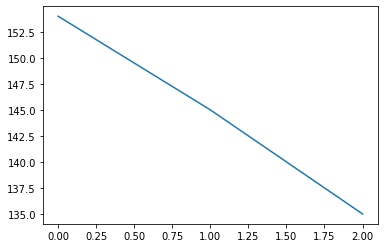

ADL07oi_pct 3


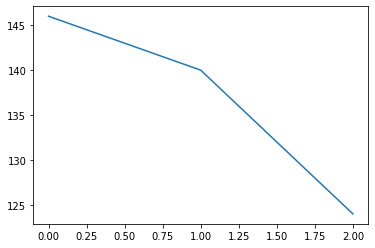

ADL04og_pct 3


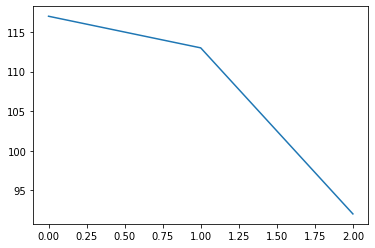

ADL10g_a_pct 3


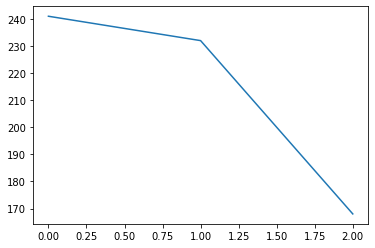

PDL06c_pct 3


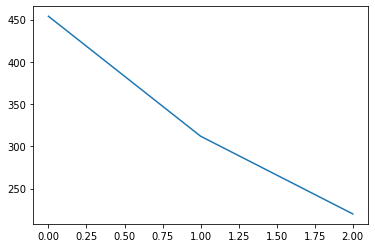

PDL17x_pct 3


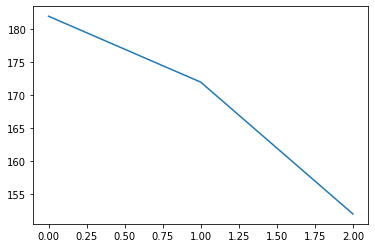

PDM05j_e_pct 3


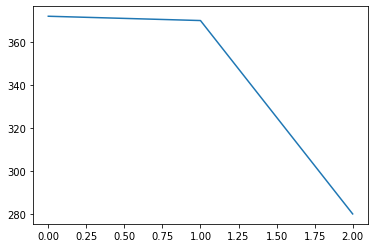

PDM18h_pct 3


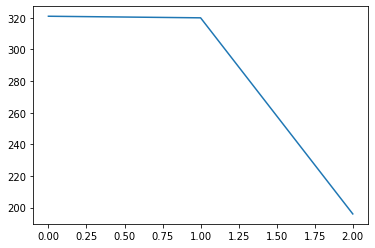

PDL10x_pct 3


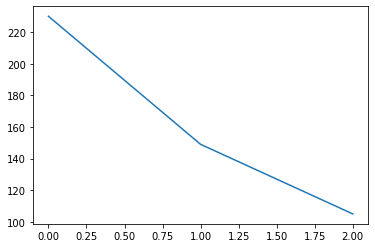

FB7E 3


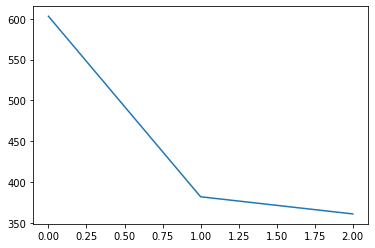

PDM10v_c_pct 3


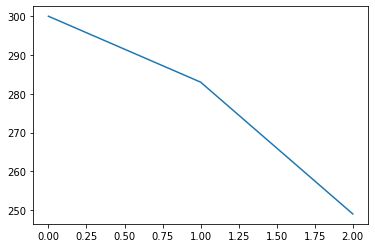

ADL09v_pct 3


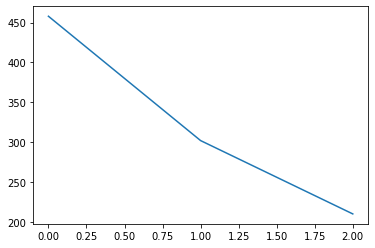

PDM08q_d_pct 3


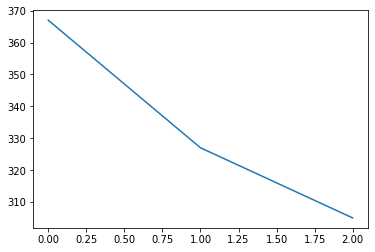

ADL20h_a_pct 3


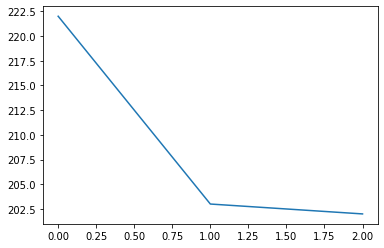

ADM07a_b_pct 3


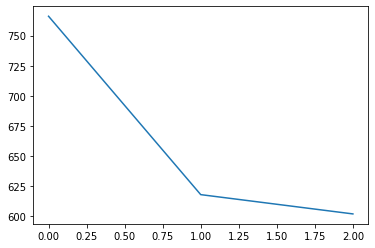

PDM07r_pct 3


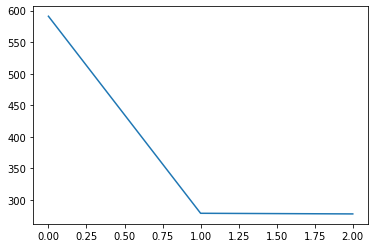

PVL04y_pct 3


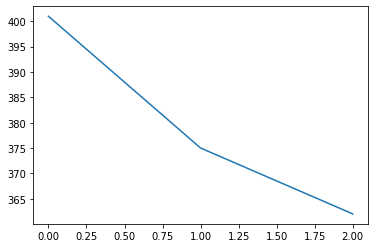

ADL20h_c_pct 3


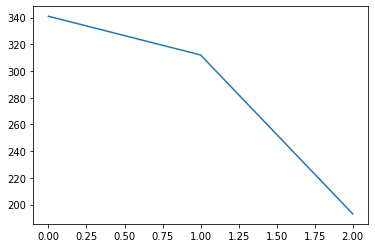

ADL11c_c_pct 3


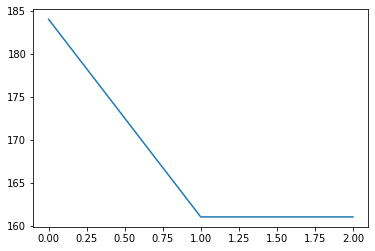

ADL20k_pct 3


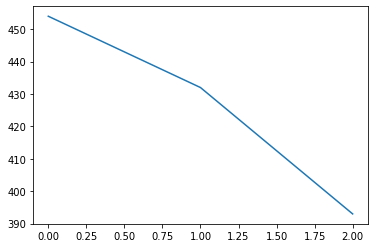

ADL10e_pct 3


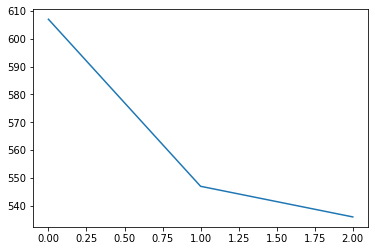

PDM20e_b_pct 3


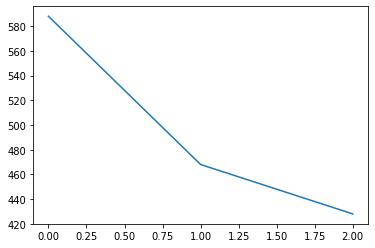

AVM13r_pct 3


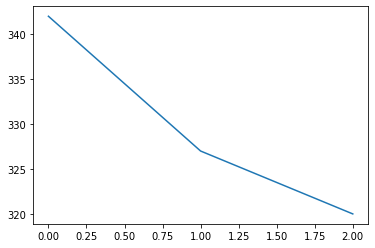

PDL10j_a_pct 3


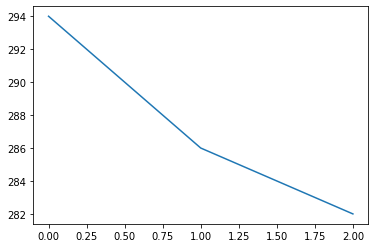

PDL11u_b_pct 3


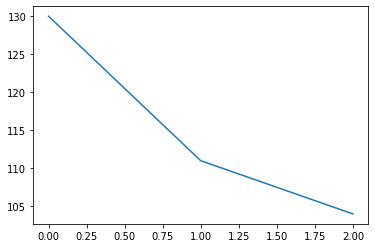

PDL13q_a_pct 3


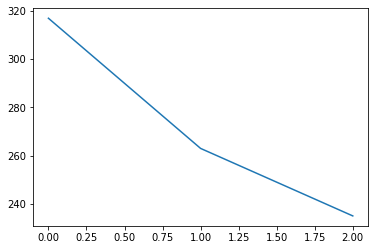

PDL25g_pct 3


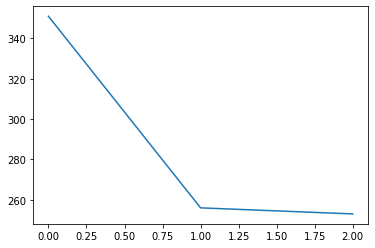

PDM06e_pct 3


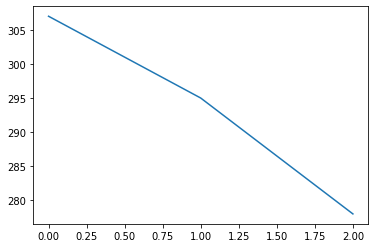

PDL16x_pct 3


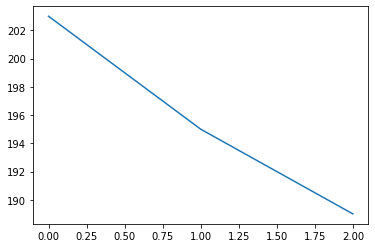

ADL20d_pct 3


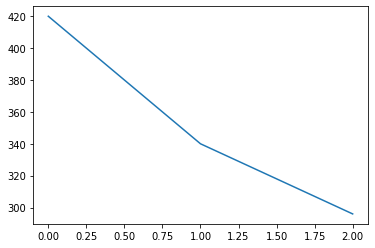

PDL10g_i_pct 3


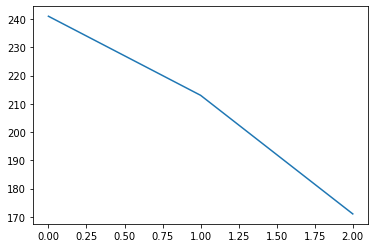

ADL03j_pct 3


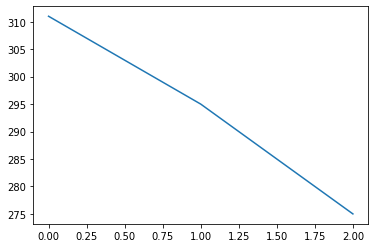

PDM20t_pct 3


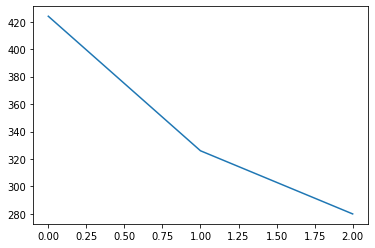

PVL04oa_pct 3


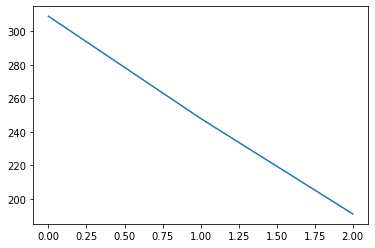

ADL20j_a_pct 3


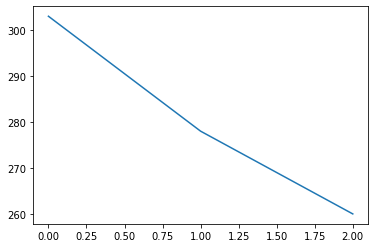

ADL20f_pct 3


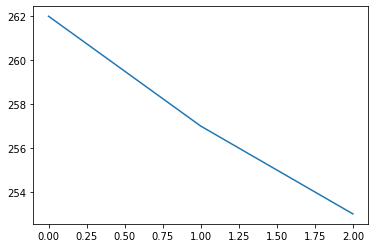

ADL05b_pct 3


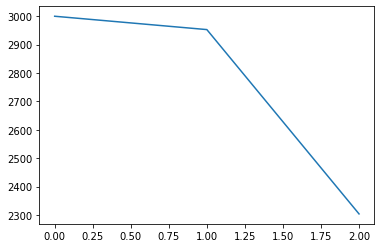

PDL22h_pct 3


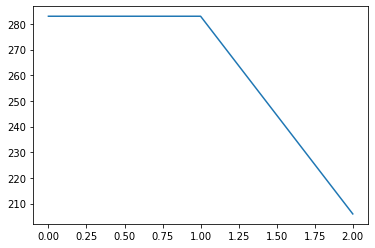

PDM20g_c_pct 3


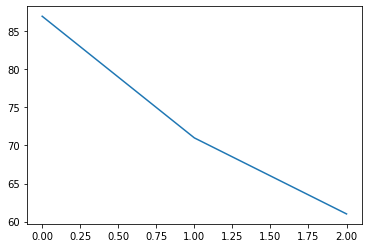

PDM09v_a_pct 3


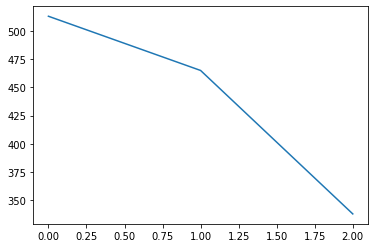

ADL04p_b_pct 3


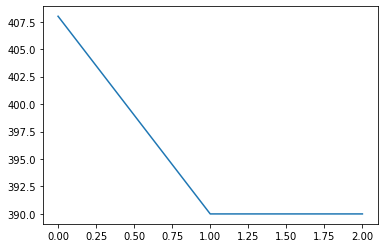

ADL02i_c_pct 3


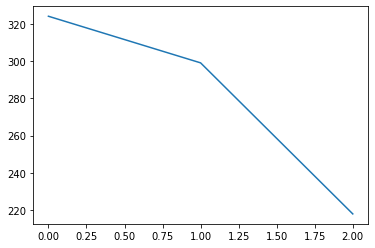

ADL09b_b_pct 3


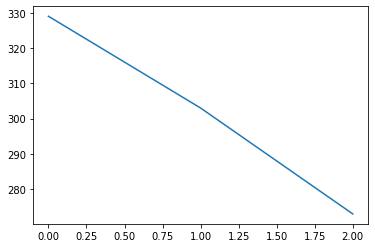

PDL11n_pct 3


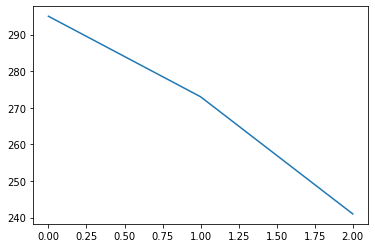

PDL13h_pct 3


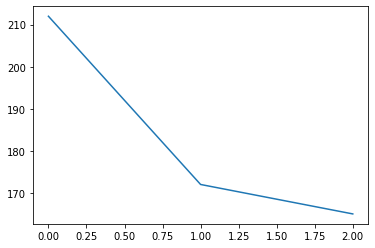

PDL10ob_pct 3


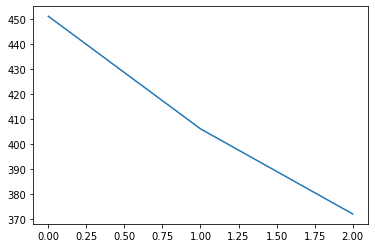

ADL03om_pct 3


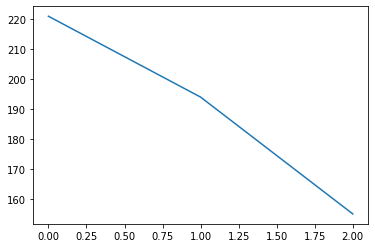

ADL02j_g_pct 3


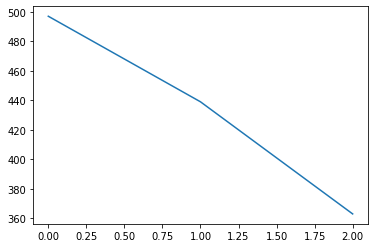

ADL23i_pct 3


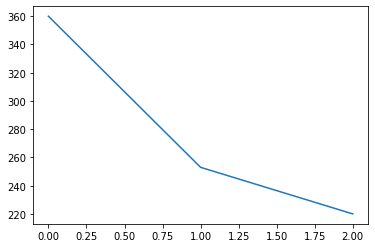

AVL12y_pct 3


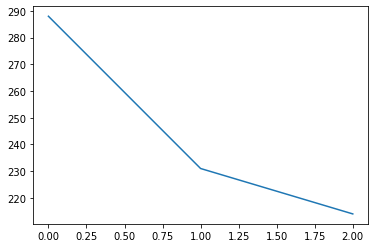

ADL10b_pct 3


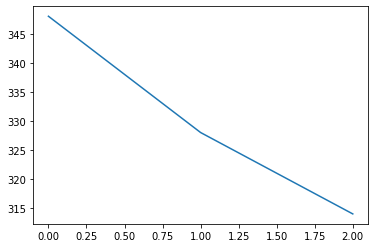

PDL13g_c_pct 3


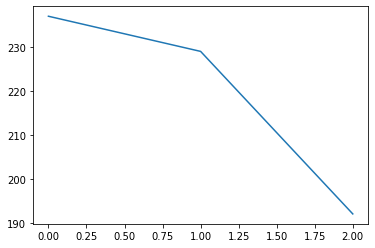

PDL08oa_pct 3


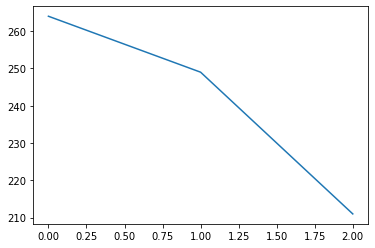

PDL16g_pct 3


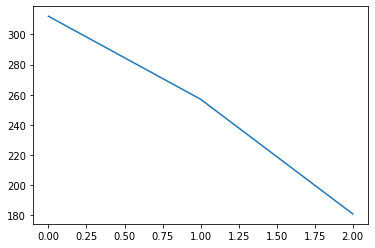

PDL10j_b_pct 3


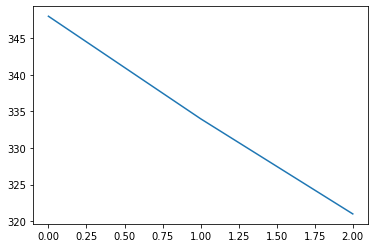

PVL14h_d_pct 3


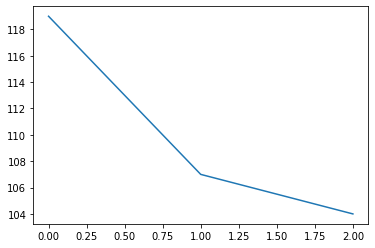

PDL10oa_pct 3


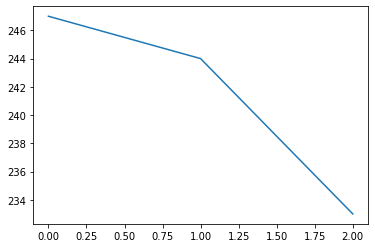

PDL11s_pct 3


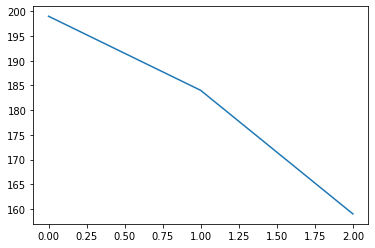

ADL13f_pct 3


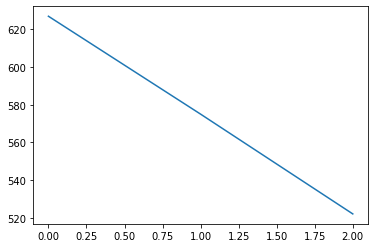

PDL17c_b_pct 3


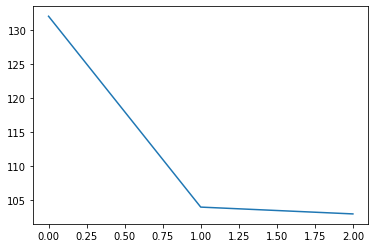

PDL13n_pct 3


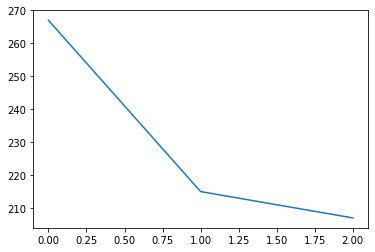

AVM13b_pct 3


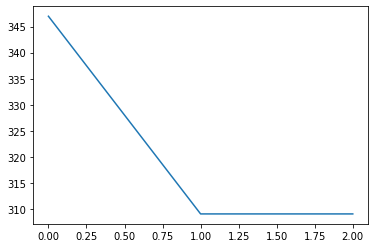

PDL05od_pct 3


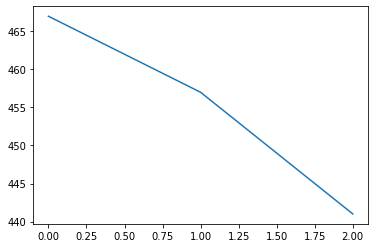

ADL02i_a_pct 3


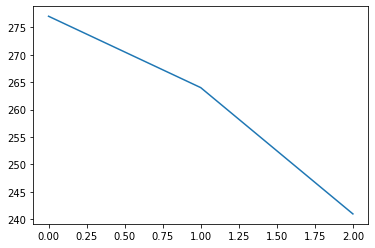

PDM20e_c_pct 3


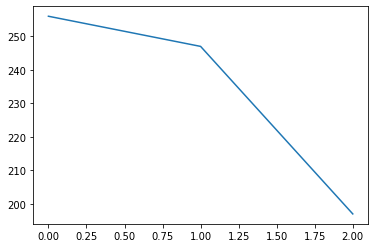

ADM04v_c_pct 3


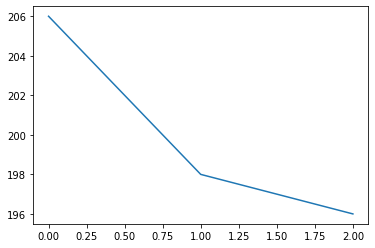

ADL15j_pct 3


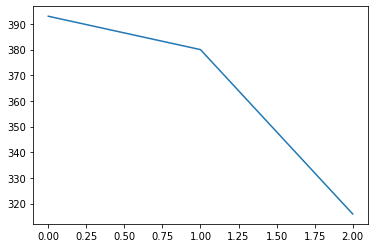

PDL10g_h_pct 3


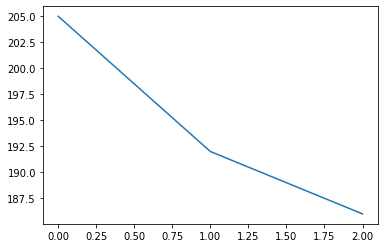

PDL14m_b_pct 3


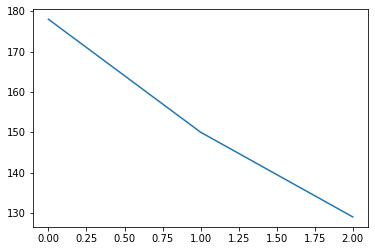

PDL10g_f_pct 3


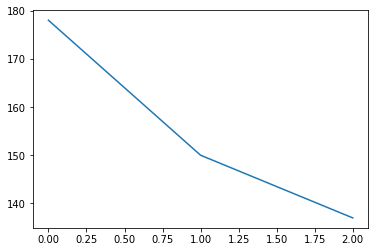

PDL10g_a_pct 3


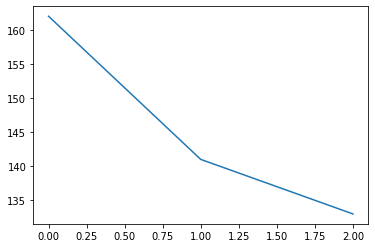

ADL07ob_pct 3


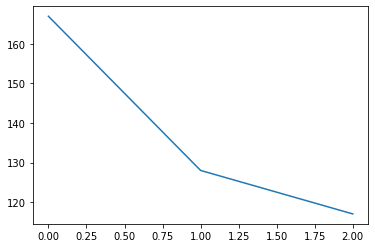

PDL13s_pct 3


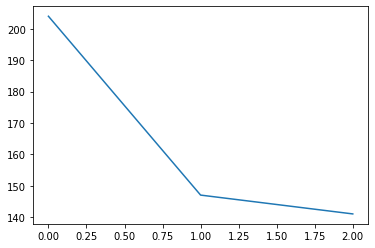

ADL23b_pct 3


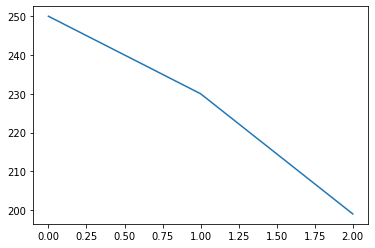

PDM05j_b_pct 3


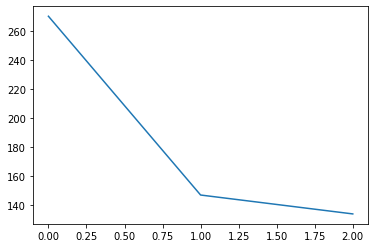

ADL07i_pct 3


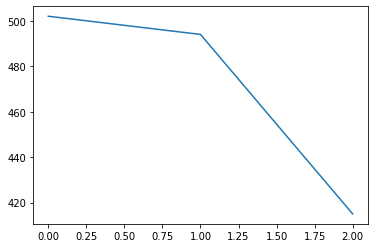

PVM12g_pct 3


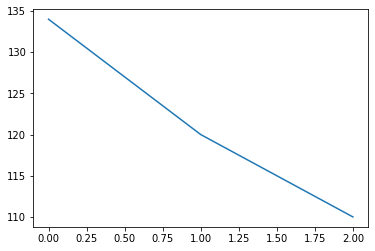

PDM15g_a_pct 3


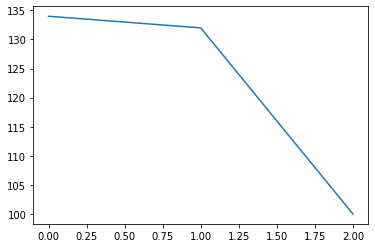

PDM11j_b_pct 3


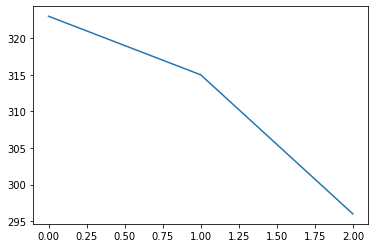

ADL21d_a_pct 3


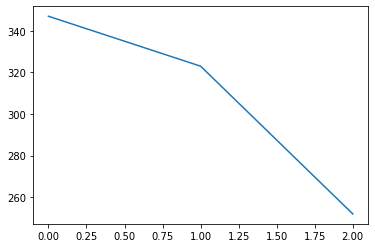

PDM21j_pct 3


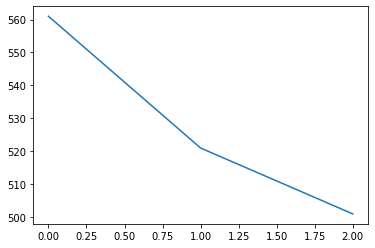

LPN 3


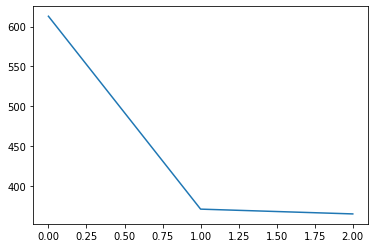

PDM05h_b_pct 3


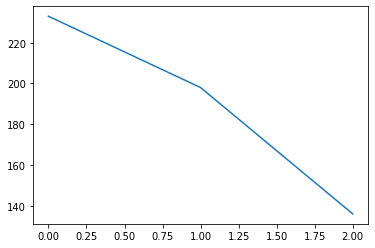

AVL08oh_pct 3


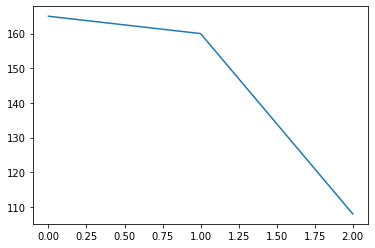

PDM06r_a_pct 3


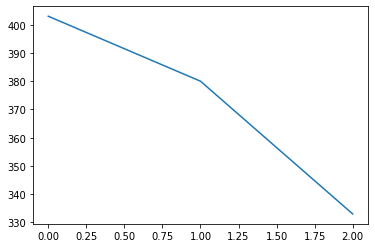

PDL07q_pct 3


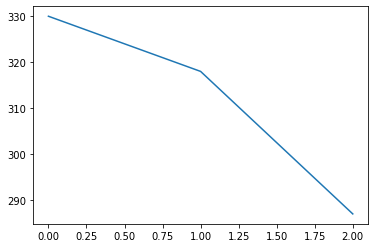

PDM11b_a_pct 3


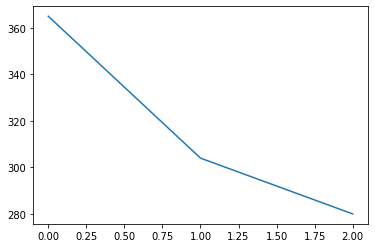

PDM11j_a_pct 3


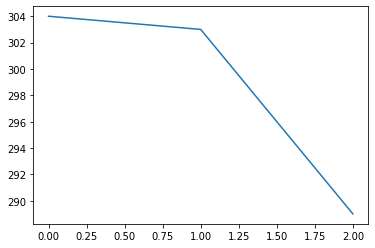

PDL06t_pct 3


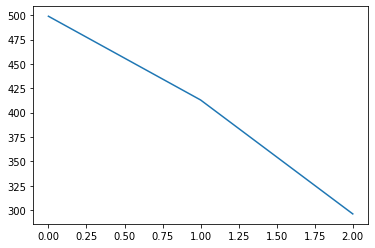

PDM10p_pct 3


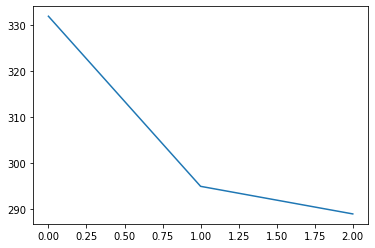

AVL03n_pct 3


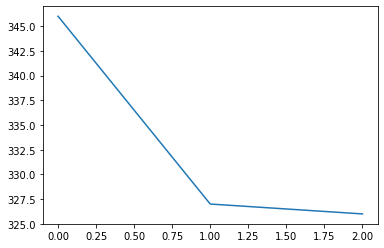

PDM22r_pct 3


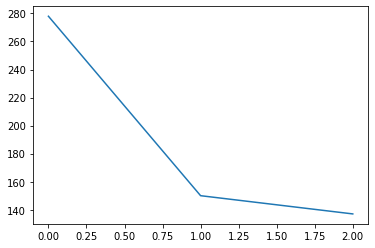

ADM05y_pct 3


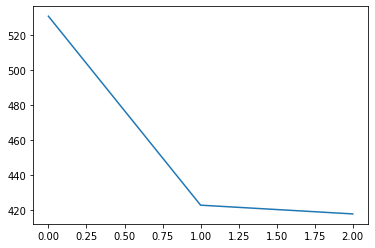

PDL14j_b_pct 3


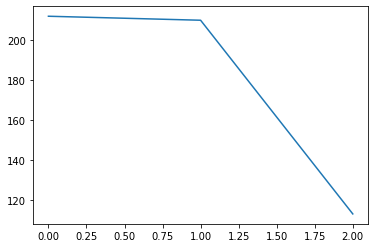

PDL21j_pct 3


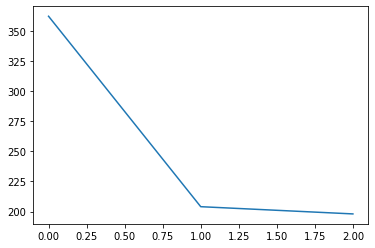

PDM15g_f_pct 3


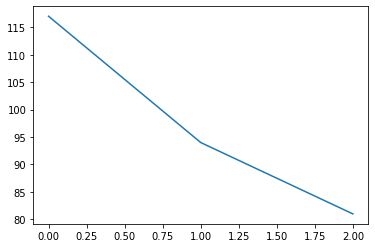

ADL14j_pct 3


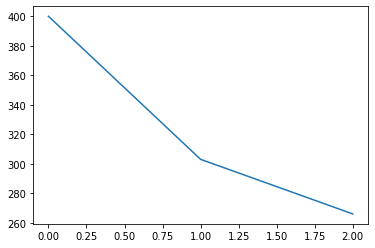

AVL06v_g_pct 3


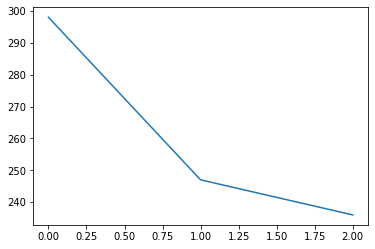

aMe9 3


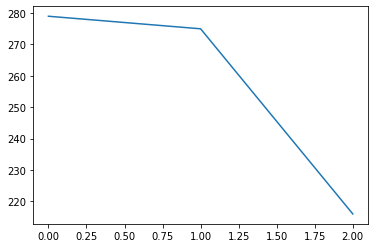

ADL09m_pct 3


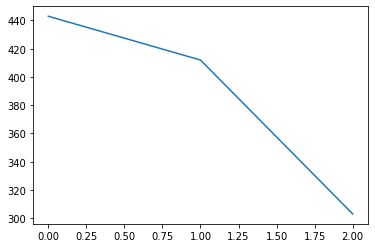

AVL11k_pct 3


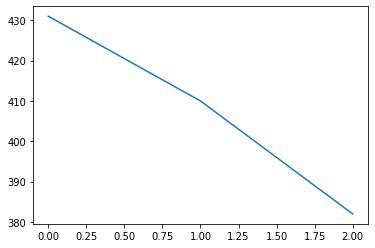

AVL03h_pct 3


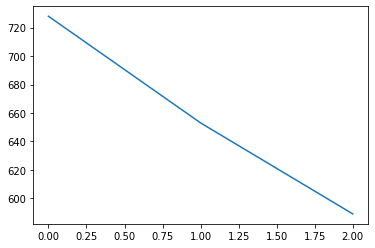

PDM10f_pct 3


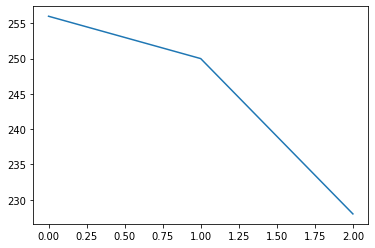

PDM10w_pct 3


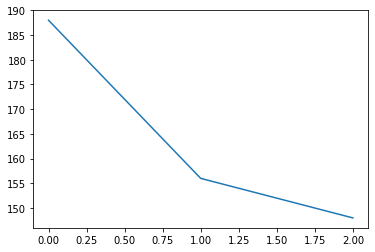

PDM06f_pct 3


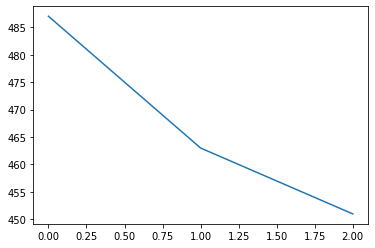

PDM20b_pct 3


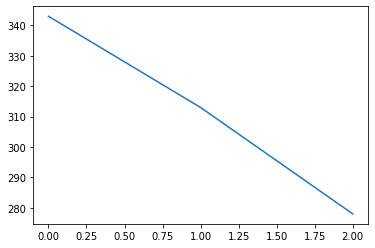

PVM08d_b_pct 3


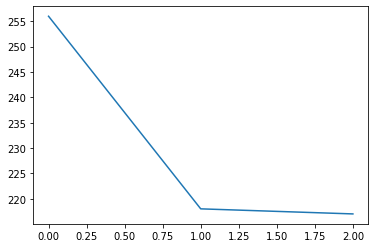

PDL06j_pct 3


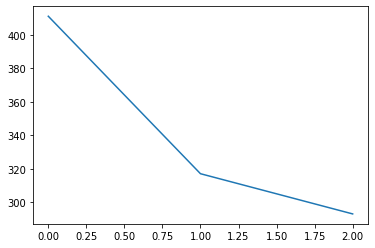

PVL06d_pct 3


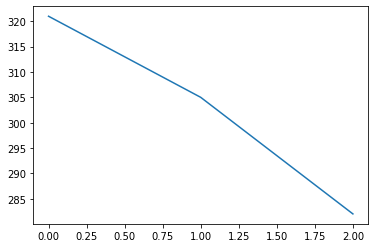

AVL03lg_pct 3


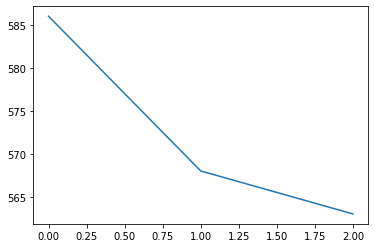

AVL06h_pct 3


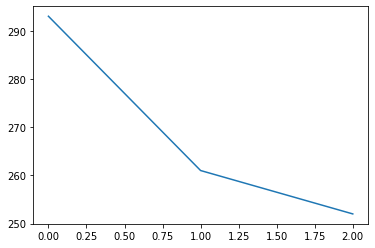

PDL14i_pct 3


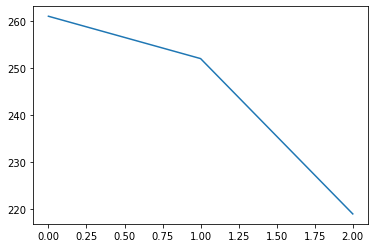

PDM15b_pct 3


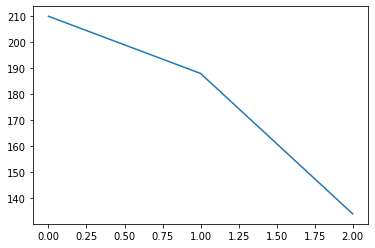

PDM20f_pct 3


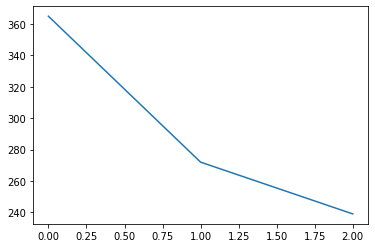

AVL12c_pct 3


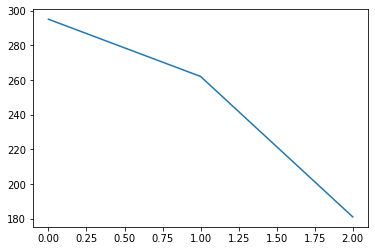

PDL22c_pct 3


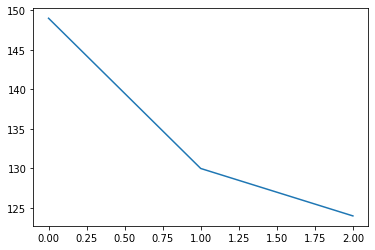

AVL03w_b_pct 3


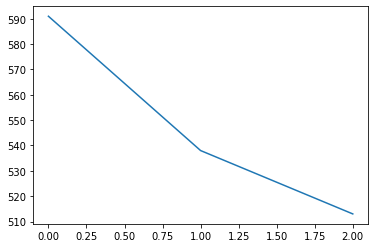

PDM22q_pct 3


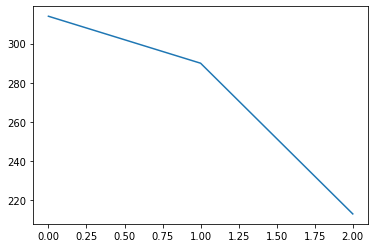

AVL03m_a_pct 3


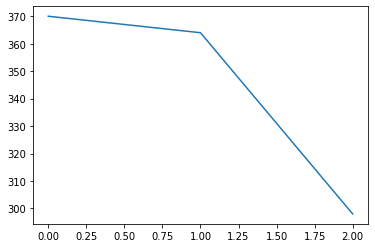

PDM15g_g_pct 3


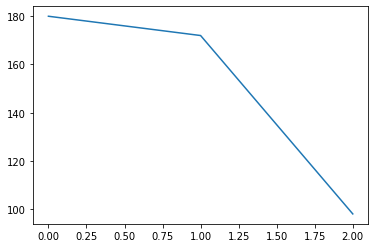

ADL16k_pct 3


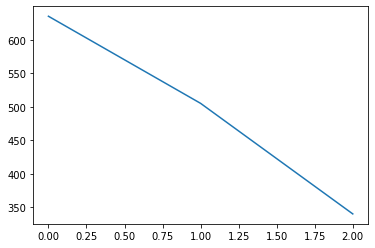

AVL03w_a_pct 3


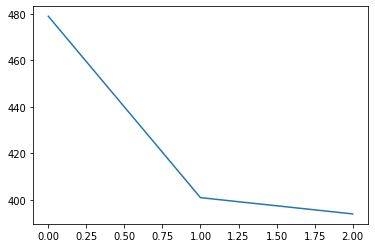

PDL17b_b_pct 3


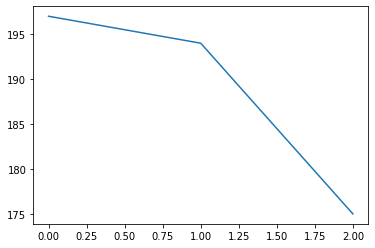

ADM05m_pct 3


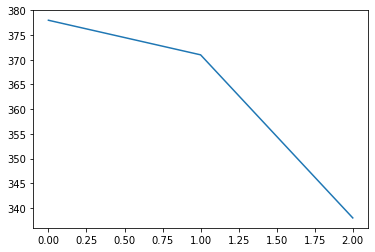

ADL15g_f_pct 3


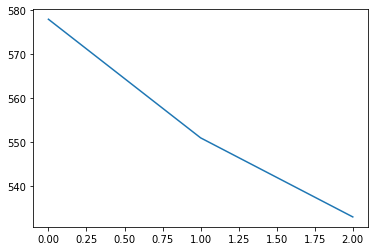

PDM10g_b_pct 3


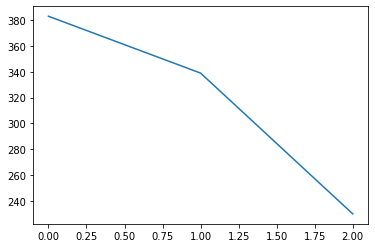

ADL02s_pct 3


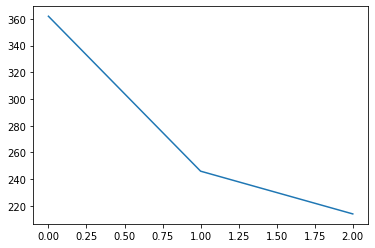

FB6B 3


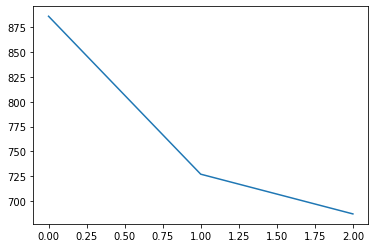

PDM11d_pct 3


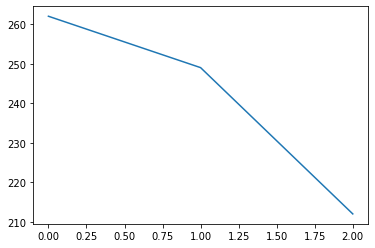

PDM11g_pct 3


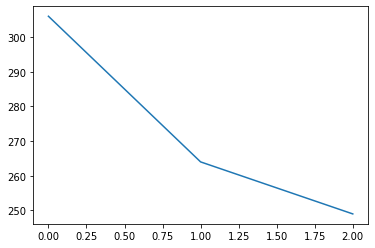

ADL01d_pct 3


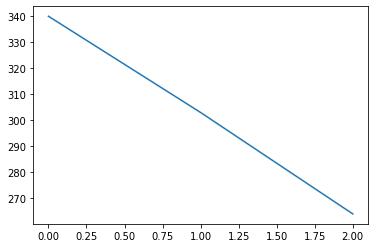

PDL13e_pct 3


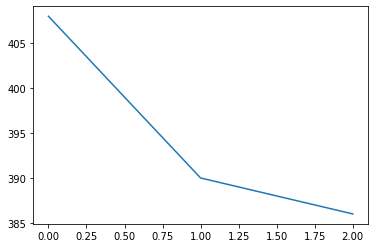

ADL12k_b_pct 3


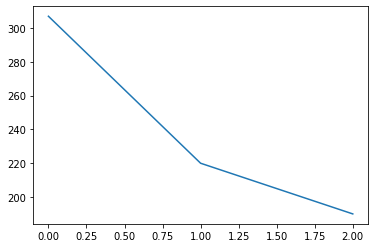

PDM19n_pct 3


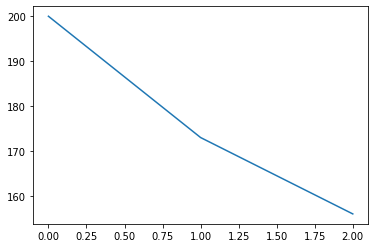

PDL21n_b_pct 3


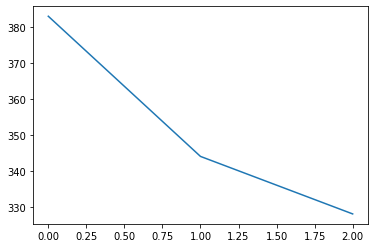

AVL12t_pct 3


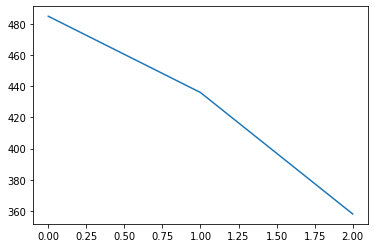

PDM27n_pct 3


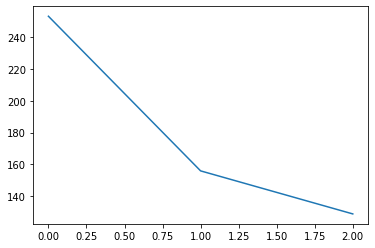

AVL12h_pct 3


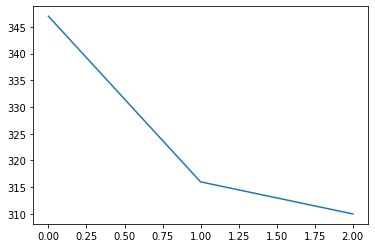

PDM22t_pct 3


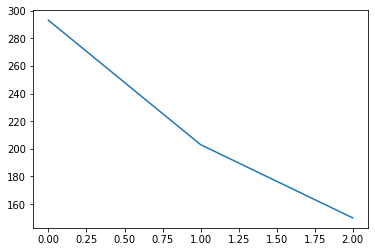

PVM01v_pct 3


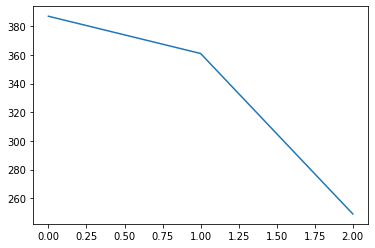

PDM23f_pct 3


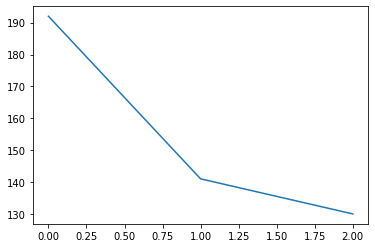

AVL06v_a_pct 3


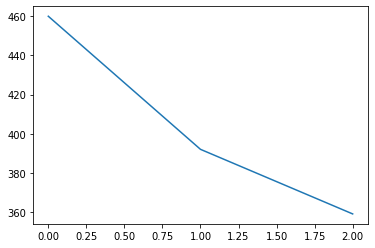

PDL06s_pct 3


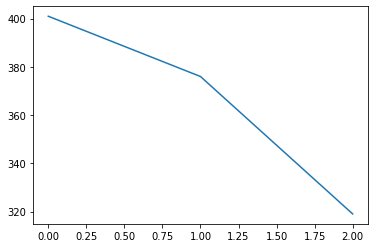

PDM16f_a_pct 3


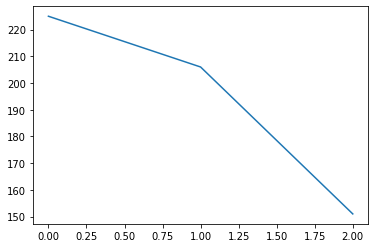

PDM10m_a_pct 3


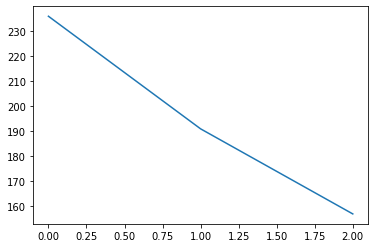

AVL12b_pct 3


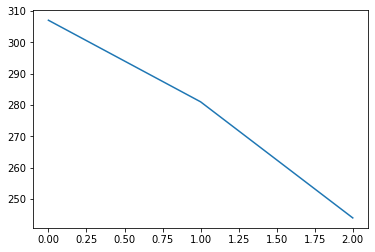

PVM08g_b_pct 3


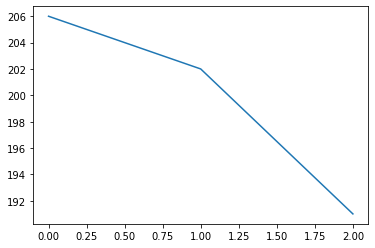

PVM03p_pct 3


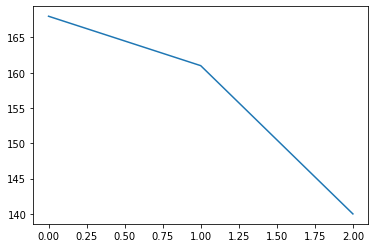

AVL02u_a_pct 3


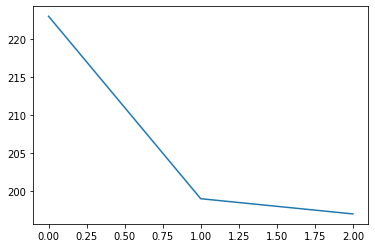

PVL04u_pct 3


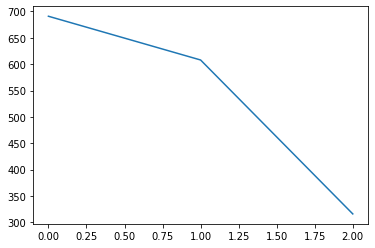

ADL05d_pct 3


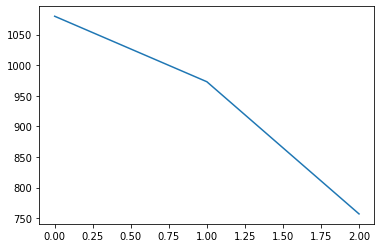

PVL13p_b_pct 3


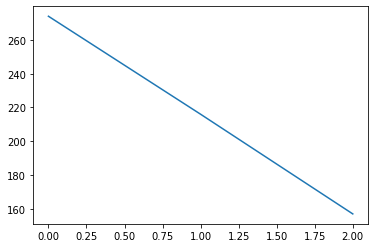

PDM15n_pct 3


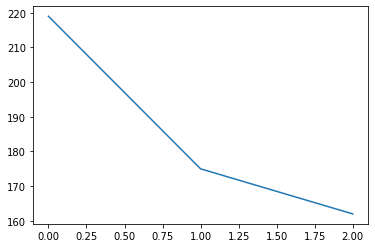

AVL20c_pct 3


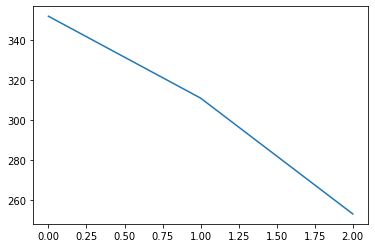

AVL06oh_pct 3


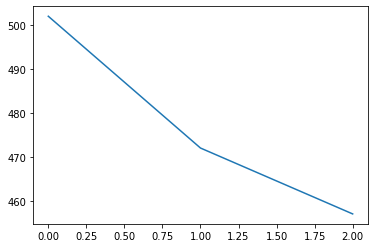

AVL12u_pct 3


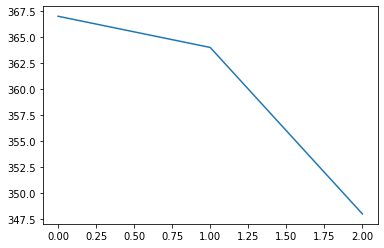

AVL06g_pct 3


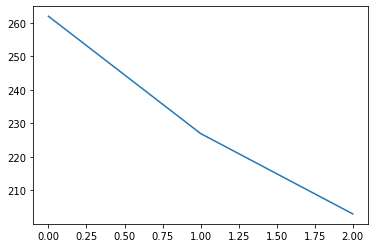

PDM06g_c_pct 3


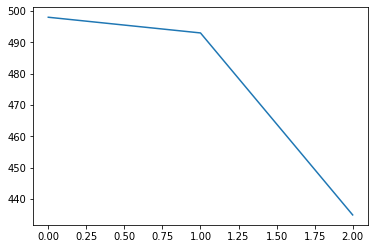

PVL13c_a_pct 3


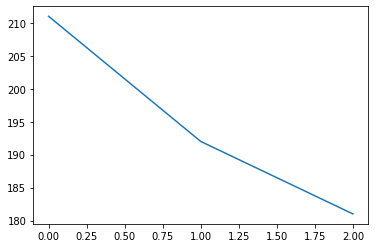

PDM11ol_pct 3


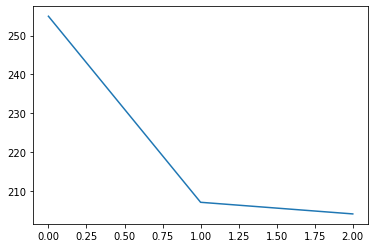

PDL07of_pct 3


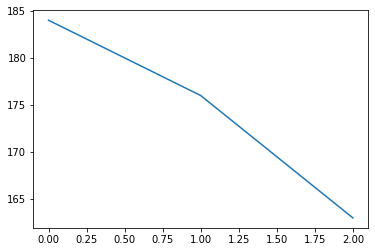

PDL12k_pct 3


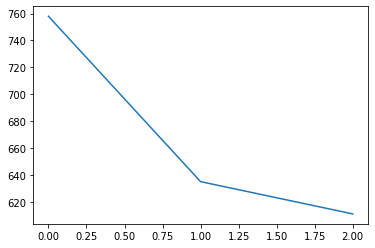

ADL12oa_pct 3


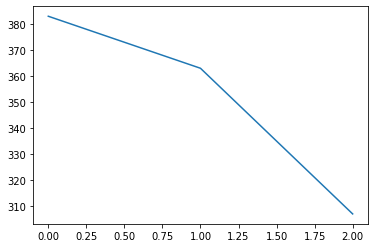

PDM09oj_pct 3


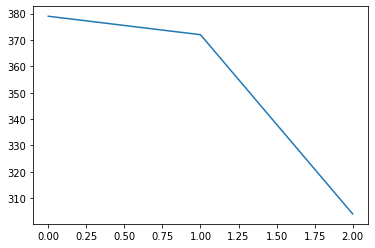

PDL16v_pct 3


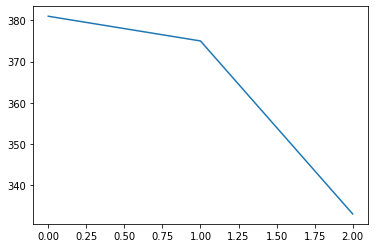

ADM05t_pct 3


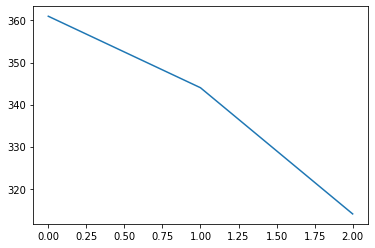

PDM22j_pct 3


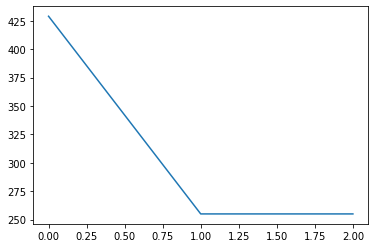

PDM07of_pct 3


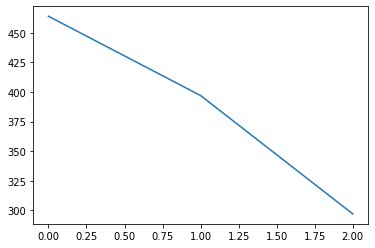

ADL12m_pct 3


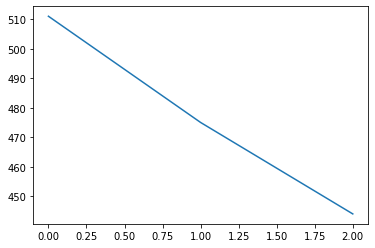

PDM10oj_pct 3


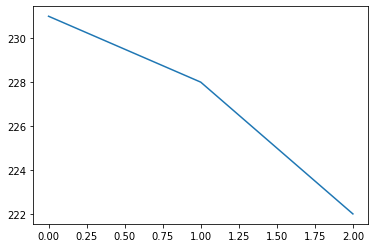

PVL13e_pct 3


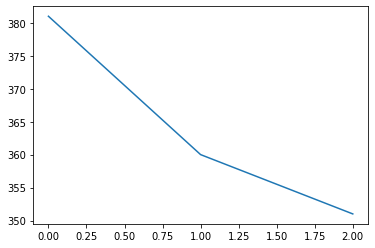

AVL08u_pct 3


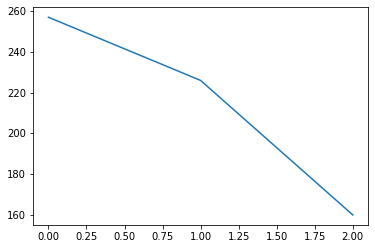

ADL02of_pct 3


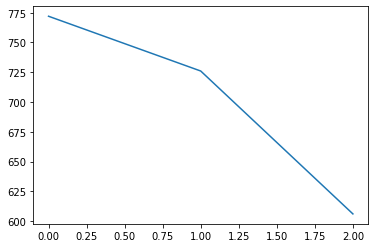

PVL11w_pct 3


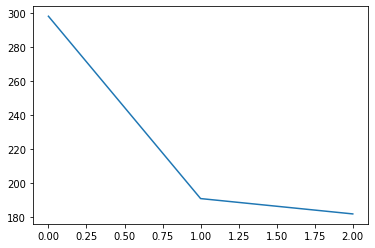

ADM01od_pct 3


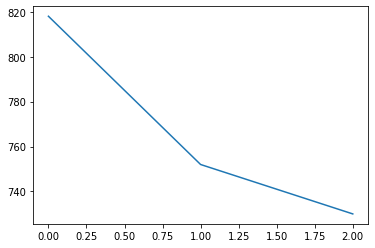

AVL03c_a_pct 3


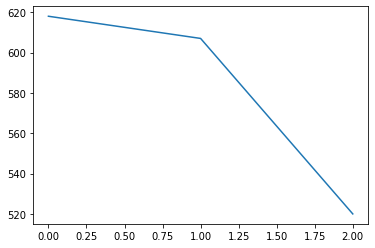

ADL15f_b_pct 3


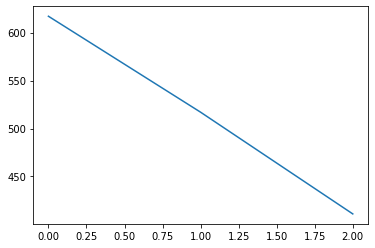

PDL17q_pct 3


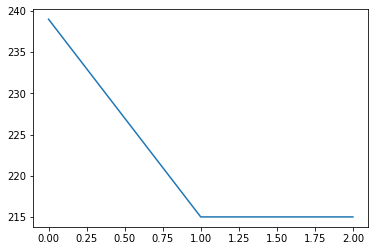

ADL12g_pct 3


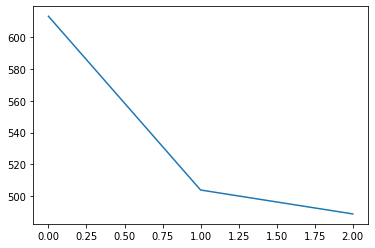

ADM01i_c_pct 3


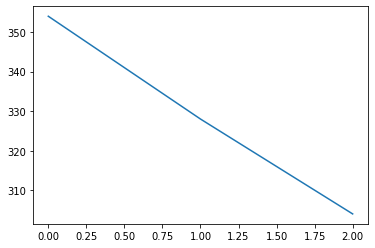

PVL16g_pct 3


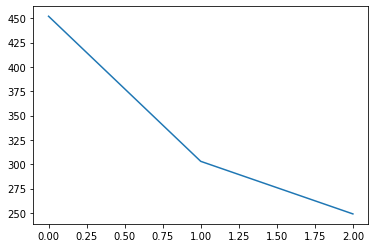

AVL03z_b_pct 3


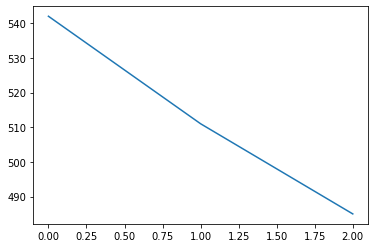

PDM12d_a_pct 3


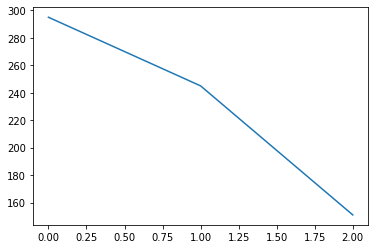

AVL02p_pct 3


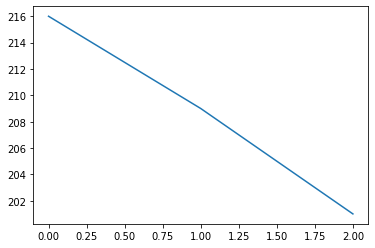

ADL07h_pct 3


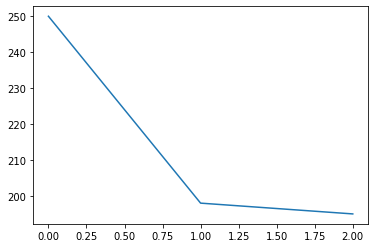

PDM06j_a_pct 3


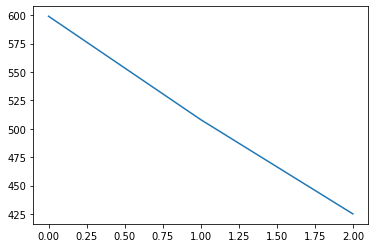

PVL06q_pct 3


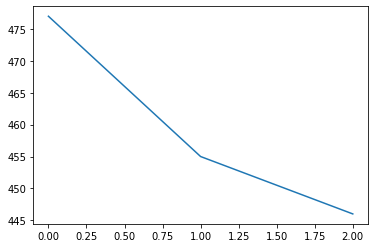

ADL18d_a_pct 3


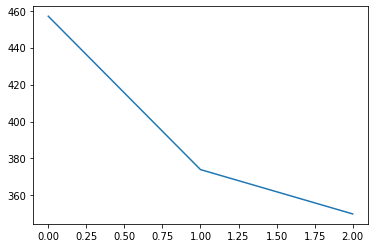

PDM15c_pct 3


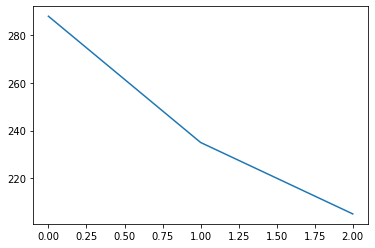

PDM06n_pct 3


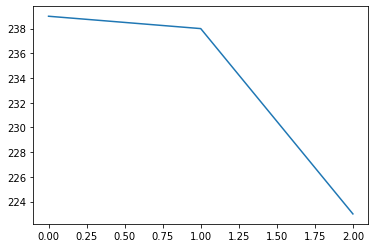

PDM07oi_pct 3


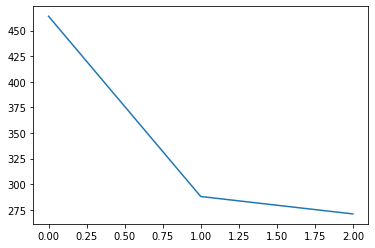

ADM04e_pct 3


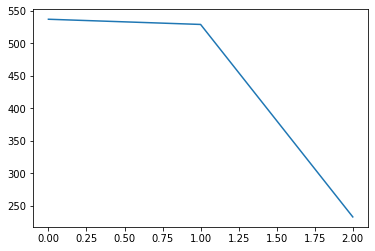

ADL12e_pct 3


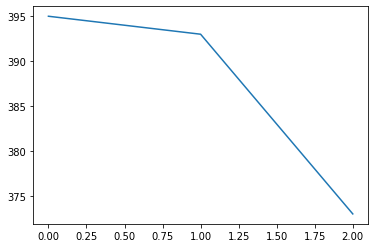

PDL17g_pct 3


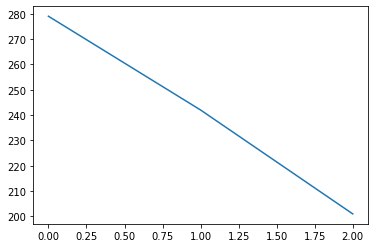

AVL06v_f_pct 3


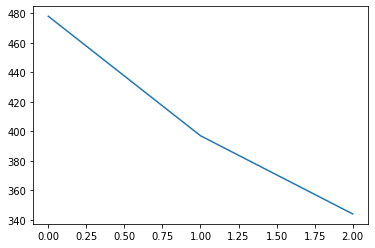

PVL06r_pct 3


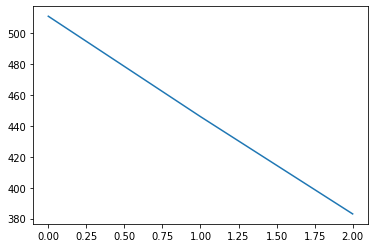

PVL06p_b_pct 3


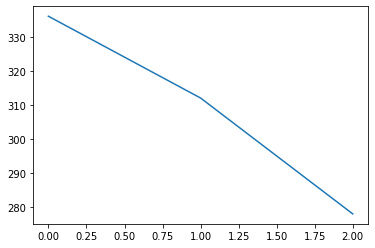

AVL03z_c_pct 3


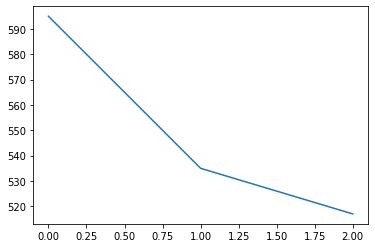

PDL13c_pct 3


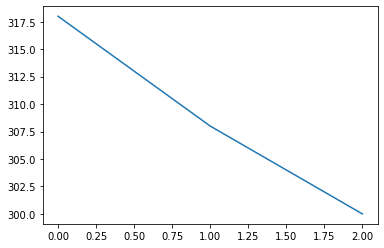

AVL08h_pct 3


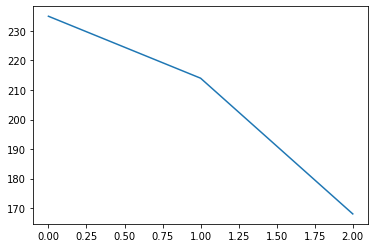

PDL09oe_pct 3


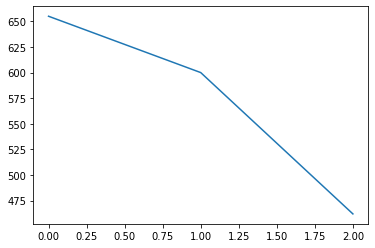

ADL01r_pct 3


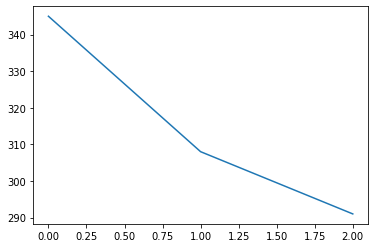

AVL06u_pct 3


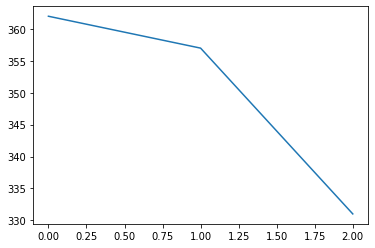

PVL08i_pct 3


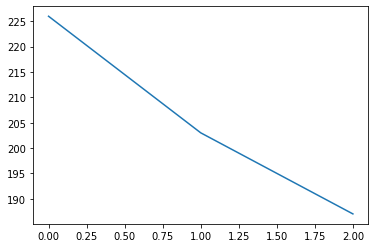

AVL03z_a_pct 3


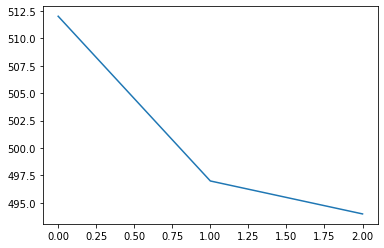

PVL13b_a_pct 3


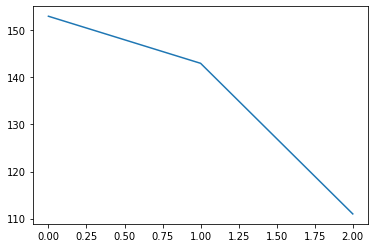

PDM10r_pct 3


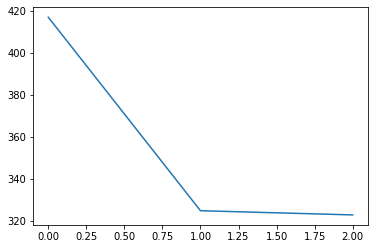

AVL09f_pct 3


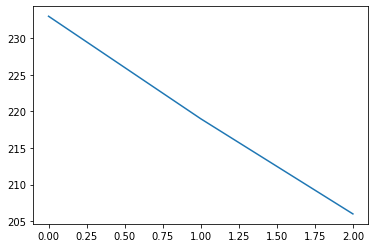

ADL03m_g_pct 3


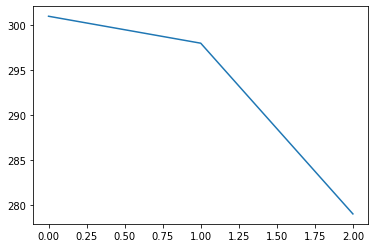

ADL22d_d_pct 3


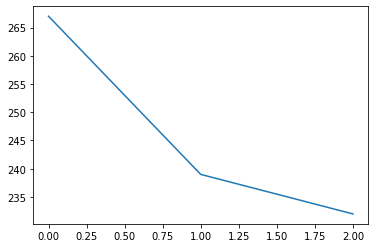

PDL06os_pct 3


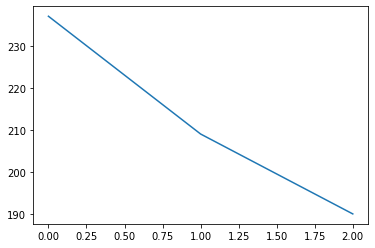

ADL15i_b_pct 3


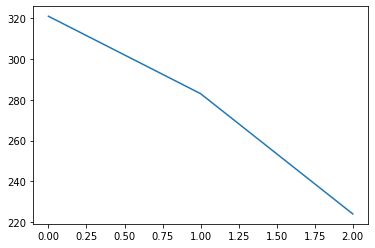

PDL15p_pct 3


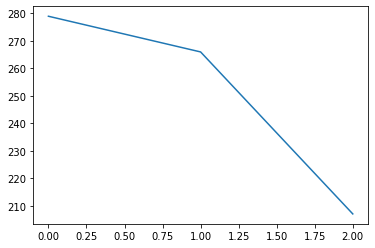

PDM08q_b_pct 3


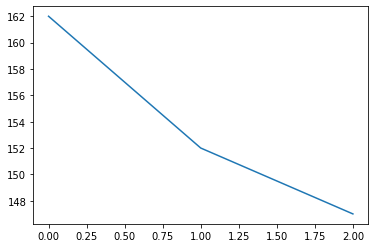

ADL11m_pct 3


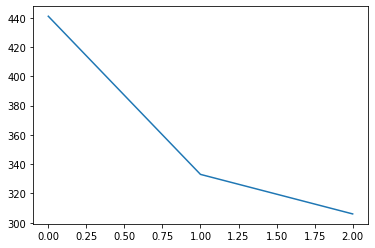

ADL03ob_pct 3


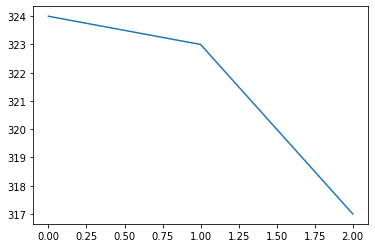

ADL03on_pct 3


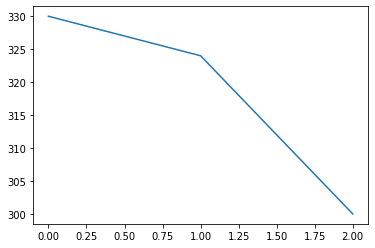

ADL22g_pct 3


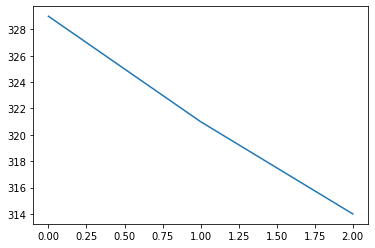

AVM13c_pct 3


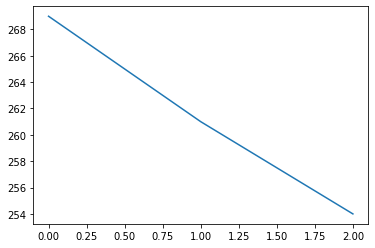

ADL02ol_pct 3


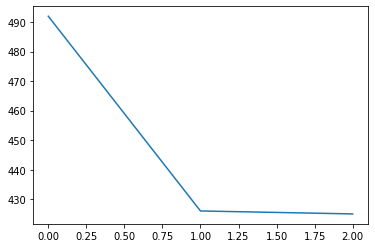

ADL07od_pct 3


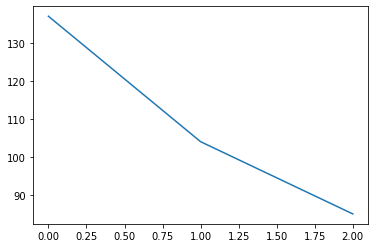

PDL08ob_pct 3


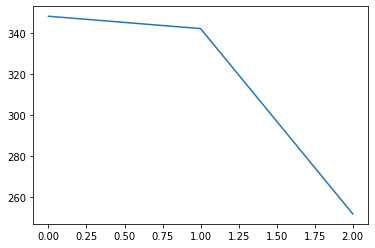

PDL10g_b_pct 3


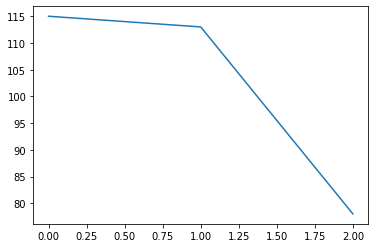

ADL16e_pct 3


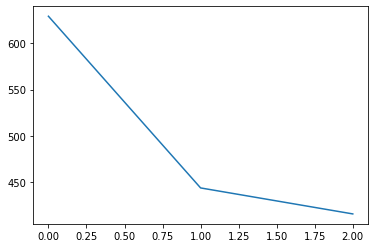

ADL01w_c_pct 3


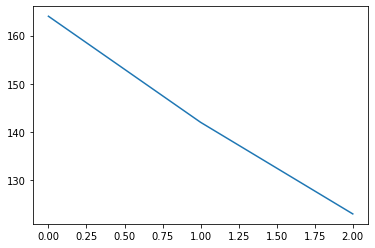

PDL10g_g_pct 3


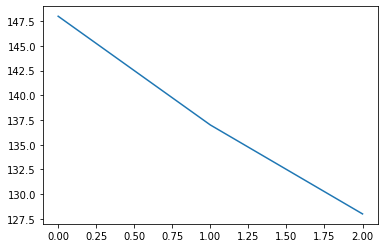

PDL11oh_pct 3


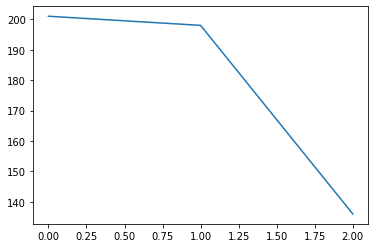

ADL15e_pct 3


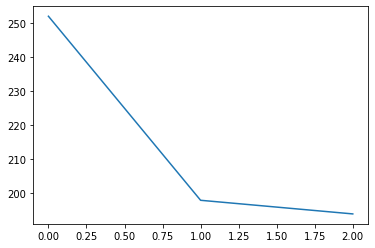

ADL15g_a_pct 3


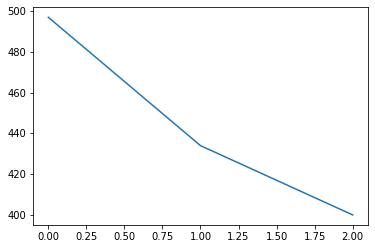

PDL18w_b_pct 3


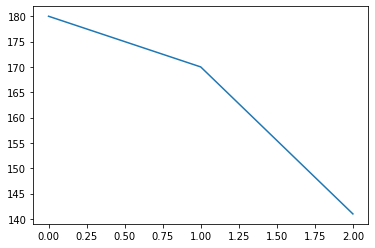

PDM22n_pct 3


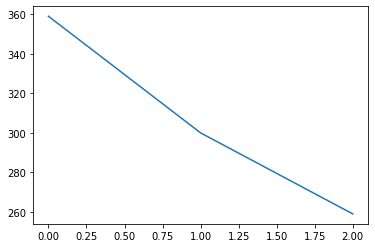

ADM04d_pct 3


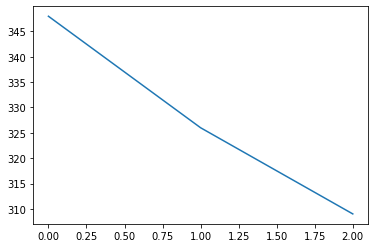

FB6R 3


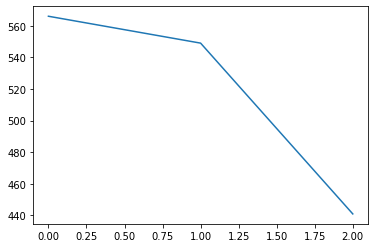

PDL18w_a_pct 3


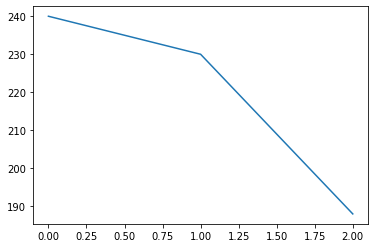

ADL04u_pct 3


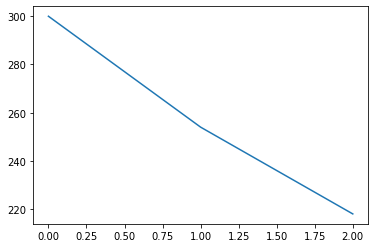

PVL06od_pct 3


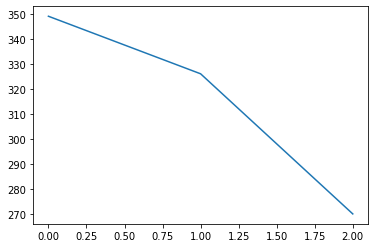

ADL05h_pct 3


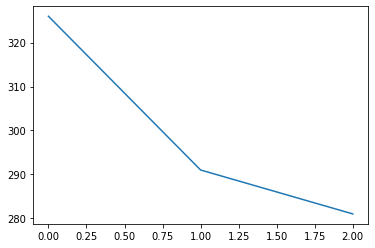

PDM27h_pct 3


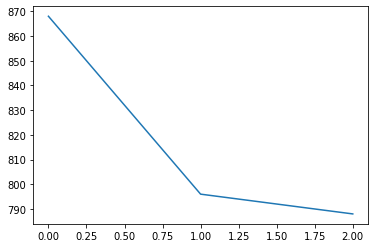

PDM09ob_pct 3


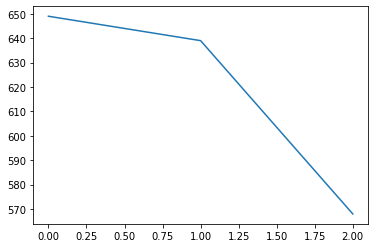

PDM12h_pct 3


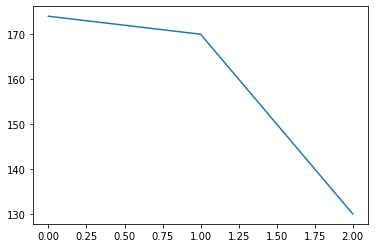

PDM13e_a_pct 3


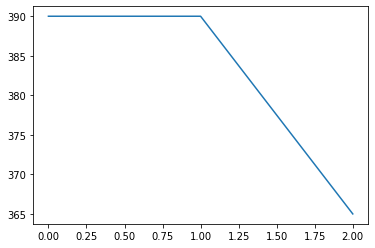

PVL04om_pct 3


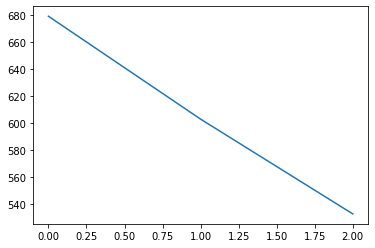

PDL15t_pct 3


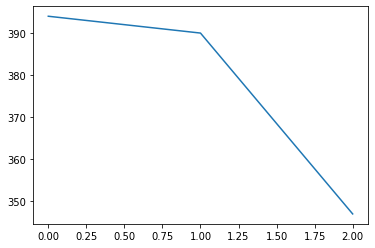

ADL24k_pct 3


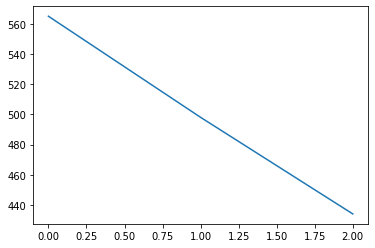

PDL23c_pct 3


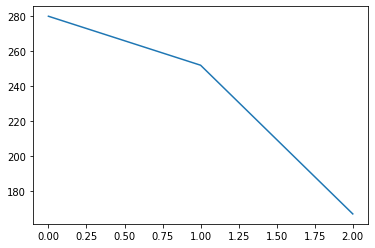

FB6K 3


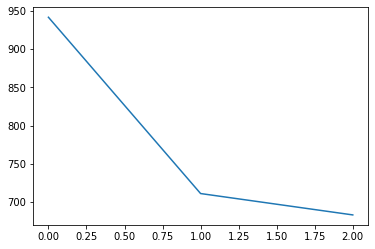

FB5U 3


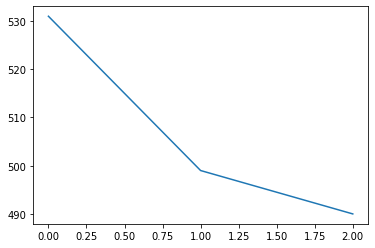

ADL04c_pct 3


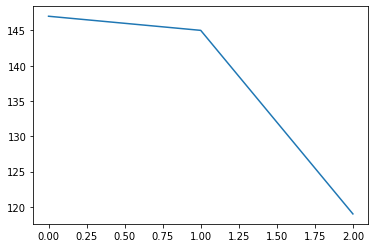

PVL03c_e_pct 3


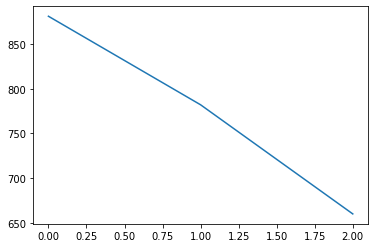

PDL16b_pct 3


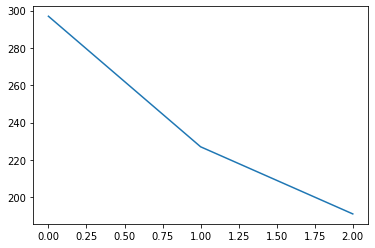

DL3 lPN 3


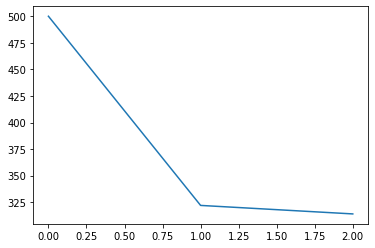

PDL20d_pct 3


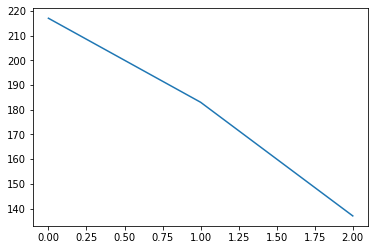

ADL01op_pct 3


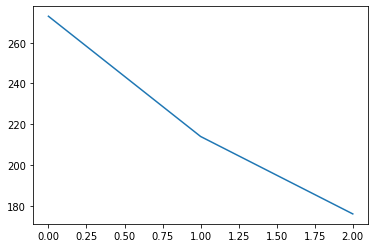

PVL03os_pct 3


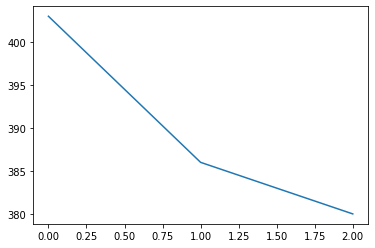

PDL16p_pct 3


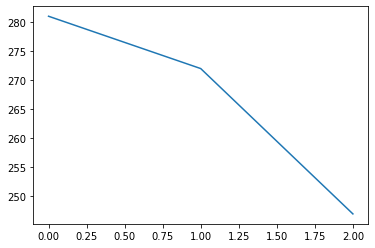

ADL05oh_pct 3


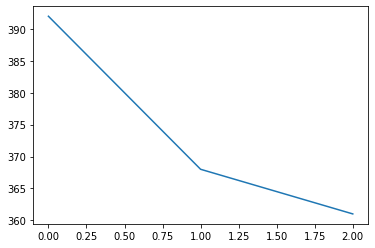

ADL01y_pct 3


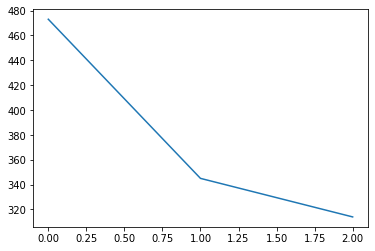

AVL07ox_pct 3


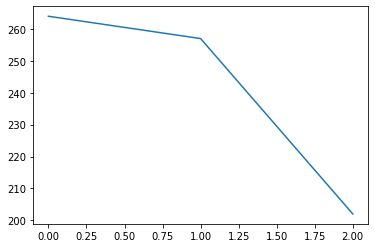

ADL05s_pct 3


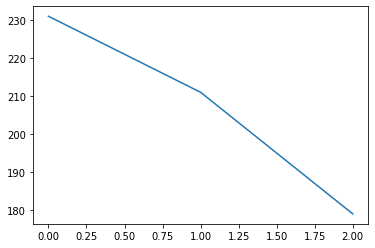

ADL13s_pct 3


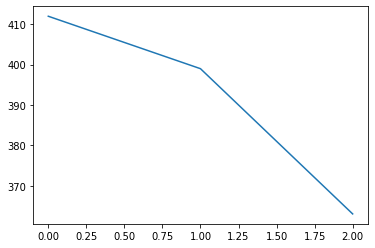

ADL17r_pct 3


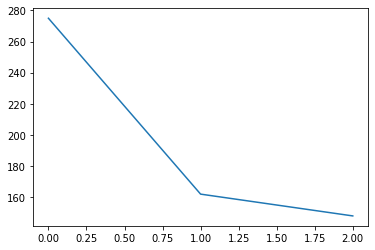

ADL03m_a_pct 3


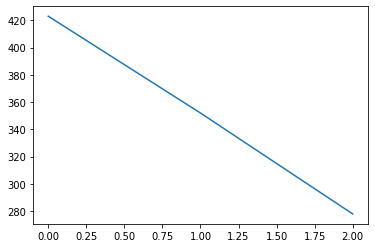

AVM13f_pct 3


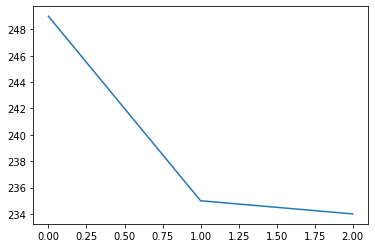

ADL23c_b_pct 3


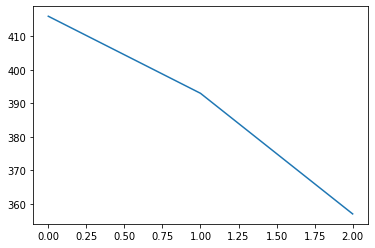

ADL03oi_pct 3


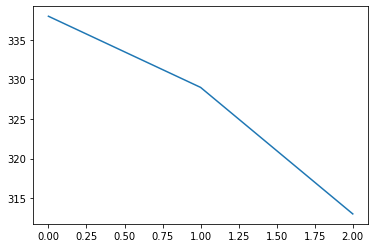

ADL10p_pct 3


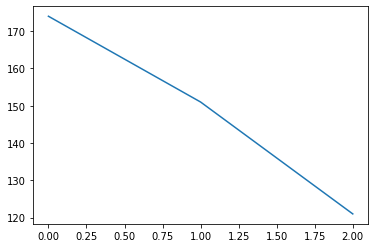

ADM01w_pct 3


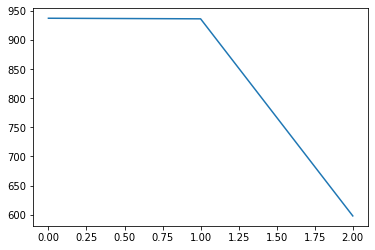

PDL10oc_pct 3


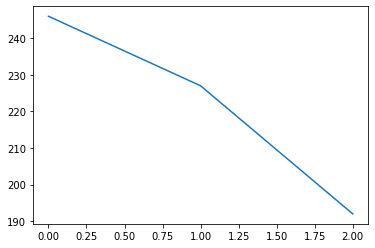

ADL04od_pct 3


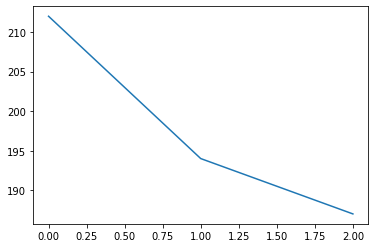

AVM07a_c_pct 3


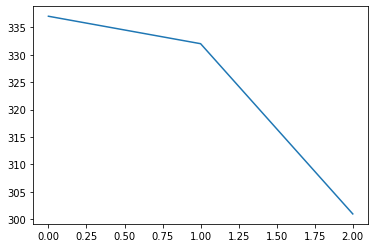

PDL10a_pct 3


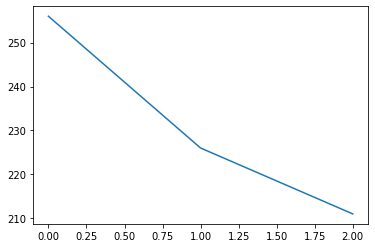

ADL13c_b_pct 3


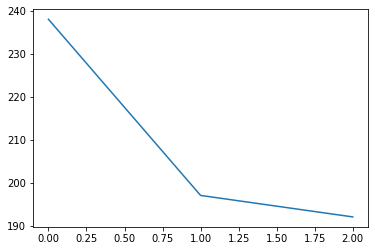

PDM13r_e_pct 3


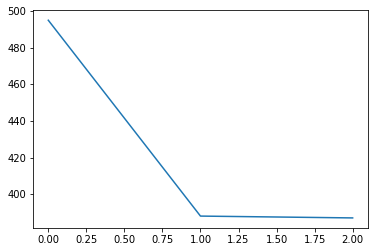

PDM13oa_pct 3


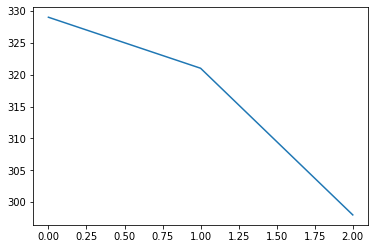

ADL13h_pct 3


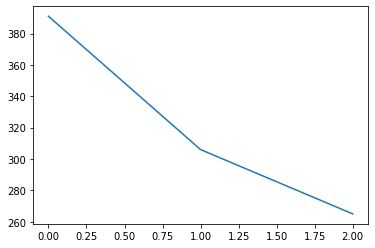

PVL04oi_pct 3


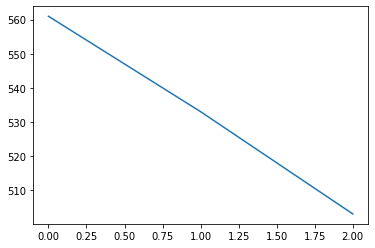

PVM12c_b_pct 3


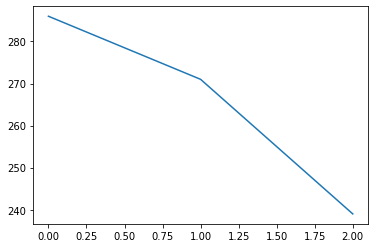

PDL19m_pct 3


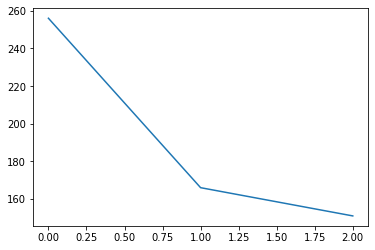

PDL06or_pct 3


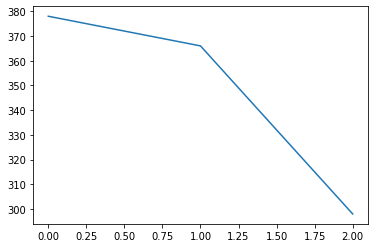

ADL07op_pct 3


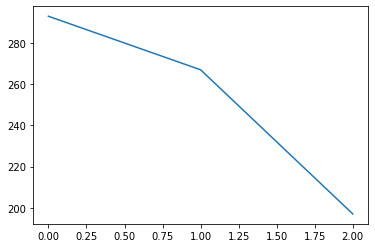

ADL11p_pct 3


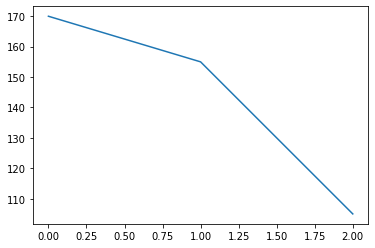

PVM12i_pct 3


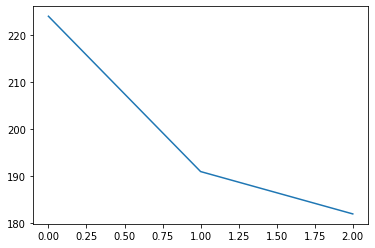

ADL03f_pct 3


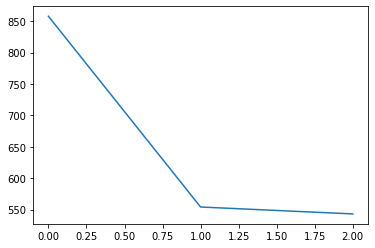

PDL05a_b_pct 3


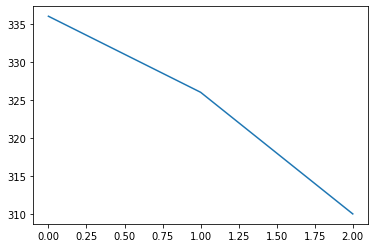

PDM08d_pct 3


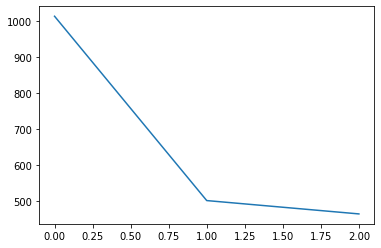

ADL04j_pct 3


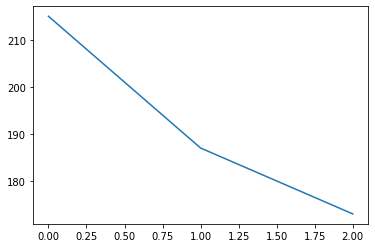

ADL04of_pct 3


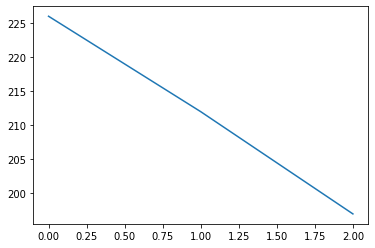

AVL02b_a_pct 3


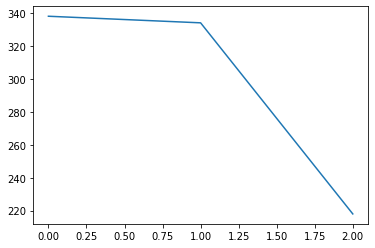

ADL01ol_pct 3


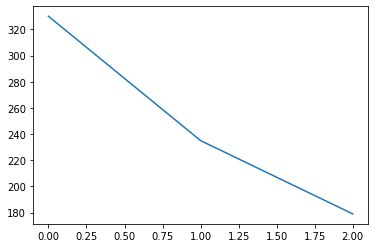

PDL07z_pct 3


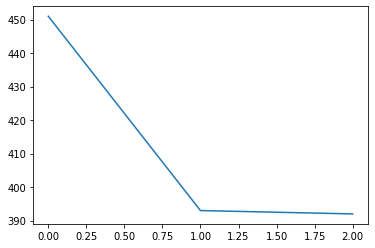

ADL03k_c_pct 3


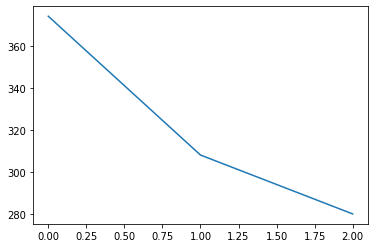

VA5 lPN 3


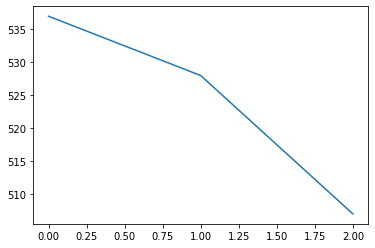

PDL19q_pct 3


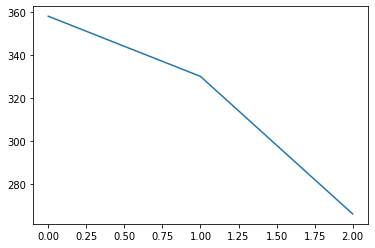

PDL05oh_pct 3


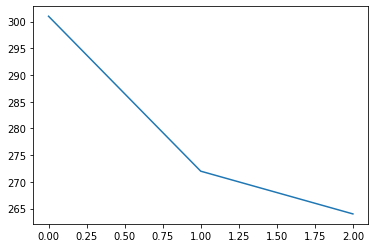

PDL16t_pct 3


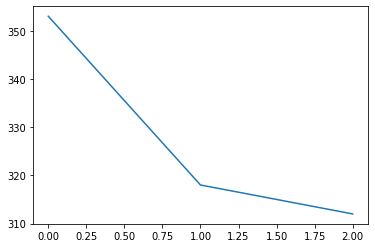

MBON09 3


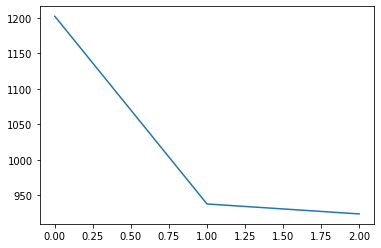

PDL06og_pct 3


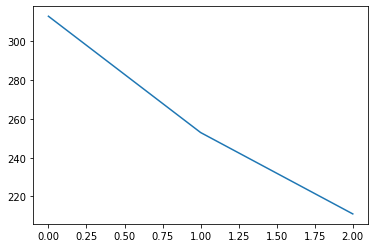

PDL23f_pct 3


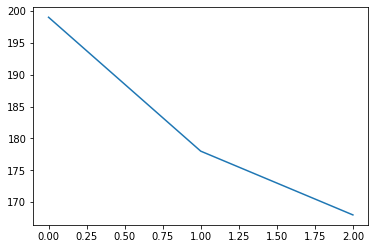

AVL02z_a_pct 3


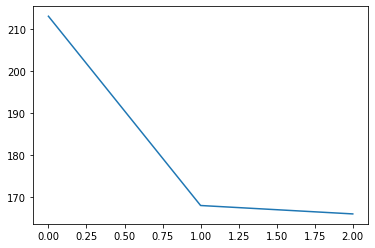

AVL12oa_pct 3


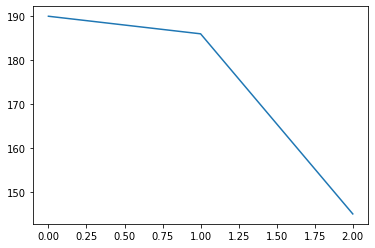

ADL22d_b_pct 3


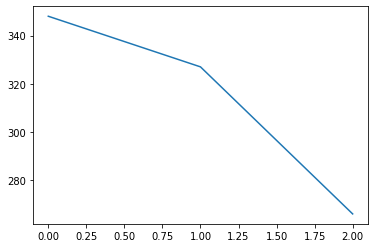

ADL09g_pct 3


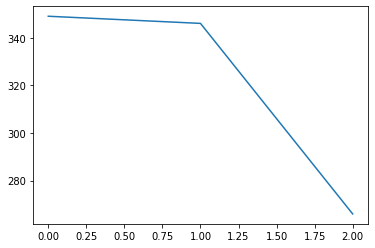

PDL06ov_pct 3


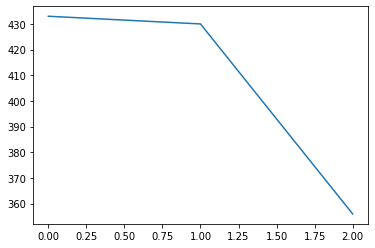

AVL04n_b_pct 3


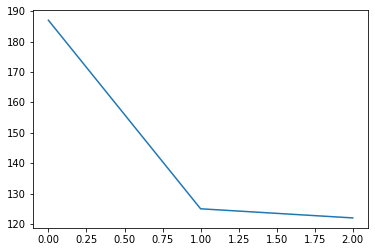

ADM05z_pct 3


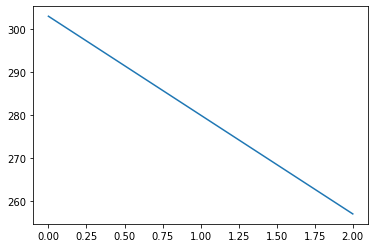

PDL15h_pct 3


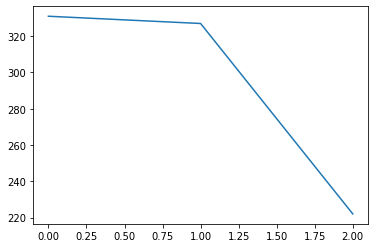

PDL24j_pct 3


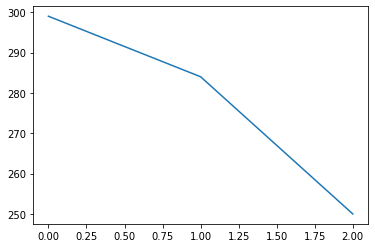

AVM13i_pct 3


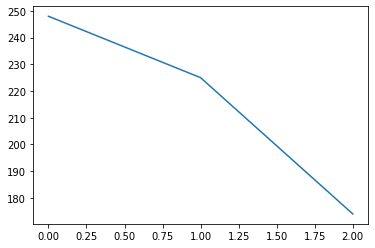

PDL05a_a_pct 3


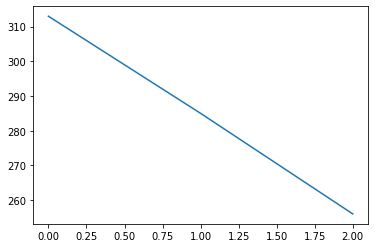

ADL14a_pct 3


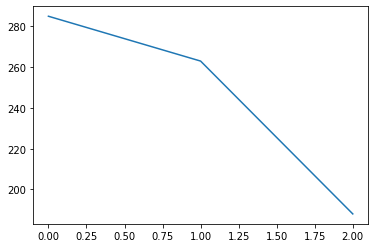

AVM13q_pct 3


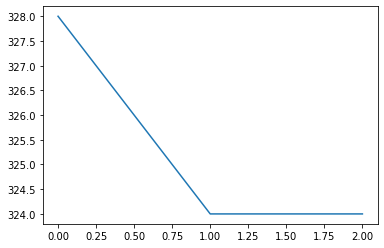

PDM08ol_pct 3


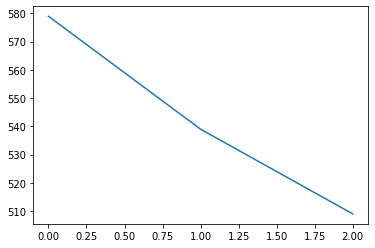

AVL02y_pct 3


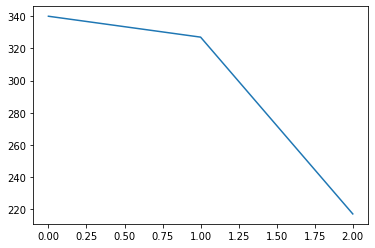

PDL14j_a_pct 3


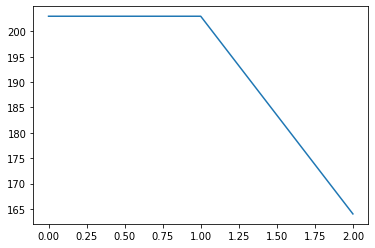

PDL07w_pct 3


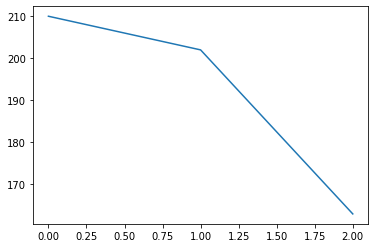

PDL07og_pct 3


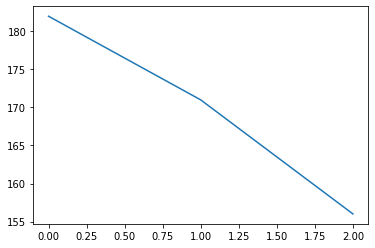

ADL09k_pct 3


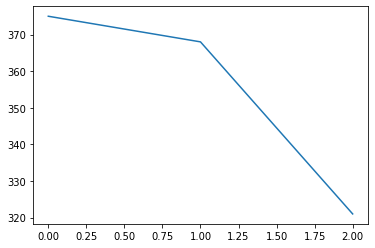

ADM05n_pct 3


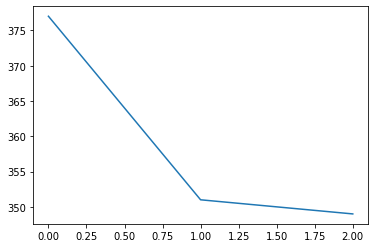

AVL08oc_pct 3


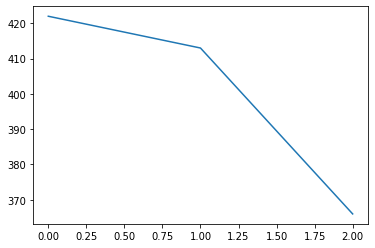

PVL04f_pct 3


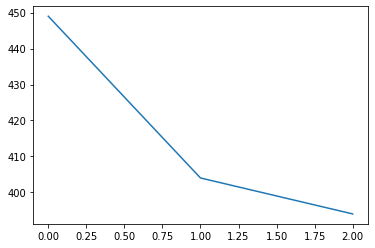

AVL10b_c_pct 3


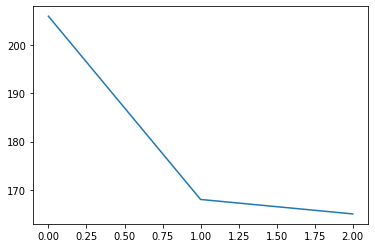

ADL01t_pct 3


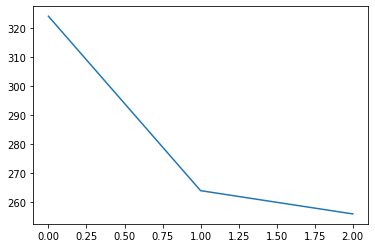

ADL13b_pct 3


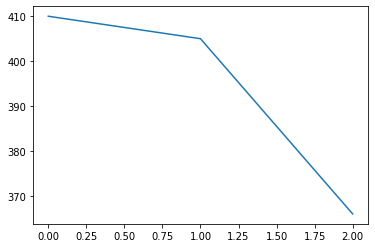

PDL06a_a_pct 3


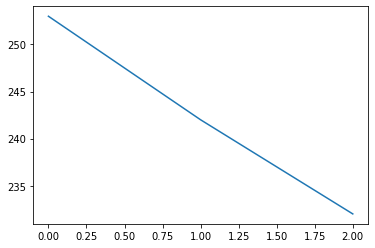

AVL12g_pct 3


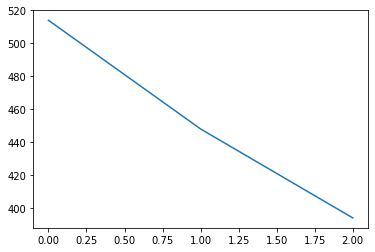

ADL09n_b_pct 3


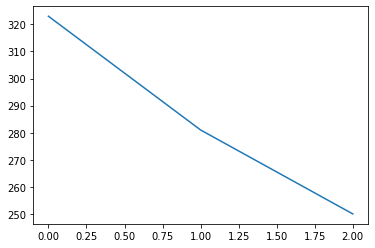

PDL21n_a_pct 3


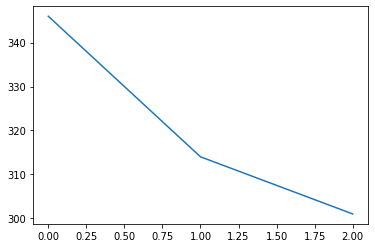

PVL04a_b_pct 3


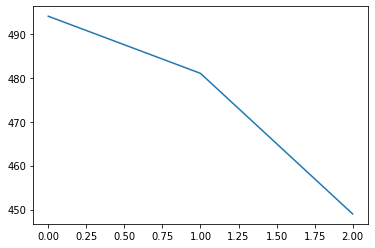

AVM15i_pct 3


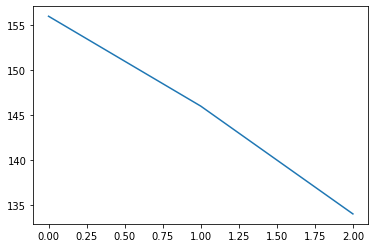

PVL04oq_pct 3


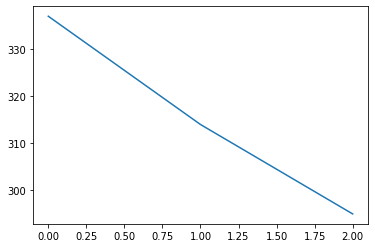

ADL22i_pct 3


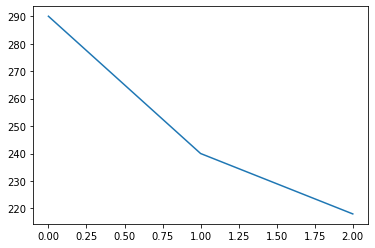

AVM15c_pct 3


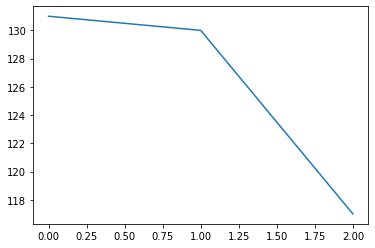

ADL15p_a_pct 3


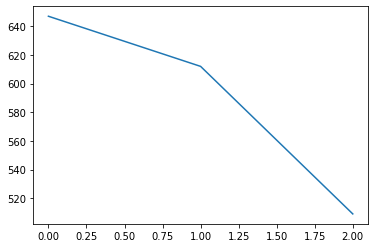

PVL03h_b_pct 3


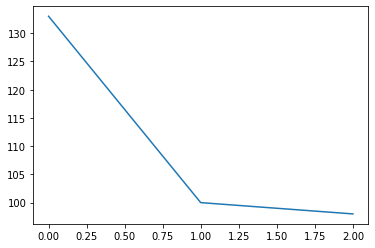

PVL03c_b_pct 3


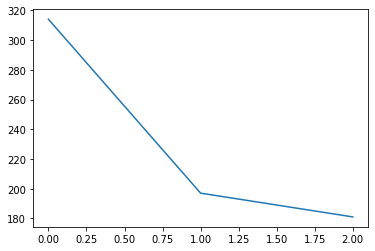

AVL01m_pct 3


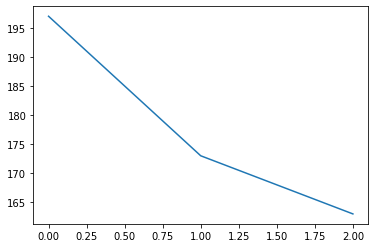

PDL23i_pct 3


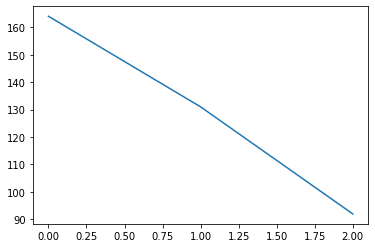

PDL20n_pct 3


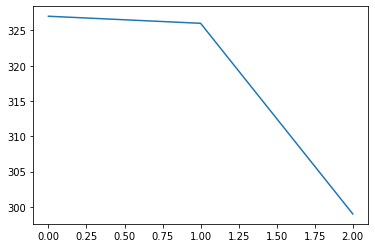

PDL13r_pct 3


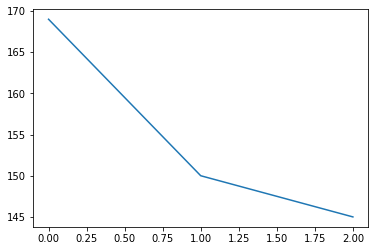

ADL01oh_pct 3


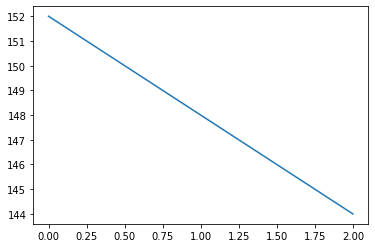

PDL06n_a_pct 3


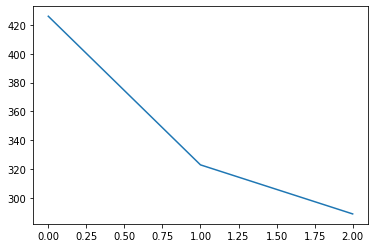

AVL01n_pct 3


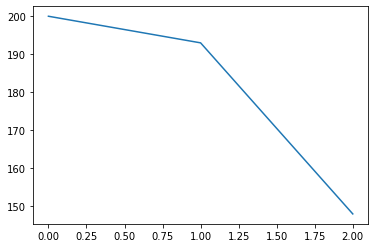

PDL11og_pct 3


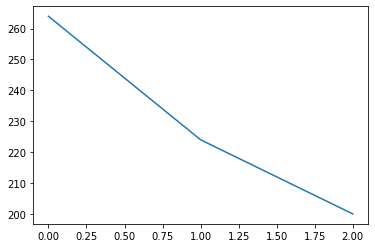

PDL20p_pct 3


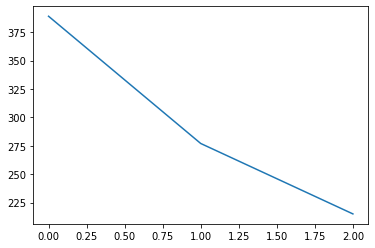

PDL09od_pct 3


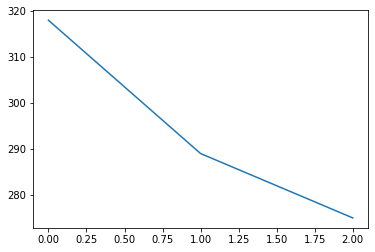

AVL04d_pct 3


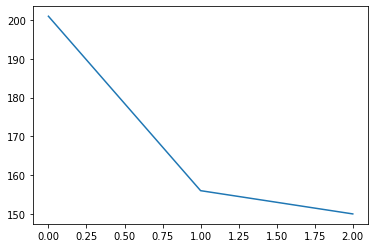

PDL08ow_pct 3


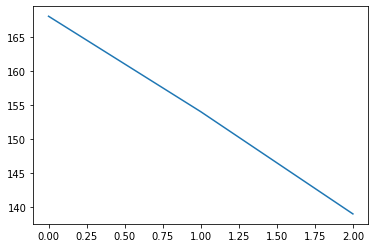

ADL05oa_pct 3


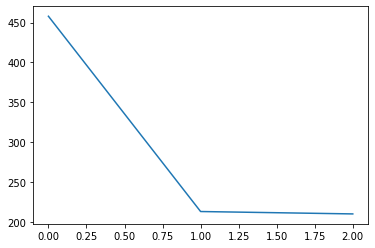

ADL10g_e_pct 3


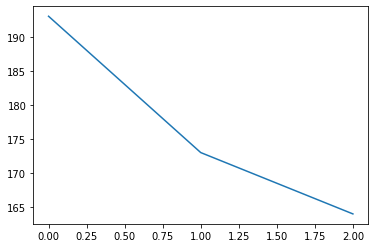

ADL05r_d_pct 3


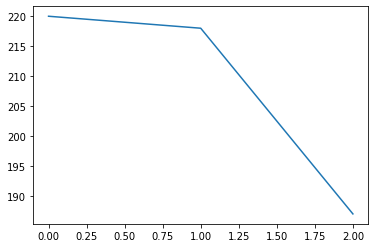

PVL03h_a_pct 3


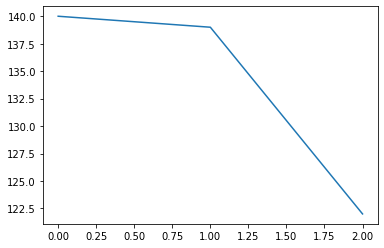

PDL16q_a_pct 3


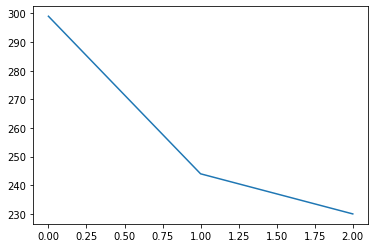

PDM06q_pct 3


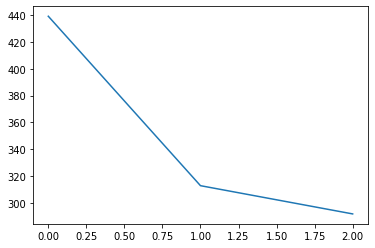

PDL23h_pct 3


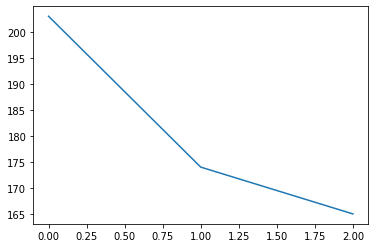

AVL08oo_pct 3


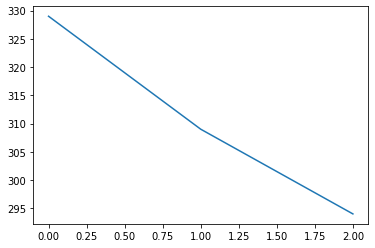

ADL13n_c_pct 3


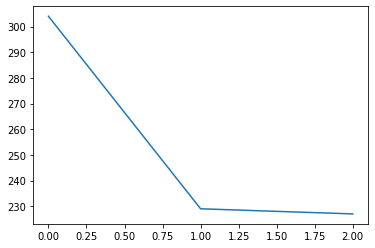

PDL06h_pct 3


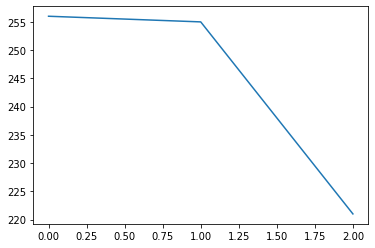

ADM05u_pct 3


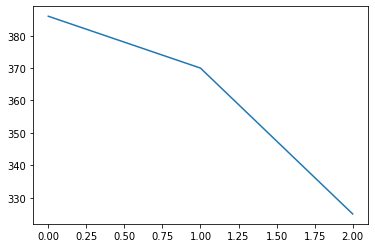

ADL23h_b_pct 3


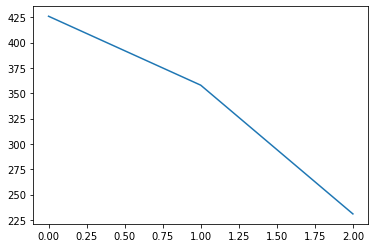

AVL07i_pct 3


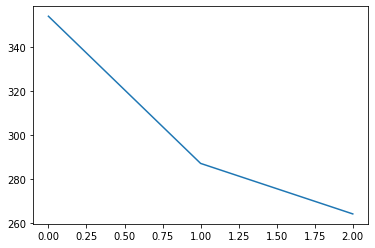

AVL18e_pct 3


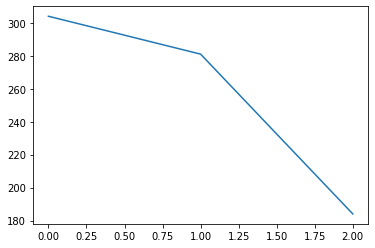

PVL03oq_pct 3


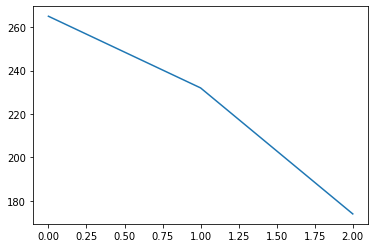

PDL18s_pct 3


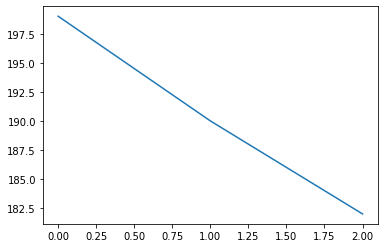

ADM07oi_pct 3


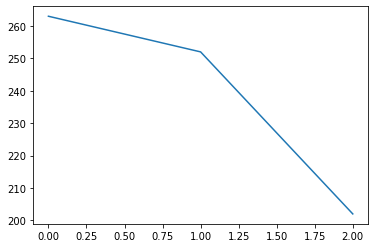

ADL29a_pct 3


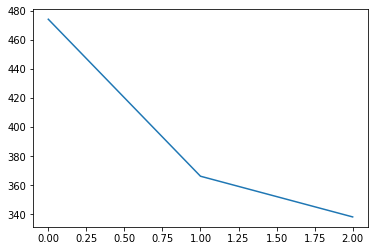

AVL04n_a_pct 3


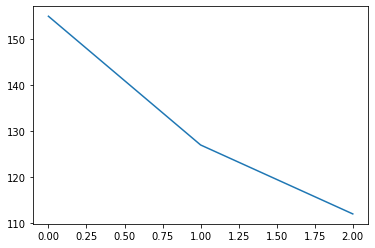

AVL04u_b_pct 3


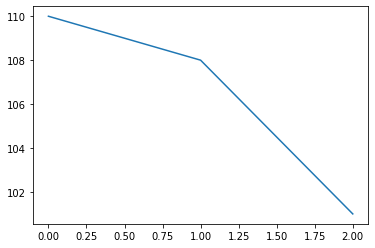

ADL07k_pct 3


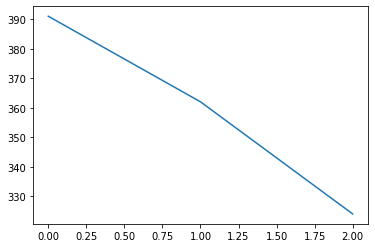

PVM05f_pct 3


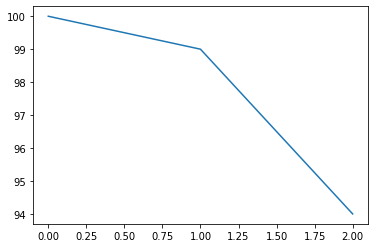

PVL09j_pct 3


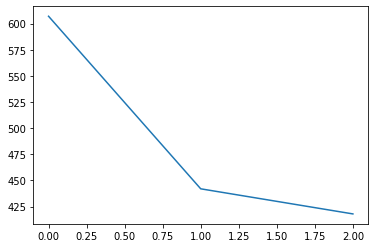

PDL19j_pct 3


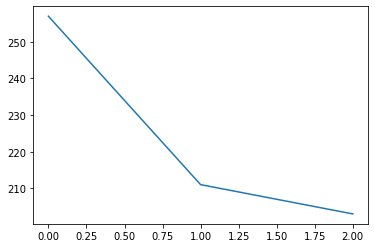

PDL06n_b_pct 3


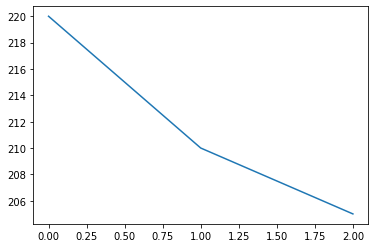

PVL09i_pct 3


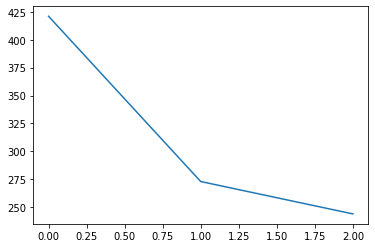

AVL02e_pct 3


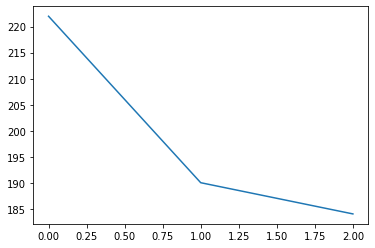

PDL22i_pct 3


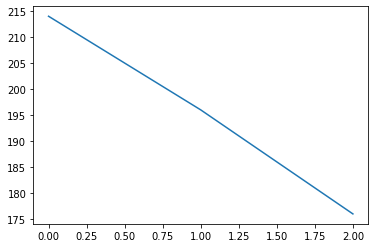

PDL19i_pct 3


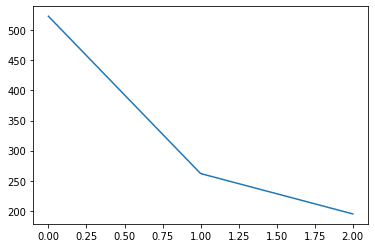

ADL04t_b_pct 3


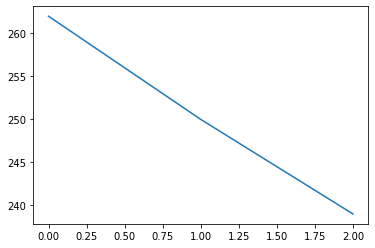

ADL19i_a_pct 3


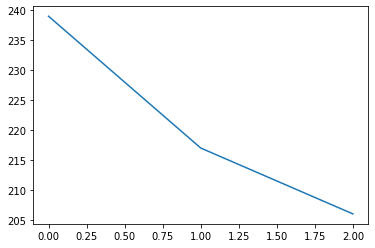

AVL02oq_pct 3


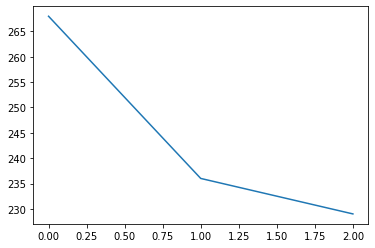

PDM17v_pct 3


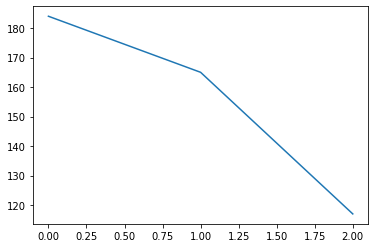

PVM05c_pct 3


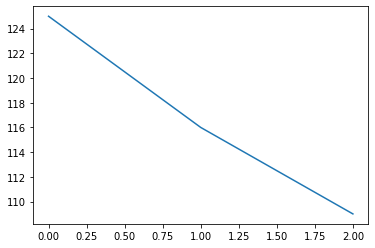

aMe14B 3


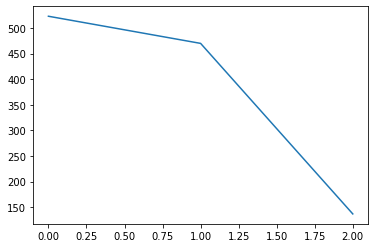

D adPN 3


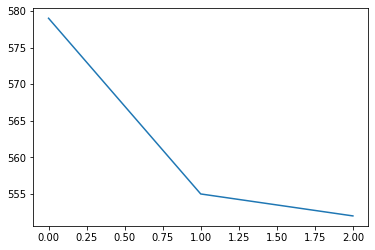

ADL22d_c_pct 3


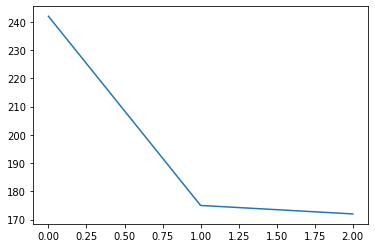

VA1d adPN 3


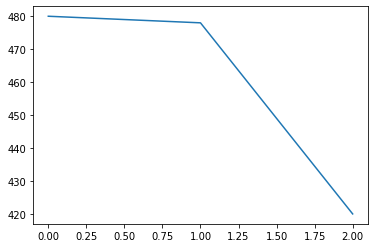

PVL03b_pct 3


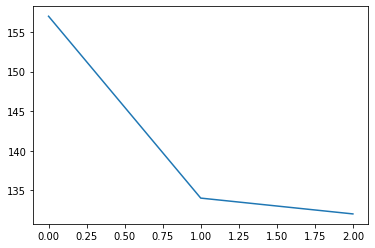

AVM15d_c_pct 3


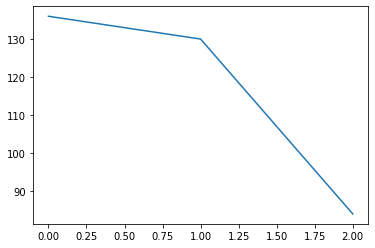

aMe26 3


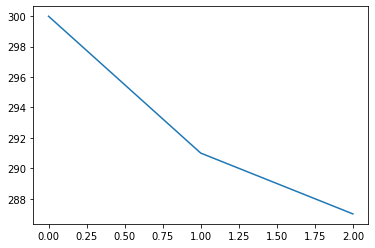

PVL20f_pct 3


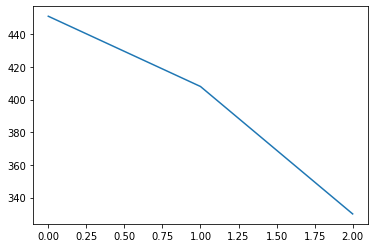

AVL14g_pct 3


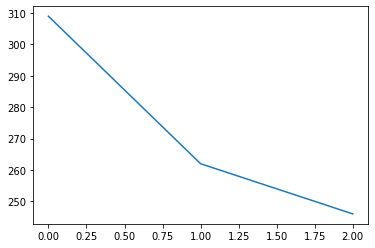

AVL07oy_pct 3


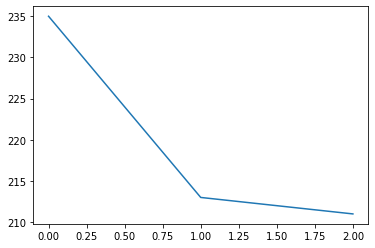

VC4 adPN 3


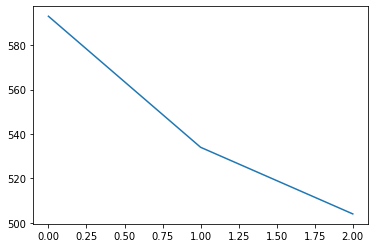

PDL08oj_pct 3


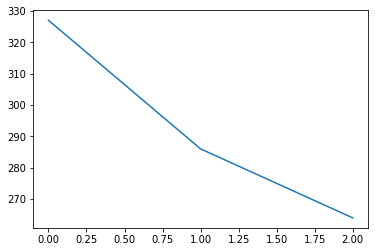

DC3 adPN 3


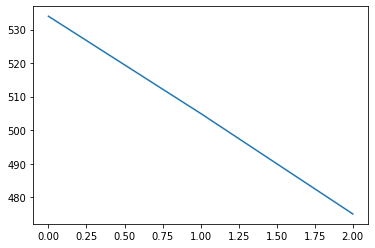

ADL01q_b_pct 3


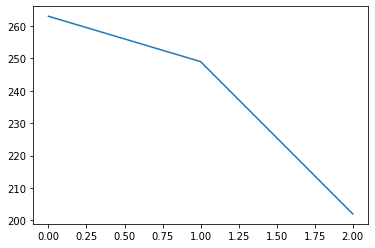

VC3l adPN 3


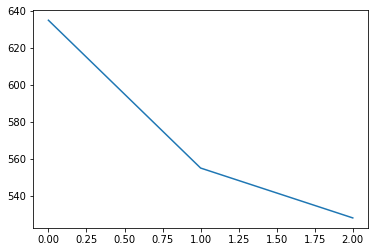

VC3m lvPN 3


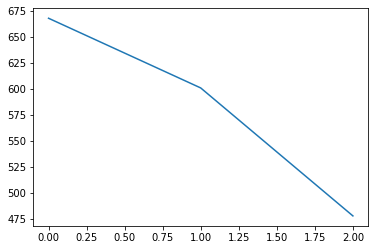

PDL08oc_pct 3


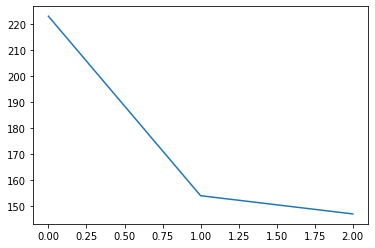

VC5 lvPN 3


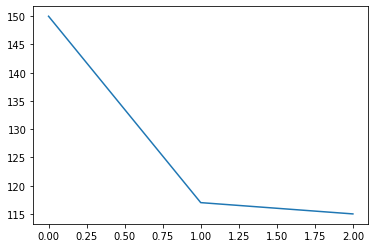

PDL08m_b_pct 3


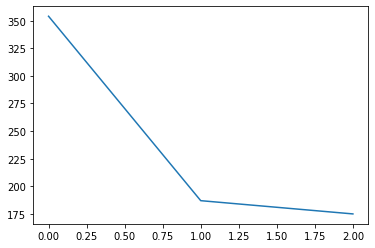

DL2v adPN 3


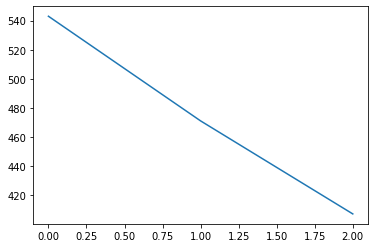

ADL05r_e_pct 3


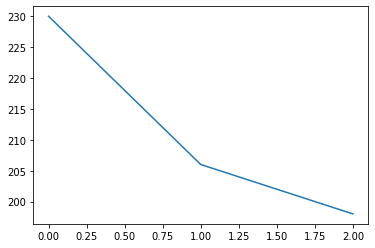

olfactory multi lPN lALT 3


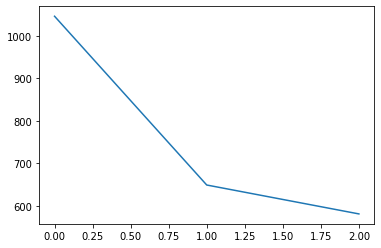

AVL07ov_pct 3


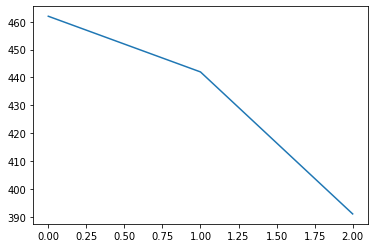

PDL13f_a_pct 3


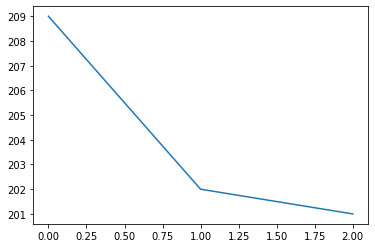

V C PN 3


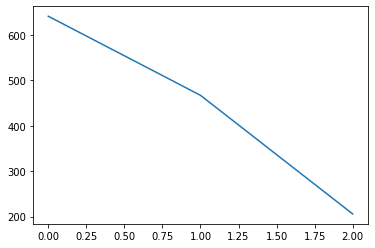

VA1v adPN 3


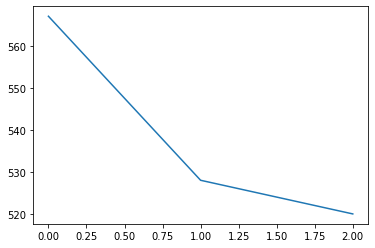

VA7m lPN 3


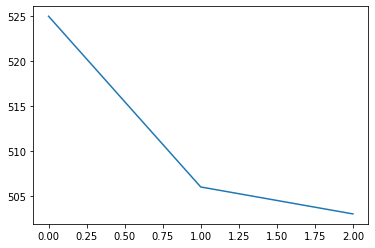

AVM06d_pct 3


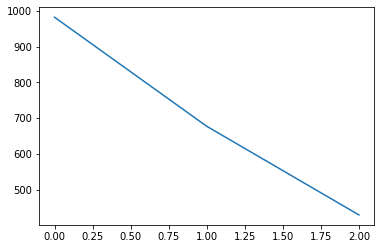

PDL06ol_pct 3


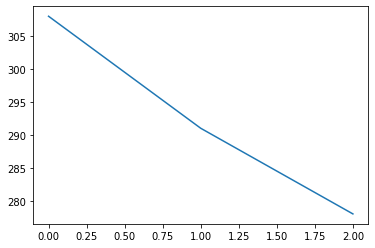

PDL08p_a_pct 3


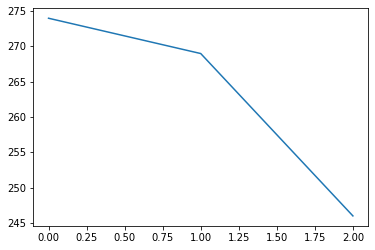

AVM14z_c_pct 3


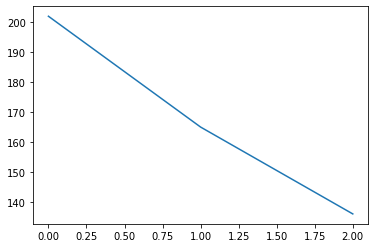

ADL08n_d_pct 3


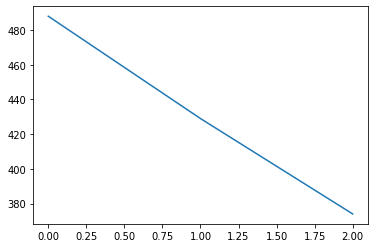

ADM03lb_pct 3


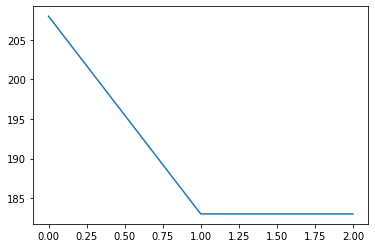

ADM01or_pct 3


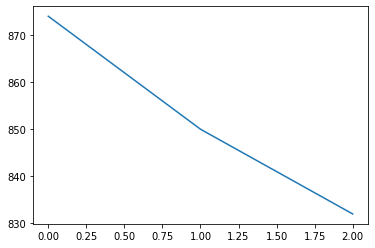

PDM09c_pct 3


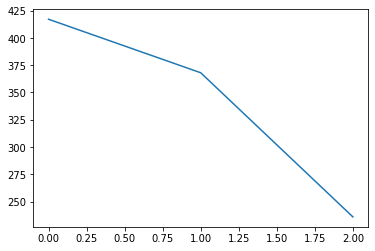

PVM07c_pct 3


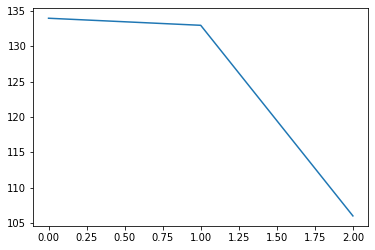

ADL05q_e_pct 3


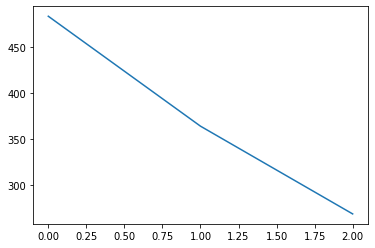

AVM15n_a_pct 3


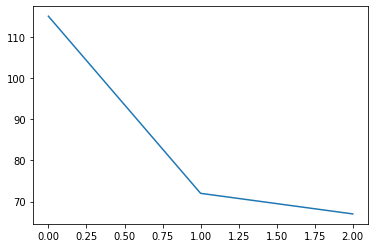

PDM17ob_pct 3


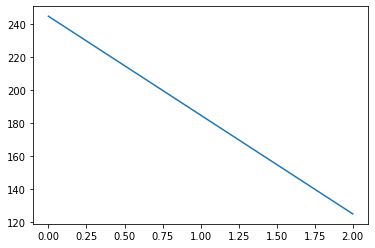

PVM02oh_pct 3


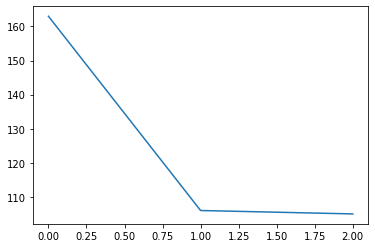

AVM11j_pct 3


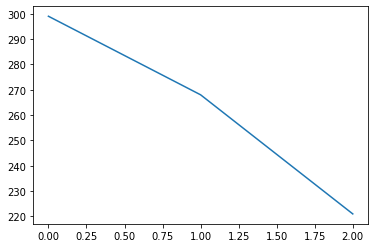

ADM03oh_pct 3


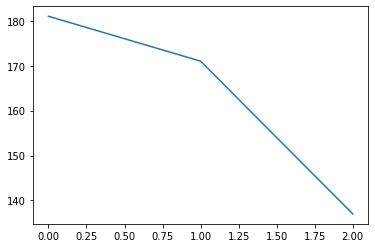

PVL08t_pct 3


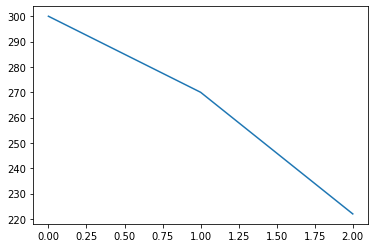

PDM06h_b_pct 3


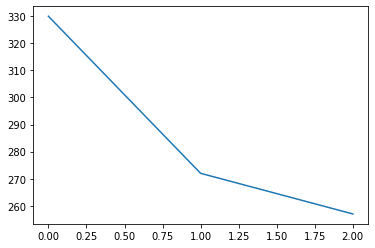

ADL06p_pct 3


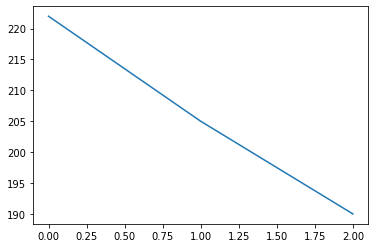

ADL19c_pct 3


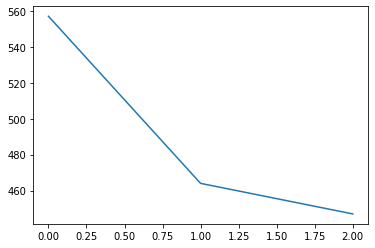

PVL08j_a_pct 3


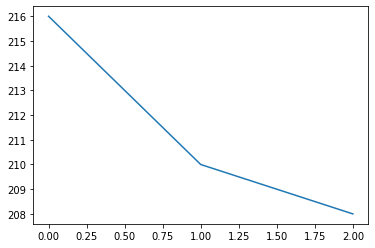

AVM11d_a_pct 3


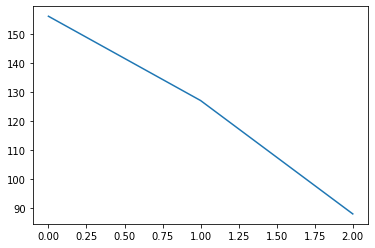

AVL05w_a_pct 3


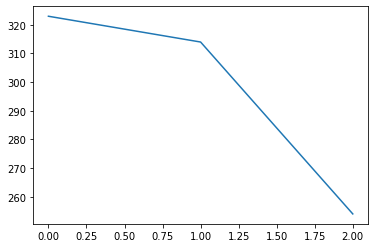

PVL18b_pct 3


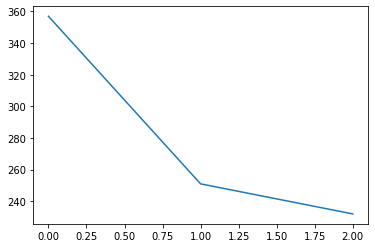

AVL05u_a_pct 3


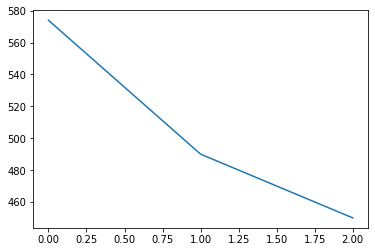

ADL01h_b_pct 3


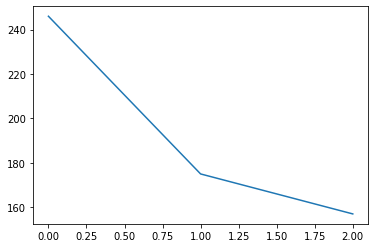

AVL20b_pct 3


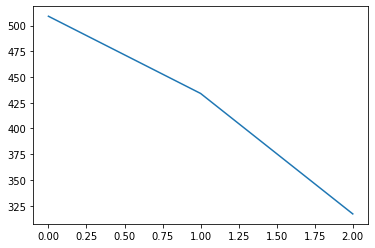

AVL17g_pct 3


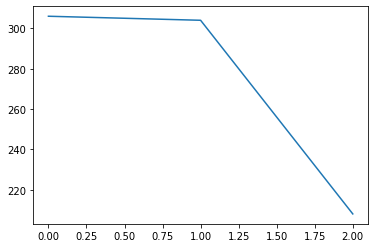

ADL21i_pct 3


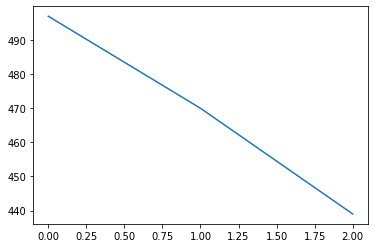

ADL22f_a_pct 3


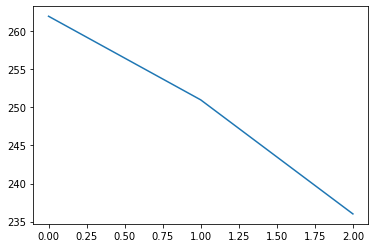

AVL11y_b_pct 3


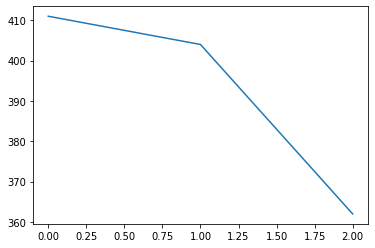

AVL17n_pct 3


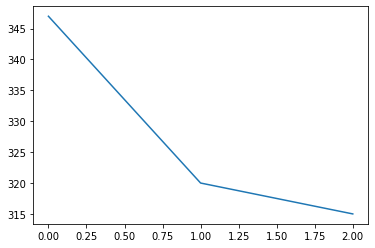

AVL07w_pct 3


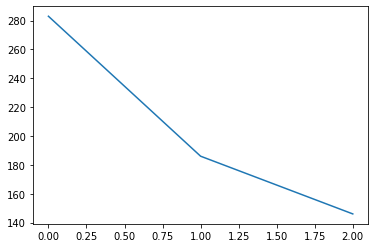

AVL11f_pct 3


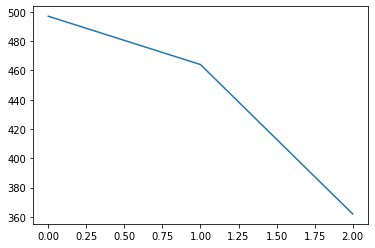

AVL02i_pct 3


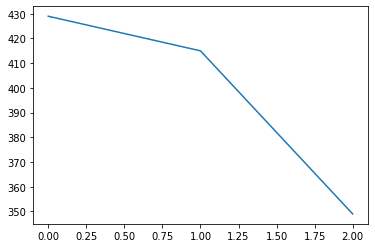

AVL11c_pct 3


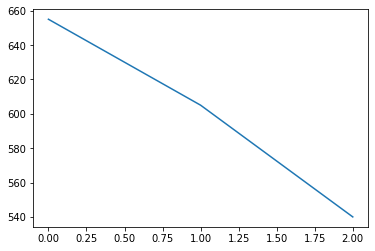

aMe2 3


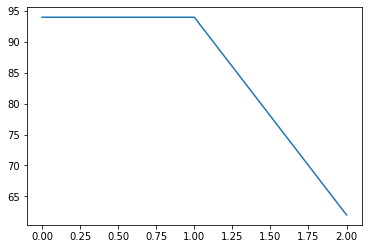

PVL10s_a_pct 3


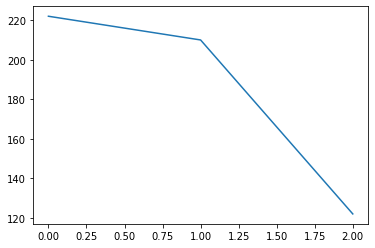

AVL02q_a_pct 3


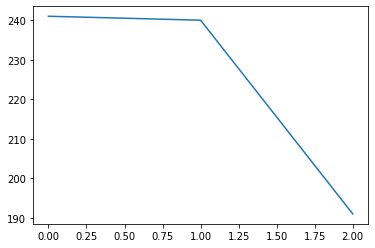

ADL01b_pct 3


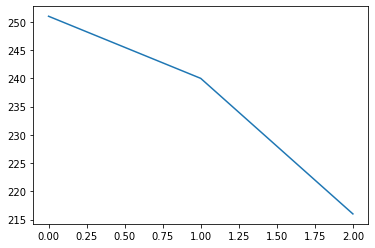

VL2a vPN 3


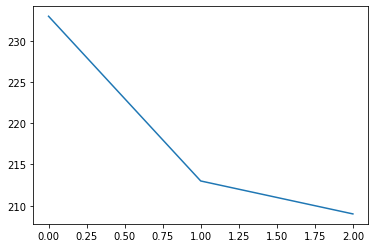

PDL08of_pct 3


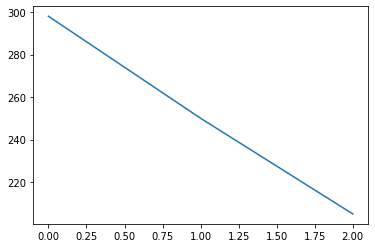

AVL05s_a_pct 3


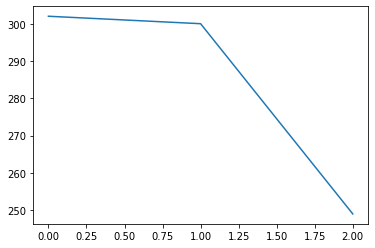

PDL28a_pct 3


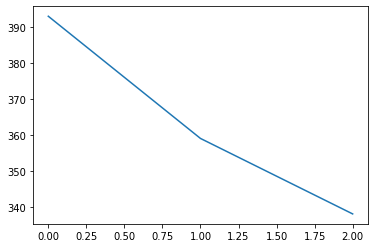

PVL03t_pct 3


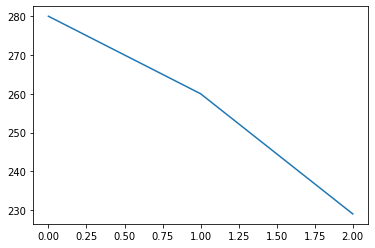

AVM15f_pct 3


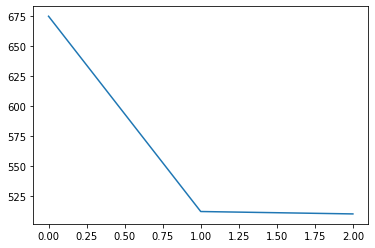

ADL06n_pct 3


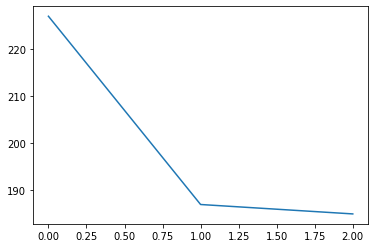

PVL13q_pct 3


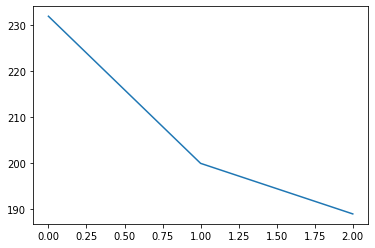

PVL03ob_pct 3


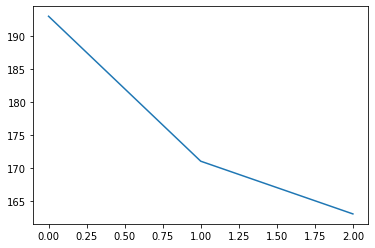

PDM11oh_pct 3


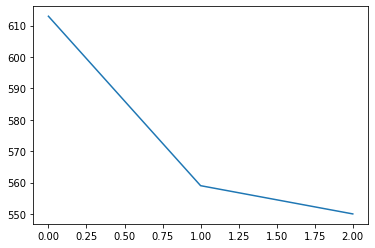

AVL01z_a_pct 3


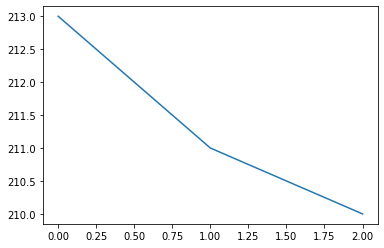

PDM13r_b_pct 3


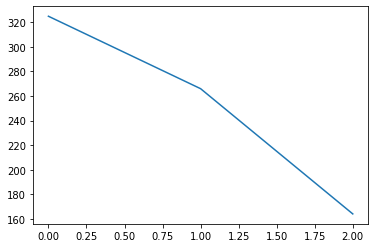

ADM05oc_pct 3


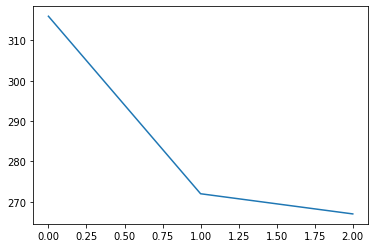

ADL08a_pct 3


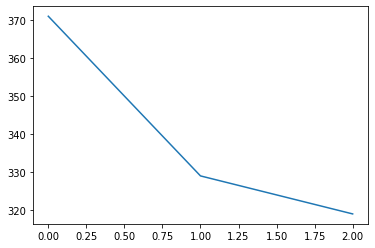

PVL16h_pct 3


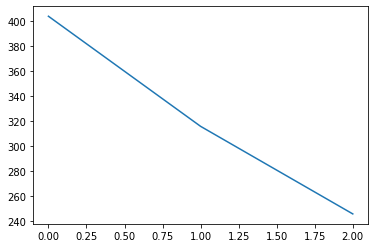

PDL09oh_pct 3


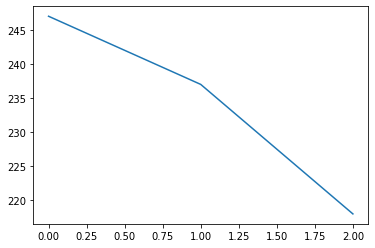

AVL09r_pct 3


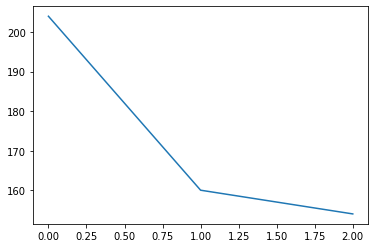

PVM10d_pct 3


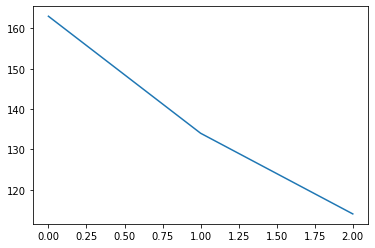

AVL08ok_pct 3


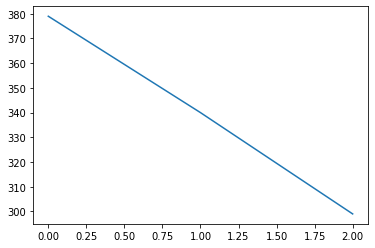

ADM05ob_pct 3


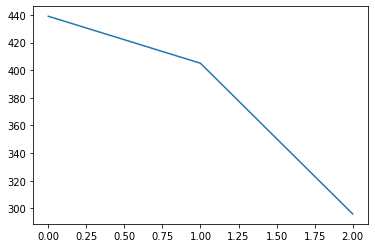

ADM01b_c_pct 3


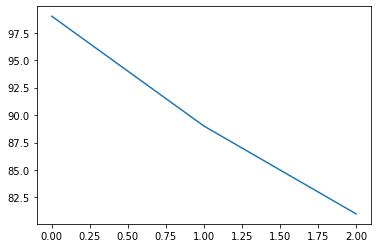

ADM05e_a_pct 3


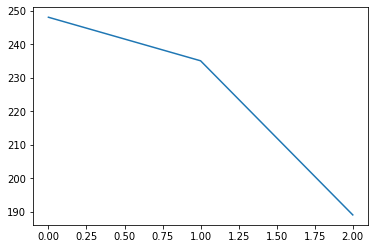

PVL10w_b_pct 3


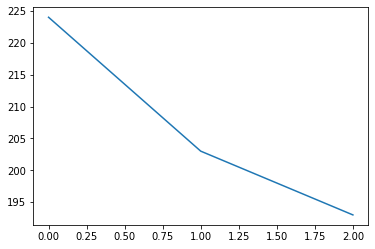

PDM16f_c_pct 3


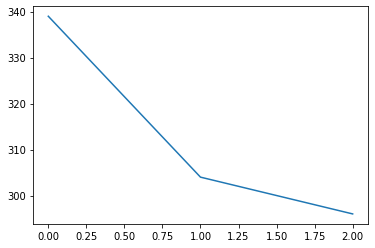

PVM03r_b_pct 3


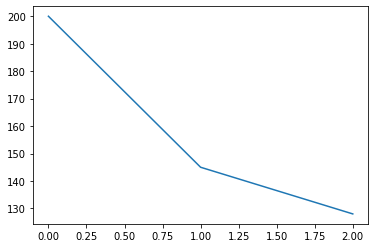

AVL10os_pct 3


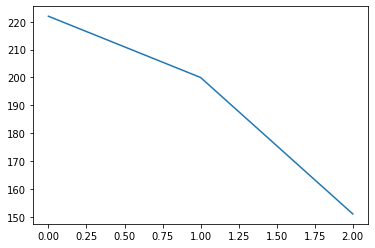

PVM09t_pct 3


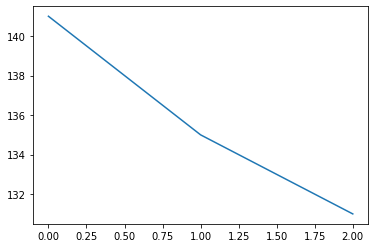

AVM20f_pct 3


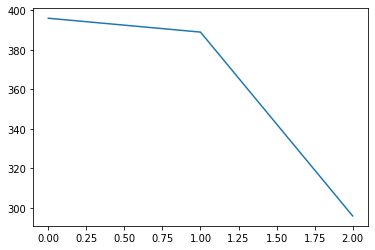

PVM10h_pct 3


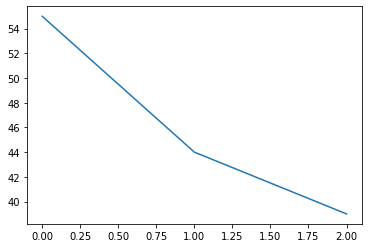

AVM08i_pct 3


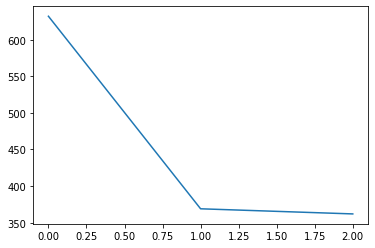

ADM06b_g_pct 3


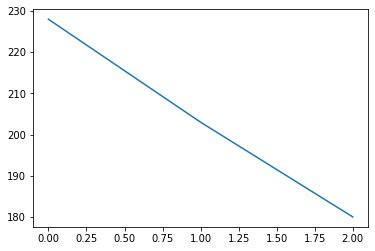

AVM14y_pct 3


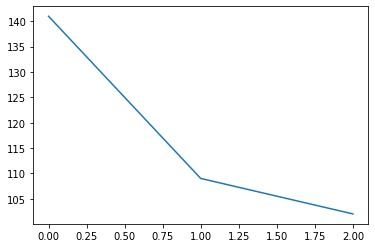

PDL09oi_pct 3


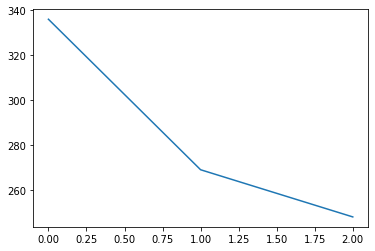

AVL08w_b_pct 3


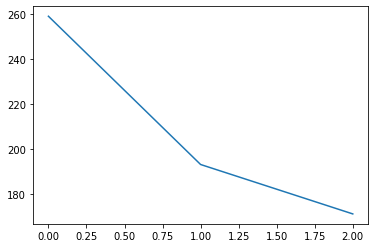

ADL19q_pct 3


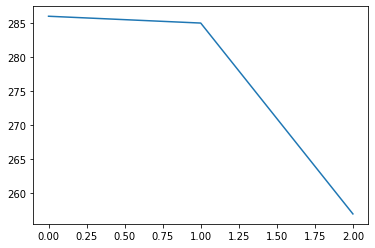

PDM23j_pct 3


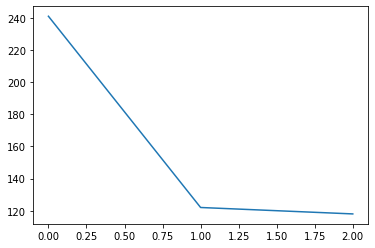

AVM12d_pct 3


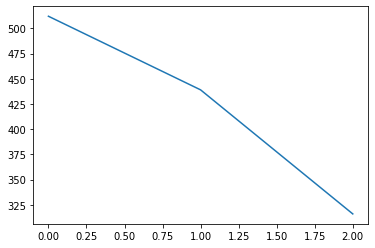

PVM05g_pct 3


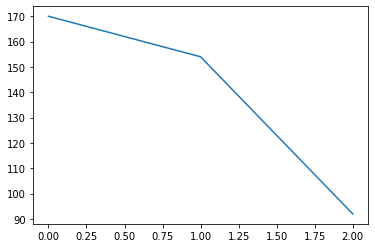

PVM01or_pct 3


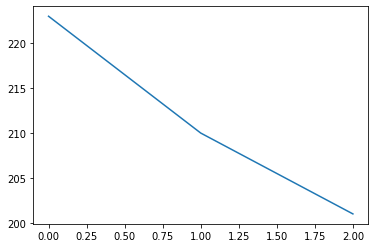

AVL03r_pct 3


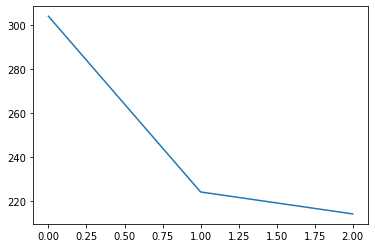

PVL13j_pct 3


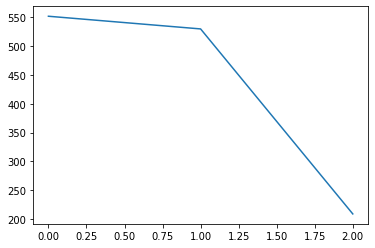

PVL10q_a_pct 3


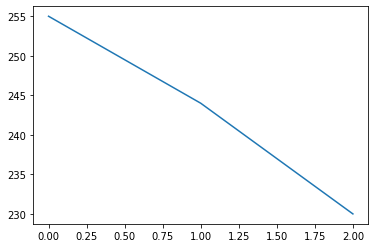

TuBu3 3


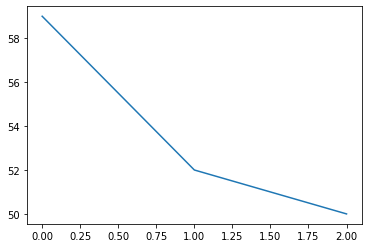

MC65 3


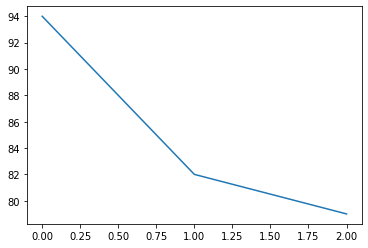

AVL01z_b_pct 3


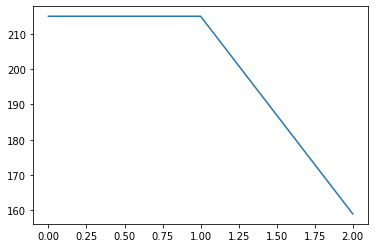

AVL01z_d_pct 3


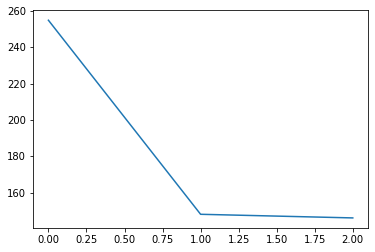

AVL09p_pct 3


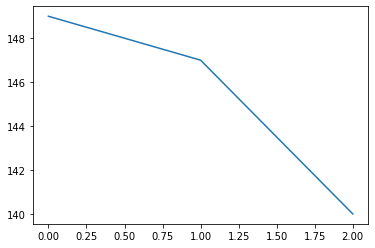

PVM06b_d_pct 3


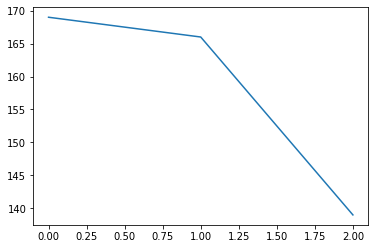

AVM09h_a_pct 3


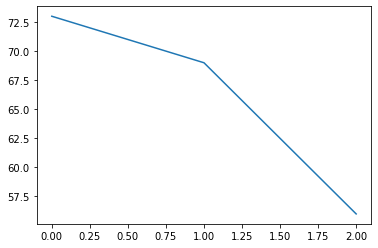

AVL01lj_pct 3


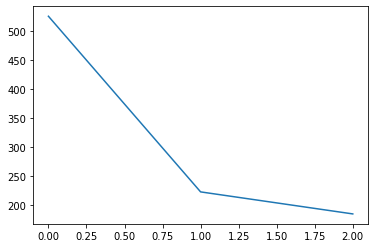

PVM06n_b_pct 3


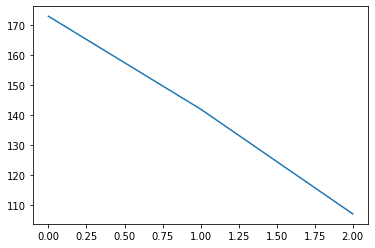

PVL11d_pct 3


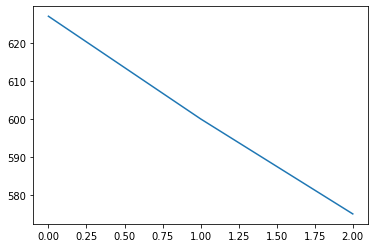

AVL02w_pct 3


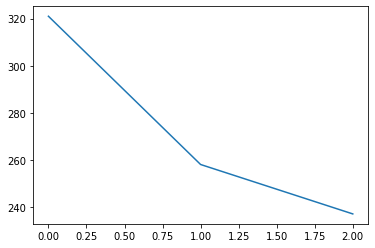

PVL10s_b_pct 3


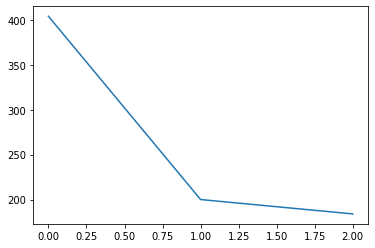

PVL05v_pct 3


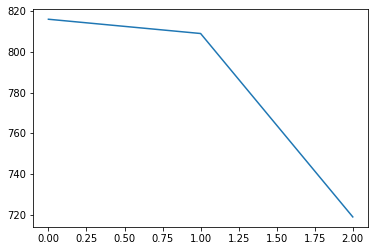

PVM02op_pct 3


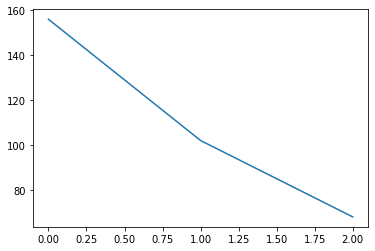

PVM02ob_pct 3


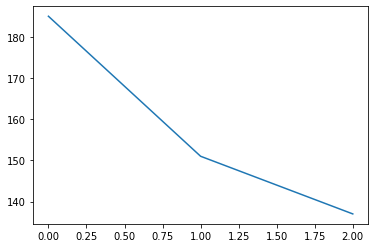

PVL05p_pct 3


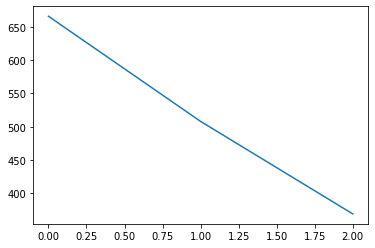

AVL03q_pct 3


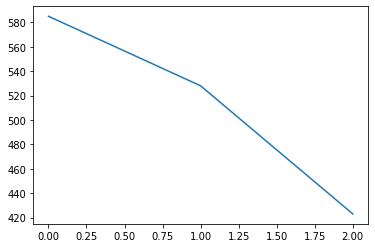

ADM01b_pct 3


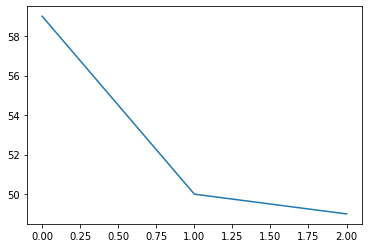

AVL05oq_pct 3


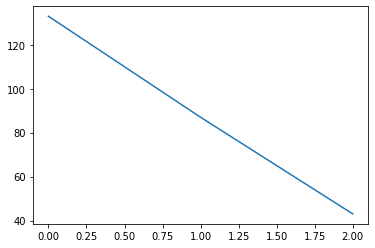

AVL10oq_pct 3


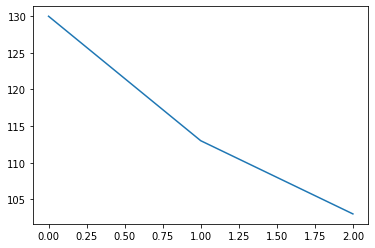

PVL07s_pct 3


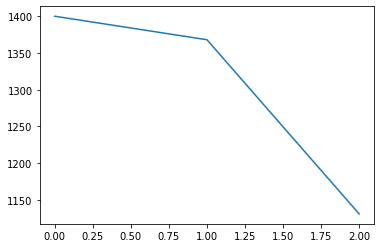

PVL10q_b_pct 3


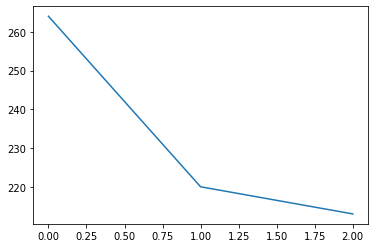

PVM03e_pct 3


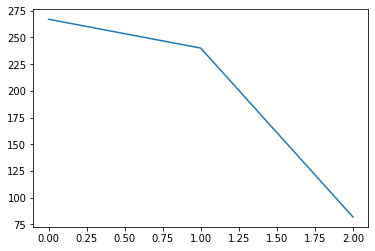

PVM13b_pct 3


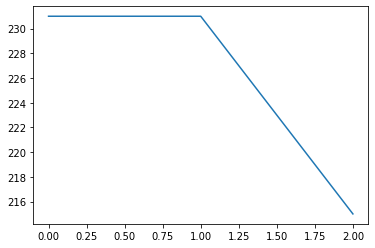

AVL01od_pct 3


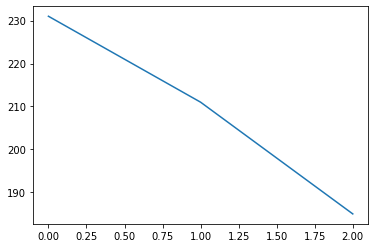

PDM14a_c_pct 3


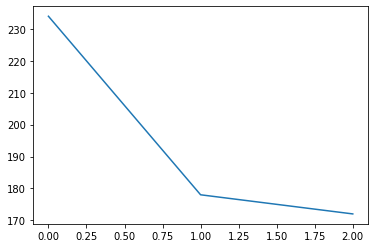

PVM08i_a_pct 3


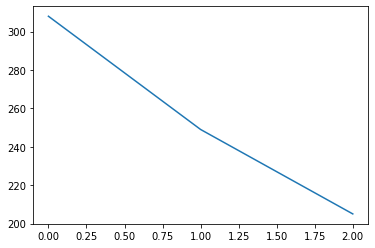

ADM01y_b_pct 3


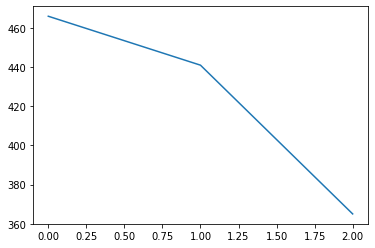

ADL14r_pct 3


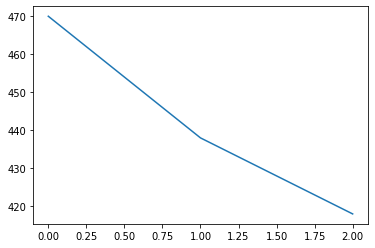

AVL05ot_pct 3


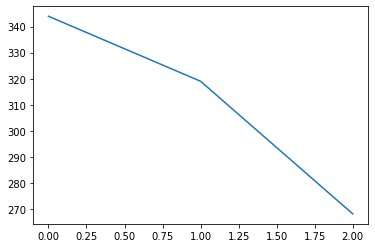

PVL04g_a_pct 3


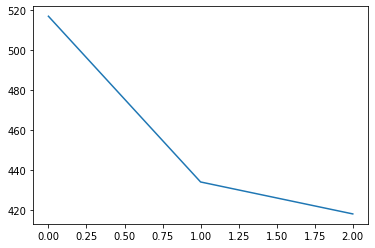

PVL09n_a_pct 3


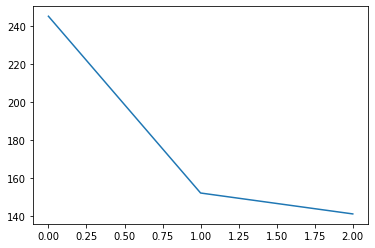

PVL10y_a_pct 3


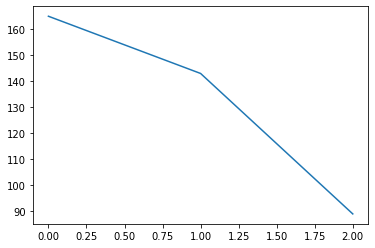

AVL10d_pct 3


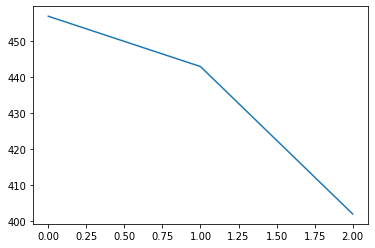

AVL02f_a_pct 3


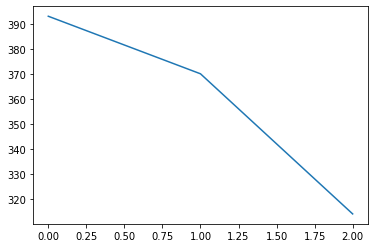

AVM08d_pct 3


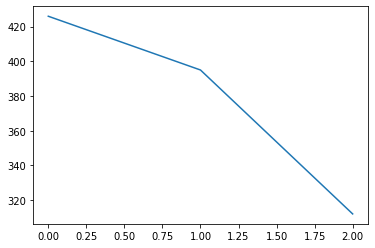

PVL05i_pct 3


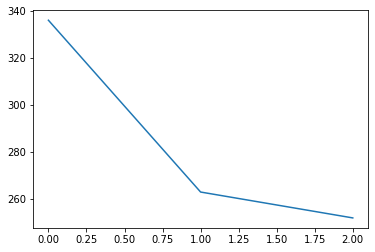

PVM01os_pct 3


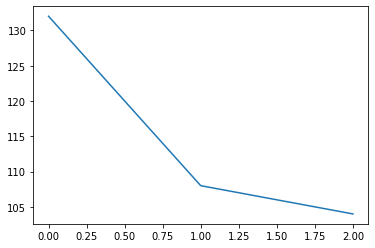

PVL05od_pct 3


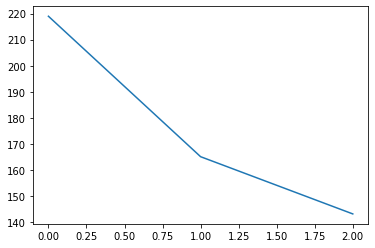

AVL19f_pct 3


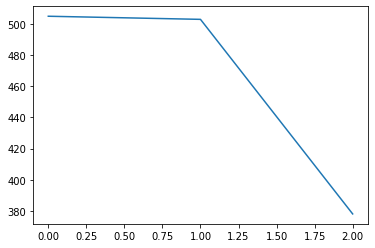

PVL08u_pct 3


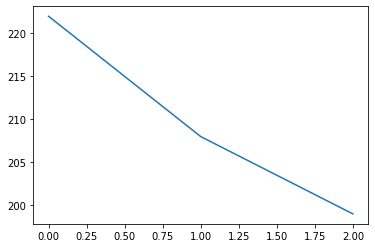

AVL03oj_pct 3


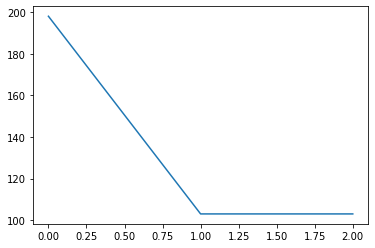

ADM06n_a_pct 3


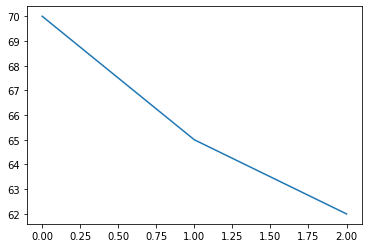

AVL09n_pct 3


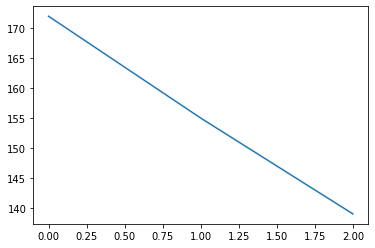

AVL01lu_pct 3


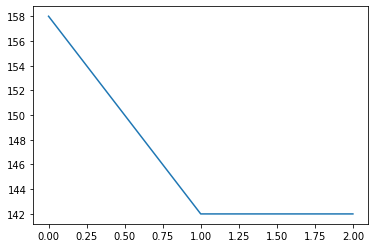

AVL04v_e_pct 3


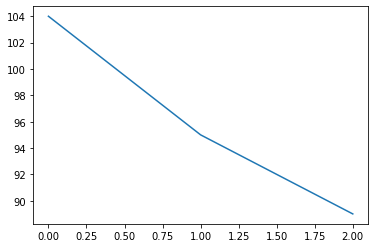

PVM06b_b_pct 3


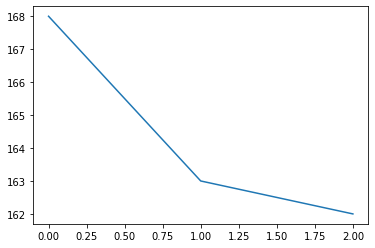

ADM06b_b_pct 3


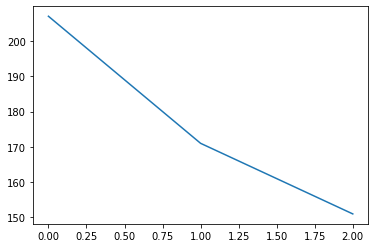

PVM07m_pct 3


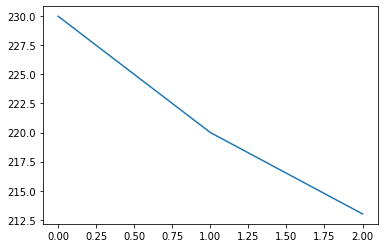

AVL01lv_pct 3


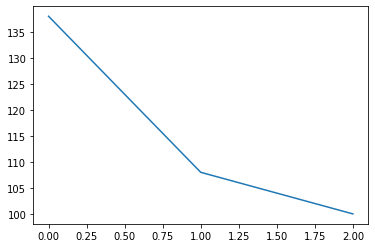

ADL06c_pct 3


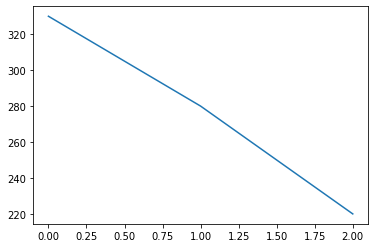

AVL11g_pct 3


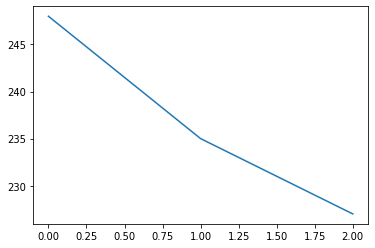

AVL18z_pct 3


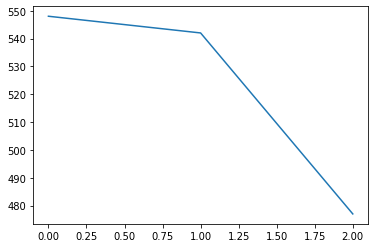

PVL08r_pct 3


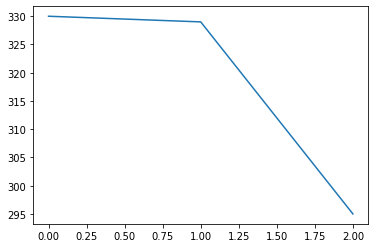

AVL01os_pct 3


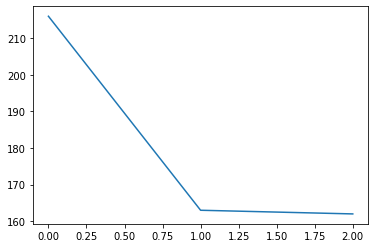

AVL15k_pct 3


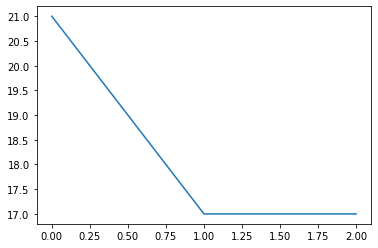

AVL01on_pct 3


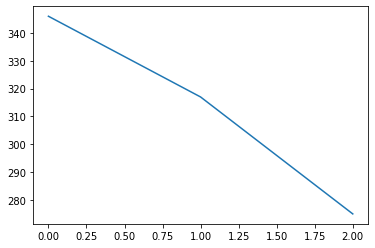

PVM04oa_pct 3


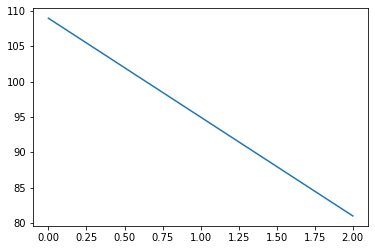

ADM06g_a_pct 3


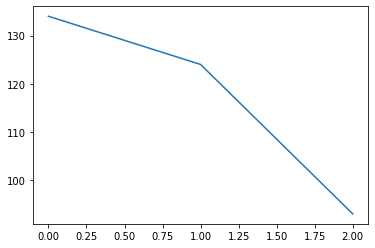

AVL01y_pct 3


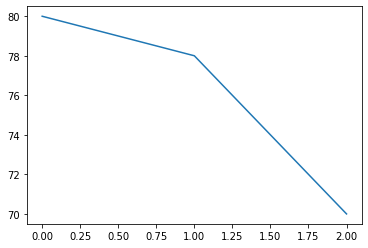

PVM06g_a_pct 3


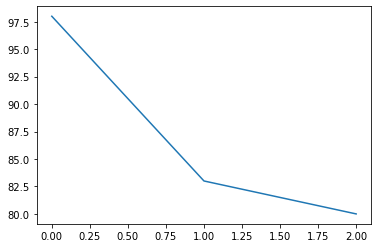

PVL03e_pct 3


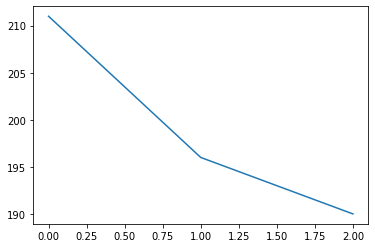

AVL15g_pct 3


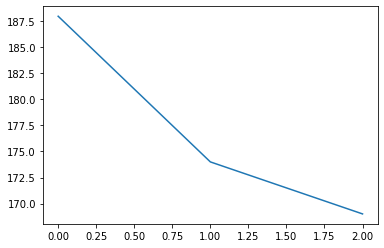

ADM06g_c_pct 3


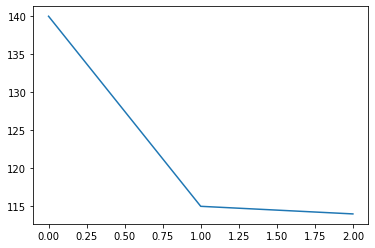

AVL15e_pct 3


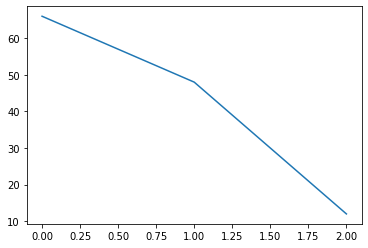

AVL15m_pct 3


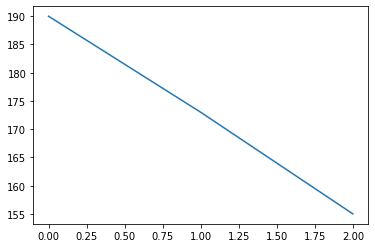

AVM08of_pct 3


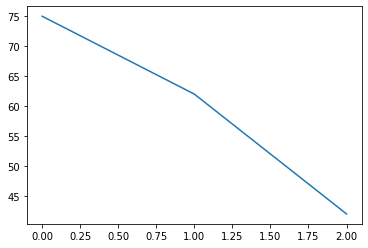

AVL11w_pct 3


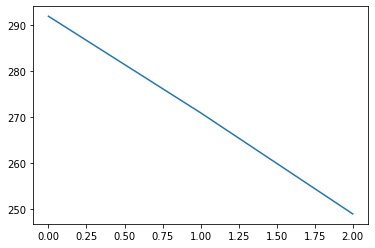

PVL05ld_pct 3


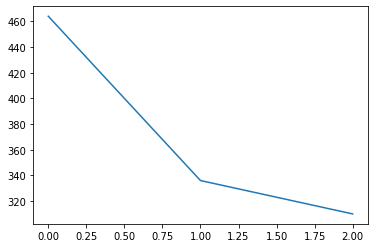

AVM14z_a_pct 3


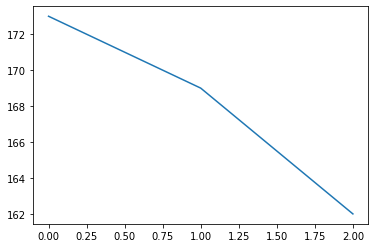

AVM09h_c_pct 3


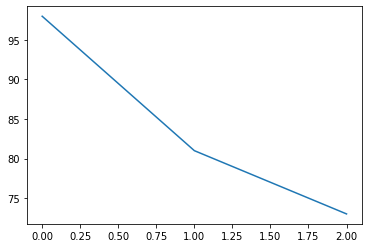

AVL04r_pct 3


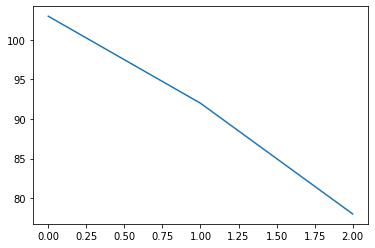

ADM01g_pct 3


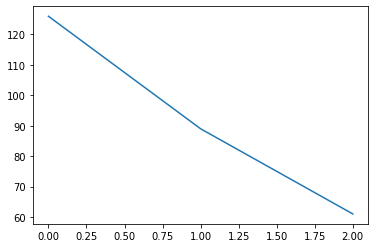

AVM11d_c_pct 3


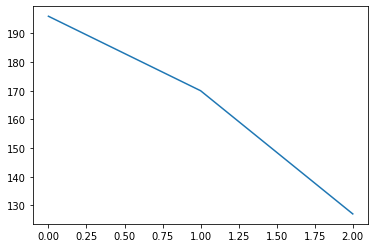

PVM03v_pct 3


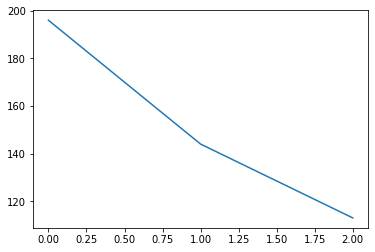

AVL24e_pct 3


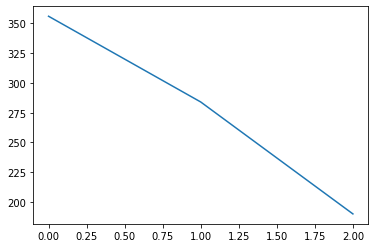

AVM08e_b_pct 3


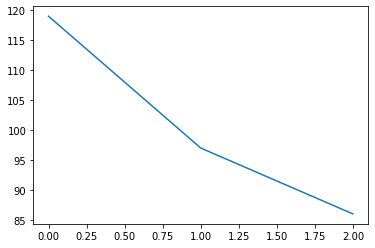

AVM09g_b_pct 3


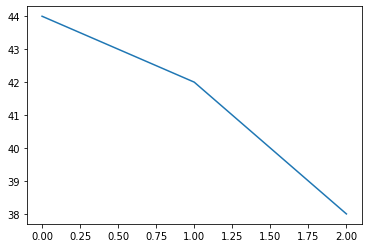

AVL04v_d_pct 3


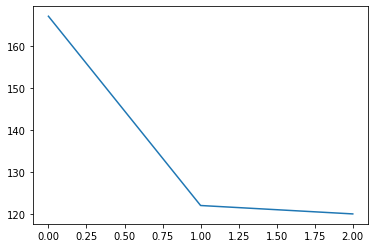

AVM14x_pct 3


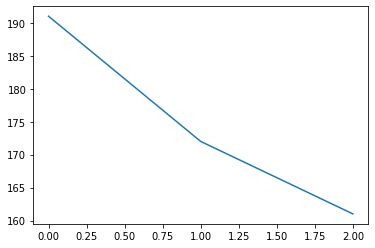

AVM14z_b_pct 3


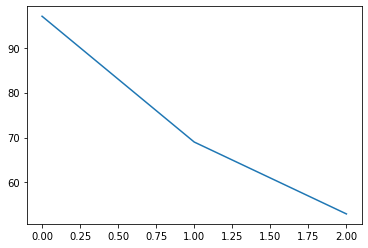

PVL06oe_pct 3


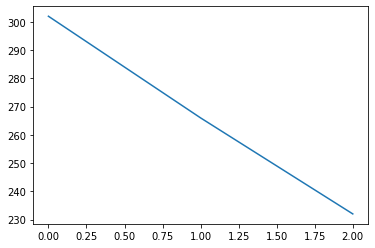

AVM14u_a_pct 3


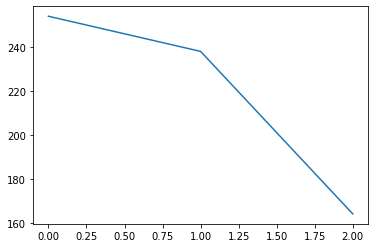

AVL14r_b_pct 3


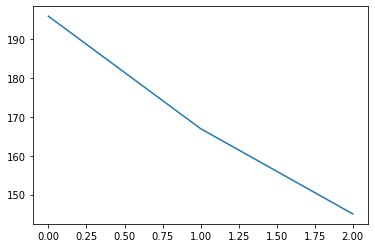

AVM12b_pct 3


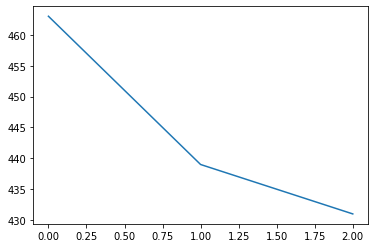

AVL16n_pct 3


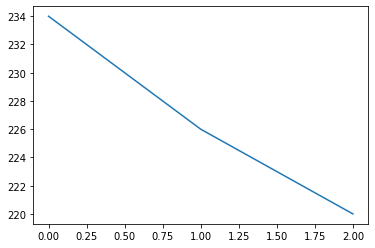

AVM11h_pct 3


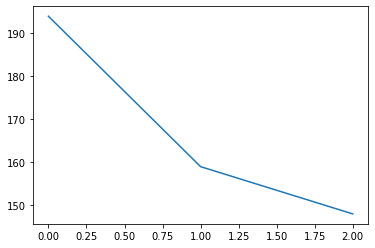

PDM14c_pct 3


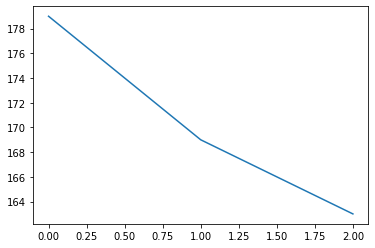

AVL14k_pct 3


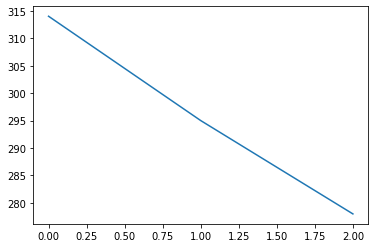

AVL10op_pct 3


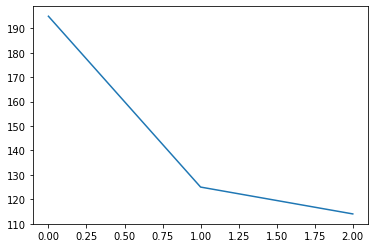

AVL15h_a_pct 3


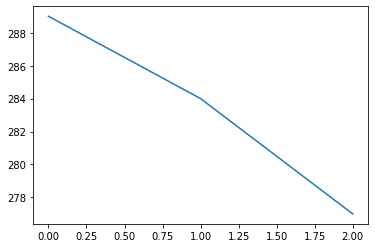

AVL15i_pct 3


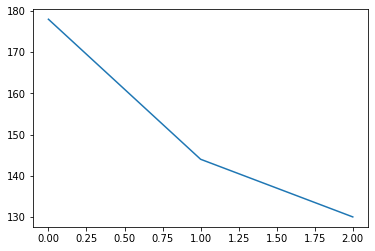

AVL10h_pct 3


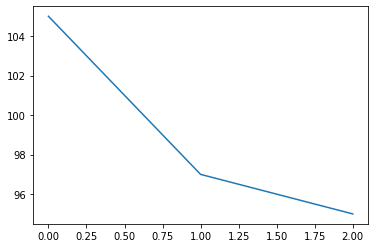

AVL17f_pct 3


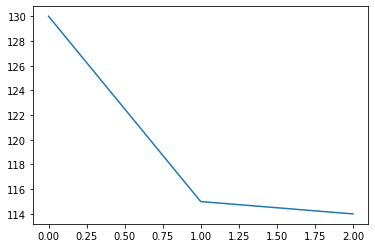

AVL15b_pct 3


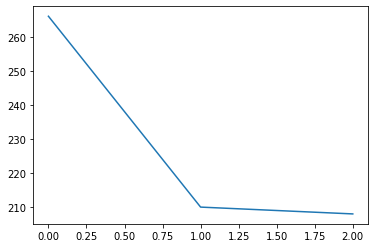

PVL05ou_pct 3


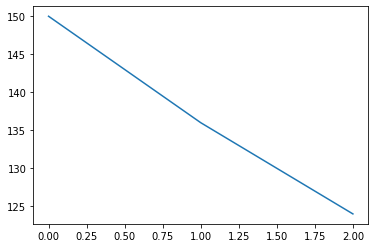

AVL05g_pct 3


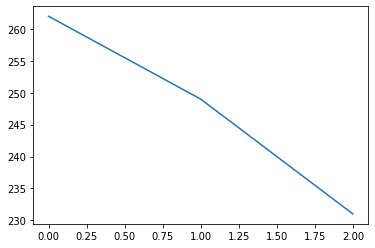

PVL07p_pct 3


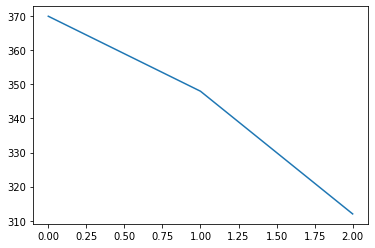

AVL08oe_pct 3


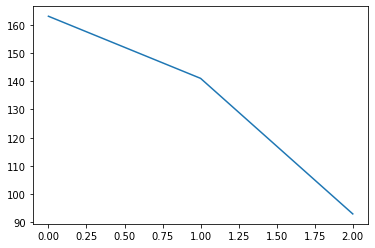

ADM03f_pct 3


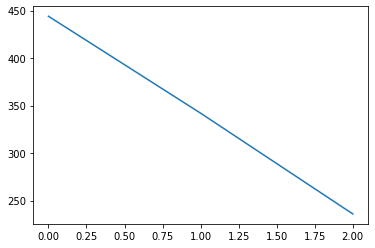

PVL05n_pct 3


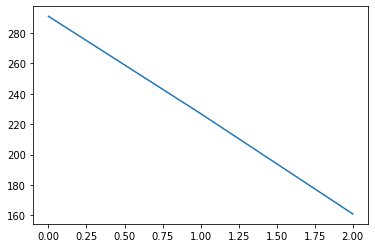

PVL15c_pct 3


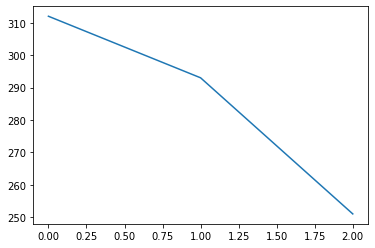

PVL04g_b_pct 3


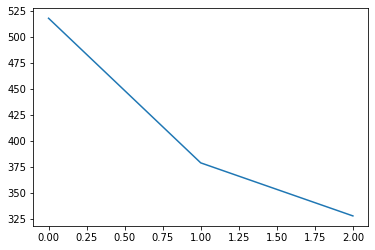

AVL02s_pct 3


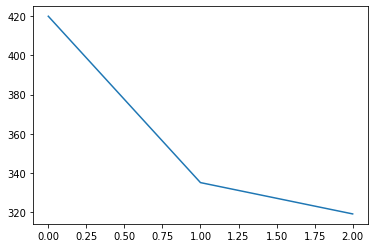

AVL11z_pct 3


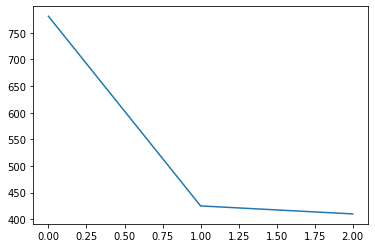

ADL06f_pct 3


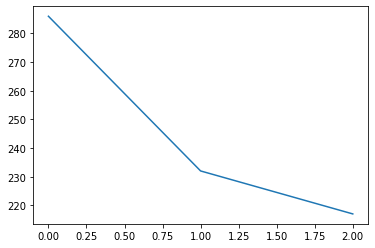

ADL06e_a_pct 3


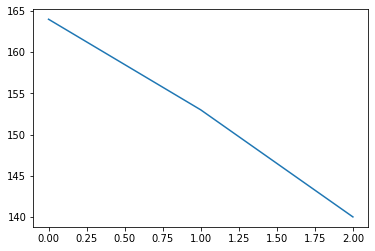

ADL06m_pct 3


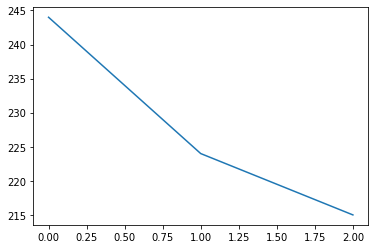

AVL13g_b_pct 3


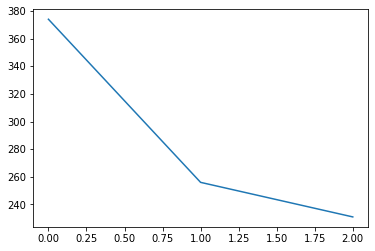

PVL07r_pct 3


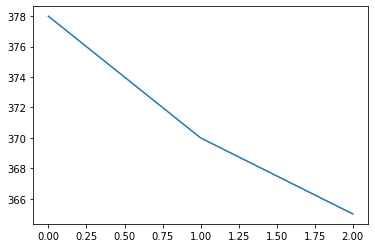

AVL13y_pct 3


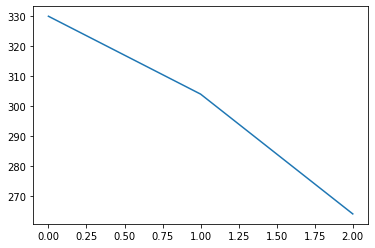

AVL05p_pct 3


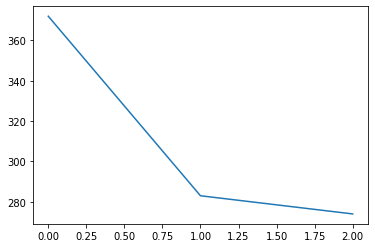

AVL13v_pct 3


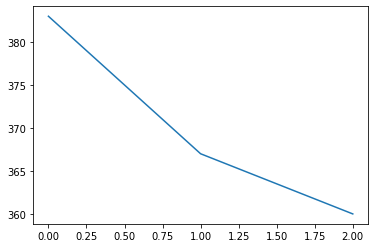

AVL26a_pct 3


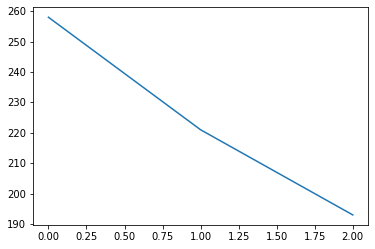

AVL14x_pct 3


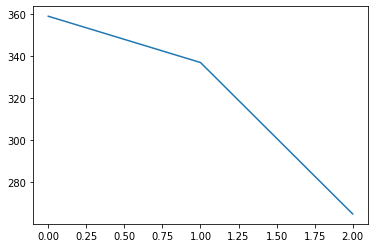

AVL11p_b_pct 3


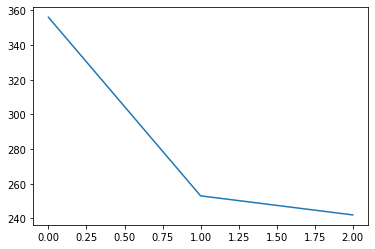

AVM11u_pct 3


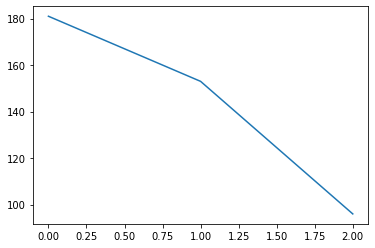

PVL10t_a_pct 3


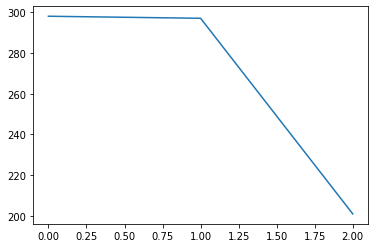

AVL09oa_pct 3


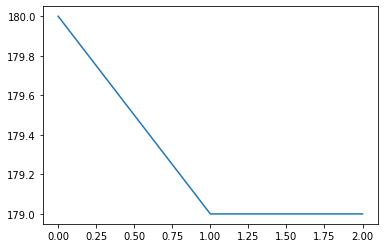

AVL04or_pct 3


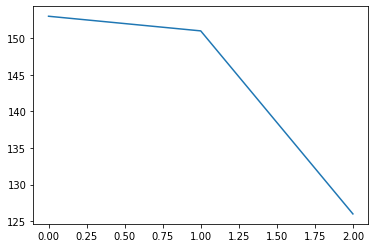

AVL21g_b_pct 3


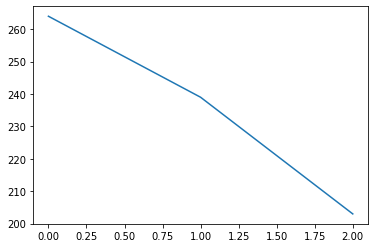

AVL04h_pct 3


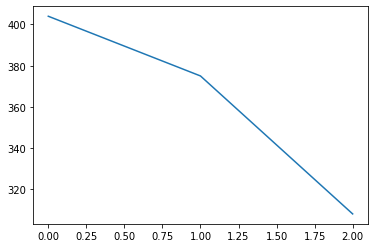

PVM08e_pct 3


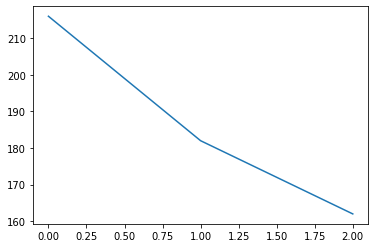

PVL09w_pct 3


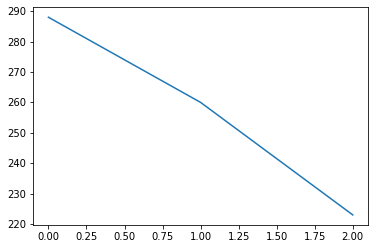

AVL05t_pct 3


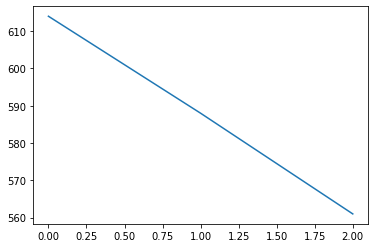

AVL13oc_pct 3


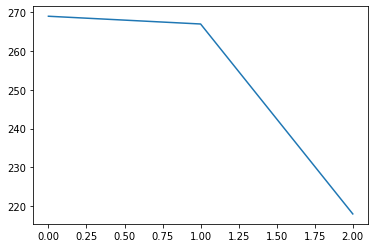

PDL09s_pct 3


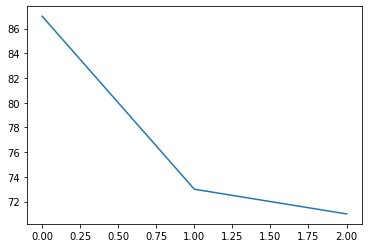

AVL19n_pct 3


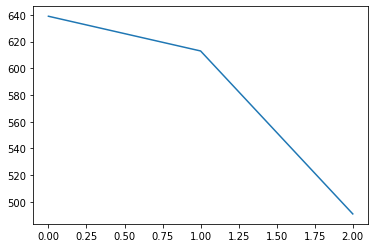

PVM04z_a_pct 3


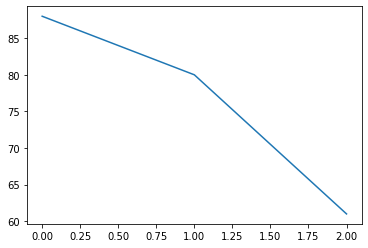

PVL10e_pct 3


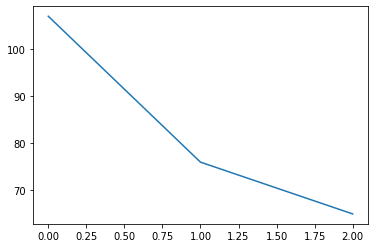

AVL18a_pct 3


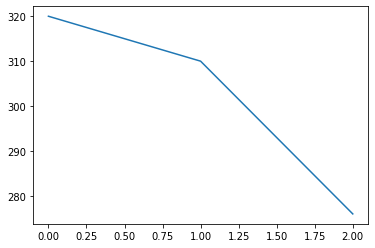

ADM03y_a_pct 3


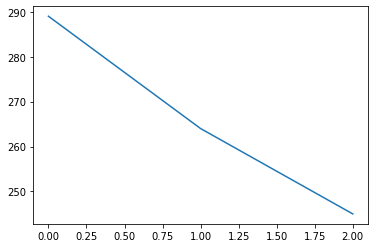

PDL12z_pct 3


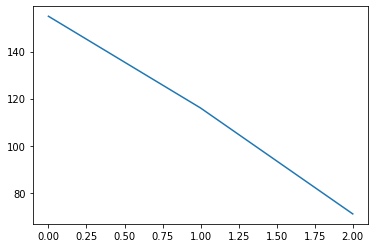

AVL02v_d_pct 3


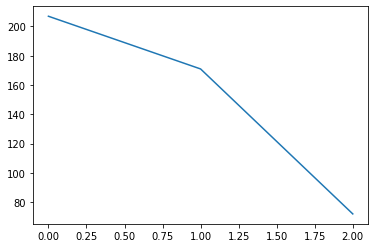

PVL06z_pct 3


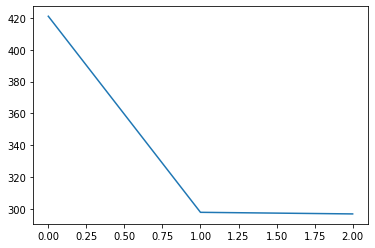

AVL05r_pct 3


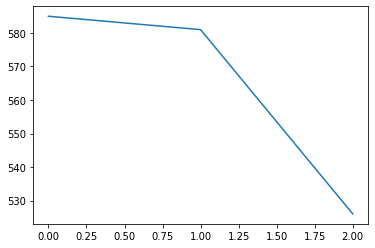

AVM11v_pct 3


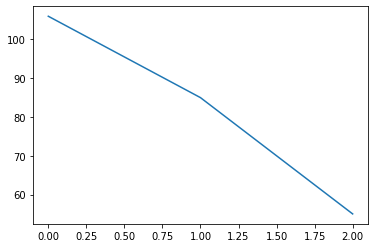

AVL01oh_pct 3


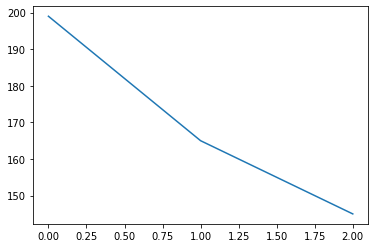

AVL07oq_pct 3


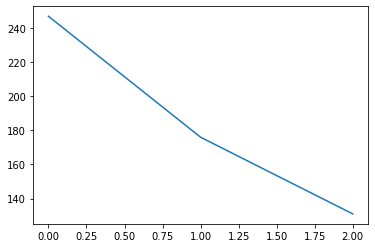

AVL11p_a_pct 3


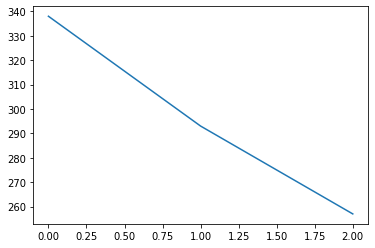

AVM08h_a_pct 3


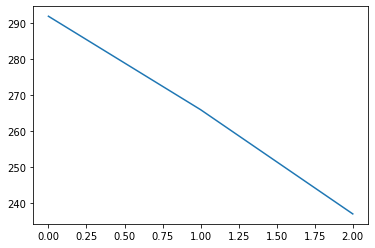

AVL10f_pct 3


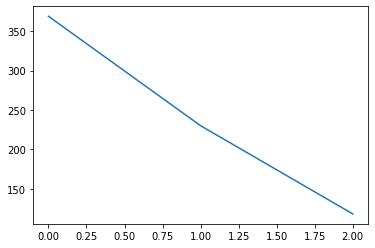

AVL05om_pct 3


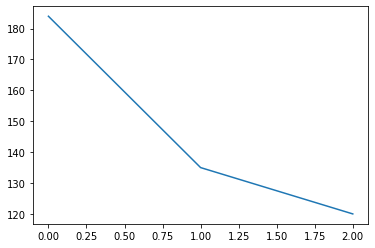

ADM03p_pct 3


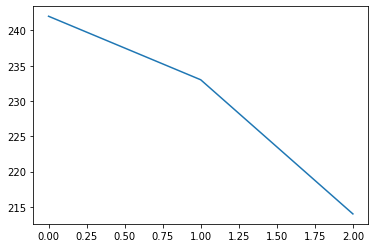

PVL11e_a_pct 3


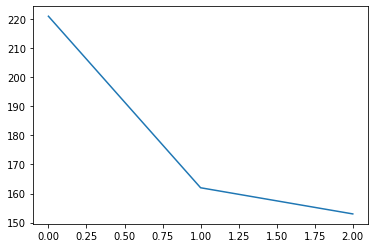

AVM17c_pct 3


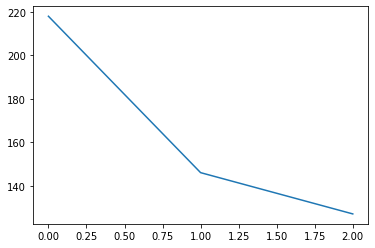

AVM09q_pct 3


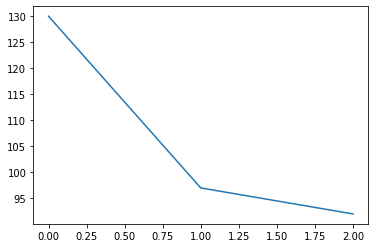

AVM12p_b_pct 3


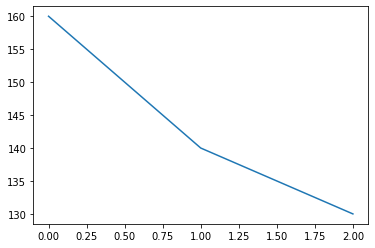

PVL05x_b_pct 3


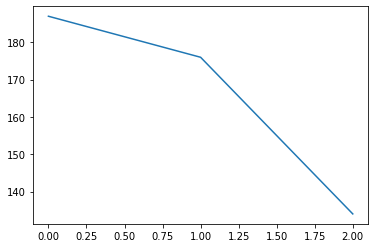

AVL03oa_pct 3


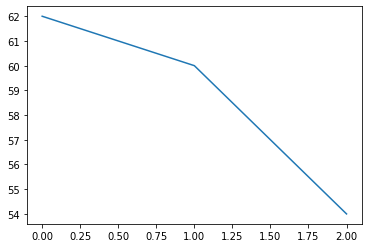

PVL11h_pct 3


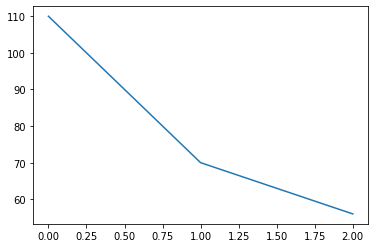

PVL12f_pct 3


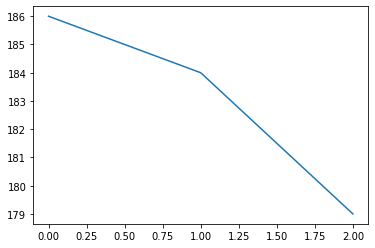

AVL05h_pct 3


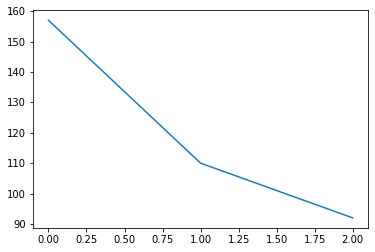

PVM04t_pct 3


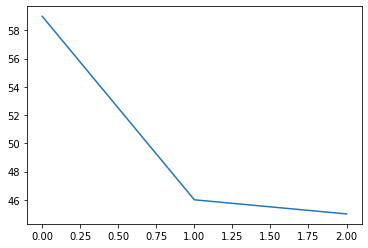

PVM02oc_pct 3


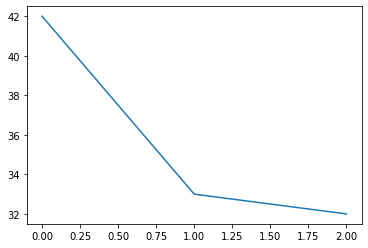

PVM02k_pct 3


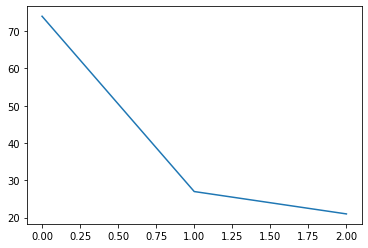

ADM03oa_pct 3


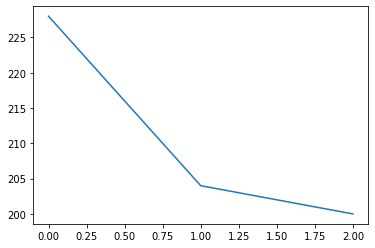

AVL01ls_pct 3


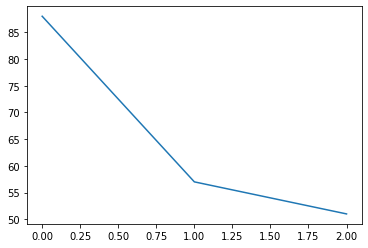

PVM07i_c_pct 3


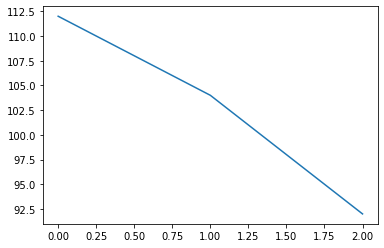

AVL01s_pct 3


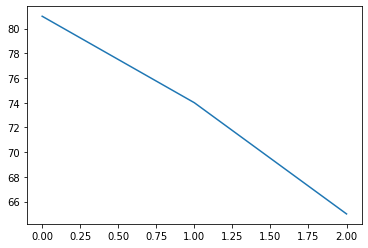

ADM06e_pct 3


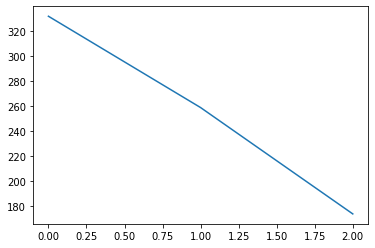

ADM03w_pct 3


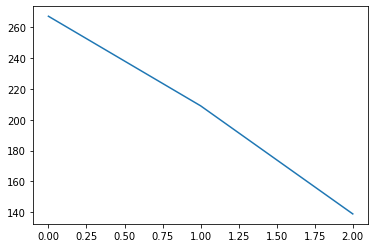

PVL12c_pct 3


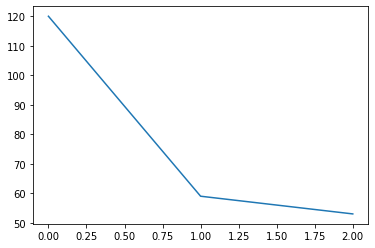

ADM06g_b_pct 3


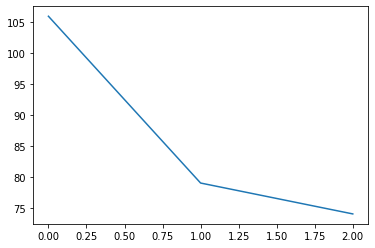

ADM03z_pct 3


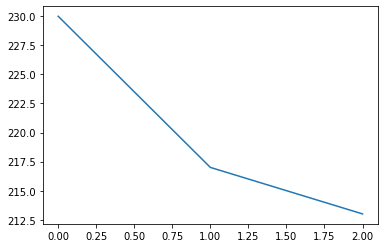

PVM05j_pct 3


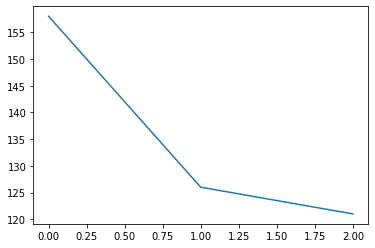

PVM07i_b_pct 3


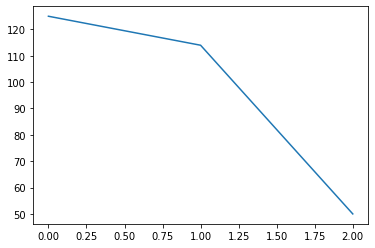

PDM14j_a_pct 3


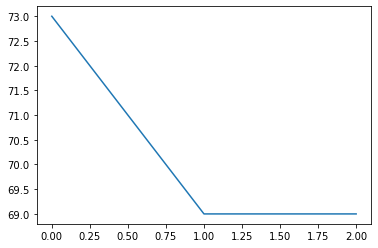

PDM14j_b_pct 3


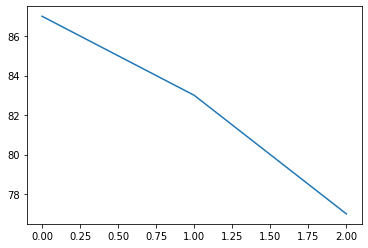

AVL14f_pct 3


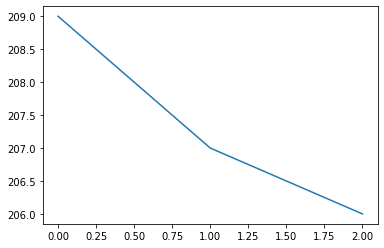

AVM12r_pct 3


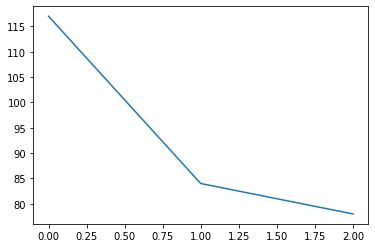

ADM06g_d_pct 3


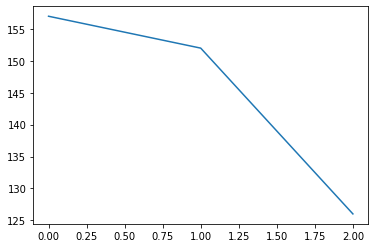

AVL21b_pct 3


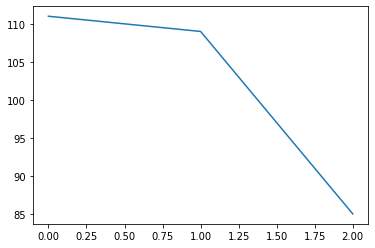

AVL14e_b_pct 3


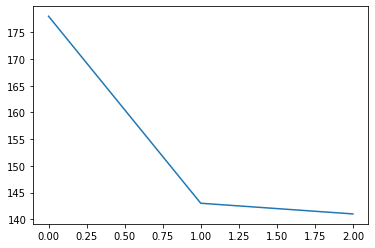

PVL07g_b_pct 3


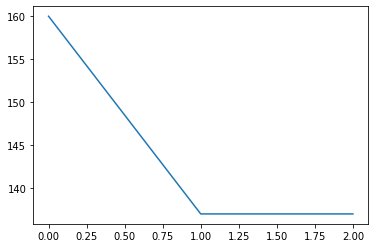

AVM09g_a_pct 3


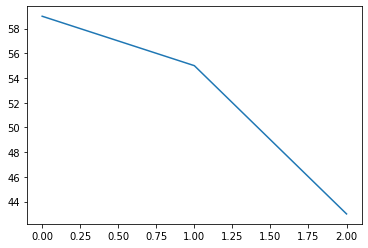

AVM09m_pct 3


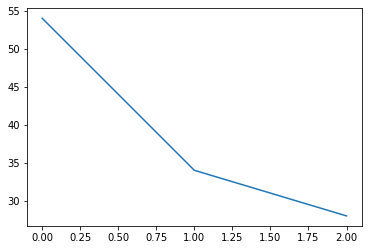

PDL17z_pct 2


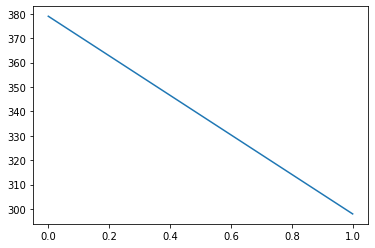

ADL02h_a_pct 2


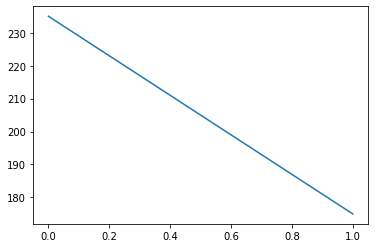

ADL04b_pct 2


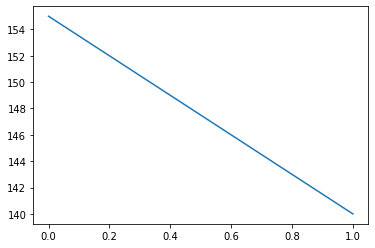

ADL09r_pct 2


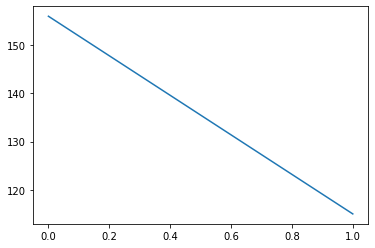

ADL04r_pct 2


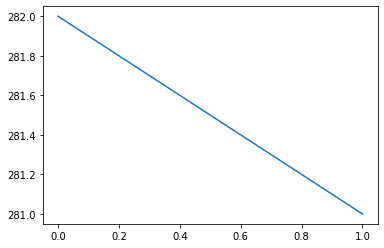

FB9B_c 2


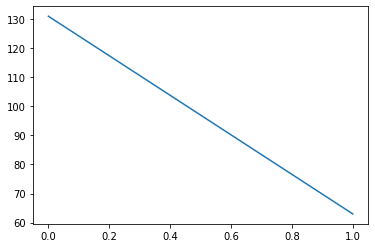

PDL17e_pct 2


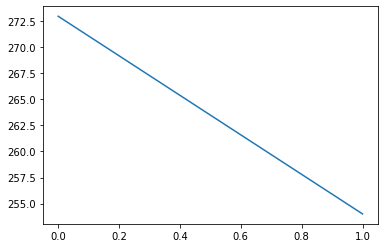

PDL17v_pct 2


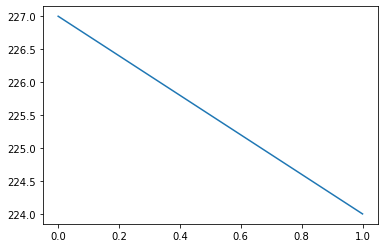

ADL07ok_pct 2


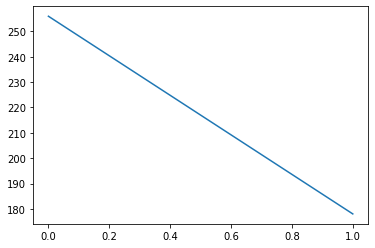

FB9B_b 2


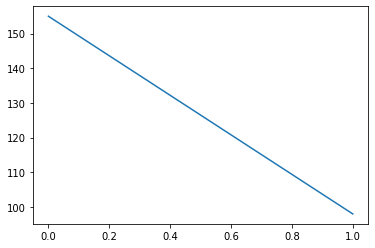

PDL05oi_pct 2


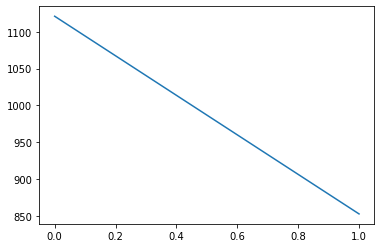

FB1G 2


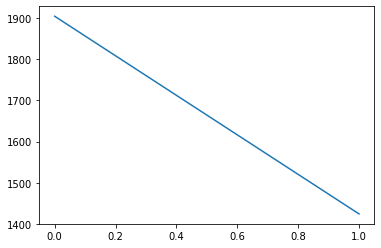

AVM03p 2


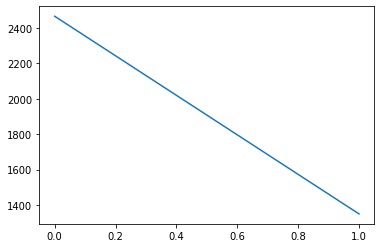

PDM09s_pct 2


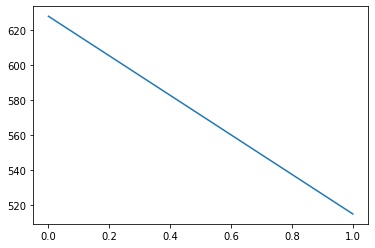

FB1F 2


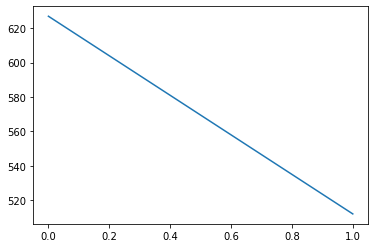

ADL15g_c_pct 2


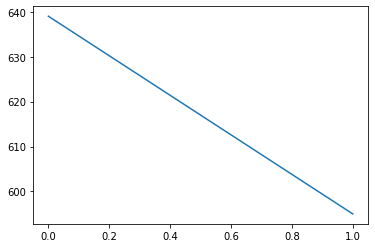

FB8E 2


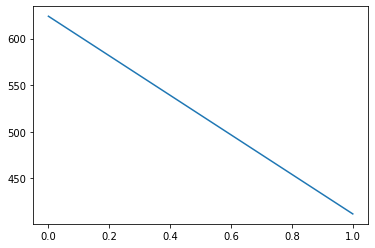

FB8D 2


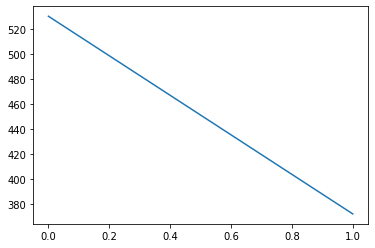

AVM07d_pct 2


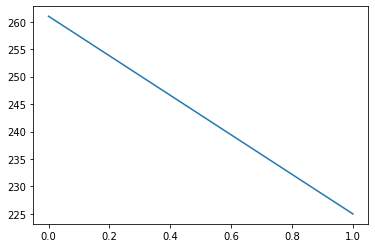

FB6O 2


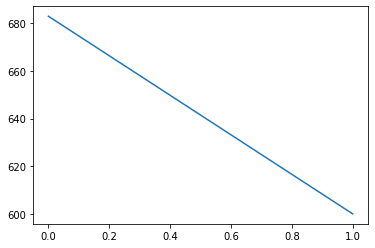

ADM04y_pct 2


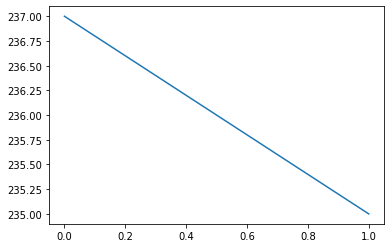

ADL07u_pct 2


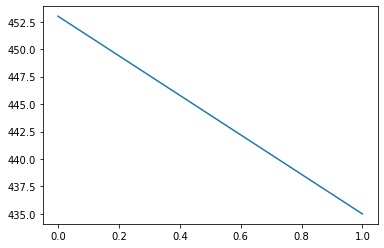

FB7K 2


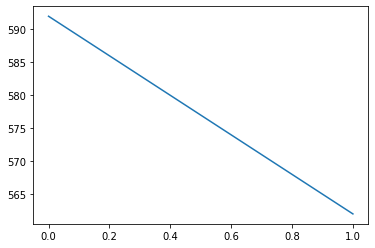

PDL11w_pct 2


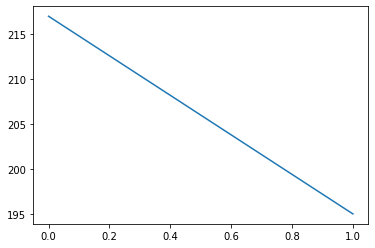

PDL05n_pct 2


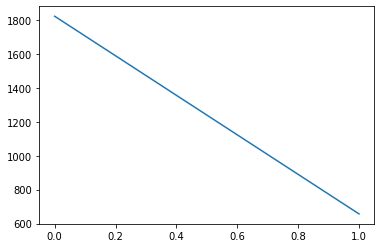

ADL02h_b_pct 2


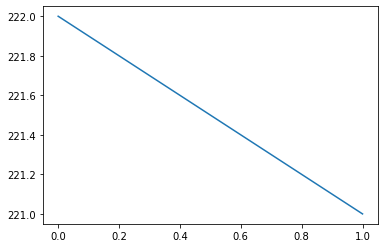

FB1J 2


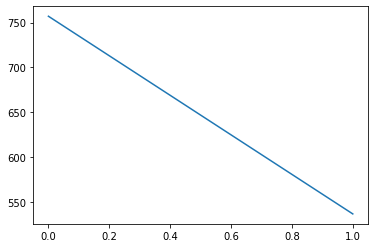

PDM05j_d_pct 2


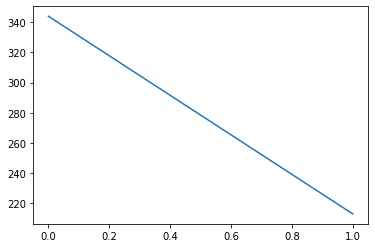

FB7D 2


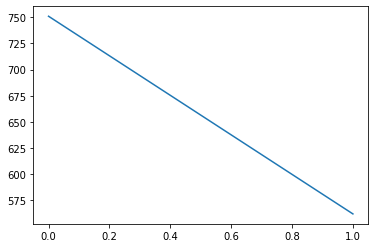

FB6C_a 2


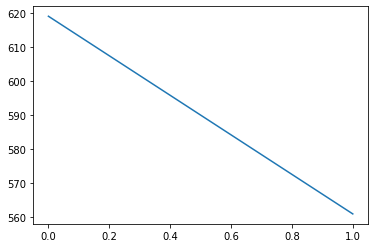

PDM18b_a_pct 2


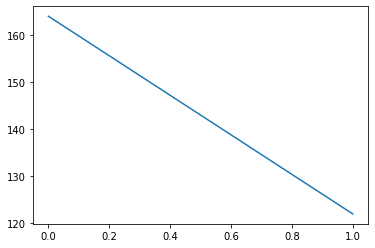

FB1E_b 2


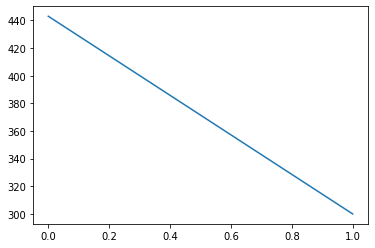

FB6Z 2


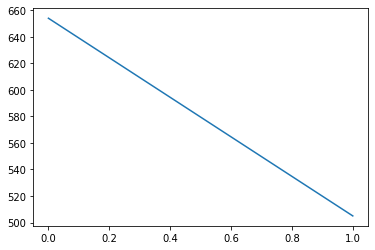

PDL23j_pct 2


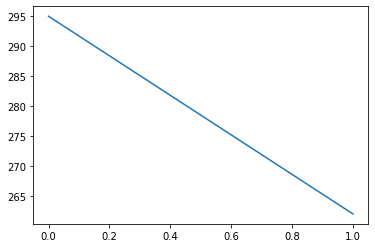

FB1I 2


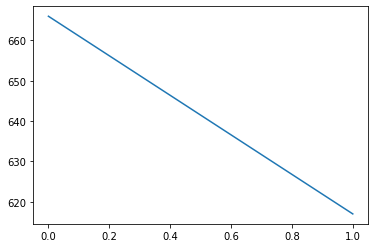

PPL105 2


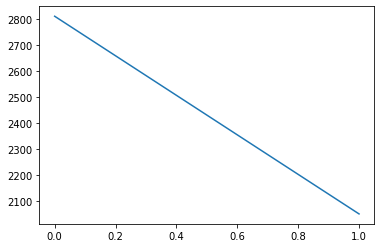

FB6F 2


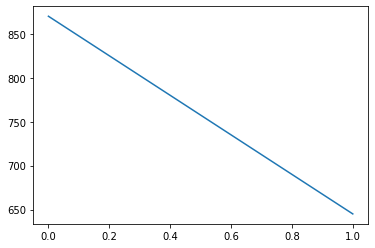

ADL23k_pct 2


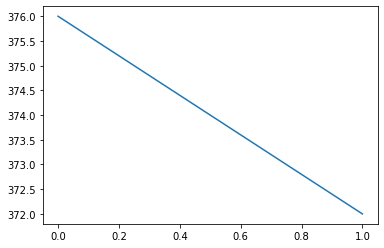

FB7B_b 2


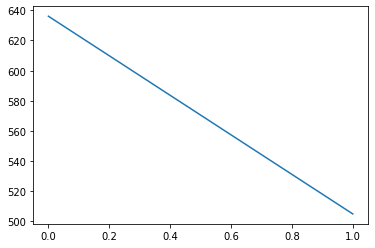

FB6H 2


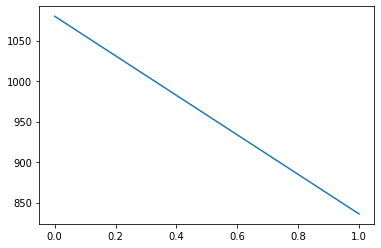

ADL04ob_pct 2


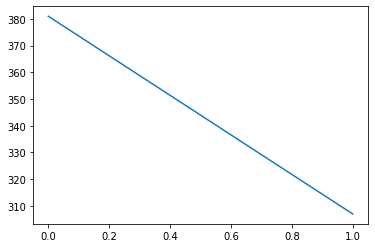

PDM20h_pct 2


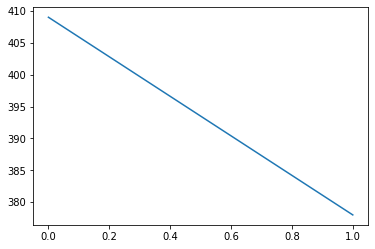

ADL20h_b_pct 2


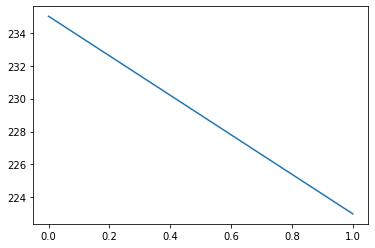

PDL08d_pct 2


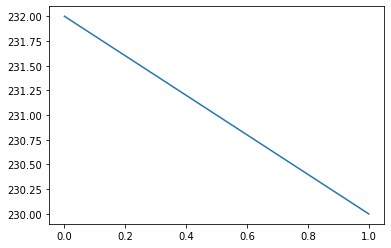

PDL17p_pct 2


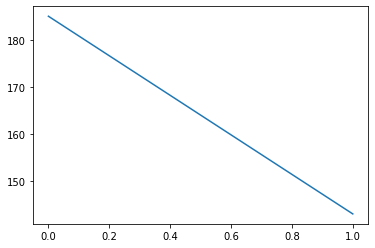

ADL02j_c_pct 2


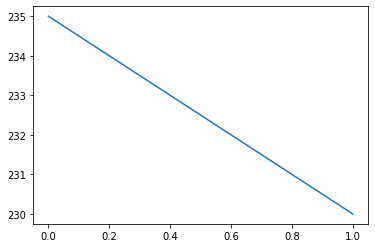

ADL02olb_pct 2


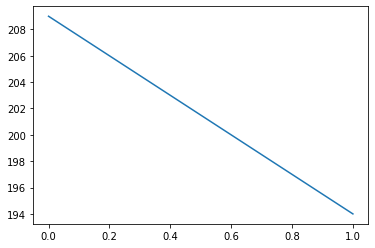

PDL15r_pct 2


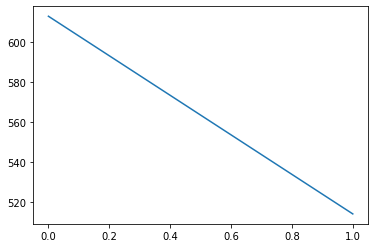

PDL25b_pct 2


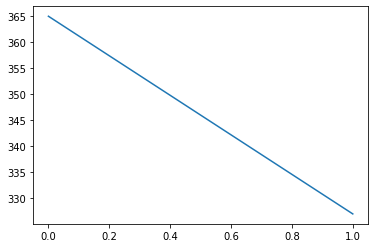

PDL16ob_pct 2


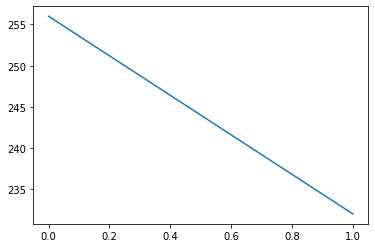

PDL13m_a_pct 2


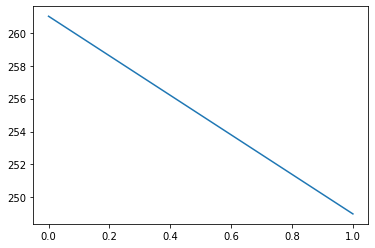

PDL16w_pct 2


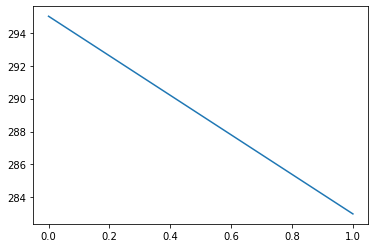

PDL16s_pct 2


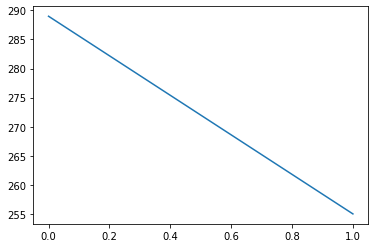

PDL20c_pct 2


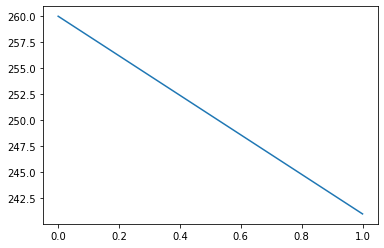

ADL07oj_pct 2


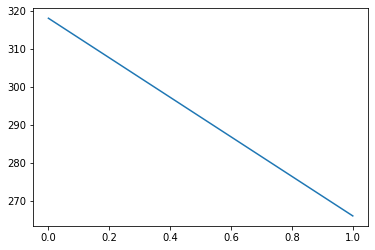

ADL16f_pct 2


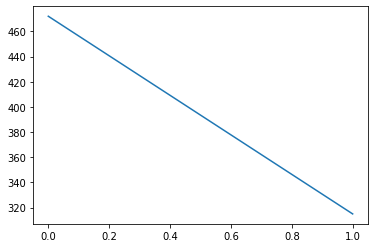

PDL20x_pct 2


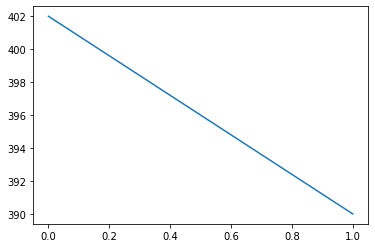

PDL17s_a_pct 2


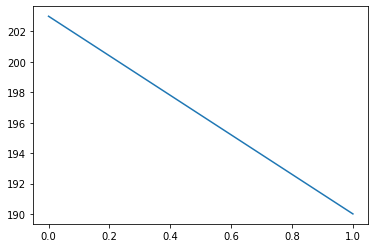

PDL11oe_pct 2


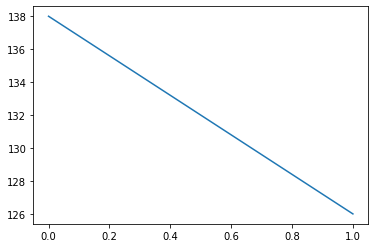

PDL11od_pct 2


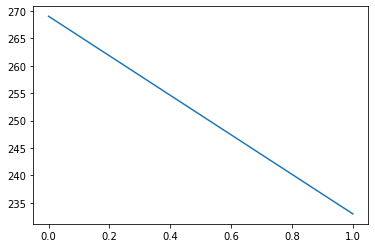

PDL26e_pct 2


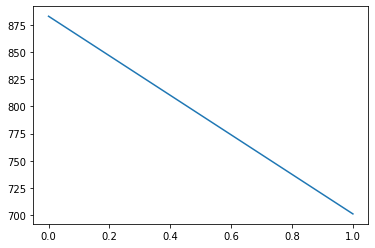

ADL11d_pct 2


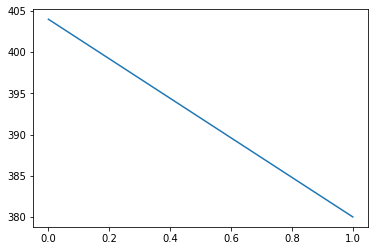

PDM15a_pct 2


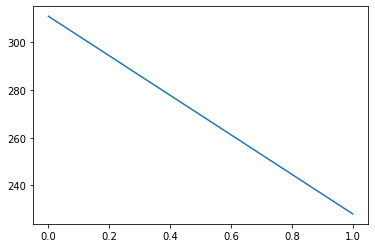

ADM01ol_pct 2


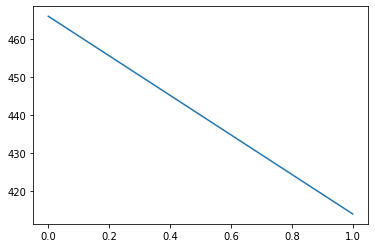

PDM08or_pct 2


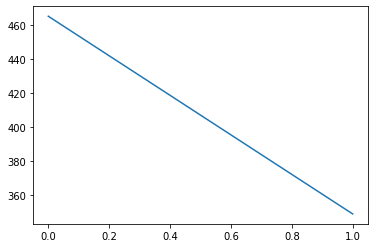

PDM20u_pct 2


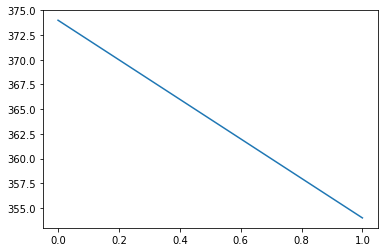

ADL20g_pct 2


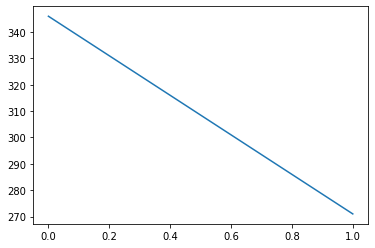

ADL09b_c_pct 2


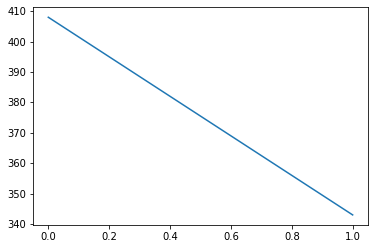

PDM09k_pct 2


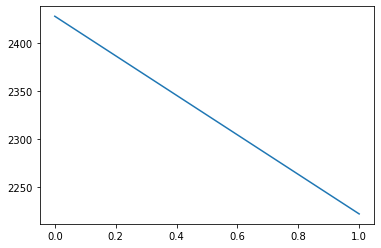

PDM07z_pct 2


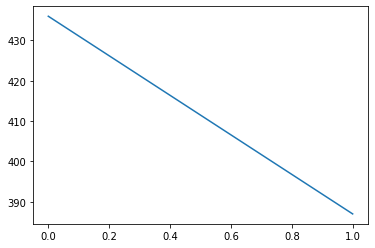

ADL03n_pct 2


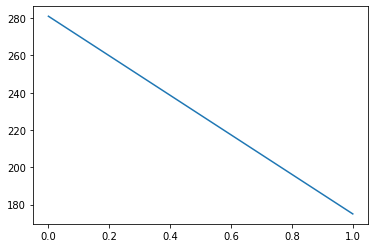

ADL03m_f_pct 2


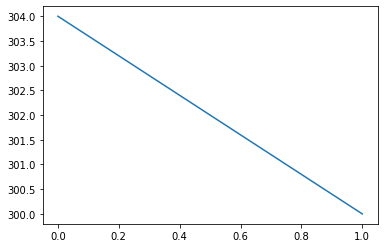

PDM07n_pct 2


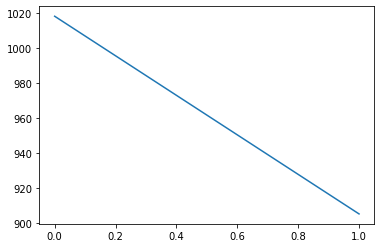

ADM04z_pct 2


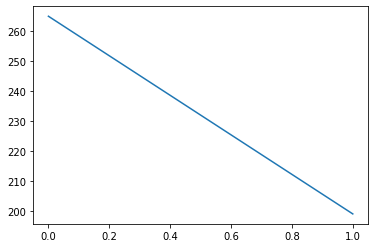

PPL106 2


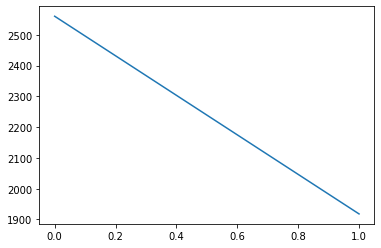

ADM04oo_pct 2


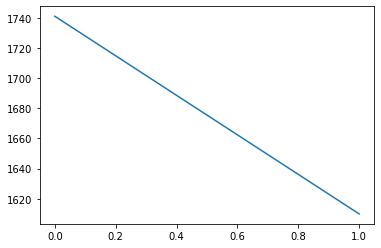

ADL16p_pct 2


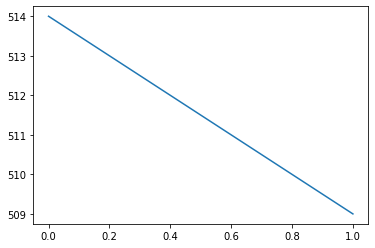

ADM07q_pct 2


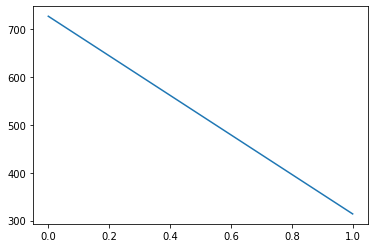

FB6G 2


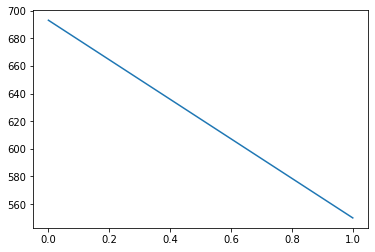

ADL03m_d_pct 2


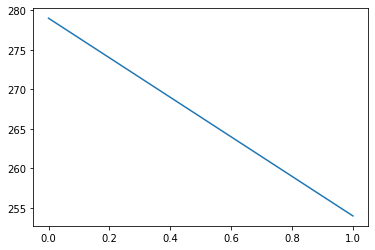

ADL02j_h_pct 2


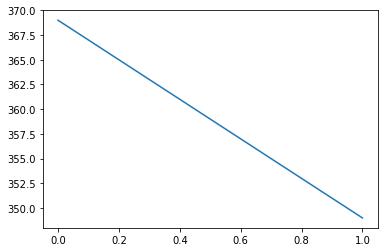

ADL02j_f_pct 2


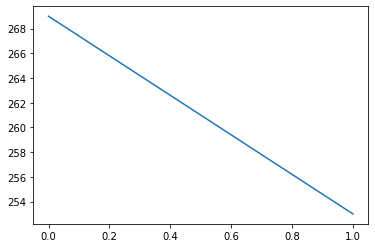

PPL101 2


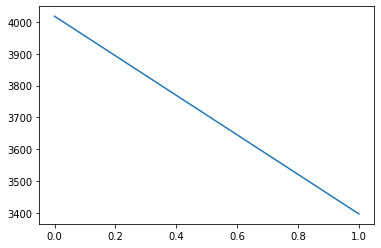

AVM08oc_pct 2


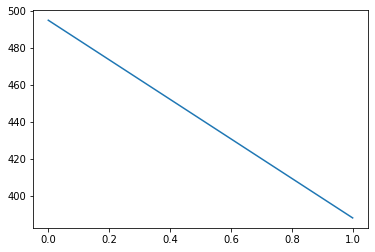

PDL10g_j_pct 2


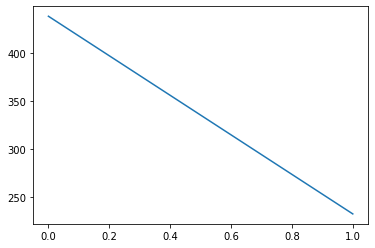

LCNpm 2


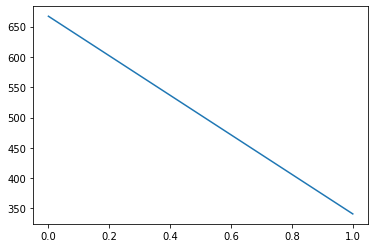

PDL05f_pct 2


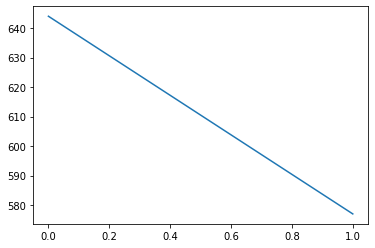

PDL11t_pct 2


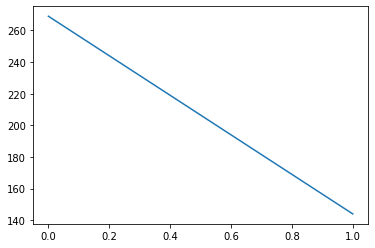

PDM18a_c_pct 2


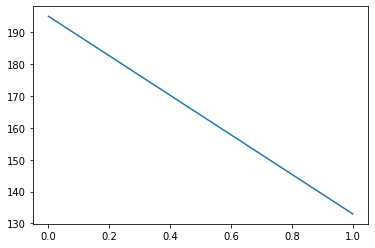

PDL23b_pct 2


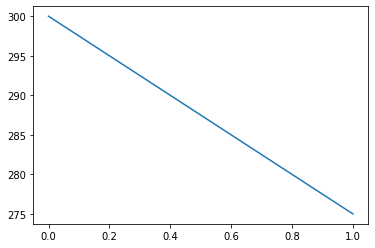

ADL17g_a_pct 2


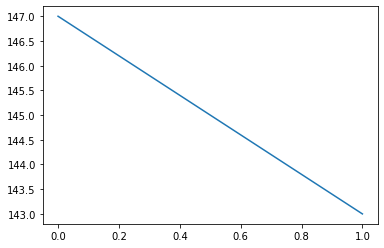

VM3 adPN 2


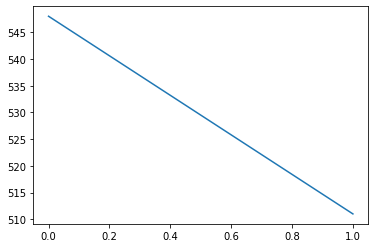

ADL04f_pct 2


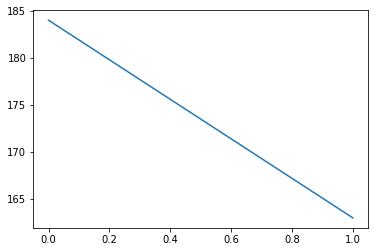

PDL10g_c_pct 2


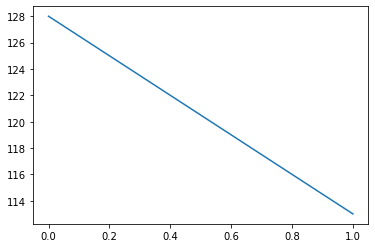

ADL11j_b_pct 2


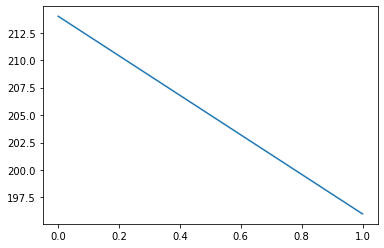

PDL11oj_pct 2


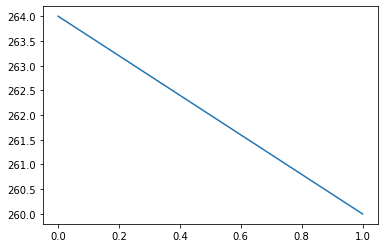

ADL04y_pct 2


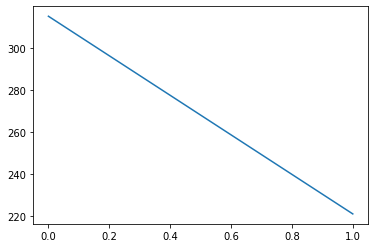

PVL11z_pct 2


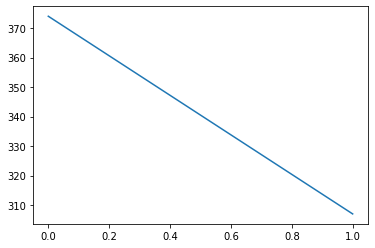

PDL11m_pct 2


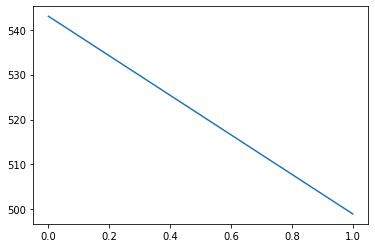

ADL05k_pct 2


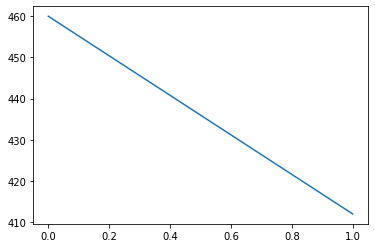

PVL17m_pct 2


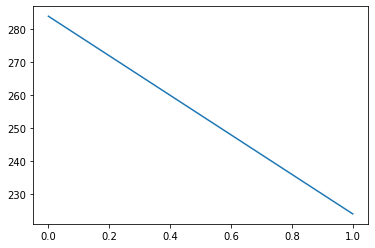

PDL13i_pct 2


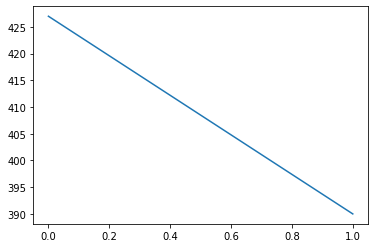

PVL04j_pct 2


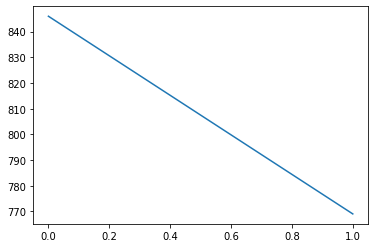

PDL20ob_pct 2


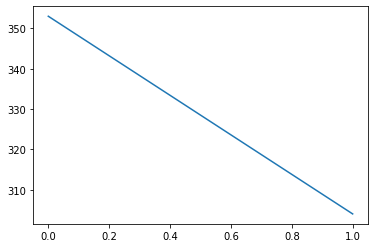

AVL08y_pct 2


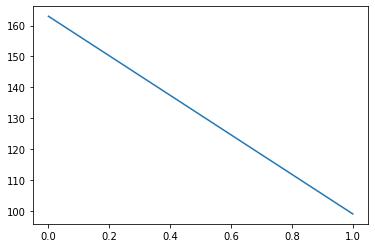

ADL02j_b_pct 2


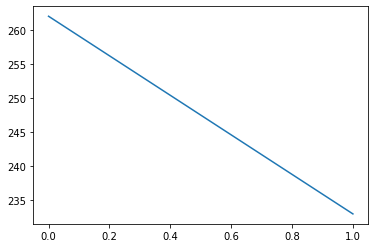

ADL03ol_pct 2


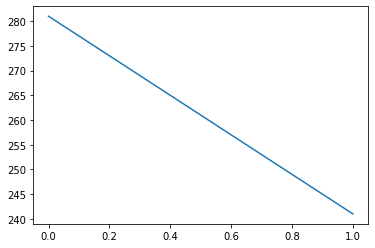

PDL08i_pct 2


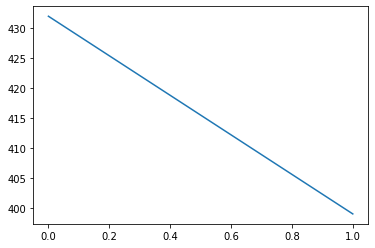

PDM13t_pct 2


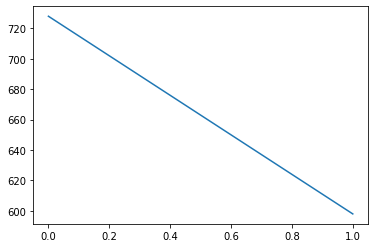

ADL23q_pct 2


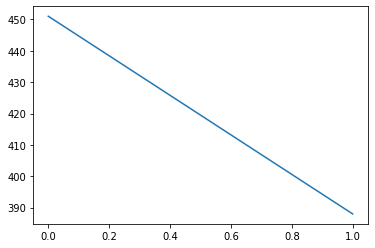

PDM13ola_pct 2


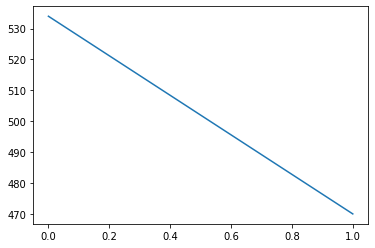

ADL03ok_pct 2


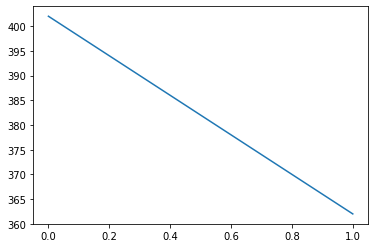

PDL13m_b_pct 2


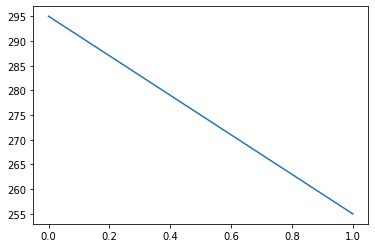

ADM04oh_pct 2


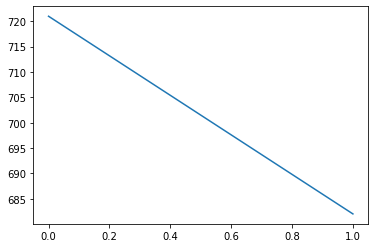

PDM10ok_pct 2


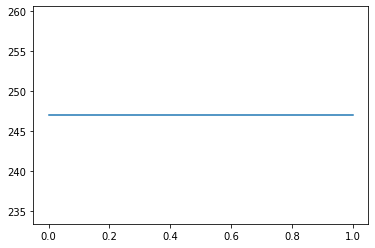

FB4C 2


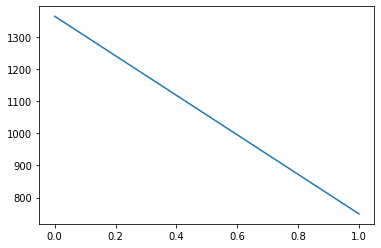

FB3E 2


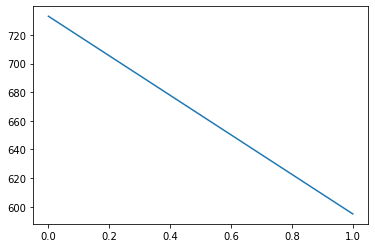

PVL04p_c_pct 2


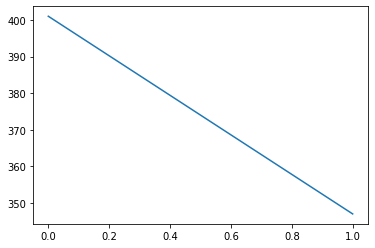

ADL25i_pct 2


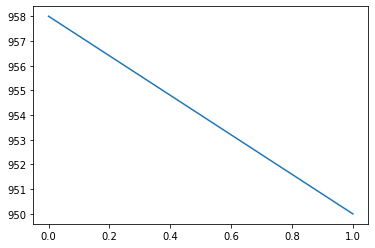

ADL17f_pct 2


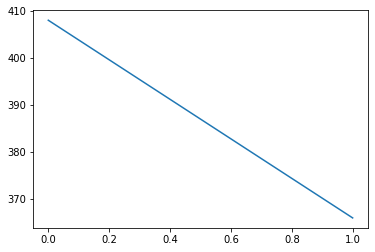

AVL08x_pct 2


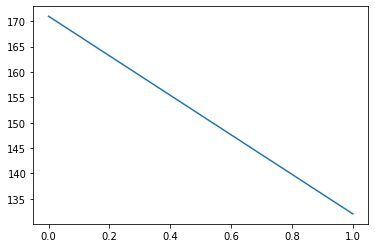

PDM10i_pct 2


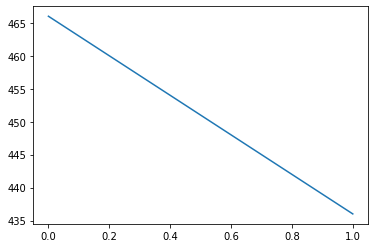

AVL01oe_pct 2


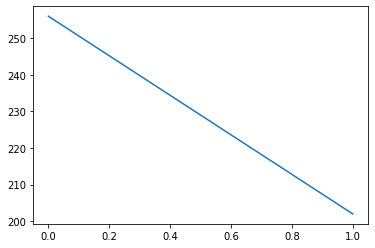

PDL21k_pct 2


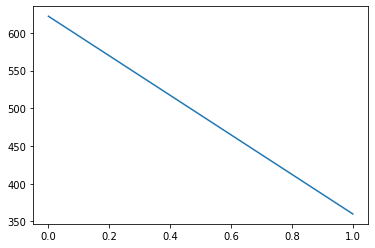

PDM27c_pct 2


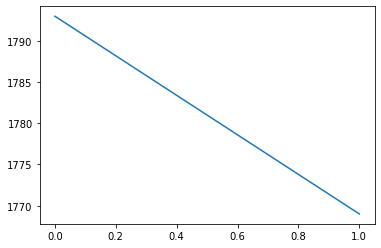

AVL08p_a_pct 2


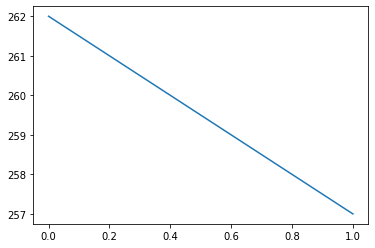

PDM09r_pct 2


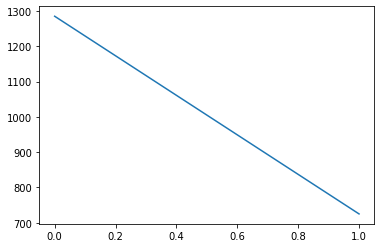

ADL12q_pct 2


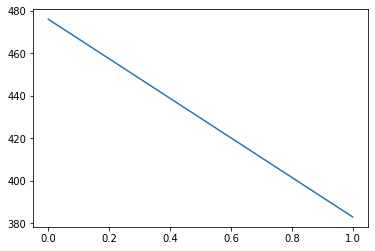

AVL18i_pct 2


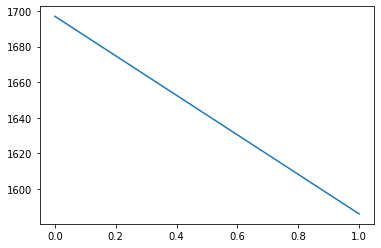

AVL03z_d_pct 2


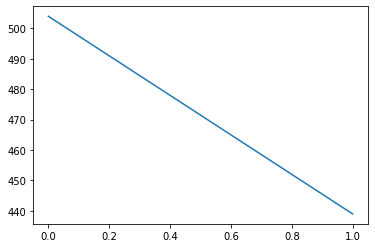

PVL13p_a_pct 2


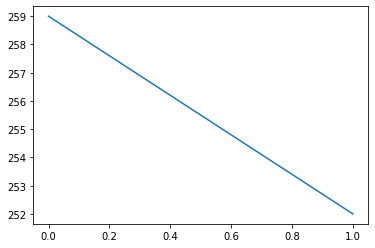

PDL14n_pct 2


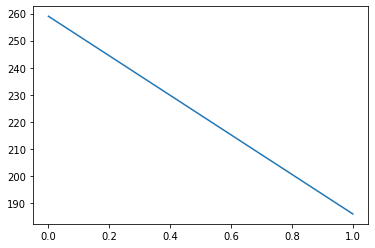

ADL27g_pct 2


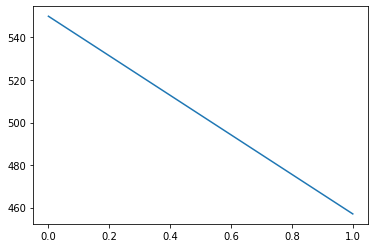

PDM09v_b_pct 2


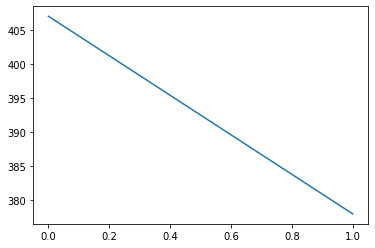

VP1l + VP3 C PN 2


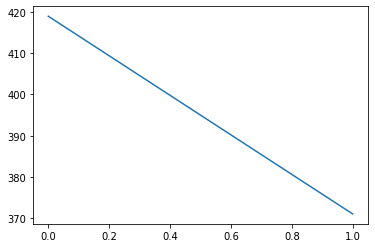

PDL11ok_pct 2


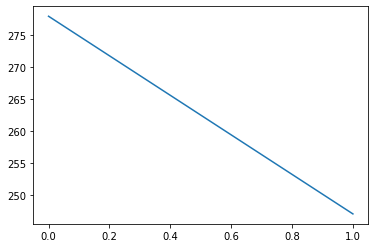

PDM12g_c_pct 2


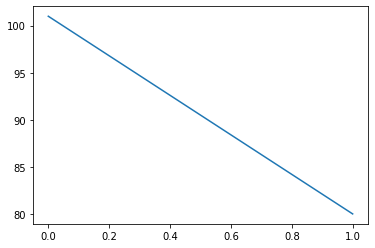

AVL08s_pct 2


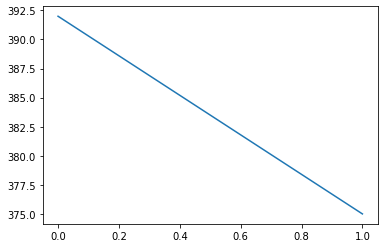

AVL08oa_pct 2


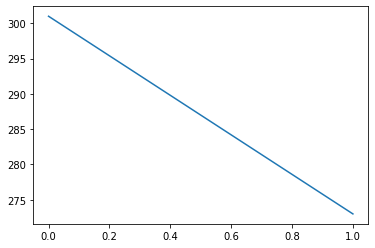

PDL25a_pct 2


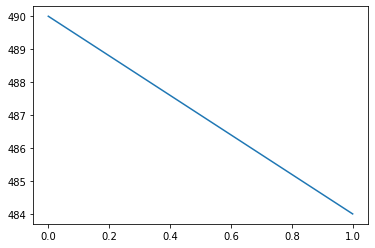

PVL06p_a_pct 2


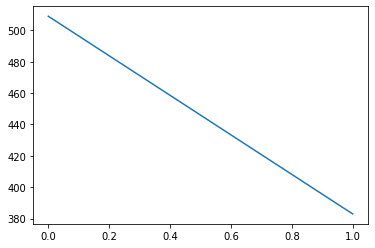

ADL10g_f_pct 2


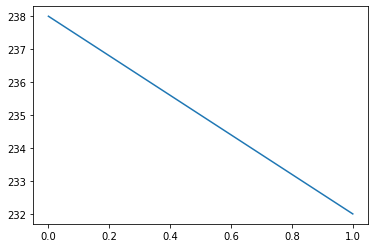

AVL02lc_pct 2


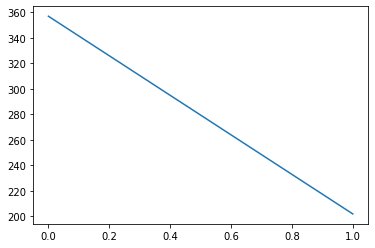

PVL04oe_pct 2


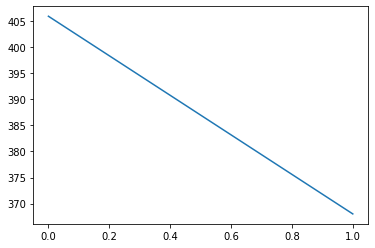

AVL02la_pct 2


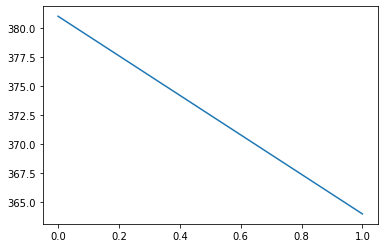

PDM10h_pct 2


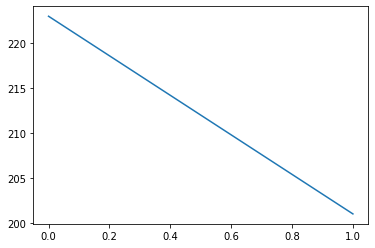

PDM15g_b_pct 2


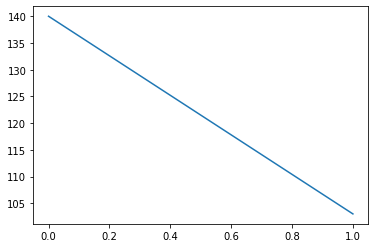

ADL03x_pct 2


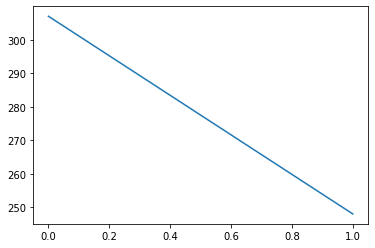

ADL21f_d_pct 2


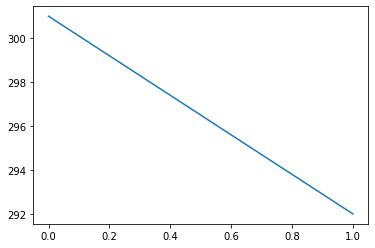

PDM08a_pct 2


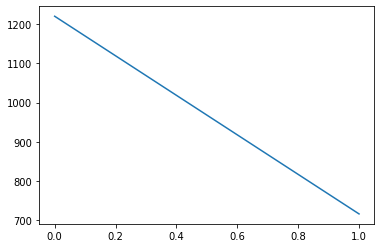

PDL18h_pct 2


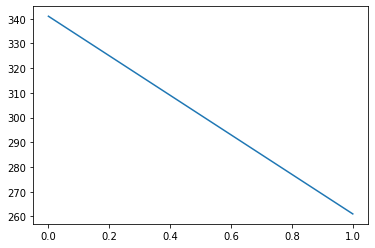

PVL04oj_pct 2


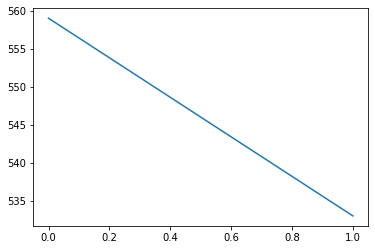

PDL07op_pct 2


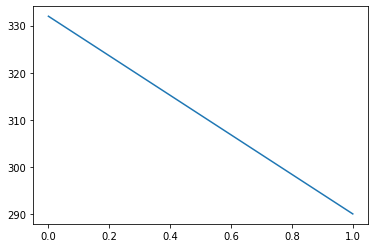

PDL18d_b_pct 2


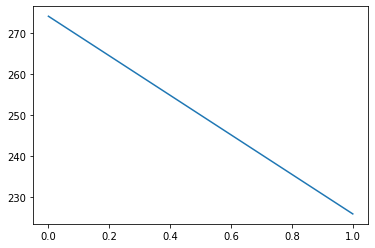

ADM01k_pct 2


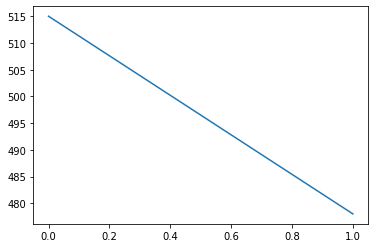

PDM12i_pct 2


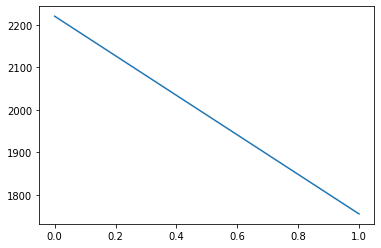

AVM10a_pct 2


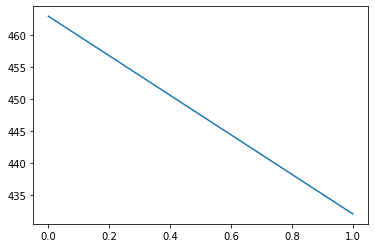

aIPg4 2


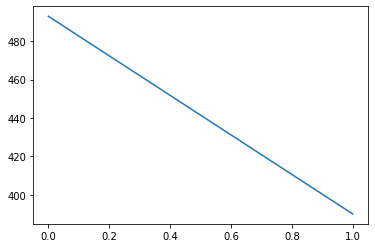

ADL21c_pct 2


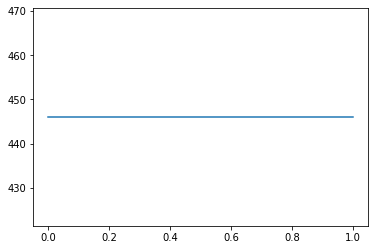

PDL24c_pct 2


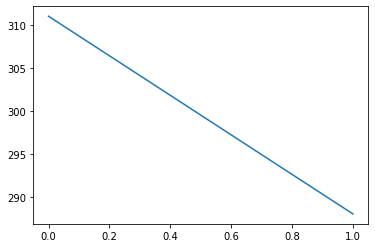

AVL13k_pct 2


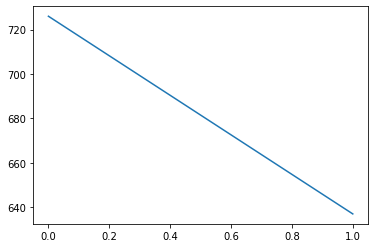

PVL11oe_pct 2


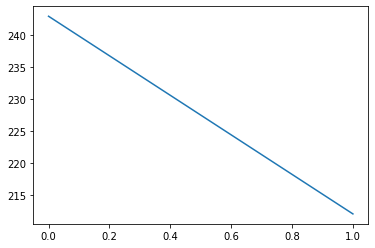

ADM05k_pct 2


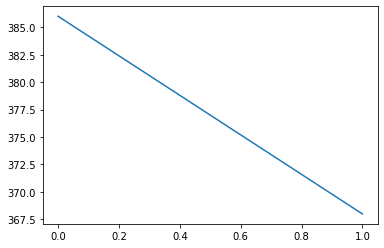

ADM01os_pct 2


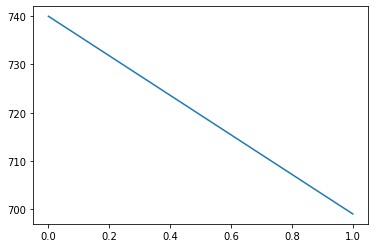

PVL10r_b_pct 2


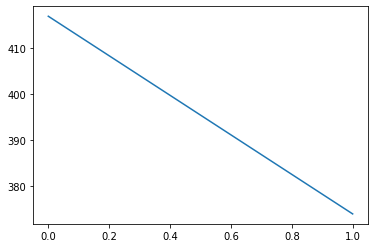

PDM23r_pct 2


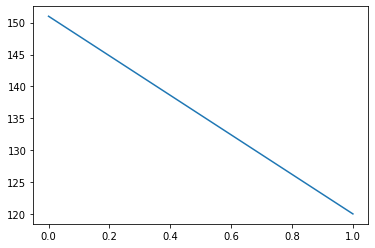

PDM09n_pct 2


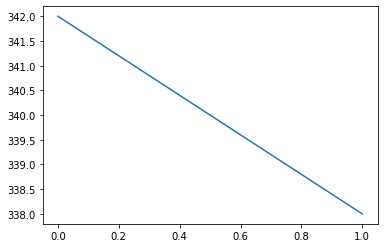

PDL16a_pct 2


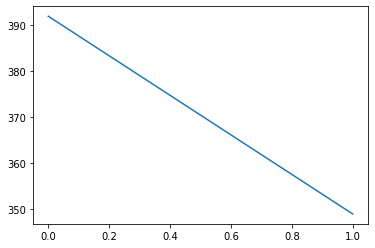

PVL04v_pct 2


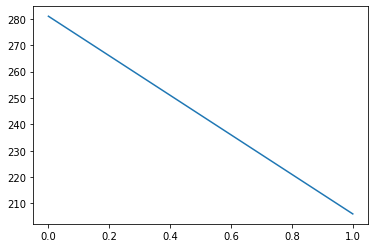

ADL15f_a_pct 2


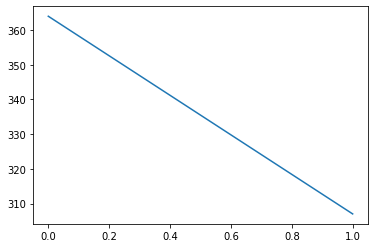

ADL25j_pct 2


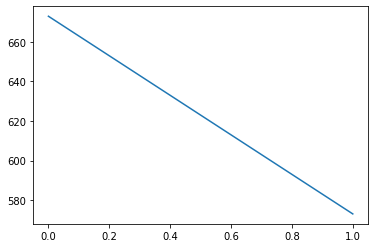

PDM31d_pct 2


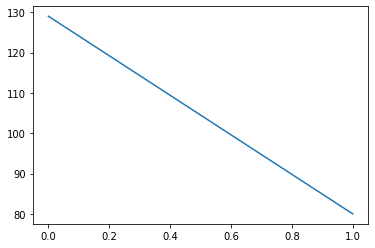

ADL12a_a_pct 2


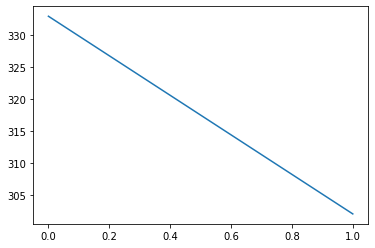

PDM10od_pct 2


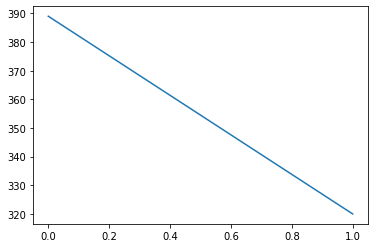

PDM07q_pct 2


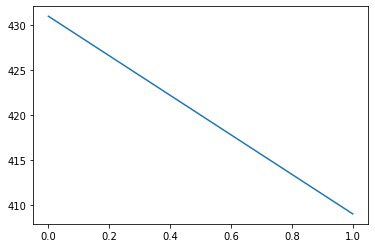

PVM08d_a_pct 2


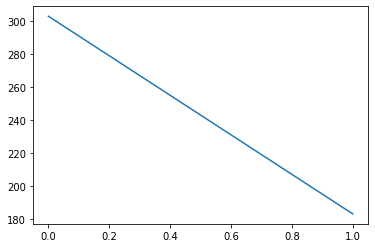

PDL15e_pct 2


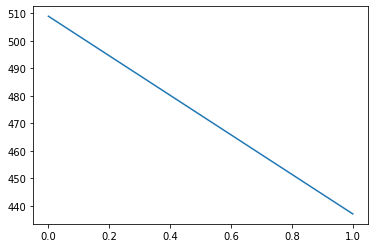

PVM14b_pct 2


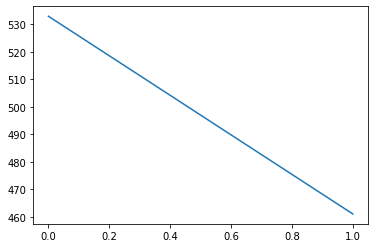

PVM03t_d_pct 2


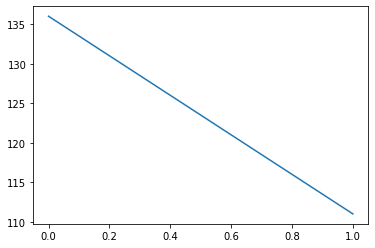

ADL24a_pct 2


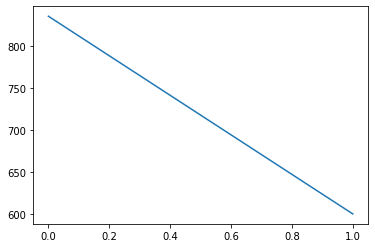

PDM26s_pct 2


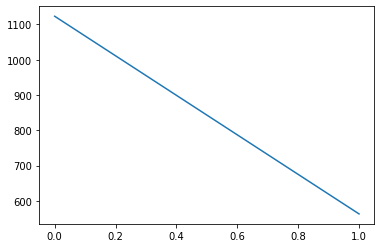

PVL13f_pct 2


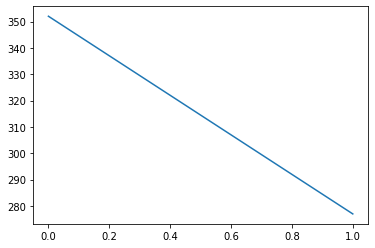

AVL06j_pct 2


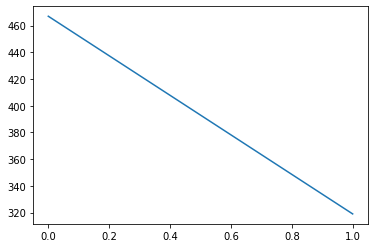

PVL15k_pct 2


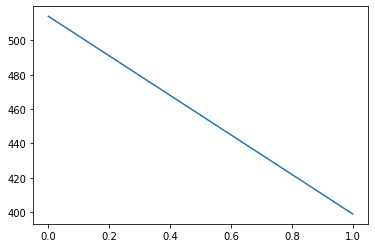

ADM12c_pct 2


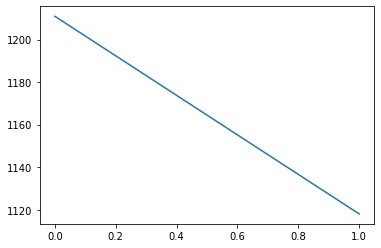

ADL12a_b_pct 2


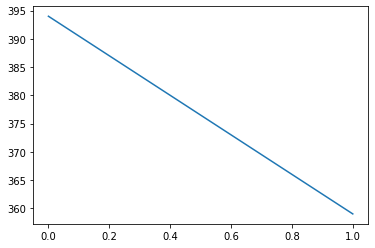

PDM22u_pct 2


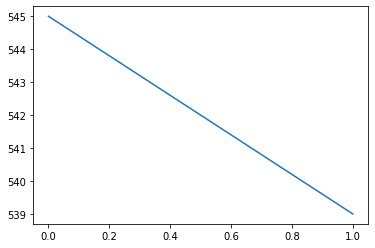

PVM09j_pct 2


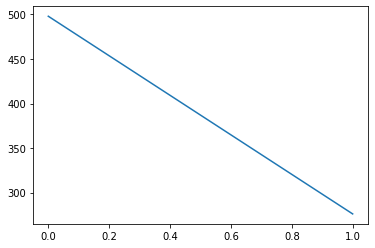

ADL02y_pct 2


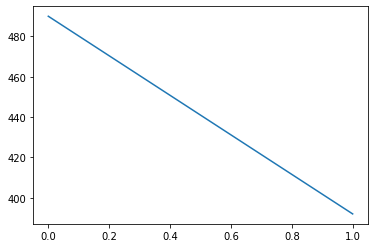

PDM10g_a_pct 2


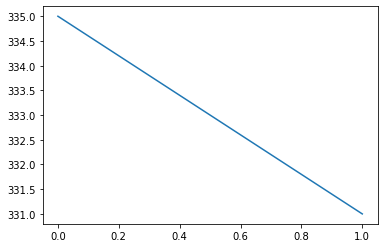

ADM04n_a_pct 2


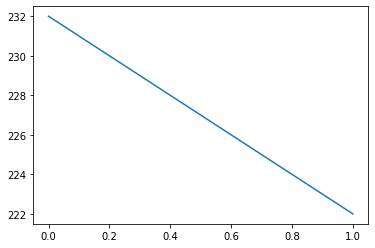

PDM11q_a_pct 2


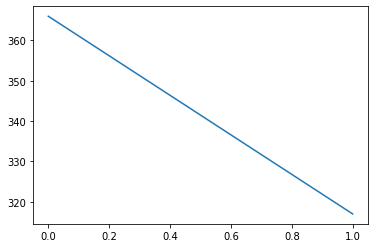

ADM01oi_pct 2


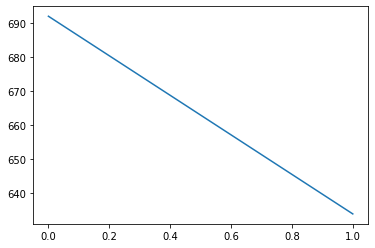

DN1a 2


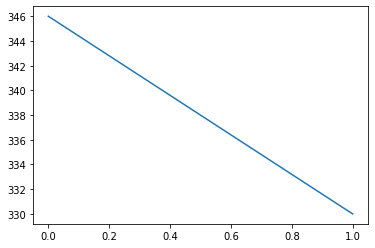

PDL21p_b_pct 2


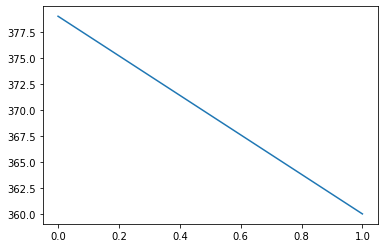

ADM11d_pct 2


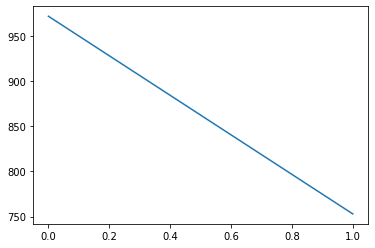

PDL18ob 2


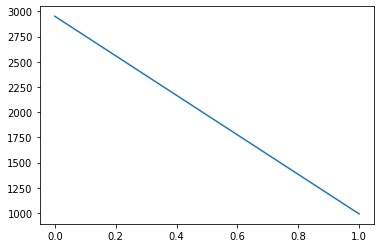

ADL02t_pct 2


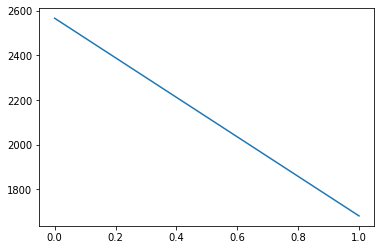

PDM12g_a_pct 2


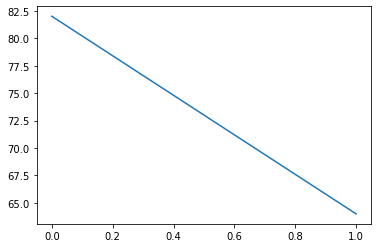

aDT4 2


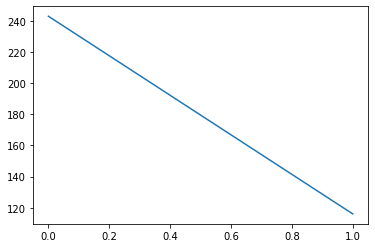

AVL11n_a_pct 2


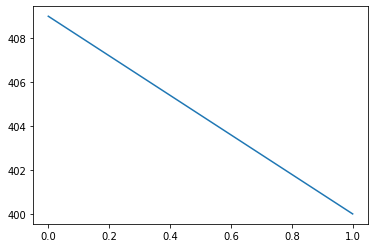

PDL06x_pct 2


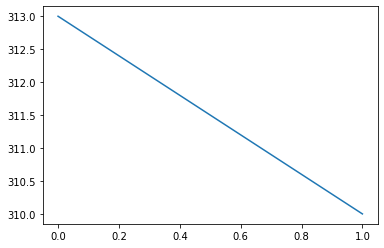

PDM12oj_pct 2


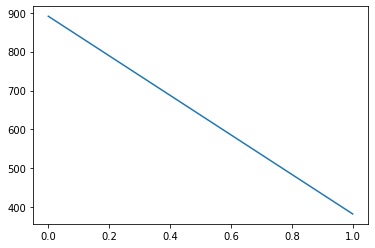

DN1pB 2


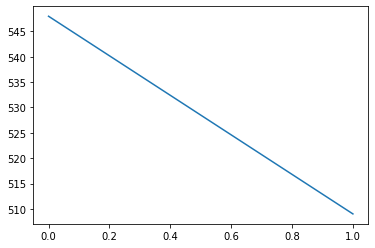

AVL06w_e_pct 2


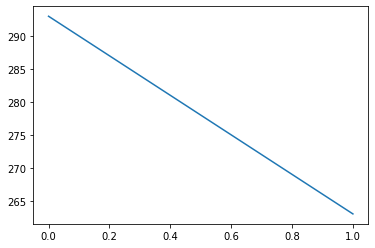

PDL18d_a_pct 2


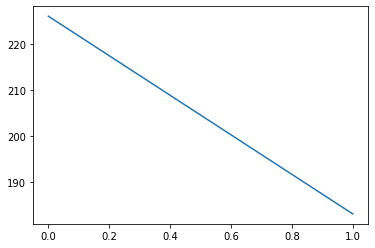

PDM08w_pct 2


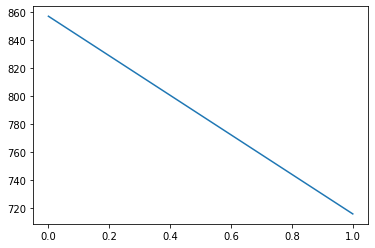

PDM09og_pct 2


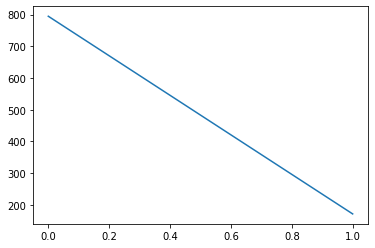

PDL18x_pct 2


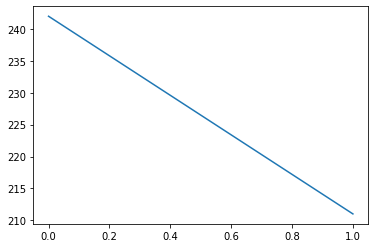

PDL21q_pct 2


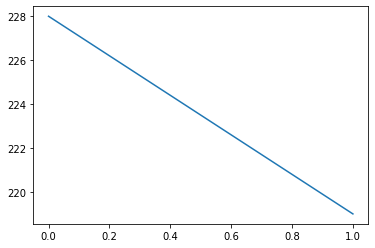

PDL07oh_pct 2


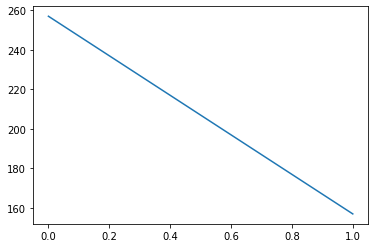

PVL04b_b_pct 2


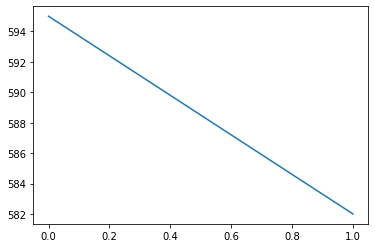

AVL08on_pct 2


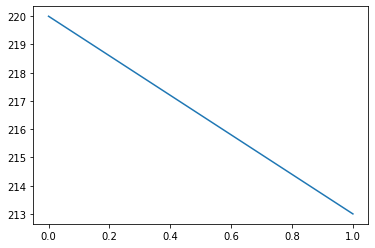

AVL06k_pct 2


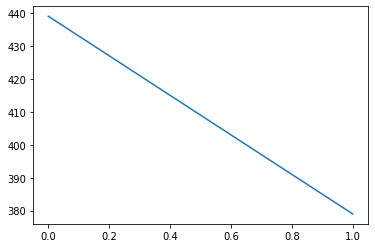

PDL12i_pct 2


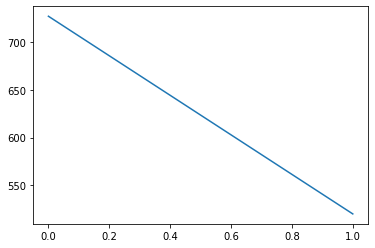

PDM20k_pct 2


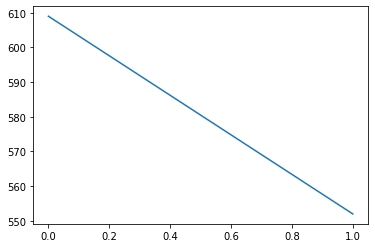

ADL12j_pct 2


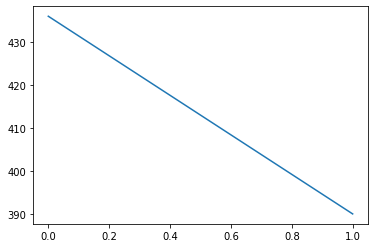

PDM10b_pct 2


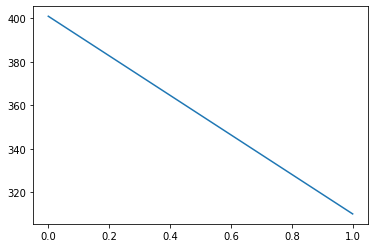

AVL06w_d_pct 2


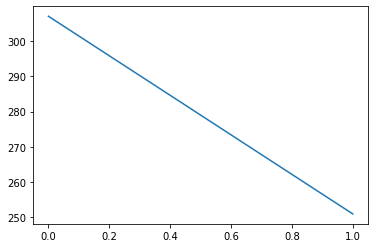

PDL26f_pct 2


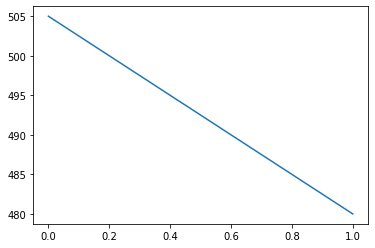

PDM16k_pct 2


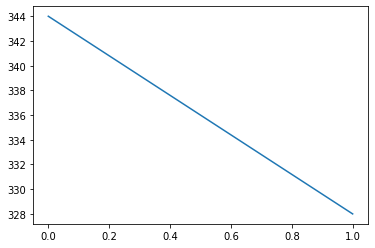

PDM10oh_pct 2


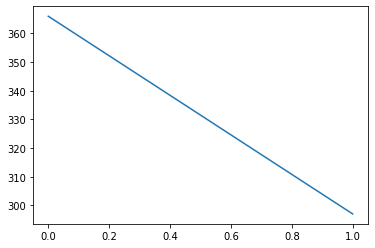

AVL10g_a_pct 2


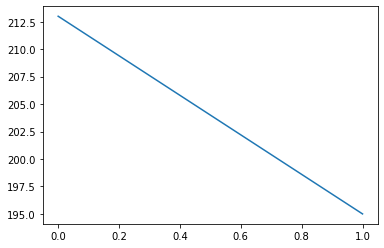

AVL08q_pct 2


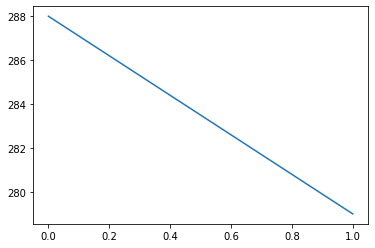

AVL01ola_pct 2


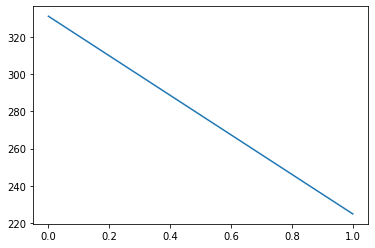

AVL03d_b_pct 2


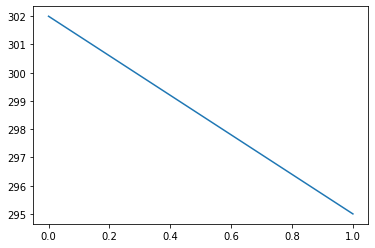

AVL06y_pct 2


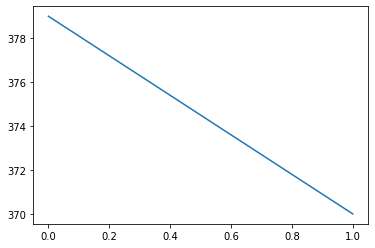

PDM11om_pct 2


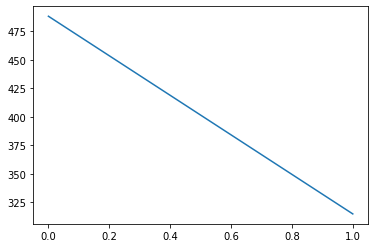

AVL22f_pct 2


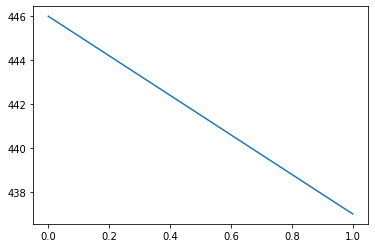

ADL12v_pct 2


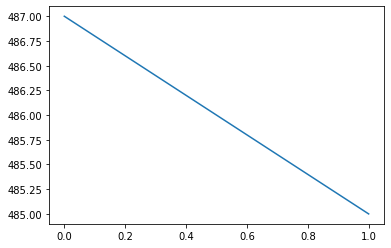

AVL25c_pct 2


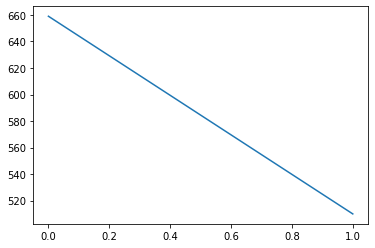

AVL12e_pct 2


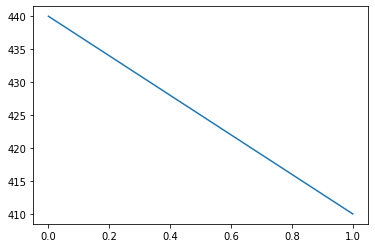

PDL21p_a_pct 2


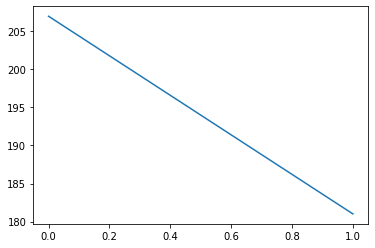

ADM01u_pct 2


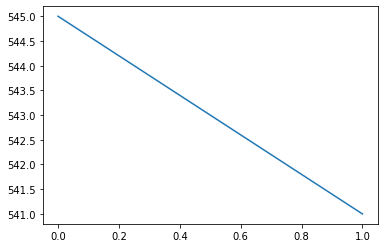

PDM07y_b_pct 2


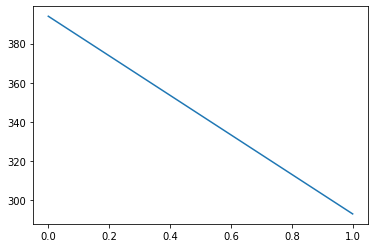

PDM07s_pct 2


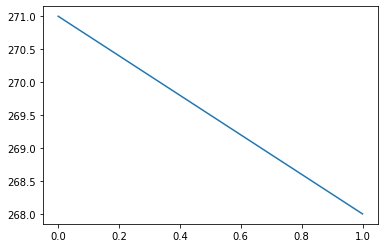

PDM05t_pct 2


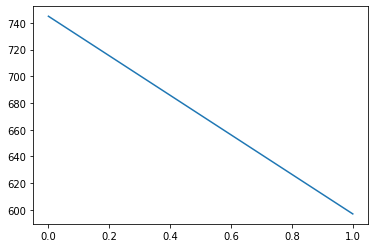

AVL02b_b_pct 2


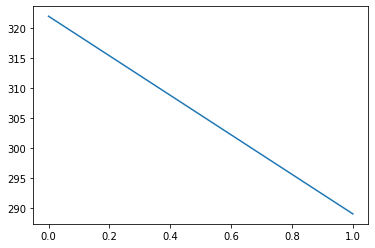

PDM07oe_pct 2


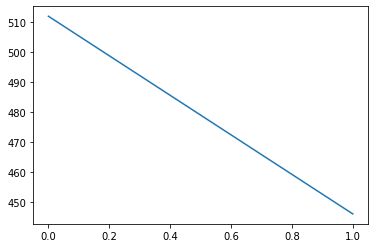

PDM06r_c_pct 2


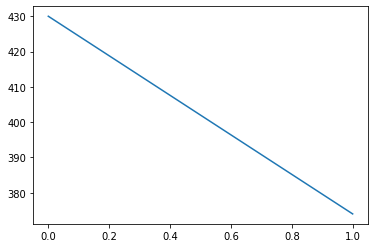

ADM01n_pct 2


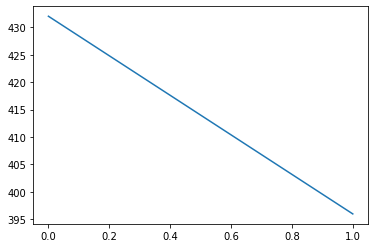

PVL08p_pct 2


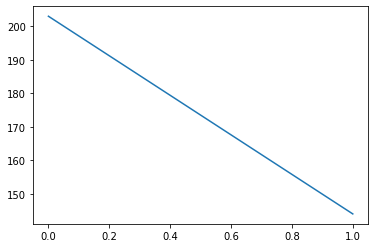

PDM05j_f_pct 2


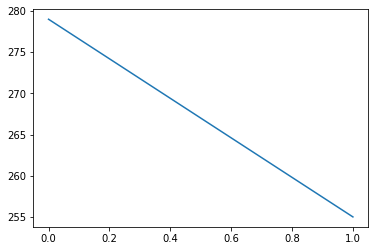

ADM11b_pct 2


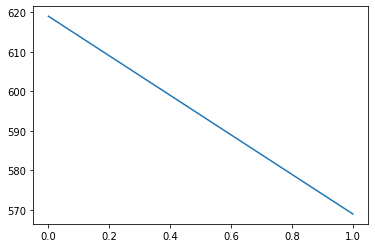

PDM35a_pct 2


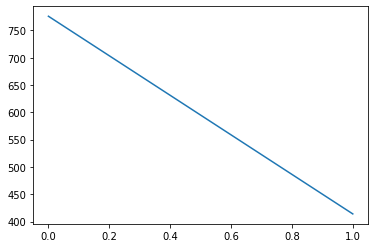

ADL16s_pct 2


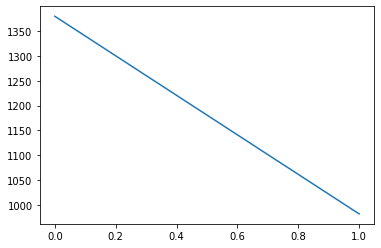

PDM24k_pct 2


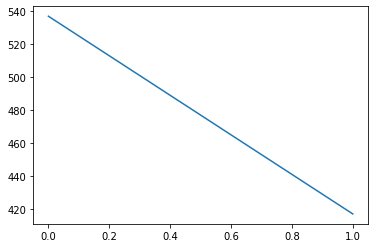

AVL01ld_pct 2


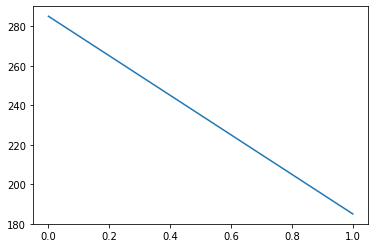

ADL21b_b_pct 2


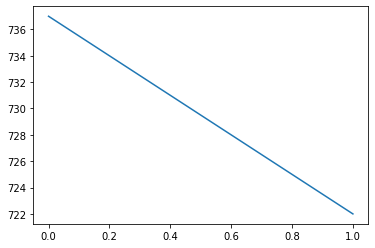

PDM21i_pct 2


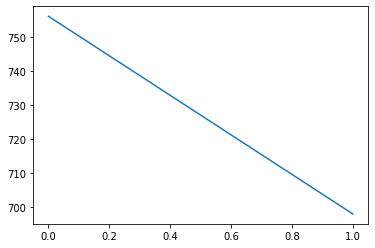

PVL06v_b_pct 2


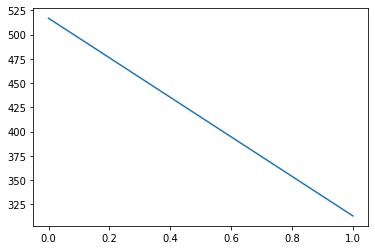

ADM08a_pct 2


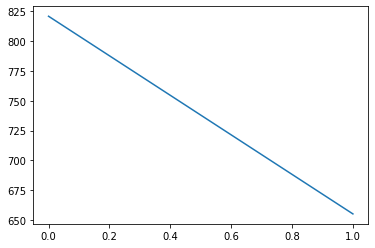

PDM22d_pct 2


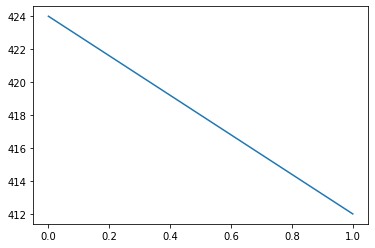

PVM08n_pct 2


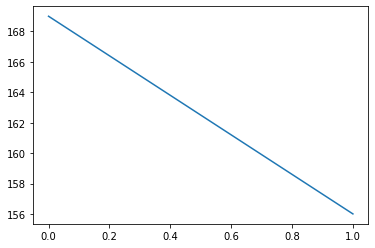

AVL02ok_pct 2


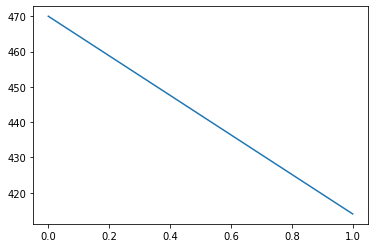

ADM01oc_pct 2


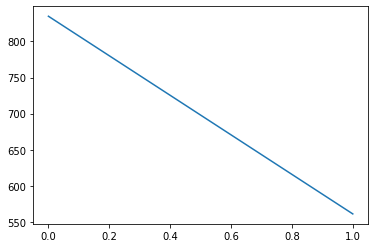

AVL12x_pct 2


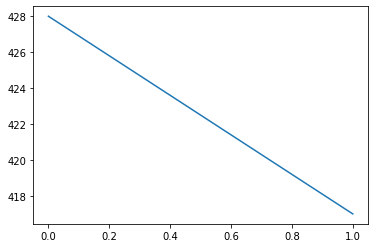

PDM10e_pct 2


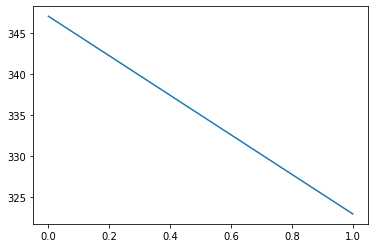

PDL23a_pct 2


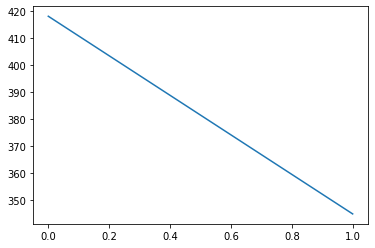

AVL23d_pct 2


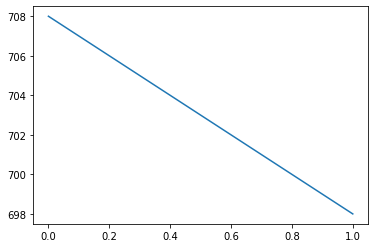

PDL05ol_pct 2


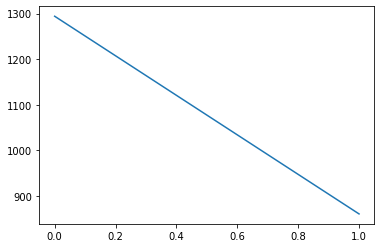

ADL14f_pct 2


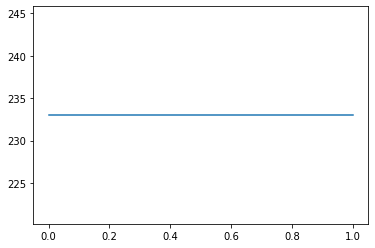

PDM10m_d_pct 2


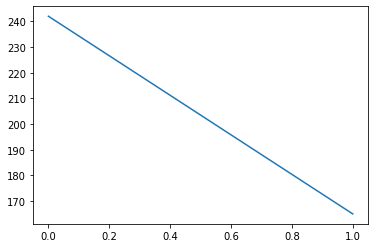

ADM04op_pct 2


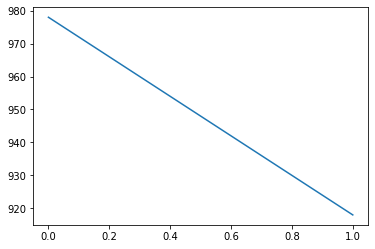

PDL11h_pct 2


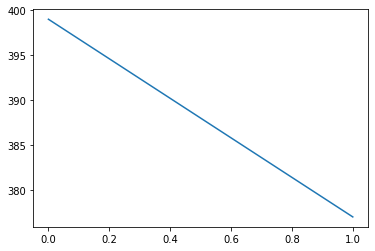

PDM16c_pct 2


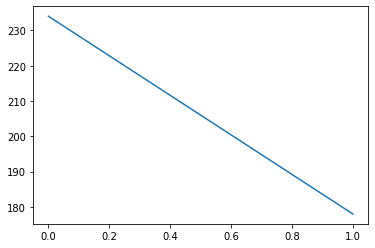

PDM09on_pct 2


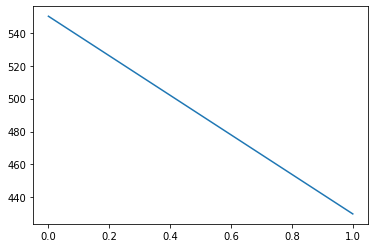

AVL02m_c_pct 2


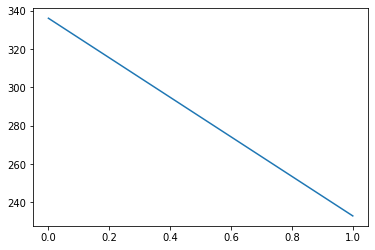

PDL17b_a_pct 2


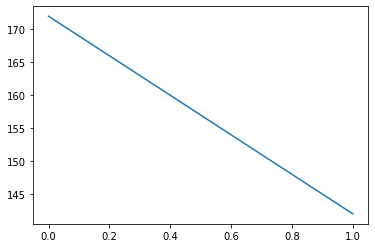

PDM15g_e_pct 2


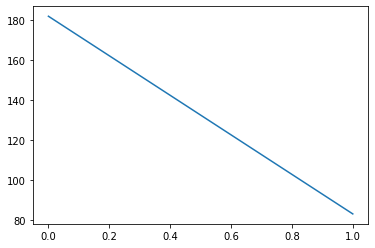

ADL09f_pct 2


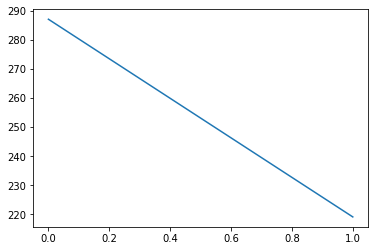

ADM01c_pct 2


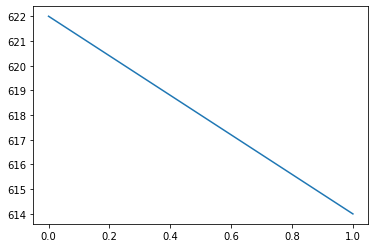

PVM13e_pct 2


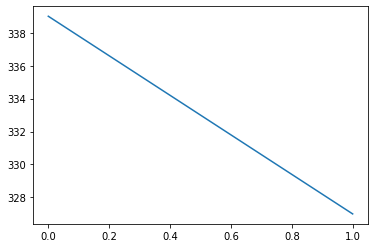

AVL06v_b_pct 2


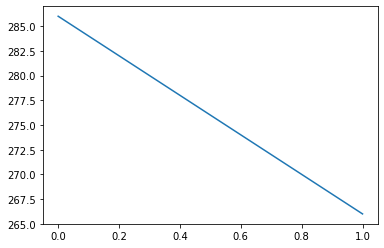

ADL28e_pct 2


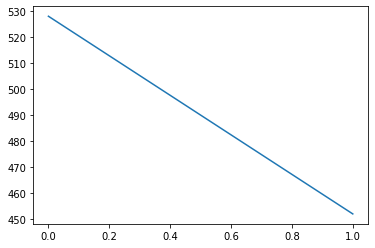

AVL03b_a_pct 2


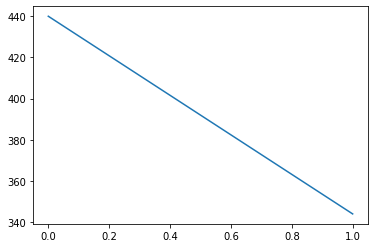

ADL20m_pct 2


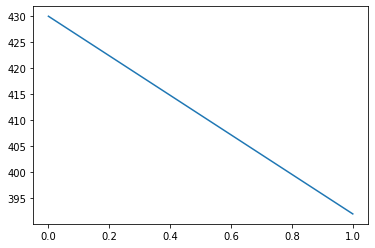

PDM16p_pct 2


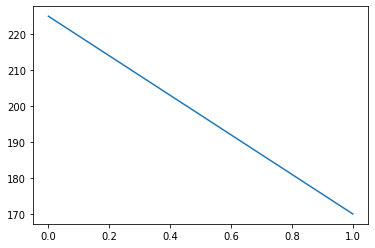

PDM10oc_pct 2


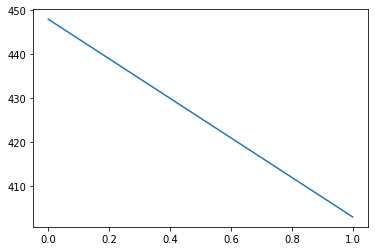

VP multi adPN mALT 2


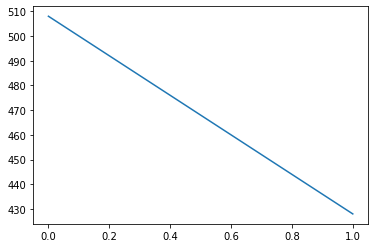

PVM11a_pct 2


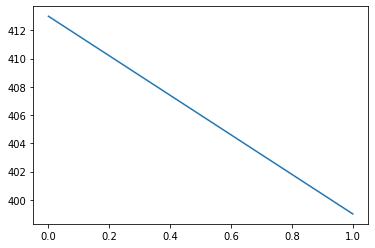

PVL15t_pct 2


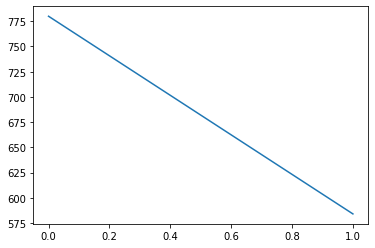

PDM20v_pct 2


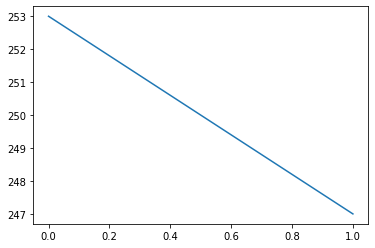

PDM22p_pct 2


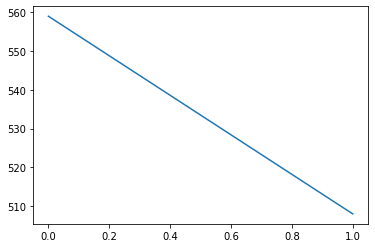

ADL25d_pct 2


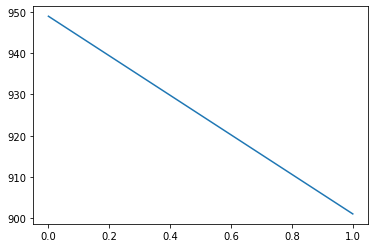

AVL12s_pct 2


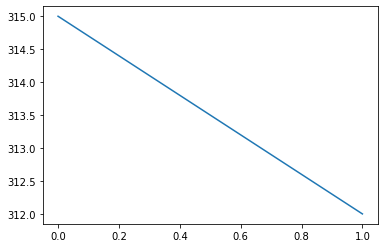

PVM16b_pct 2


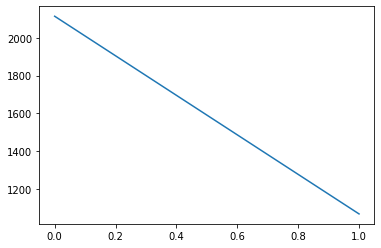

PVL11s_pct 2


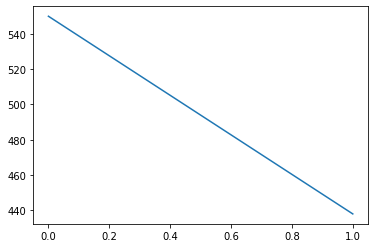

ADL04q_e_pct 2


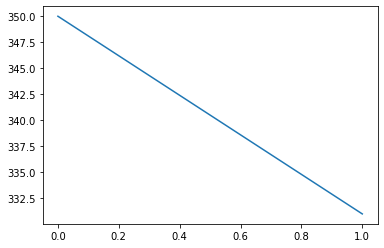

ADL12k_c_pct 2


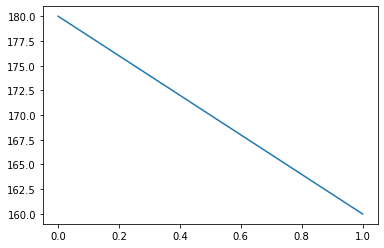

AVL06z_a_pct 2


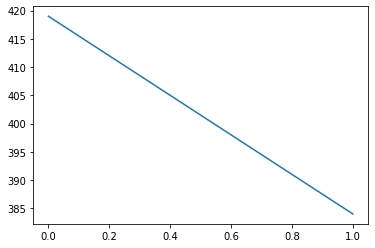

PDL18e_pct 2


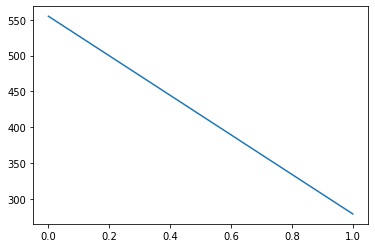

ADM07ok_pct 2


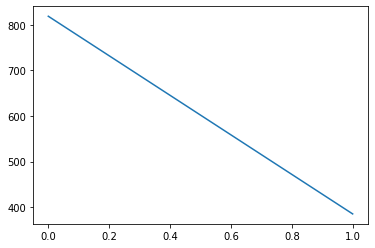

PVL04os_pct 2


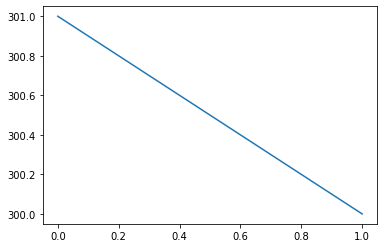

PDM06g_b_pct 2


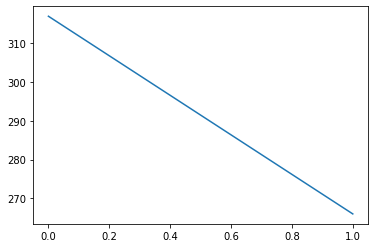

AVL12f_pct 2


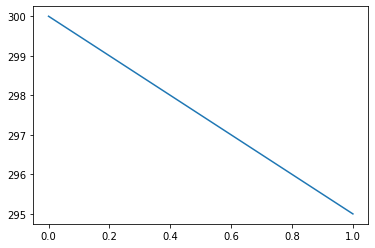

PDL16c_pct 2


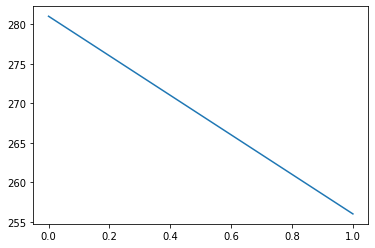

AVL06e_pct 2


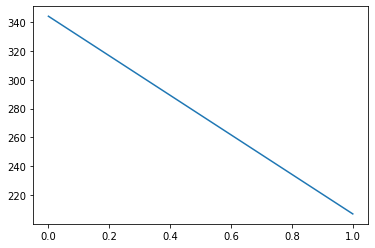

ADL12k_a_pct 2


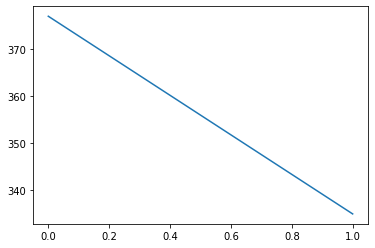

ADL12g_a_pct 2


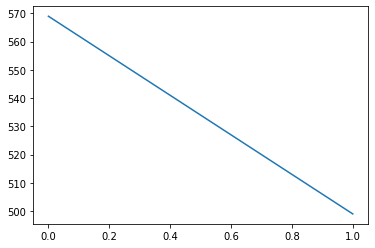

ADM04ol_pct 2


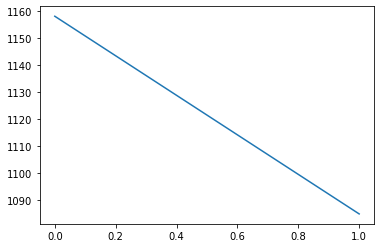

PVL11v_pct 2


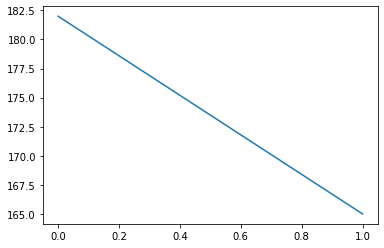

PDM12oi_pct 2


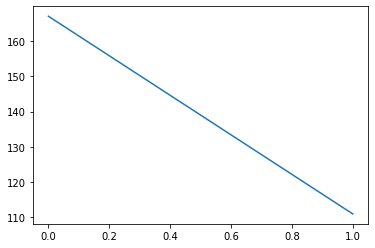

ADM07w_pct 2


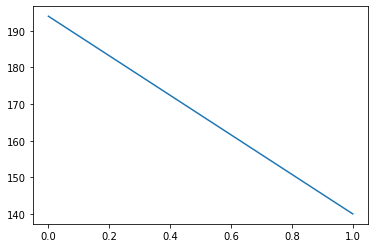

PDM10g_c_pct 2


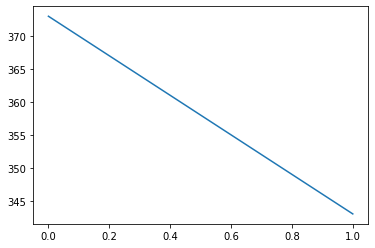

AVL06x_a_pct 2


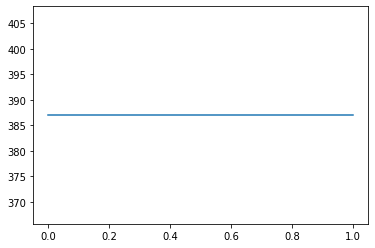

PDM05k_pct 2


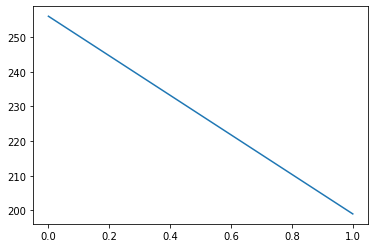

PDM07od_pct 2


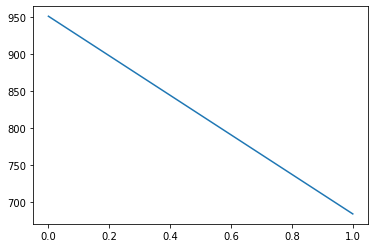

PDM22a_pct 2


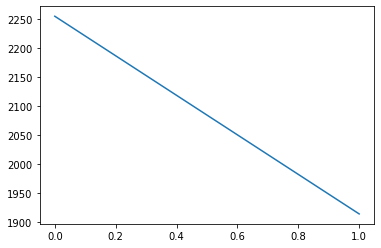

PDM10og_pct 2


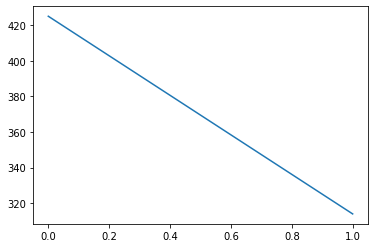

ADM04oi_pct 2


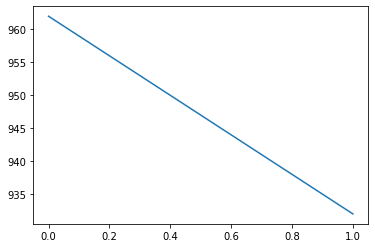

AVL03ol_pct 2


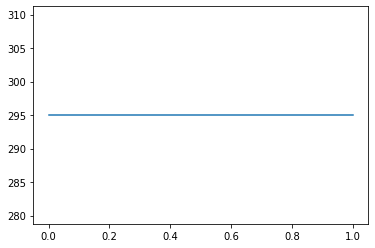

AVL06ok_pct 2


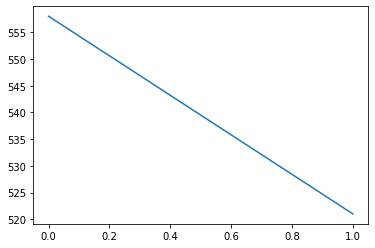

PVL13b_d_pct 2


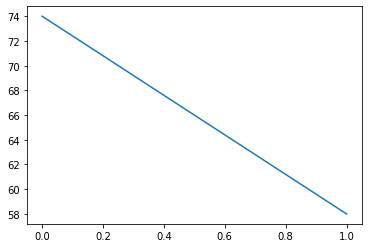

PVL10r_a_pct 2


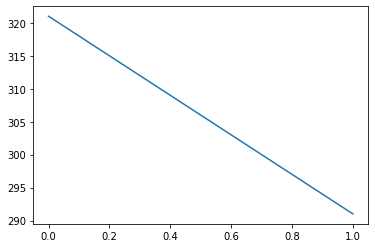

AVL06of_pct 2


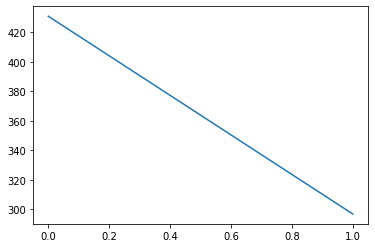

PDM06r_b_pct 2


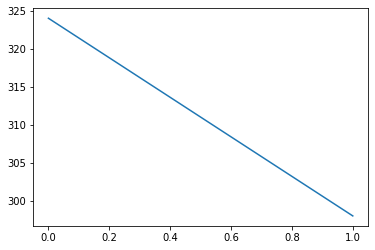

PVM14d_pct 2


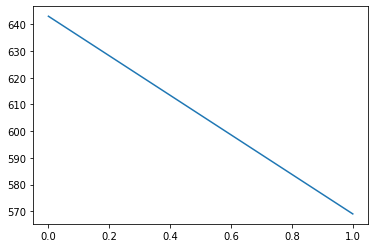

PDM09or_pct 2


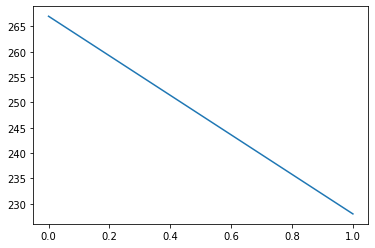

PDM28p_pct 2


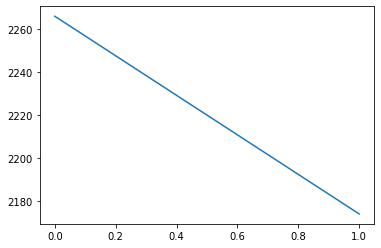

OA-VPM3 2


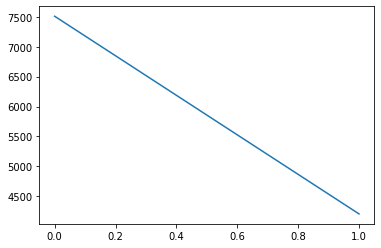

AVL25d_pct 2


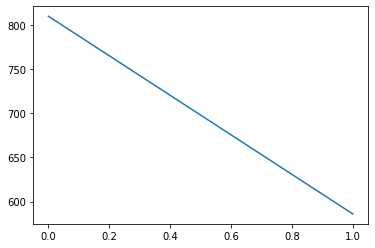

PVL15i_pct 2


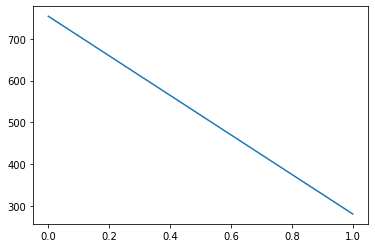

PDL05q_pct 2


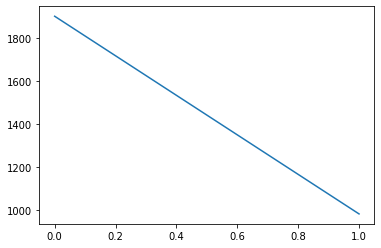

AVL03u_pct 2


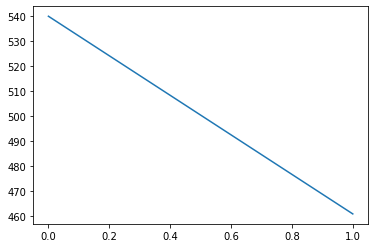

AVL06os_pct 2


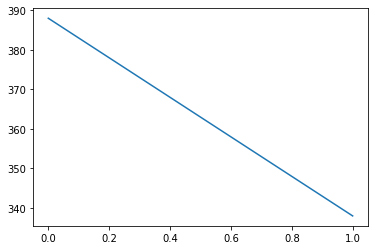

AVL03c_b_pct 2


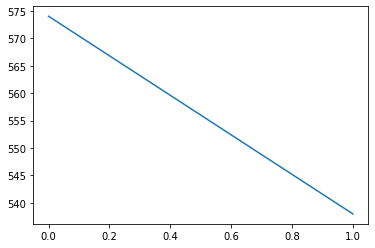

ADL02v_pct 2


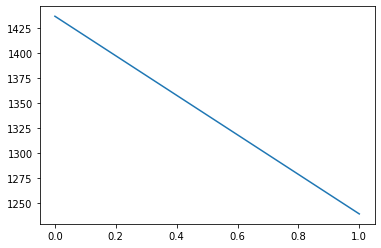

AVL06ob_pct 2


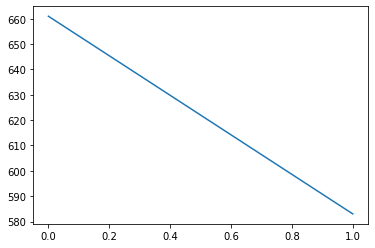

PDM11s_pct 2


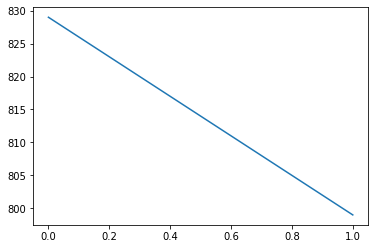

AVL06x_b_pct 2


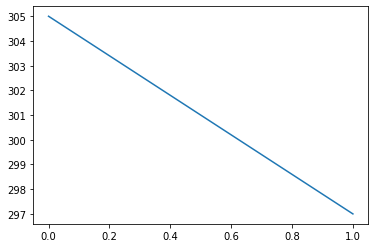

AVL08v_pct 2


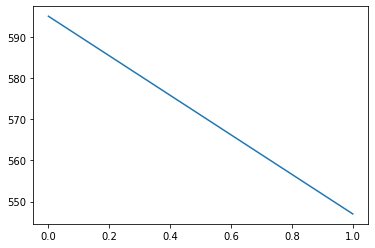

ADL25f_pct 2


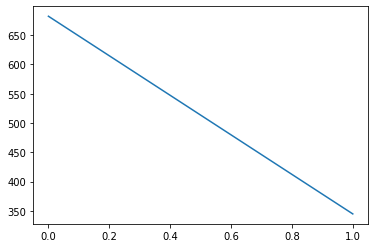

ADL18c_pct 2


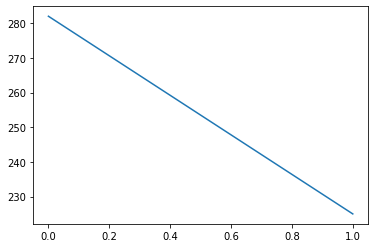

AVL03c_c_pct 2


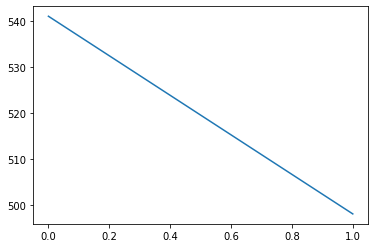

AVL06w_c_pct 2


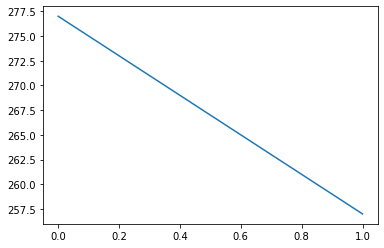

PDM05j_g_pct 2


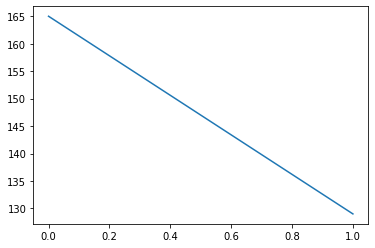

PDL20g_pct 2


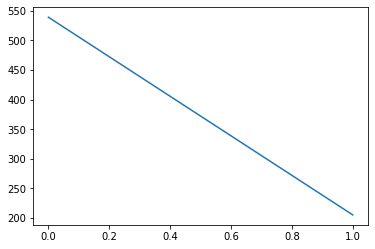

PVM09m_pct 2


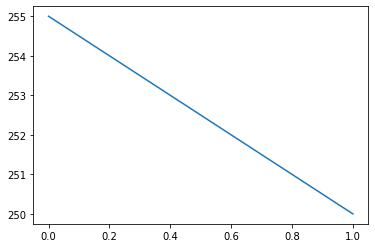

PDM16g_pct 2


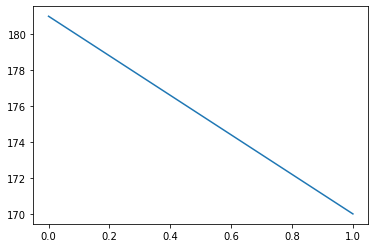

PDM10m_c_pct 2


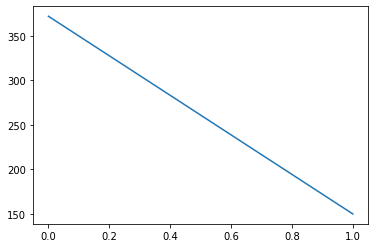

PDL20w_pct 2


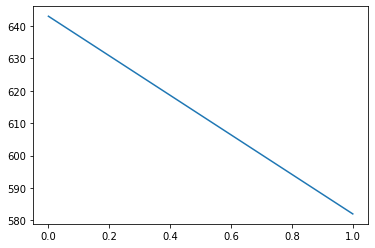

AVL03m_b_pct 2


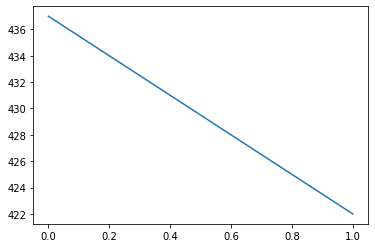

AVL06oa_pct 2


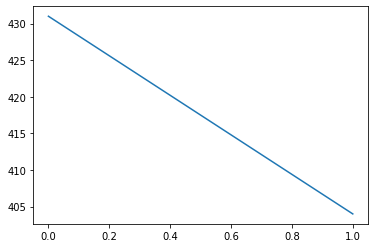

PDM05m_pct 2


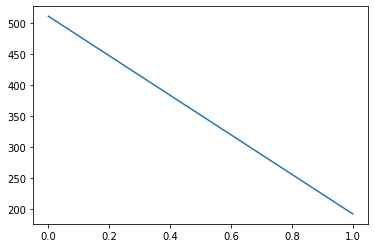

AVL08ob_pct 2


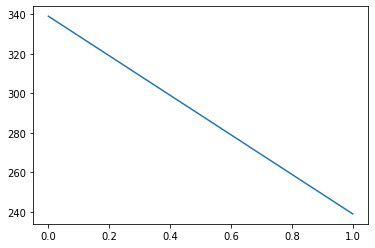

AVL06c_pct 2


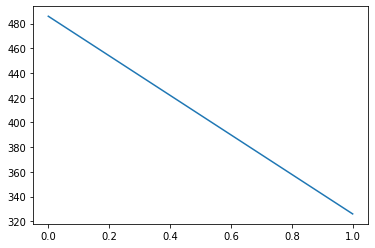

ADL21d_c_pct 2


PVL04a_a_pct 2


AVL06v_h_pct 2


PVL15w_pct 2


PVM09n_pct 2


PDM10j_pct 2


ADL07e_pct 2


ADM05od_pct 2


ADL23m_pct 2


ADL02j_e_pct 2


PVL04m_d_pct 2


PDL05t_pct 2


ADL02j_d_pct 2


PDM15m_pct 2


ADL10m_b_pct 2


PDL15q_pct 2


PDL06oj_pct 2


FB6V 2


PDM08om_pct 2


AVL10b_a_pct 2


PDL16r_pct 2


ADL03m_e_pct 2


ADL23h_a_pct 2


PDL05w_pct 2


ADM07i_pct 2


ADL03m_c_pct 2


PDM08op_pct 2


ADL20e_a_pct 2


PDM08s_pct 2


FB5AB 2


PVL06c_pct 2


ADM04v_b_pct 2


PDL07f_pct 2


PDM15p_pct 2


ADL17t_pct 2


PDL05b_pct 2


FB5D 2


FB5AA 2


FB9B_a 2


FB5C 2


FB6Y 2


FB4N 2


FB6D 2


PDL17t_pct 2


AVL18u_pct 2


VM7d adPN 2


ADL03k_b_pct 2


PDM10a_pct 2


PDL13w_pct 2


DM4 vPN 2


PDM10om_pct 2


ADL17c_pct 2


PVL04e_pct 2


ADL03q_pct 2


ADL23g_pct 2


PDL07y_pct 2


MBON03 2


PDM13p_a_pct 2


MBON11 2


MBON06 2


DPM 2


MBON24 2


MBON02 2


PDL07od_pct 2


PDL07oe_pct 2


PDM24n_pct 2


ADM01i_b_pct 2


PDM07om_pct 2


pC1c 2


PDM12d_b_pct 2


ADM02h_pct 2


ADM07f_pct 2


ADM04w_pct 2


AVM07u_pct 2


ADM04q_pct 2


oviIN 2


ADM07a_c_pct 2


ADM07n_pct 2


PDL18z_pct 2


ADM04od_pct 2


PDL06q_pct 2


ADM07u_pct 2


ADM07p_pct 2


ADM01a_pct 2


FB5N 2


ADM04s_pct 2


ExR3 2


PDM11u_pct 2


PDM08m_pct 2


PDM09oq_pct 2


MBON05 2


FB2L 2


PDM09u_pct 2


ADM06c_pct 2


PVL08q_pct 2


ADM04n_b_pct 2


PVL04oh_pct 2


PDL06r_b_pct 2


ADM10q_pct 2


ADM10d_pct 2


PVM09i_pct 2


ADM01y_a_pct 2


PDM13j_pct 2


ADM07x_pct 2


ADM04n_c_pct 2


PPL102 2


PVL17d_pct 2


MBON27 2


PDM27s_pct 2


MBON31 2


ADM01s_pct 2


PDM13d_pct 2


ADM07oc_pct 2


AVL03k_a_pct 2


ADM01oh_pct 2


PDM13s_pct 2


ADL19b_pct 2


ADM07ot_pct 2


ADM04r_pct 2


PVM10a_pct 2


ADM07ob_pct 2


FB5M 2


PDL13d_pct 2


ADM01og_pct 2


ADM04oj_pct 2


PDM35b_pct 2


ADM07y_pct 2


ADM07oe_pct 2


AVL05b_pct 2


PDM09od_pct 2


PDM12b_a_pct 2


PDM05f_pct 2


FB4B 2


ADL21j_pct 2


PDM18i_pct 2


ADL10c_a_pct 2


PDL23k_pct 2


FB2I_c 2


ADL02h_c_pct 2


PDL05m_pct 2


FB2H_a 2


FB6N 2


FB5I 2


FB6I 2


FB6E 2


ADM07e_pct 2


FB5L 2


FB5J 2


FB6P 2


FB6Q 2


FB6W 2


FB4X 2


PDM09t_pct 2


FB6X 2


PDL14m_a_pct 2


FB2G_a 2


PDL14c_pct 2


ADL24h_pct 2


VM5v adPN 2


DL1 adPN 2


ADL22h_pct 2


ADL05r_c_pct 2


ADL05r_b_pct 2


ADL17m_a_pct 2


ADL18e_pct 2


PDL11z_pct 2


PDL08oi_pct 2


PVL03p_pct 2


ADL01ok_pct 2


ADL09n_a_pct 2


ADL24q_pct 2


ADL05t_pct 2


PDL16z_pct 2


ADL17m_b_pct 2


ADL17d_c_pct 2


PDL08ok_pct 2


PDL06f_pct 2


putative OA-mALT 2


ADL07t_pct 2


DA3 adPN 2


PDL08n_pct 2


PDM13p_b_pct 2


PDL15v_pct 2


ADL09z_pct 2


ADM01v_pct 2


PDL15b_pct 2


ADM10n_a_pct 2


PDL15s_pct 2


ADL03k_a_pct 2


ADL03os_pct 2


ADL17d_b_pct 2


FB5T 2


PDL07r_pct 2


ADM02b_pct 2


PDM13v_pct 2


PDL08ol_pct 2


ADL17m_c_pct 2


AVM07y_a_pct 2


ADM07j_b_pct 2


ADL19k_pct 2


ADL19t_pct 2


PVM03c_pct 2


MBON29 2


ADL03og_pct 2


PDM17b_pct 2


PDM10ol_pct 2


ADL03m_x_pct 2


PDM07w_b_pct 2


ADM10r_pct 2


PDL15m_pct 2


PDL06ow_pct 2


PVM12b_pct 2


ADL13p_pct 2


PDM07e_pct 2


ADM07j_a_pct 2


PVL14h_a_pct 2


PDL05r_pct 2


PDL15w_pct 2


AVL10b_b_pct 2


ADL19i_b_pct 2


PVL14h_b_pct 2


ADM06a_pct 2


ADM10b_pct 2


ADM07d_a_pct 2


PDL15n_pct 2


ADL11e_pct 2


PDL05a_c_pct 2


MBON04 2


AVM03m_pct 2


ADM10n_b_pct 2


PDL06i_pct 2


PVL09oe_pct 2


ADM07m_pct 2


ADL15g_b_pct 2


PDL20u_pct 2


PVM12c_c_pct 2


PPL103 2


PVM03j_pct 2


ADL23r_pct 2


PVL04lb_pct 2


PDL07c_pct 2


PDM08ok_pct 2


DC2 adPN 2


ADM09j_pct 2


ADM09c_pct 2


PDM12g_b_pct 2


ADL12h_pct 2


ADM07k_pct 2


ADL15g_e_pct 2


AVM15k_pct 2


ADM07g_c_pct 2


AVM16d_pct 2


ADL09x_pct 2


FB5E 2


MBON32 2


SAG 2


ADL15n_pct 2


ADL20c_pct 2


PVL04z_pct 2


PDM06j_c_pct 2


ADL13n_b_pct 2


ADM05x_pct 2


PDL15u_a_pct 2


ADL03od_pct 2


FB5H 2


ADL12t_pct 2


ADL03s_pct 2


ADL15c_pct 2


ADL11q_pct 2


MBON26 2


AVM13k_pct 2


AVM16e_pct 2


PDM29a_pct 2


AVM17h_pct 2


FB4Q_a 2


AVM13n_pct 2


PDL05v_pct 2


PDM13ob_pct 2


ADM05w_pct 2


ADM05oe_pct 2


PDL06ou_pct 2


PDL15u_b_pct 2


PDL05h_pct 2


ADL23e_pct 2


PVL04k_pct 2


MBON01 2


FB1H 2


FB4H 2


PDM32a_pct 2


PVL04m_b_pct 2


MBON12 2


AVM07i_pct 2


PVL04m_c_pct 2


MBON19 2


ADL17n_pct 2


ADM07on_pct 2


PDL13k_pct 2


ADL04d_pct 2


VP4 vPN 2


PVL03or_pct 2


PDL20s_pct 2


ADL23c_a_pct 2


PDL14a_pct 2


PVL04c_pct 2


ADL04oa_pct 2


PVL18c_pct 2


ADL18t_pct 2


ADL22d_e_pct 2


AVM03h_pct 2


PDL22j_pct 2


AVM13m_pct 2


ADL20j_b_pct 2


PDM21b_pct 2


AVL12v_pct 2


PDL16oc_pct 2


PVL11oc_pct 2


PVL19g_pct 2


ADL14c_pct 2


ADL07oe_pct 2


AVL04e_pct 2


PDM18e_pct 2


PVL03g_pct 2


PDL20z_pct 2


PDL24f_pct 2


AVM15g_pct 2


ADM07g_b_pct 2


ADM07od_pct 2


ADM01h_pct 2


ADL03or_pct 2


ADL22c_a_pct 2


AVL11ob_pct 2


ADL22d_a_pct 2


PDL08g_pct 2


ADL01v_pct 2


ADL01od_pct 2


ADL24n_pct 2


PDL08og_pct 2


ADL01oi_pct 2


PVL03d_pct 2


PDL13oc_pct 2


ADL11h_a_pct 2


PDL17d_pct 2


ADL01w_b_pct 2


AVL08i_pct 2


PDL08e_pct 2


ADL19u_pct 2


ADL03oq_pct 2


FB2H_b 2


PDL09og_pct 2


PDL25d_pct 2


AVL01k_pct 2


ADL11s_pct 2


ADL05w_a_pct 2


VM4 lvPN 2


PVL03ot_pct 2


PVM04b_pct 2


AVL07v_pct 2


MBON07 2


PDL13oe_pct 2


VP3 + VP1l G PN 2


PVL14h_c_pct 2


VP multi lvPN t2ALT 2


PDL06b_pct 2


PDL06a_b_pct 2


AVL18t_pct 2


AVL18c_pct 2


ADL10g_d_pct 2


ADL10j_pct 2


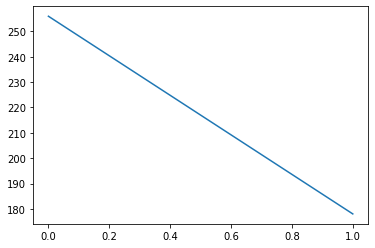

PDL16q_b_pct 2


KC 2


AVM16g_pct 2


ADM10n_c_pct 2


AVM13e_pct 2


PDL13od_pct 2


PDL06om_pct 2


ADM07oo_pct 2


ADM07j_c_pct 2


PVM09k_pct 2


AVM15n_c_pct 2


ADL03p_pct 2


AVM15q_pct 2


ADL02d_pct 2


ADL05w_d_pct 2


PPL104 2


PVL04i_pct 2


AVL04oc_pct 2


PDM14ob_pct 2


PDL06u_pct 2


PDL18y_pct 2


FB3B 2


PDM28i_pct 2


PDM14h_pct 2


PVL14e_e_pct 2


PVM05t_pct 2


PDM14y_pct 2


AVL04s_c_pct 2


PDL19p_pct 2


PVL14e_c_pct 2


AVL01b_b_pct 2


AVL02q_c_pct 2


ADL11h_b_pct 2


AVL03p_pct 2


PDL24d_pct 2


PDL12w_b_pct 2


ADL04t_c_pct 2


ADL11b_pct 2


AVL12w_pct 2


PVL14g_pct 2


PDM07on_pct 2


ADL11u_pct 2


PDM36b_pct 2


PDM07oc_pct 2


AVM08z_pct 2


PDM33c_pct 2


AVM04c_pct 2


AVL08m_pct 2


ADL14e_pct 2


PDM07y_c_pct 2


PDL10u_pct 2


PDM07oo_pct 2


PVL04ou_pct 2


ADL10m_a_pct 2


ADL04v_pct 2


PDL06ok_pct 2


ADL01oa_pct 2


AVL07r_pct 2


AVL11oa_pct 2


ADL12b_a_pct 2


PVL03ow_pct 2


ADL05z_b_pct 2


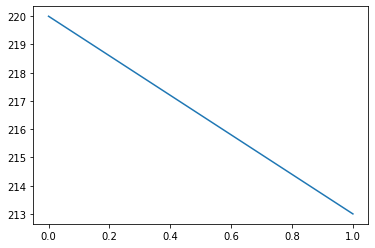

PDM12t_pct 2


PDM17t_pct 2


PVM03d_pct 2


PDM33a_pct 2


AVL01ou_pct 2


FB4I 2


FB4G 2


PVM06j_pct 2


MBON15 2


FB4J 2


PDM36a_pct 2


PDL09of_pct 2


PDL09d_pct 2


PDL08b_pct 2


PDL08oe_pct 2


AVL07oz_pct 2


VP1m + VP5 C PN 2


ADL05p_c_pct 2


olfactory multi lPN t3ALT 2


PDL06oq_pct 2


VC3l? adPN 2


ADL05r_f_pct 2


ADL03oc_pct 2


VL1 C PN 2


PDL08u_pct 2


PDL08oo_pct 2


VA3 adPN 2


VA1v vPN 2


DC4 vPN 2


ADM03s_pct 2


PDL08ot_pct 2


VP1d+ D PN 2


VM2 adPN 2


DM5 lPN 2


DM2 lPN 2


MBON28 2


ADL04oh_pct 2


MBON18 2


AVL07oo_pct 2


VM7v adPN 2


ADL04oe_pct 2


FB5O 2


PVL06v_a_pct 2


PVL14e_a_pct 2


ADL01i_pct 2


ADL01e_pct 2


AVL18v_pct 2


AVL03s_pct 2


AVL03t_a_pct 2


PDL24h_pct 2


ADL01s_pct 2


PVL09ob_pct 2


PDM28b_pct 2


PVL01a_pct 2


AVL18k_pct 2


PVL03c_a_pct 2


AVL10x_a_pct 2


PVM12h_pct 2


PVM03w_pct 2


PVM04r_pct 2


AVL09t_pct 2


PDM17of_pct 2


PVM05d_pct 2


PDM19a_pct 2


ADL05oc_pct 2


PVL04b_a_pct 2


ADL18s_pct 2


ADM07d_b_pct 2


FB5F 2


PDM11op_pct 2


PDL15c_pct 2


AVM16b_pct 2


LCNp 2


PVM02q_pct 2


ADL20e_d_pct 2


PDL18t_pct 2


PDM17oj_pct 2


ADL03v_pct 2


OA-VUMa1 2


PVM17c_pct 2


FB5K 2


AVM14a_pct 2


PDM11t_pct 2


PDM17od_pct 2


PDM17ok_pct 2


PVM02g_pct 2


PVM02e_pct 2


ADM04k_pct 2


ADM01t_pct 2


ADM04ob_pct 2


ADM10t_pct 2


aMe8 2


PDL06oy_pct 2


PDM06h_a_pct 2


ADM01z_a_pct 2


PDL06r_a_pct 2


PVL13p_c_pct 2


ADM05d_pct 2


PDM07y_pct 2


PDL18m_pct 2


AVL23g_pct 2


aSP8 2


ADL21b_a_pct 2


ADL21e_pct 2


ADM03oe_pct 2


AVL11u_pct 2


PVM03k_pct 2


ADM01x_pct 2


PVL06a_b_pct 2


MBON25 2


MBON34 2


AVL20d_pct 2


AVL16e_pct 2


vpoEN 2


ADL01h_c_pct 2


ADM07op_pct 2


PVL04r_pct 2


PVL06oc_pct 2


AVL02h_pct 2


ADM07z_pct 2


AVM15h_pct 2


AVL22d_pct 2


aMe17E 2


aMe17C 2


PDM16a_pct 2


ADL27a_pct 2


AVM07c_pct 2


ADL02m_pct 2


PDL06oh_pct 2


ADL20e_f_pct 2


ADM07v_c_pct 2


FB3D 2


AVL07ou_pct 2


AVL07p_pct 2


PVLP001 2


PDL08m_c_pct 2


PDL08od_pct 2


ADL17g_b_pct 2


ADL12a_d_pct 2


ADL13n_a_pct 2


AVL08e_pct 2


PVL09oc_pct 2


PDL09f_pct 2


PVL04ov_pct 2


ADL03b_pct 2


ADL07d_pct 2


PDL06ot_pct 2


PDL24i_pct 2


PDM12m_pct 2


ADM07v_d_pct 2


ADL01ola_pct 2


PDL28c_pct 2


PDM16n_pct 2


PDM17r_pct 2


PDL12m_pct 2


ADM01oj_pct 2


aIPg3 2


AVL08oi_pct 2


AVL01z_e_pct 2


ADM03m_pct 2


PDM16m_pct 2


PVL16j_pct 2


LNa 2


FB4F_b 2


LN1 2


PDM05e_pct 2


ADM05p_b_pct 2


ADL03u_pct 2


AVL03j_d_pct 2


PDM13c_pct 2


AVL02lb_pct 2


PVM03t_a_pct 2


AVL20e_pct 2


AVM15d_a_pct 2


AVM15d_b_pct 2


ADM10h_pct 2


PVL13p_d_pct 2


AVL11s_pct 2


TuTuB 2


AVM11d_b_pct 2


ADM01j_b_pct 2


PVL21f_pct 2


AVL09x_pct 2


PVL16e_pct 2


ADM05r_pct 2


TuTuA 2


PVL13b_c_pct 2


PVL13b_b_pct 2


PVL10v_b_pct 2


AVL27e_pct 2


AVL08om_pct 2


AVL08t_pct 2


AVL03om_pct 2


PDL08w_pct 2


AVM16c_pct 2


ADM05oa_pct 2


ADM05e_b_pct 2


PDL21s_pct 2


PVL10w_a_pct 2


ADM01j_c_pct 2


PDL09ob_pct 2


PDL09m_pct 2


AVL10x_b_pct 2


PVL10w_c_pct 2


AVM15n_b_pct 2


PDL18c_pct 2


aMe1 2


AVL10or_pct 2


PDM14j_d_pct 2


aMe12 2


AVL07ow_pct 2


LPsP 2


aMe14A 2


AVM21i_pct 2


AVM17a_pct 2


PVM03f_pct 2


PVL14e_d_pct 2


PVM01i_pct 2


AVL02j_pct 2


ADM05og_pct 2


ADM05e_d_pct 2


ADM11g_pct 2


AVL01d_pct 2


PVL09od_pct 2


PVL03c_c_pct 2


AVM21f_pct 2


AVM08w_pct 2


PVM02w_pct 2


PVM08w_pct 2


ADM03ow_pct 2


AVM08u_pct 2


PDM10k_pct 2


PDL09t_pct 2


PVM14c_pct 2


PDL20b_pct 2


AVL05oy_pct 2


PVL06u_pct 2


PVM08g_a_pct 2


PVM06m_pct 2


AVM11i_pct 2


ADM11f_pct 2


AVL01ot_pct 2


PVM06b_a_pct 2


PDM14r_pct 2


AVL01z_f_pct 2


PVM03y_pct 2


PVL16b_pct 2


AVM09h_b_pct 2


AVM09p_pct 2


PVM06n_a_pct 2


AVM08ob_pct 2


PVL08a_pct 2


PVM09q_pct 2


ADM01d_pct 2


PDL10s_pct 2


PVM01e_pct 2


ADM01y_pct 2


PVL05a_c_pct 2


ADL12a_c_pct 2


PDM09d_pct 2


PVL13c_b_pct 2


AVL02u_b_pct 2


PVL11x_pct 2


PVL06x_a_pct 2


PVL06x_c_pct 2


ADL21k_b_pct 2


PDL12oe_pct 2


PVL05os_pct 2


PDM19i_pct 2


AVL08w_a_pct 2


AVL08f_pct 2


AVL05i_pct 2


PVL05u_pct 2


AVL10ot_pct 2


PDM17p_pct 2


AVL14oc_pct 2


PVL05oc_pct 2


PVL07n_b_pct 2


PVM01h_pct 2


AVL01olb_pct 2


PDM28d_pct 2


AVL01z_c_pct 2


AVL01b_a_pct 2


PVM06b_c_pct 2


PDM14a_b_pct 2


PVM03z_pct 2


PVM07n_a_pct 2


AVL13m_pct 2


PVL19b_pct 2


AVM18b_pct 2


PVL09z_pct 2


PVL06i_pct 2


PDM09f_pct 2


PVL09t_pct 2


PVL10u_pct 2


PDL12od_pct 2


PDL12y_pct 2


PDM36c_pct 2


PDL12v_c_pct 2


AVL01j_pct 2


AVL26c_pct 2


PDL12w_a_pct 2


ADL01k_pct 2


ADM06b_c_pct 2


ADL25a_pct 2


PDM14m_pct 2


PDL12of_pct 2


PDL12r_pct 2


PVL06a_a_pct 2


AVL11h_a_pct 2


AVL02v_a_pct 2


PVL04q_pct 2


AVL19h_pct 2


ADL14m_d_pct 2


AVL10r_pct 2


AVL10c_pct 2


AVM06q_pct 2


AVL11oq_pct 2


PVL10y_b_pct 2


AVL03lf_pct 2


AVL13f_pct 2


PVM03t_b_pct 2


AVL01i_pct 2


AVL09h_pct 2


AVL01oq_pct 2


PVL02h_pct 2


PDM26e_pct 2


PVL05a_a_pct 2


PVL10x_pct 2


PVL09oa_pct 2


PVL10y_c_pct 2


PVL10t_b_pct 2


AVL25a_pct 2


PDL12c_pct 2


PVL05lb_pct 2


AVM08f_pct 2


PVL10j_pct 2


PVL05z_pct 2


AVL11op_pct 2


PVL05d_pct 2


AVL02ot_pct 2


PVL05a_b_pct 2


PVL14e_b_pct 2


PDM19s_pct 2


AVM08c_pct 2


AVL10s_pct 2


AVL09z_b_pct 2


PVM07n_b_pct 2


PDM23b_pct 2


AVL04y_pct 2


AVL07x_pct 2


PVM06i_a_pct 2


AVL09of_pct 2


PDM19j_pct 2


PVM03a_a_pct 2


PVM07n_pct 2


PVM03a_b_pct 2


AVL19j_pct 2


AVL08w_c_pct 2


AVL18x_pct 2


AVL13b_pct 2


AVM11s_pct 2


PDM19d_pct 2


PDM14f_pct 2


AVL10v_pct 2


AVL15j_b_pct 2


AVL09od_pct 2


PVL05m_pct 2


AVL01w_pct 2


PVM06g_b_pct 2


PVL16c_pct 2


PVL03ok_pct 2


PVM06g_c_pct 2


PVM04u_b_pct 2


AVL07ot_pct 2


AVL05ou_pct 2


PDL09y_b_pct 2


PVL06a_c_pct 2


AVM11oa_pct 2


AVL02oi_pct 2


PVL03oi_pct 2


PVM03og_pct 2


ADM06r_pct 2


PVL06ob_pct 2


PDL09v_pct 2


AVL10p_pct 2


PVL04s_pct 2


PDM14s_pct 2


PVM07f_pct 2


PVM07p_pct 2


PVM07s_pct 2


PDM23n_pct 2


AVM20c_pct 2


AVM17e_pct 2


ADM03ou_pct 2


AVL10u_pct 2


AVM11g_pct 2


AVL15h_b_pct 2


AVL16w_pct 2


PVL07v_pct 2


AVL14e_a_pct 2


AVM12q_pct 2


AVM11y_pct 2


AVL02x_pct 2


PVL05ov_pct 2


ADM06b_f_pct 2


VP3+ lPN 2


AVL05u_b_pct 2


PVL05of_pct 2


PVM04h_pct 2


AVL02oz_pct 2


AVL05og_pct 2


AVL21f_a_pct 2


AVL10m_a_pct 2


ADM06h_pct 2


AVL11h_b_pct 2


AVL01lc_pct 2


PVM03od_pct 2


AVL01a_b_pct 2


AVL10oo_pct 2


PDM19h_pct 2


AVL16m_pct 2


AVL01lb_pct 2


AVL14v_a_pct 2


PVL07e_pct 2


PVM01a_pct 2


PVL07oe_pct 2


AVL15h_c_pct 2


multi lPN t-lALT 2


AVL08oj_pct 2


AVL15j_a_pct 2


AVL10m_c_pct 2


AVM11w_pct 2


AVL14e_c_pct 2


P1-9 2


AVL11or_pct 2


PVM07j_pct 2


ADM01g_d_pct 2


AVL25e_pct 2


PVL07n_c_pct 2


PVL06x_b_pct 2


AVL11j_pct 2


PVM03u_pct 2


AVL16g_pct 2


AVL13g_a_pct 2


AVL05ov_pct 2


AVL02oh_pct 2


AVL11t_pct 2


AVL13i_pct 2


AVL02op_pct 2


ADL21k_a_pct 2


AVM14ob_pct 2


AVM08od_pct 2


PVL16a_pct 2


AVM06g_pct 2


AVL13d_pct 2


PVL07w_pct 2


AVL19r_b_pct 2


AVL10oh_pct 2


PVL06y_a_pct 2


AVL03j_c_pct 2


PVL05oe_pct 2


AVL03j_b_pct 2


AVL14r_a_pct 2


AVL21k_pct 2


AVL17p_pct 2


PVL07og_pct 2


AVL10m_e_pct 2


AVL14t_pct 2


AVL09oj_pct 2


PVL11a_pct 2


PVM05s_pct 2


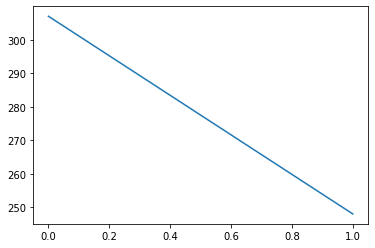

PDM23m_pct 2


PDL12d_pct 2


AVL17j_pct 2


PVL08j_b_pct 2


PVM13g_pct 2


PVM03r_a_pct 2


AVM08ok_pct 2


PDM14v_pct 2


PVM04f_pct 2


PDM14t_pct 2


PVM01c_pct 2


ADM06u_pct 2


PVL05on_pct 2


AVM14g_pct 2


PVL08y_pct 2


ADL01ob_pct 2


AVL11x_pct 2


PVL08c_pct 2


PDL09i_pct 2


PVL09s_a_pct 2


PVL12a_pct 2


PVL05ot_pct 2


AVL24g_pct 2


AVL13e_a_pct 2


AVL05j_pct 2


AVL02v_e_pct 2


PVL11e_c_pct 2


AVL19p_pct 2


AVL21c_pct 2


ADL14q_pct 2


PDL12ob_pct 2


AVL04op_pct 2


PVL02t_pct 2


PVL07t_pct 2


AVM09w_pct 2


PVL06y_b_pct 2


PVM04z_b_pct 2


ADM05oi_pct 2


PVL13a_pct 2


ADM03d_pct 2


AVL04v_c_pct 2


AVM20h_pct 2


ADM03od_pct 2


AVM06k_pct 2


AVL14c_pct 2


AVL05ol_pct 2


AVL05s_b_pct 2


AVL13h_pct 2


AVL17olf_pct 2


AVL13e_c_pct 2


AVL13e_b_pct 2


AVL05or_pct 2


PDL09j_b_pct 2


AVL19q_pct 2


AVL02oa_pct 2


AVL10q_pct 2


AVL05on_pct 2


AVL13u_pct 2


AVL03j_a_pct 2


AVL18s_pct 2


PVM08s_pct 2


PDL09q_pct 2


PVL08s_pct 2


AVL05s_c_pct 2


PVM08i_b_pct 2


AVM11c_pct 2


ADM03ot_pct 2


AVM09r_pct 2


VP5 + VP2 lPN 2


PDL12e_b_pct 2


AVM08t_pct 2


ADM03oi_pct 2


AVM14c_pct 2


AVL10m_b_pct 2


PDL09y_a_pct 2


PDL08a_pct 2


AVM03k_pct 2


AVM12c_pct 2


PVM05u_pct 2


ADM03y_c_pct 2


PVM03x_b_pct 2


AVL21f_b_pct 2


AVL04v_b_pct 2


AVL10ov_pct 2


AVL16p_a_pct 2


MC66 2


PVL11e_b_pct 2


PVM02m_pct 2


AVM08s_pct 2


AVL01u_pct 2


PVM01od_pct 2


AVL01oc_pct 2


AVM20e_pct 2


AVL09m_pct 2


AVM08e_a_pct 2


ADM03lc_pct 2


AVL01om_pct 2


PDM23a_pct 2


AVM12n_pct 2


PVL02ot_pct 2


AVM06f_pct 2


PDM14w_pct 2


AVM09s_pct 2


PVM07r_pct 2


AVM12e_a_pct 2


ADM06p_pct 2


AVL01oj_pct 2


PVL10c_pct 2


AVM12e_b_pct 2


PDM14j_c_pct 2


PVM05v_pct 2


PVL16d_pct 2


PDM14j_e_pct 2


PVM04p_pct 2


PVM07g_pct 2


PVL10f_pct 2


PVM06n_c_pct 2


AVM12p_a_pct 2


AVL14z_pct 2


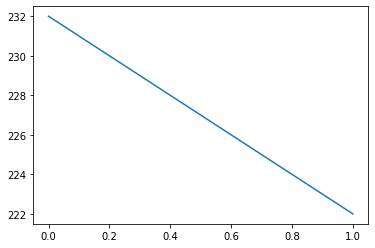

AVM12j_pct 2


PVL07g_d_pct 2


AVL21i_pct 2


PVL07g_c_pct 2


PVL07g_e_pct 2


AVL16s_pct 2


AVL21j_pct 2


AVL05ow_pct 2


H2 2


PDL18j_pct 1


ADL23a_pct 1


PDL10f_pct 1


PDM20a_pct 1


PDL13ob_pct 1


PDL14t_pct 1


SA1_c 1


PDL05oj_pct 1


PDL27e_pct 1


PDM22c_pct 1


PDM08c_pct 1


PDM10oo_pct 1


PDM07d_pct 1


PDL19d_pct 1


PDL05d_pct 1


PDM07c_pct 1


ADL17a_pct 1


PDM05c_pct 1


ADL02ola_pct 1


PDL10q_pct 1


PDM29d_pct 1


PDL20e_pct 1


ADL02or_pct 1


ADL15d_pct 1


PDL26d_pct 1


PDM22ola_pct 1


PVL17k_pct 1


PDL06oo_pct 1


PDM30i_pct 1


PDM30h_pct 1


PDL25h_pct 1


PDL16oa_pct 1


PDL20ola_pct 1


PDM24j_pct 1


ADL01u_pct 1


ADL20b_pct 1


ADL10oa_pct 1


PDL10od_pct 1


PDL10oy_pct 1


ADL29g_pct 1


PDL19oa_pct 1


PDL21c_pct 1


PDL05k_pct 1


PDM18j_pct 1


ADL24olc_pct 1


PDM07k_pct 1


PDL17oa_pct 1


PDL19b_pct 1


PDL11r_pct 1


ADL01oe_pct 1


PDL07t_pct 1


ADM04on_pct 1


ADL03oh_pct 1


PDL07i_pct 1


ADL02e_pct 1


PDM29h_pct 1


ADM05f_pct 1


PDM20q_pct 1


PDL11p_pct 1


ADL02os_pct 1


PDL17a_pct 1


PDL06d_pct 1


PDM29e_pct 1


ADL27c_pct 1


PDM22f_pct 1


PDM07h_pct 1


PDM07i_pct 1


ADL07y_pct 1


DM3 adPN 1


PDL10oi_pct 1


ADL02r_pct 1


ADL20a_pct 1


PDL13j_pct 1


PDM30f_pct 1


PDL10og_pct 1


ADL05ob_pct 1


ADL05u_pct 1


ADL05j_pct 1


PDM08n_pct 1


ADL02ot_pct 1


ADL02oi_pct 1


PDL10p_pct 1


PDL07ola_pct 1


pC1b 1


PDL27c_pct 1


PVM02b_pct 1


ADL17e_pct 1


PVL06b_pct 1


ADL02oj_pct 1


ADL21h_pct 1


ADL09d_pct 1


VM4 adPN 1


PDL11x_pct 1


PDL05e_pct 1


PDL10oh_pct 1


PDM07oa_pct 1


DL4 adPN 1


PDL17y_pct 1


ADM01om_pct 1


PDL10n_pct 1


PVM10m_pct 1


ADM04ok_pct 1


PDL14s_pct 1


PDL05ok_pct 1


PDM10ola_pct 1


ADL07c_pct 1


PDL10t_pct 1


PDM08u_pct 1


ADM05of_pct 1


AVL19a_pct 1


PDM31b_pct 1


AVL06ol_pct 1


ADM04i_pct 1


PVL20e_pct 1


OA-VUMa7 1


ADL03e_pct 1


PVL15p_pct 1


ADL25g_pct 1


AVL03olb_pct 1


pC1e 1


ADL12s_pct 1


AVM03b_pct 1


AVL04olb 1


AVL03ov_pct 1


AVL06olc_pct 1


ADL14d_pct 1


PVM02u_pct 1


PDL21f_pct 1


ADL24r_pct 1


AVM03i_pct 1


PDL20a_pct 1


AVL01lf_pct 1


ADM04g_pct 1


PDM11p_pct 1


PDM17s_pct 1


ADL12r_pct 1


PVL04ol_pct 1


AVL09v_pct 1


PDM22g_pct 1


AVM18g_pct 1


PDM07g_pct 1


PVL19h_pct 1


AVM11q_pct 1


PDM09m_pct 1


PVL15m_pct 1


ADL07m_pct 1


PVL15q_pct 1


PVM03q_pct 1


PVL04og_pct 1


PVL17j_pct 1


PDM09oc_pct 1


AVL03or_pct 1


PVL13h_pct 1


PDL21e_pct 1


AVL07f_pct 1


PVL04t_pct 1


PDM11oa_pct 1


PDM09oo_pct 1


PDM24m_pct 1


AVM06a_pct 1


AVL02a_pct 1


ADL12y_pct 1


AVL06a_pct 1


DNp32 1


ADL03c_pct 1


PDL24b_pct 1


PVL06k_pct 1


PDL11c_pct 1


PDL18u_pct 1


PDM06a_pct 1


PDM06p_pct 1


AVL03la_pct 1


PVL05k_pct 1


AVL23c_pct 1


PDM08z_pct 1


AVL13r_pct 1


PVL11od_pct 1


PDM24a_pct 1


ADL16olb_pct 1


AVL11m_pct 1


AVL14j_pct 1


ADM01m_pct 1


AVM19c_pct 1


PDM08ob_pct 1


PDM11oe_pct 1


PDM07b_pct 1


PDM24r_pct 1


AVM11olc_pct 1


PDL17k_pct 1


ADM04b_pct 1


AVL08or_pct 1


ADM02g_pct 1


PDM08od_pct 1


PDL11f_pct 1


PDM13x_pct 1


PDM13y_pct 1


DNp10 1


PDM13i_pct 1


AVL01olc_pct 1


ADL17j_pct 1


PDM07oj_pct 1


ADM04c_pct 1


PDL06oc_pct 1


PDM30k_pct 1


ADL28g_pct 1


AVL18j_pct 1


ADL02x_pct 1


PDL10v_pct 1


ADL07b_pct 1


PDM08oc_pct 1


PVL05f_pct 1


PVL04od_pct 1


ADL19h_pct 1


ADL13a_pct 1


PVL13n_pct 1


PDM07j_pct 1


PVL15h_pct 1


olfactory multi lPN t-mALT 1


aMe3 1


PDM12q_pct 1


PDM16r_pct 1


PDM20g_a_pct 1


PDL16f_pct 1


PDL06od_pct 1


PVL07j_pct 1


ADL16q_pct 1


AVL06n_pct 1


AVL02oj_pct 1


PDL05oc_pct 1


PVL07oa_pct 1


AVL02os_pct 1


AVL11a_pct 1


PVL06oq_pct 1


PVL21a_pct 1


PVM09z_pct 1


PDL26g_pct 1


PVL15u_pct 1


PDM29g_pct 1


PDM20w_pct 1


PVL09c_pct 1


AVL06op_pct 1


PDM18d_pct 1


ADL16i_pct 1


ADL28f_pct 1


PDL26h_pct 1


PVL07od_pct 1


PDM10oa_pct 1


ADL05i_pct 1


PVM12f_pct 1


AVL14n_pct 1


PDL28b_pct 1


PDM29b_pct 1


PVL21h_pct 1


PDM07p_pct 1


PDM24i_pct 1


ADL03d_pct 1


PDL05on_pct 1


ADL14g_pct 1


PDM11ob_pct 1


ADM03oy_pct 1


ADM08b_pct 1


PDM10oe_pct 1


ADL24g_pct 1


ADL24e_pct 1


ADL27f_pct 1


AVL03ou_pct 1


ADL07p_pct 1


PVL15x_pct 1


ADL19e_pct 1


AVL16c_pct 1


PDM08v_pct 1


AVL13q_pct 1


AVM14oi_pct 1


ADL29d_pct 1


PDM09b_pct 1


PDM10y_pct 1


PDL11e_pct 1


ADL12z_pct 1


PVM02a_pct 1


AVL03le_pct 1


AVL08b_pct 1


PDL06ob_pct 1


AVM14q_pct 1


PVM01q_pct 1


PVM02v_pct 1


PVL06t_pct 1


ADL18j_pct 1


ADL24d_pct 1


PDM22b_pct 1


PDM12w_pct 1


PDM24g_pct 1


AVL03ok_pct 1


PVL15y_pct 1


ADM10c_pct 1


AVL19c_pct 1


PDM31e_pct 1


PVL05ox_pct 1


PDL06z_pct 1


ADM10u_pct 1


ADL02u_pct 1


ADM04h_pct 1


PVM08t_pct 1


PDL25c_pct 1


PVL21c_pct 1


ADM12f_pct 1


PVM01oz_pct 1


AVL06s_pct 1


PDM20m_pct 1


DN3 1


AVL16b_pct 1


AVL06oc_pct 1


ADL19g_pct 1


PDL06oa_pct 1


AVL10og_pct 1


PDM25b_pct 1


AVL06ot_pct 1


AVL02ob_pct 1


AVL05x_pct 1


AVL04ola 1


PDM09op_pct 1


PVL04or_pct 1


PDM16t_pct 1


PDM09oh_pct 1


PVL15ola_pct 1


AVL06m_pct 1


AVL18n_pct 1


AVL08a_pct 1


PVL17i_pct 1


PVL07k_pct 1


aMe15 1


PDM24e_pct 1


ADL14h_pct 1


PDM11of_pct 1


PDM11og_pct 1


AVL23b_pct 1


PDM29i_pct 1


PDL05j_pct 1


PDL18od_pct 1


AVL19i_pct 1


PVL05j_pct 1


AVM03d_pct 1


PDM24s_pct 1


ADL05e_pct 1


AVL06oj_pct 1


PDM07u_pct 1


PVL10n_pct 1


PDM10d_pct 1


AVL23h_pct 1


PDL05of_pct 1


ADL07oo_pct 1


PVL16f_pct 1


ADL07n_pct 1


PDM24p_pct 1


PDL10d_pct 1


PDM12x_pct 1


AVL27b_pct 1


PVL08f_pct 1


AVL27c_pct 1


ADL02q_pct 1


ADM03q_pct 1


ADL21oa_pct 1


AVL06b_pct 1


AVL18m_pct 1


PDL15oc_pct 1


PDM14b_pct 1


ADL12p_pct 1


AVL12q_pct 1


PDM24d_pct 1


PVL04ok_pct 1


PDL05oe_pct 1


ADL02od_pct 1


PDM12og_pct 1


PDL12j_pct 1


PDM29j_pct 1


PDM05n_pct 1


OA-VPM4 1


PVM08r_pct 1


PDL05ob_pct 1


ADL07j_pct 1


AVL09oc_pct 1


AVL09om_pct 1


AVL27d_pct 1


PDM17a_pct 1


AVM08j_pct 1


PVL05oy_pct 1


ADL24c_pct 1


PDM22m_pct 1


PVL19e_pct 1


AVL03ld_pct 1


PDM22i_pct 1


AVL06r_pct 1


AVL06od_pct 1


vpoDN 1


ADL16g_pct 1


PDL17m_pct 1


PDM12oc_pct 1


PDL10ola_pct 1


PDM27b_pct 1


PVM08q_pct 1


PVM03ob_pct 1


PVM09h_pct 1


AVL08c_pct 1


PVL04oy_pct 1


AVL03lb_pct 1


AVL10ob_pct 1


PDM28q_pct 1


PDM10ob_pct 1


AVL08op_pct 1


AVL10oa_pct 1


AVL11b_pct 1


AVL06oi_pct 1


PVL04x_pct 1


PVM03b_pct 1


AVL06oq_pct 1


AVM18d_pct 1


PVL21b_pct 1


PVL13i_pct 1


PDM07olc_pct 1


ADL26h_pct 1


PVL06or_pct 1


ADM03t_pct 1


ADL26b_pct 1


AVL08oq_pct 1


AVL06on_pct 1


PDM07m_pct 1


ADL19d_pct 1


PVL19d_pct 1


PDL18a_pct 1


PVL01e_pct 1


PVL05oq_pct 1


AVL08n_pct 1


ADM04oe_pct 1


AVL01h_pct 1


ADL17u_pct 1


ADL24s_pct 1


ADM04f_pct 1


PDL18p_pct 1


ADL20n_pct 1


ADL19olb_pct 1


ADL01oc_pct 1


PDL15ola_pct 1


PDL18v_pct 1


ADM05oh_pct 1


PDL18f_pct 1


ADL09a_pct 1


PVL04on_pct 1


ADL12x_pct 1


PDM22e_pct 1


ADL05c_pct 1


ADL14t_pct 1


PDL15ob_pct 1


PDL06g_pct 1


PDM09om_pct 1


PDL11k_pct 1


ADL17s_pct 1


PDM05s_pct 1


PDM20r_pct 1


ADL07q_pct 1


PDM30a_pct 1


AVL27a_pct 1


PDL10y_pct 1


PDL20k_pct 1


ADL05ok_pct 1


ADL24p_pct 1


ADL10a_pct 1


PDM07a_pct 1


PDL18k_pct 1


PDL05p_pct 1


ADL16r_pct 1


ADL07olc_pct 1


PVL05e_pct 1


ADL05x_pct 1


ADL26i_pct 1


FB09 1


APL 1


PVL15a_pct 1


PDM12ob_pct 1


PDL18oc_pct 1


ADL09oa_pct 1


PDM07ok_pct 1


PDM08oq_pct 1


ADL12w_pct 1


PDM07ol_pct 1


PDM27f_pct 1


PVM08a_pct 1


PDM22h_pct 1


PVM12z_pct 1


pC1a 1


ADM10v_pct 1


ADM03b_pct 1


PDM21k_pct 1


PDM09x_pct 1


PDM24b_pct 1


PDL24ola_pct 1


ADM05a_pct 1


PDM10t_pct 1


AVL20g_pct 1


PDM22k_pct 1


ADL28h_pct 1


PVL15oa_pct 1


oviDNb 1


PDM10c_pct 1


ADM10k_pct 1


ADM12e_pct 1


PVM09f_pct 1


ADL05f_pct 1


PVL15j_pct 1


PDM08k_pct 1


ADM04n_pct 1


ADL02w_pct 1


PDM32c_pct 1


ADM01r_pct 1


ADM09b_pct 1


ADM05g_pct 1


ADM01ob_pct 1


PVL08ola_pct 1


AVL01lx_pct 1


PDM08og_pct 1


ADL27b_pct 1


PDM29f_pct 1


PVM09w_pct 1


PDM27q_pct 1


ADL02ob_pct 1


ADM01ok_pct 1


PVM15b_pct 1


AVM04f_pct 1


PDM27t_pct 1


ADM12b_pct 1


PDM27g_pct 1


PDM12oh_pct 1


PDL05oa_pct 1


ADM11c_pct 1


PDL18b_pct 1


PDM32e_pct 1


ADM10x_pct 1


pC1d 1


ADL03z_pct 1


PDM21c_pct 1


ADL23p_pct 1


ADL04olf_pct 1


PDL16h_pct 1


PDL07m_pct 1


PDL20f_pct 1


PDL17w_pct 1


ADL13k_pct 1


AVL07os_pct 1


ADL02op_pct 1


aMe24 1


ADL24t_pct 1


ADL17p_pct 1


olfactory multi A PN t-mALT 1


VC1 lPN 1


ADL01or_pct 1


PVL02b_pct 1


ADL24b_pct 1


PDL13y_pct 1


PDL08or_pct 1


AVL18g_pct 1


VP1m lPN 1


ADL07r_pct 1


PDL08os_pct 1


ADL01on_pct 1


PVL17p_pct 1


AVL18f_pct 1


PDL08ov_pct 1


PDL16e_pct 1


PDM30e_pct 1


VC5 adPN 1


VC2 lPN 1


DC4 adPN 1


PDL13t_pct 1


PDL08k_pct 1


PDL17j_pct 1


MBON21 1


PDM12oa_pct 1


ADL07olb_pct 1


ADL02ok_pct 1


PDL11b_pct 1


AVM17b_pct 1


PDL22a_pct 1


ADL23j_pct 1


aMe13 1


ADL02f_pct 1


PVL01b_pct 1


PDM24q_pct 1


AVM07j_pct 1


AVL07s_pct 1


PDL08oh_pct 1


PVL17n_pct 1


PDM30c_pct 1


ADM05j_pct 1


PDL18i_pct 1


PVM09u_pct 1


ADL19f_pct 1


ADM10a_pct 1


AVM15p_pct 1


ADL02oo_pct 1


PDL23oa_pct 1


PVL11oa_pct 1


AVL03op_pct 1


ADL07s_pct 1


PDM08b_pct 1


ADL04z_pct 1


PVL20d_pct 1


PDL20oa_pct 1


PDL13b_pct 1


PDL10c_pct 1


PDM20p_pct 1


PVL17c_pct 1


PDL18n_pct 1


PDL05om_pct 1


PDM07v_pct 1


PDL05u_pct 1


ADL16d_pct 1


MBON33 1


ADL07on_pct 1


AVL07t_pct 1


PDM11v_pct 1


ADL13e_pct 1


PDL27d_pct 1


PDL08c_pct 1


PDL12f_pct 1


PDL22ola_pct 1


AVM07s_pct 1


PVL04oc_pct 1


ADL29e_pct 1


PDL25f_pct 1


PDM25a_pct 1


PDL05s_pct 1


AVL22c_pct 1


PDL11q_pct 1


ADL04k_pct 1


ADM05h_pct 1


PVM03m_pct 1


PDL10of_pct 1


PDL24g_pct 1


PDL18g_pct 1


PVL04ob_pct 1


DC1 adPN 1


PDM31a_pct 1


ADL01m_pct 1


PDL08ou_pct 1


ADL09s_pct 1


PDM06i_pct 1


PDM15d_pct 1


PDL05x_pct 1


PDM08y_pct 1


PDM12ol_pct 1


PDL08oq_pct 1


ADL18g_pct 1


PDL16m_pct 1


PDM08oi_pct 1


PDM05g_pct 1


PDL17i_pct 1


PDL26c_pct 1


ADL28d_pct 1


AVM03e_pct 1


ADL07f_pct 1


ADL15b_pct 1


ADM02e_pct 1


MBON16-like 1


AVM18i_pct 1


PDM11y_pct 1


AVL01p_pct 1


ADM02d_pct 1


PVL04oz_pct 1


PDM08j_pct 1


PVM05b_pct 1


ADL27e_pct 1


AVM17f_pct 1


ADM12d_pct 1


PDL06p_pct 1


ADM03a_pct 1


ADM10e_pct 1


PDL05y_pct 1


AVM13j_pct 1


ADL01oq_pct 1


MBON23 1


ADL14v_pct 1


ADL04e_pct 1


PDM20s_pct 1


PDL20v_pct 1


ADL01ot_pct 1


PDM12k_pct 1


PDL08t_pct 1


DL5 adPN 1


AVL01oo_pct 1


PVL02e_pct 1


PDM29k_pct 1


PVL18d_pct 1


ADL23d_pct 1


ADL24j_pct 1


ADL04oi_pct 1


ADL11ob_pct 1


DN2 1


PDL10w_pct 1


PDM27a_pct 1


PDM08x_pct 1


PDM30g_pct 1


ADL24i_pct 1


ADL11oa_pct 1


ADL04s_pct 1


ADL03oj_pct 1


olfactory multi C PN t-mALT 1


multi A PN mALT 1


ADL17q_pct 1


ADL18old_pct 1


PDM30b_pct 1


PDL12g_pct 1


ADL07w_pct 1


AVL12k_pct 1


PDM30j_pct 1


PVL02f_pct 1


PDM10z_pct 1


ADL05ol_pct 1


PDM05b_pct 1


PDL20i_pct 1


ADL16c_pct 1


PVL17h_pct 1


PDM11oc_pct 1


PDL10k_pct 1


ADL09j_pct 1


olfactory multi PSp3 t-mALT 1


PDL21a_pct 1


ADL02oe_pct 1


ADL22j_pct 1


ADL02om_pct 1


PDM20d_pct 1


PDL21d_pct 1


AVL06p_pct 1


PDL07k_pct 1


ADL22a_pct 1


PVL09u_pct 1


ADL11a_pct 1


DA4m adPN 1


ADL12u_pct 1


PDL20m_pct 1


PDL16d_pct 1


ADL05y_a_pct 1


ADL27i_pct 1


AVL07u_pct 1


ADL05oo_pct 1


PVL04d_pct 1


PVL21g_pct 1


AVM18h_pct 1


ADL18r_pct 1


AVL12n_pct 1


PDM11od_pct 1


PDL17h_pct 1


PDL07e_pct 1


PDM08oa_pct 1


PDL17n_pct 1


VP multi lPN t3ALT 1


PVL02j_pct 1


aMe20 1


PDL07d_pct 1


PDM13g_pct 1


aMe23 1


PVL17g_pct 1


aMe22 1


PVM09g_pct 1


AVL18d_pct 1


PVL11y_pct 1


PDL20j_pct 1


PVM10olb_pct 1


ADL24f_pct 1


PDL08op_pct 1


PVL11u_pct 1


PDL28e_pct 1


PDM08of_pct 1


PDM12u_pct 1


PDM09q_pct 1


VP multi lPN lALT 1


ADL04a_pct 1


AVL07oa_pct 1


olfactory multi lPN t-lALT 1


ADL07og_pct 1


PVL10a_pct 1


olfactory multi C PN mALT 1


PVL06n_pct 1


ADL28i_pct 1


PDM08oh_pct 1


PDM33b_pct 1


ADL03a_pct 1


PVL04op_pct 1


ADM02c_pct 1


DA1 vPN 1


PDM05r_pct 1


ADL24m_pct 1


ADL16b_pct 1


PVM08b_pct 1


PDL21b_pct 1


ADL08j_pct 1


AVL05a_pct 1


ADM04j_pct 1


PVL05op_pct 1


AVL13s_pct 1


AVM14r_pct 1


AVL18b_pct 1


MBON17-like 1


PDL11g_pct 1


AVL09i_pct 1


AVL01op_pct 1


PDL05og_pct 1


AVL04oo_pct 1


ADM03om_pct 1


PVM05k_pct 1


PDL27a_pct 1


AVM08x_pct 1


AVL01b_x_pct 1


PVL11t_pct 1


AVM08n_pct 1


PVL21e_pct 1


AVL09on_pct 1


PDM19k_pct 1


PVM06k_pct 1


PVL11n_pct 1


PVM05ola_pct 1


PVM05olh_pct 1


AVM04j_pct 1


PVL09r_pct 1


PDL14u_pct 1


AVL02ola_pct 1


AVL23a_pct 1


PDM07oh_pct 1


ADL02n_pct 1


VP1l lvPN 1


AVL10oc_pct 1


ADL01om_pct 1


PDM09j_pct 1


ADL08f_pct 1


PDM26b_pct 1


ADL11g_pct 1


ADM10s_pct 1


ADL18a_pct 1


VA2 adPN 1


PDM26f_pct 1


PDM09p_pct 1


PDM35c_pct 1


ADL04oj_pct 1


ADL04g_pct 1


AVL25b_pct 1


PDM29c_pct 1


KeyboardInterrupt: 

In [51]:
for typen in type_degs:
    print(typen[0], end=' ')
    print(typen[2])
    plotDegDist_degs(typen[1])
    plt.show()